# Preprocessing of the Original Images of the Dataset
- Add gray bars to all images so that they have equal height and width.
- Resize all images to [224, 224]

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 200
from PIL import Image
import os
from tqdm.auto import tqdm


def letterbox_image(image, size):
    image = image.convert("RGB")
    iw, ih = image.size
    w, h = size
    scale = min(w / iw, h / ih)
    nw = int(iw * scale)
    nh = int(ih * scale)

    image = image.resize((nw, nh), Image.BICUBIC)
    new_image = Image.new('RGB', size, (128, 128, 128))
    new_image.paste(image, ((w - nw) // 2, (h - nh) // 2))
    return new_image, nw, nh


ROOT_DATA_PATH = 'E:\\oxford-iiit-pet'
IMAGES_PATH = os.path.join(ROOT_DATA_PATH, 'images')

images = []
for file in tqdm(os.listdir(IMAGES_PATH)):
    image_path = os.path.join(IMAGES_PATH, file)
    image = None

    image = Image.open(image_path)
    new_image, nw, nh = letterbox_image(image, (224, 224))
    new_image.save("E:/oxford-iiit-pet/processed/images/" + file[:-4] + ".png")

# Preprocessing of the Masks of the Dataset
- Resize all masks to [224, 224]

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 200
from PIL import Image
import os
from tqdm.auto import tqdm


def letterbox_mask(image, size):
    iw, ih = image.size
    w, h = size
    scale = min(w / iw, h / ih)
    nw = int(iw * scale)
    nh = int(ih * scale)

    image = image.resize((nw, nh), Image.BICUBIC)
    new_image = Image.new('L', size, 2)  # 2 is the background
    new_image.paste(image, ((w - nw) // 2, (h - nh) // 2))
    return new_image, nw, nh


ROOT_DATA_PATH = 'E:\\oxford-iiit-pet'
MASKS_PATH = os.path.join(ROOT_DATA_PATH, 'annotations/trimaps')

masks = []

for file in tqdm(os.listdir(MASKS_PATH)):
    mask_path = os.path.join(MASKS_PATH, file)[:-4] + '.png'
    mask = None

    mask = Image.open(mask_path)
    new_mask, nw, nh = letterbox_mask(mask, (224, 224))
    new_mask.save("E:/oxford-iiit-pet/processed/annotations/" +  file[:-4] + ".png")

# Adjust the channel of the mask
- The original mask has three channels, namely foreground, background and unclassified. They are represented by three pixel values of 1, 2, and 3, respectively.
- Now we only focus on the two-class segmentation, so we **modify the unclassified pixel value to 0**, which is the same as the background pixel value.
- In fact, this also increases the difficulty of segmentation. Because unclassified areas are often regions in the image that cover part of the pet's body, such as scarves and necklaces.

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 200
from PIL import Image
import os
import numpy as np
from tqdm.auto import tqdm



ROOT_DATA_PATH = 'E:\\oxford-iiit-pet'
MASKS_PATH = os.path.join(ROOT_DATA_PATH, 'processed/test_label')

for file in tqdm(os.listdir(MASKS_PATH)):
    mask_path = os.path.join(MASKS_PATH, file)[:-4] + '.png'
    mask = None
    mask = Image.open(mask_path)
    mask = np.array(mask)
    tmp_mask = np.zeros(mask.shape, dtype=float)
    tmp_mask[mask == 1] = 1
    tmp_mask = Image.fromarray(tmp_mask.astype(np.uint8))
    tmp_mask.save("E:/oxford-iiit-pet/processed_change_lable/test_label/" + file[:-4] + ".png")

# Prepare the Dataloader for training

In [1]:
from random import shuffle
import numpy as np
import torch
import torch.nn as nn
import math
import torch.nn.functional as F
from PIL import Image
from torch.autograd import Variable
from torch.utils.data import DataLoader
from torch.utils.data.dataset import Dataset
from matplotlib.colors import rgb_to_hsv, hsv_to_rgb
import cv2
import os


def cvtColor(image):
    if len(np.shape(image)) == 3 and np.shape(image)[2] == 3:
        return image
    else:
        image = image.convert('RGB')
        return image

    
def preprocess_input(image):
    image /= 255.0
    return image
    
    
def letterbox_image(image, label , size):
    label = Image.fromarray(np.array(label))
    '''resize image with unchanged aspect ratio using padding'''
    iw, ih = image.size
    w, h = size
    scale = min(w/iw, h/ih)
    nw = int(iw*scale)
    nh = int(ih*scale)

    image = image.resize((nw,nh), Image.BICUBIC)
    new_image = Image.new('RGB', size, (128,128,128))
    new_image.paste(image, ((w-nw)//2, (h-nh)//2))

    label = label.resize((nw,nh), Image.NEAREST)
    new_label = Image.new('L', size, (0))
    new_label.paste(label, ((w-nw)//2, (h-nh)//2))

    return new_image, new_label

def rand(a=0, b=1):
    return np.random.rand()*(b-a) + a

class DeeplabDataset(Dataset):
    def __init__(self, annotation_lines, input_shape, num_classes, train, dataset_path):
        super(DeeplabDataset, self).__init__()
        self.annotation_lines = annotation_lines
        self.length = len(annotation_lines)
        self.input_shape = input_shape
        self.num_classes = num_classes
        self.train = train
        self.dataset_path = dataset_path

    def __len__(self):
        return self.length

    def __getitem__(self, index):
        annotation_line = self.annotation_lines[index]
        name = annotation_line.split()[0]

        # -------------------------------#
        #   load images
        # -------------------------------#
        jpg = Image.open(os.path.join(os.path.join(self.dataset_path, "trainval_image"), name + ".png"))
        png = Image.open(os.path.join(os.path.join(self.dataset_path, "trainval_label"), name + ".png"))

        jpg, png = self.get_random_data(jpg, png, self.input_shape, random=self.train)

        jpg = np.transpose(preprocess_input(np.array(jpg, np.float64)), [2, 0, 1])
        png = np.array(png)
        png[png >= self.num_classes] = self.num_classes
        # -------------------------------------------------------#
        #   conver to the format of one-hot
        # -------------------------------------------------------#
        seg_labels = np.eye(self.num_classes + 1)[png.reshape([-1])]
        seg_labels = seg_labels.reshape((int(self.input_shape[0]), int(self.input_shape[1]), self.num_classes + 1))

        return jpg, png, seg_labels

    def rand(self, a=0, b=1):
        return np.random.rand() * (b - a) + a

    def get_random_data(self, image, label, input_shape, jitter=.3, hue=.1, sat=0.7, val=0.3, random=True):
        image = cvtColor(image)
        label = Image.fromarray(np.array(label))

        if not random:
            return image, label


def deeplab_dataset_collate(batch):
    images = []
    pngs = []
    seg_labels = []
    for img, png, labels in batch:
        images.append(img)
        pngs.append(png)
        seg_labels.append(labels)
    images = torch.from_numpy(np.array(images)).type(torch.FloatTensor)
    pngs = torch.from_numpy(np.array(pngs)).long()
    seg_labels = torch.from_numpy(np.array(seg_labels)).type(torch.FloatTensor)
    return images, pngs, seg_labels

In [2]:
# from nets.pspnet import PSPNet
# from nets.deeplabv3_plus import DeepLab
# from load_swin_transformer import SwinUnet as ViT_seg
# from Attention_Unet_from_UnetZoo import AttU_Net
# from nets.unet import Unet

# SwinCAR

In [2]:
# SwinCAR
import torch
import torch.nn as nn
import torch.utils.checkpoint as checkpoint
from einops import rearrange
from timm.models.layers import DropPath, to_2tuple, trunc_normal_


class h_sigmoid(nn.Module):
    def __init__(self, inplace=True):
        super(h_sigmoid, self).__init__()
        self.relu = nn.ReLU6(inplace=inplace)

    def forward(self, x):
        return self.relu(x + 3) / 6


class h_swish(nn.Module):
    def __init__(self, inplace=True):
        super(h_swish, self).__init__()
        self.sigmoid = h_sigmoid(inplace=inplace)

    def forward(self, x):
        return x * self.sigmoid(x)


class Acon_FReLU(nn.Module):
    r""" ACON activation (activate or not) based on FReLU:
    # eta_a(x) = x, eta_b(x) = dw_conv(x), according to
    # "Funnel Activation for Visual Recognition" <https://arxiv.org/pdf/2007.11824.pdf>.
    """

    def __init__(self, width, stride=1):
        super().__init__()
        self.stride = stride

        # eta_b(x)
        self.conv_frelu = nn.Conv2d(width, width, kernel_size=3, stride=stride, padding=1, groups=width, bias=True)
        self.bn1 = nn.BatchNorm2d(width)

        # eta_a(x)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        self.bn2 = nn.BatchNorm2d(width)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x, **kwargs):
        if self.stride == 2:
            x1 = self.maxpool(x)
        else:
            x1 = x

        x2 = self.bn1(self.conv_frelu(x))

        return self.bn2((x1 - x2) * self.sigmoid(x1 - x2) + x2)


class CoordAtt(nn.Module):
    def __init__(self, inp, oup, reduction=16):
        super(CoordAtt, self).__init__()
        self.pool_h = nn.AdaptiveAvgPool2d((None, 1))
        self.pool_w = nn.AdaptiveAvgPool2d((1, None))

        mip = max(8, inp // reduction)

        self.conv1 = nn.Conv2d(inp, mip, kernel_size=1, stride=1, padding=0)
        self.bn1 = nn.BatchNorm2d(mip)
        self.act = h_swish()  # non-linear

        self.conv_h = nn.Conv2d(mip, oup, kernel_size=1, stride=1, padding=0)
        self.conv_w = nn.Conv2d(mip, oup, kernel_size=1, stride=1, padding=0)
        

    def forward(self, x):
        identity = x

        n, c, h, w = x.size()
        x_h = self.pool_h(x)
        x_w = self.pool_w(x).permute(0, 1, 3, 2)

        y = torch.cat([x_h, x_w], dim=2)
        y = self.conv1(y)
        y = self.bn1(y)
        y = self.act(y)
        x_h, x_w = torch.split(y, [h, w], dim=2)
        x_w = x_w.permute(0, 1, 3, 2)

        a_h = self.conv_h(x_h).sigmoid()
        a_w = self.conv_w(x_w).sigmoid()

        out = identity * a_w * a_h

        return out


class Recovery_CoordAtt(nn.Module):
    def __init__(self, inp1, oup1, reduction=16):
        super(Recovery_CoordAtt, self).__init__()
        self.pool_h = nn.AdaptiveAvgPool2d((None, 1))
        self.pool_w = nn.AdaptiveAvgPool2d((1, None))

        mip = max(8, inp1 // reduction)

        self.conv1 = nn.Conv2d(inp1, mip, kernel_size=1, stride=1, padding=0)
        self.bn1 = nn.BatchNorm2d(mip)
        self.act = h_swish()  # non-linear

        self.conv = nn.Conv2d(inp1,mip, kernel_size=1, stride=1, padding=0)

        self.conv1_h = nn.Conv2d(mip, inp1, kernel_size=1, stride=1, padding=0)
        self.conv1_w = nn.Conv2d(mip, inp1, kernel_size=1, stride=1, padding=0)

        self.acon = Acon_FReLU(mip, 1)

    def forward(self, x1, x2):

        # identity: (B,12*C,14,14)
        identity = torch.cat((x1,x2),dim=1)

        n1, c1, h1, w1 = x1.size()

        # x1_h: (B,4*C,14,1)
        # x1_w: (B,4*C,14,1)
        x1_h = self.pool_h(x1)
        x1_w = self.pool_w(x1).permute(0, 1, 3, 2)

        # x2_h: (B,8*C,14,1)
        # x2_w: (B,8*C,14,1)
        x2_h = self.pool_h(x2)
        x2_w = self.pool_w(x2).permute(0, 1, 3, 2)

        # x_h: (B,12*C,14,1)
        x_h = torch.cat((x1_h,x2_h), dim=1)
        x_w = torch.cat((x1_w,x2_w), dim=1)

        # y: (B,12*C,28,1)
        y = torch.cat([x_h, x_w], dim=2)
        y = self.conv(y)
        y = self.bn1(y)
        y = self.act(y)


        # y_h: (B,12*C/16,14,1)
        y_h,y_w = torch.split(y, [h1, w1], dim=2)
        y_w = y_w.permute(0, 1, 3, 2)

        a_h = self.conv1_h(y_h).sigmoid()
        a_w = self.conv1_w(y_w).sigmoid()

        out = identity * a_w * a_h

        return out


class SignleConv(nn.Module):
    """
    Double convolution block that keeps that spatial sizes the same
    """

    def __init__(self, in_ch, out_ch, norm_layer=None):
        super(SignleConv, self).__init__()

        if norm_layer is None:
            norm_layer = nn.BatchNorm2d

        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, kernel_size=3, stride=1, padding=1),
            norm_layer(out_ch),
            nn.ReLU(inplace=True))

    def forward(self, x):
        return self.conv(x)


class DoubleConv(nn.Module):
    """
    Double convolution block that keeps that spatial sizes the same
    """

    def __init__(self, in_ch, out_ch, norm_layer=None):
        super(DoubleConv, self).__init__()
        self.conv = nn.Sequential(SignleConv(in_ch, out_ch, norm_layer),
                                  SignleConv(out_ch, out_ch, norm_layer))

    def forward(self, x):
        return self.conv(x)


class FinalUp(nn.Module):
    """
    Doubles spatial size with bilinear upsampling
    Skip connections and double convs
    """

    def __init__(self, in_ch, out_ch):
        super(FinalUp, self).__init__()
        mode = "bilinear"
        self.up = nn.Upsample(scale_factor=2, mode=mode, align_corners=True)
        self.conv = DoubleConv(in_ch, out_ch)

    def forward(self, x1, x2=None):
        """
        Args:
            x1: [b,c, h, w]
            x2: [b,c, 2*h,2*w]

        Returns: 2x upsampled double conv reselt
        """

        x = self.up(x1)

        if x2 is not None:
            x = torch.cat([x2, x], dim=1)
        return self.conv(x)


class Up1(nn.Module):
    """
    Doubles spatial size with bilinear upsampling
    Skip connections and double convs
    """

    def __init__(self, in_ch, out_ch):
        super(Up1, self).__init__()
        mode = "bilinear"
        self.up = nn.Upsample(scale_factor=2, mode=mode, align_corners=True)
        self.conv = DoubleConv(in_ch, out_ch)
        self.recovery_CA = Recovery_CoordAtt(in_ch,in_ch)

    def forward(self, x1, x2=None):
        """
        Args:
            x1: [b,c, h, w]
            x2: [b,c, 2*h,2*w]

        Returns: 2x upsampled double conv reselt
        """
        x = self.up(x1)

        if x2 is not None:
            x = torch.cat([x2, x], dim=1)
        return self.conv(x)


class Up2(nn.Module):
    """
    Doubles spatial size with bilinear upsampling
    Skip connections and double convs
    """

    def __init__(self, in_ch, out_ch):
        super(Up2, self).__init__()
        mode = "bilinear"
        self.up = nn.Upsample(scale_factor=2, mode=mode, align_corners=True)
        self.conv = SignleConv(in_ch, out_ch)
        self.recovery_CA = Recovery_CoordAtt(in_ch,in_ch)

    def forward(self, x1, x2=None):
        """
        Args:
            x1: [b,c, h, w]
            x2: [b,c, 2*h,2*w]

        Returns: 2x upsampled double conv reselt
        """
        x = self.up(x1)
        if x2 is not None:
            x = self.recovery_CA(x2,x)
            # x = torch.cat([x2, x], dim=1)
        return self.conv(x)


class Up3(nn.Module):
    """
    Doubles spatial size with bilinear upsampling
    Skip connections and double convs
    """

    def __init__(self, in_ch, out_ch):
        super(Up3, self).__init__()
        mode = "bilinear"
        self.up = nn.Upsample(scale_factor=2, mode=mode, align_corners=True)
        self.conv = SignleConv(in_ch, out_ch)
        self.recovery_CA = Recovery_CoordAtt(in_ch,in_ch)

    def forward(self, x1, x2=None):
        """
        Args:
            x1: [b,c, h, w]
            x2: [b,c, 2*h,2*w]

        Returns: 2x upsampled double conv reselt
        """
        x = self.up(x1)

        if x2 is not None:
            x = self.recovery_CA(x2,x)
            # x = torch.cat([x2, x], dim=1)
        return self.conv(x)


class Up4(nn.Module):
    """
    Doubles spatial size with bilinear upsampling
    Skip connections and double convs
    """

    def __init__(self, in_ch, out_ch):
        super(Up4, self).__init__()
        mode = "bilinear"
        self.up = nn.Upsample(scale_factor=2, mode=mode, align_corners=True)
        self.conv = SignleConv(in_ch, out_ch)
        self.recovery_CA = Recovery_CoordAtt(in_ch, in_ch)

    def forward(self, x1, x2=None):
        """
        Args:
            x1: [b,c, h, w]
            x2: [b,c, 2*h,2*w]

        Returns: 2x upsampled double conv reselt
        """
        x = self.up(x1)
        if x2 is not None:
            x = self.recovery_CA(x2, x)
        return self.conv(x)


class Mlp(nn.Module):
    def __init__(self, in_features, hidden_features=None, out_features=None, act_layer=nn.GELU, drop=0.):
        super().__init__()
        out_features = out_features or in_features
        hidden_features = hidden_features or in_features
        self.fc1 = nn.Linear(in_features, hidden_features)
        self.act = act_layer()
        self.fc2 = nn.Linear(hidden_features, out_features)
        self.drop = nn.Dropout(drop)

    def forward(self, x):
        x = self.fc1(x)
        x = self.act(x)
        x = self.drop(x)
        x = self.fc2(x)
        x = self.drop(x)
        return x


def window_partition(x, window_size):
    """
    Args:
        x: (B, H, W, C)
        window_size (int): window size

    Returns:
        windows: (num_windows*B, window_size, window_size, C)
    """
    B, H, W, C = x.shape
    x = x.view(B, H // window_size, window_size, W // window_size, window_size, C)
    windows = x.permute(0, 1, 3, 2, 4, 5).contiguous().view(-1, window_size, window_size, C)
    return windows


def window_reverse(windows, window_size, H, W):
    """
    Args:
        windows: (num_windows*B, window_size, window_size, C)
        window_size (int): Window size
        H (int): Height of image
        W (int): Width of image

    Returns:
        x: (B, H, W, C)
    """
    B = int(windows.shape[0] / (H * W / window_size / window_size))
    x = windows.view(B, H // window_size, W // window_size, window_size, window_size, -1)
    x = x.permute(0, 1, 3, 2, 4, 5).contiguous().view(B, H, W, -1)
    return x


class WindowAttention(nn.Module):
    r""" Window based multi-head self attention (W-MSA) module with relative position bias.
    It supports both of shifted and non-shifted window.

    Args:
        dim (int): Number of input channels.
        window_size (tuple[int]): The height and width of the window.
        num_heads (int): Number of attention heads.
        qkv_bias (bool, optional):  If True, add a learnable bias to query, key, value. Default: True
        qk_scale (float | None, optional): Override default qk scale of head_dim ** -0.5 if set
        attn_drop (float, optional): Dropout ratio of attention weight. Default: 0.0
        proj_drop (float, optional): Dropout ratio of output. Default: 0.0
    """

    def __init__(self, dim, window_size, num_heads, qkv_bias=True, qk_scale=None, attn_drop=0., proj_drop=0.):

        super().__init__()
        self.dim = dim
        self.window_size = window_size  # Wh, Ww
        self.num_heads = num_heads
        head_dim = dim // num_heads
        self.scale = qk_scale or head_dim ** -0.5

        # define a parameter table of relative position bias
        self.relative_position_bias_table = nn.Parameter(
            torch.zeros((2 * window_size[0] - 1) * (2 * window_size[1] - 1), num_heads))  # 2*Wh-1 * 2*Ww-1, nH

        # get pair-wise relative position index for each token inside the window
        coords_h = torch.arange(self.window_size[0])
        coords_w = torch.arange(self.window_size[1])
        coords = torch.stack(torch.meshgrid([coords_h, coords_w]))  # 2, Wh, Ww
        coords_flatten = torch.flatten(coords, 1)  # 2, Wh*Ww
        relative_coords = coords_flatten[:, :, None] - coords_flatten[:, None, :]  # 2, Wh*Ww, Wh*Ww
        relative_coords = relative_coords.permute(1, 2, 0).contiguous()  # Wh*Ww, Wh*Ww, 2
        relative_coords[:, :, 0] += self.window_size[0] - 1  # shift to start from 0
        relative_coords[:, :, 1] += self.window_size[1] - 1
        relative_coords[:, :, 0] *= 2 * self.window_size[1] - 1
        relative_position_index = relative_coords.sum(-1)  # Wh*Ww, Wh*Ww
        self.register_buffer("relative_position_index", relative_position_index)

        self.qkv = nn.Linear(dim, dim * 3, bias=qkv_bias)
        self.attn_drop = nn.Dropout(attn_drop)
        self.proj = nn.Linear(dim, dim)
        self.proj_drop = nn.Dropout(proj_drop)

        trunc_normal_(self.relative_position_bias_table, std=.02)
        self.softmax = nn.Softmax(dim=-1)

    def forward(self, x, mask=None):
        """
        Args:
            x: input features with shape of (num_windows*B, N, C)
            mask: (0/-inf) mask with shape of (num_windows, Wh*Ww, Wh*Ww) or None
        """
        B_, N, C = x.shape
        qkv = self.qkv(x).reshape(B_, N, 3, self.num_heads, C // self.num_heads).permute(2, 0, 3, 1, 4)
        q, k, v = qkv[0], qkv[1], qkv[2]  # make torchscript happy (cannot use tensor as tuple)

        q = q * self.scale
        attn = (q @ k.transpose(-2, -1))

        relative_position_bias = self.relative_position_bias_table[self.relative_position_index.view(-1)].view(
            self.window_size[0] * self.window_size[1], self.window_size[0] * self.window_size[1], -1)  # Wh*Ww,Wh*Ww,nH
        relative_position_bias = relative_position_bias.permute(2, 0, 1).contiguous()  # nH, Wh*Ww, Wh*Ww
        attn = attn + relative_position_bias.unsqueeze(0)

        if mask is not None:
            nW = mask.shape[0]
            attn = attn.view(B_ // nW, nW, self.num_heads, N, N) + mask.unsqueeze(1).unsqueeze(0)
            attn = attn.view(-1, self.num_heads, N, N)
            attn = self.softmax(attn)
        else:
            attn = self.softmax(attn)

        attn = self.attn_drop(attn)

        x = (attn @ v).transpose(1, 2).reshape(B_, N, C)
        x = self.proj(x)
        x = self.proj_drop(x)
        return x

    def extra_repr(self) -> str:
        return f'dim={self.dim}, window_size={self.window_size}, num_heads={self.num_heads}'

    def flops(self, N):
        # calculate flops for 1 window with token length of N
        flops = 0
        # qkv = self.qkv(x)
        flops += N * self.dim * 3 * self.dim
        # attn = (q @ k.transpose(-2, -1))
        flops += self.num_heads * N * (self.dim // self.num_heads) * N
        #  x = (attn @ v)
        flops += self.num_heads * N * N * (self.dim // self.num_heads)
        # x = self.proj(x)
        flops += N * self.dim * self.dim
        return flops


class SwinTransformerBlock(nn.Module):
    r""" Swin Transformer Block.

    Args:
        dim (int): Number of input channels.
        input_resolution (tuple[int]): Input resulotion.
        num_heads (int): Number of attention heads.
        window_size (int): Window size.
        shift_size (int): Shift size for SW-MSA.
        mlp_ratio (float): Ratio of mlp hidden dim to embedding dim.
        qkv_bias (bool, optional): If True, add a learnable bias to query, key, value. Default: True
        qk_scale (float | None, optional): Override default qk scale of head_dim ** -0.5 if set.
        drop (float, optional): Dropout rate. Default: 0.0
        attn_drop (float, optional): Attention dropout rate. Default: 0.0
        drop_path (float, optional): Stochastic depth rate. Default: 0.0
        act_layer (nn.Module, optional): Activation layer. Default: nn.GELU
        norm_layer (nn.Module, optional): Normalization layer.  Default: nn.LayerNorm
    """

    def __init__(self, dim, input_resolution, num_heads, window_size=7, shift_size=0,
                 mlp_ratio=4., qkv_bias=True, qk_scale=None, drop=0., attn_drop=0., drop_path=0.,
                 act_layer=nn.GELU, norm_layer=nn.LayerNorm):
        super().__init__()
        self.dim = dim
        self.input_resolution = input_resolution
        self.num_heads = num_heads
        self.window_size = window_size
        self.shift_size = shift_size
        self.mlp_ratio = mlp_ratio
        if min(self.input_resolution) <= self.window_size:
            # if window size is larger than input resolution, we don't partition windows
            self.shift_size = 0
            self.window_size = min(self.input_resolution)
        assert 0 <= self.shift_size < self.window_size, "shift_size must in 0-window_size"

        self.norm1 = norm_layer(dim)
        self.attn = WindowAttention(
            dim, window_size=to_2tuple(self.window_size), num_heads=num_heads,
            qkv_bias=qkv_bias, qk_scale=qk_scale, attn_drop=attn_drop, proj_drop=drop)

        self.drop_path = DropPath(drop_path) if drop_path > 0. else nn.Identity()
        self.norm2 = norm_layer(dim)
        mlp_hidden_dim = int(dim * mlp_ratio)
        self.mlp = Mlp(in_features=dim, hidden_features=mlp_hidden_dim, act_layer=act_layer, drop=drop)

        if self.shift_size > 0:
            # calculate attention mask for SW-MSA
            H, W = self.input_resolution
            img_mask = torch.zeros((1, H, W, 1))  # 1 H W 1
            h_slices = (slice(0, -self.window_size),
                        slice(-self.window_size, -self.shift_size),
                        slice(-self.shift_size, None))
            w_slices = (slice(0, -self.window_size),
                        slice(-self.window_size, -self.shift_size),
                        slice(-self.shift_size, None))
            cnt = 0
            for h in h_slices:
                for w in w_slices:
                    img_mask[:, h, w, :] = cnt
                    cnt += 1

            mask_windows = window_partition(img_mask, self.window_size)  # nW, window_size, window_size, 1
            mask_windows = mask_windows.view(-1, self.window_size * self.window_size)
            attn_mask = mask_windows.unsqueeze(1) - mask_windows.unsqueeze(2)
            attn_mask = attn_mask.masked_fill(attn_mask != 0, float(-100.0)).masked_fill(attn_mask == 0, float(0.0))
        else:
            attn_mask = None

        self.register_buffer("attn_mask", attn_mask)

    def forward(self, x):
        H, W = self.input_resolution
        B, L, C = x.shape
        assert L == H * W, "input feature has wrong size"

        shortcut = x
        x = self.norm1(x)
        x = x.view(B, H, W, C)

        # cyclic shift
        if self.shift_size > 0:
            shifted_x = torch.roll(x, shifts=(-self.shift_size, -self.shift_size), dims=(1, 2))
        else:
            shifted_x = x

        # partition windows
        x_windows = window_partition(shifted_x, self.window_size)  # nW*B, window_size, window_size, C
        x_windows = x_windows.view(-1, self.window_size * self.window_size, C)  # nW*B, window_size*window_size, C

        # W-MSA/SW-MSA
        attn_windows = self.attn(x_windows, mask=self.attn_mask)  # nW*B, window_size*window_size, C

        # merge windows
        attn_windows = attn_windows.view(-1, self.window_size, self.window_size, C)
        shifted_x = window_reverse(attn_windows, self.window_size, H, W)  # B H' W' C

        # reverse cyclic shift
        if self.shift_size > 0:
            x = torch.roll(shifted_x, shifts=(self.shift_size, self.shift_size), dims=(1, 2))
        else:
            x = shifted_x
        x = x.view(B, H * W, C)

        # FFN
        x = shortcut + self.drop_path(x)
        x = x + self.drop_path(self.mlp(self.norm2(x)))

        return x

    def extra_repr(self) -> str:
        return f"dim={self.dim}, input_resolution={self.input_resolution}, num_heads={self.num_heads}, " \
               f"window_size={self.window_size}, shift_size={self.shift_size}, mlp_ratio={self.mlp_ratio}"

    def flops(self):
        flops = 0
        H, W = self.input_resolution
        # norm1
        flops += self.dim * H * W
        # W-MSA/SW-MSA
        nW = H * W / self.window_size / self.window_size
        flops += nW * self.attn.flops(self.window_size * self.window_size)
        # mlp
        flops += 2 * H * W * self.dim * self.dim * self.mlp_ratio
        # norm2
        flops += self.dim * H * W
        return flops


class PatchMerging(nn.Module):
    r""" Patch Merging Layer.

    Args:
        input_resolution (tuple[int]): Resolution of input feature.
        dim (int): Number of input channels.
        norm_layer (nn.Module, optional): Normalization layer.  Default: nn.LayerNorm
    """

    def __init__(self, input_resolution, dim, norm_layer=nn.LayerNorm):
        super().__init__()
        self.input_resolution = input_resolution
        self.dim = dim
        self.reduction = nn.Linear(4 * dim, 2 * dim, bias=False)
        self.norm = norm_layer(4 * dim)

    def forward(self, x):
        """
        x: B, H*W, C
        """
        H, W = self.input_resolution
        B, L, C = x.shape
        assert L == H * W, "input feature has wrong size"
        assert H % 2 == 0 and W % 2 == 0, f"x size ({H}*{W}) are not even."
        x = x.view(B, H, W, C)
        x0 = x[:, 0::2, 0::2, :]  # B H/2 W/2 C
        x1 = x[:, 1::2, 0::2, :]  # B H/2 W/2 C
        x2 = x[:, 0::2, 1::2, :]  # B H/2 W/2 C
        x3 = x[:, 1::2, 1::2, :]  # B H/2 W/2 C
        x = torch.cat([x0, x1, x2, x3], -1)  # B H/2 W/2 4*C
        x = x.view(B, -1, 4 * C)  # B H/2*W/2 4*C

        x = self.norm(x)
        x = self.reduction(x)

        return x

    def extra_repr(self) -> str:
        return f"input_resolution={self.input_resolution}, dim={self.dim}"

    def flops(self):
        H, W = self.input_resolution
        flops = H * W * self.dim
        flops += (H // 2) * (W // 2) * 4 * self.dim * 2 * self.dim
        return flops


class PatchExpand(nn.Module):
    def __init__(self, input_resolution, dim, dim_scale=2, norm_layer=nn.LayerNorm):
        super().__init__()
        self.input_resolution = input_resolution
        self.dim = dim
        self.expand = nn.Linear(dim, 2 * dim, bias=False) if dim_scale == 2 else nn.Identity()
        self.norm = norm_layer(dim // dim_scale)

    def forward(self, x):
        """
        x: B, H*W, C
        """
        H, W = self.input_resolution
        x = self.expand(x)
        B, L, C = x.shape
        assert L == H * W, "input feature has wrong size"

        x = x.view(B, H, W, C)
        # print("x.size:", x.size())
        x = rearrange(x, 'b h w (p1 p2 c)-> b (h p1) (w p2) c', p1=2, p2=2, c=C // 4)
        # print("x.size:", x.size())
        x = x.view(B, -1, C // 4)
        # print("x.size:", x.size())
        x = self.norm(x)

        return x


class FinalPatchExpand_X4(nn.Module):
    def __init__(self, input_resolution, dim, dim_scale=4, norm_layer=nn.LayerNorm):
        super().__init__()
        self.input_resolution = input_resolution
        self.dim = dim
        self.dim_scale = dim_scale
        self.expand = nn.Linear(dim, 16 * dim, bias=False)
        self.output_dim = dim
        self.norm = norm_layer(self.output_dim)

    def forward(self, x):
        """
        x: B, H*W, C
        """
        H, W = self.input_resolution
        x = self.expand(x)
        B, L, C = x.shape
        assert L == H * W, "input feature has wrong size"

        x = x.view(B, H, W, C)
        x = rearrange(x, 'b h w (p1 p2 c)-> b (h p1) (w p2) c', p1=self.dim_scale, p2=self.dim_scale,
                      c=C // (self.dim_scale ** 2))
        x = x.view(B, -1, self.output_dim)
        x = self.norm(x)

        return x


class BasicLayer(nn.Module):
    """ A basic Swin Transformer layer for one stage.

    Args:
        dim (int): Number of input channels.
        input_resolution (tuple[int]): Input resolution.
        depth (int): Number of blocks.
        num_heads (int): Number of attention heads.
        window_size (int): Local window size.
        mlp_ratio (float): Ratio of mlp hidden dim to embedding dim.
        qkv_bias (bool, optional): If True, add a learnable bias to query, key, value. Default: True
        qk_scale (float | None, optional): Override default qk scale of head_dim ** -0.5 if set.
        drop (float, optional): Dropout rate. Default: 0.0
        attn_drop (float, optional): Attention dropout rate. Default: 0.0
        drop_path (float | tuple[float], optional): Stochastic depth rate. Default: 0.0
        norm_layer (nn.Module, optional): Normalization layer. Default: nn.LayerNorm
        downsample (nn.Module | None, optional): Downsample layer at the end of the layer. Default: None
        use_checkpoint (bool): Whether to use checkpointing to save memory. Default: False.
    """

    def __init__(self, dim, input_resolution, depth, num_heads, window_size,
                 mlp_ratio=4., qkv_bias=True, qk_scale=None, drop=0., attn_drop=0.,
                 drop_path=0., norm_layer=nn.LayerNorm, downsample=None, use_checkpoint=False):

        super().__init__()
        self.dim = dim
        self.input_resolution = input_resolution
        self.depth = depth
        self.use_checkpoint = use_checkpoint

        # build blocks
        self.blocks = nn.ModuleList([
            SwinTransformerBlock(dim=dim, input_resolution=input_resolution,
                                 num_heads=num_heads, window_size=window_size,
                                 shift_size=0 if (i % 2 == 0) else window_size // 2,
                                 mlp_ratio=mlp_ratio,
                                 qkv_bias=qkv_bias, qk_scale=qk_scale,
                                 drop=drop, attn_drop=attn_drop,
                                 drop_path=drop_path[i] if isinstance(drop_path, list) else drop_path,
                                 norm_layer=norm_layer)
            for i in range(depth)])

        # patch merging layer
        if downsample is not None:
            self.downsample = downsample(input_resolution, dim=dim, norm_layer=norm_layer)
        else:
            self.downsample = None

    def forward(self, x):
        for blk in self.blocks:
            if self.use_checkpoint:
                x = checkpoint.checkpoint(blk, x)
            else:
                x = blk(x)
        if self.downsample is not None:
            x = self.downsample(x)
        return x

    def extra_repr(self) -> str:
        return f"dim={self.dim}, input_resolution={self.input_resolution}, depth={self.depth}"

    def flops(self):
        flops = 0
        for blk in self.blocks:
            flops += blk.flops()
        if self.downsample is not None:
            flops += self.downsample.flops()
        return flops


class BasicLayer_up(nn.Module):
    """ A basic Swin Transformer layer for one stage.

    Args:
        dim (int): Number of input channels.
        input_resolution (tuple[int]): Input resolution.
        depth (int): Number of blocks.
        num_heads (int): Number of attention heads.
        window_size (int): Local window size.
        mlp_ratio (float): Ratio of mlp hidden dim to embedding dim.
        qkv_bias (bool, optional): If True, add a learnable bias to query, key, value. Default: True
        qk_scale (float | None, optional): Override default qk scale of head_dim ** -0.5 if set.
        drop (float, optional): Dropout rate. Default: 0.0
        attn_drop (float, optional): Attention dropout rate. Default: 0.0
        drop_path (float | tuple[float], optional): Stochastic depth rate. Default: 0.0
        norm_layer (nn.Module, optional): Normalization layer. Default: nn.LayerNorm
        downsample (nn.Module | None, optional): Downsample layer at the end of the layer. Default: None
        use_checkpoint (bool): Whether to use checkpointing to save memory. Default: False.
    """

    def __init__(self, dim, input_resolution, depth, num_heads, window_size,
                 mlp_ratio=4., qkv_bias=True, qk_scale=None, drop=0., attn_drop=0.,
                 drop_path=0., norm_layer=nn.LayerNorm, upsample=None, use_checkpoint=False):

        super().__init__()
        self.dim = dim
        self.input_resolution = input_resolution
        self.depth = depth
        self.use_checkpoint = use_checkpoint

        # build blocks
        self.blocks = nn.ModuleList([
            SwinTransformerBlock(dim=dim, input_resolution=input_resolution,
                                 num_heads=num_heads, window_size=window_size,
                                 shift_size=0 if (i % 2 == 0) else window_size // 2,
                                 mlp_ratio=mlp_ratio,
                                 qkv_bias=qkv_bias, qk_scale=qk_scale,
                                 drop=drop, attn_drop=attn_drop,
                                 drop_path=drop_path[i] if isinstance(drop_path, list) else drop_path,
                                 norm_layer=norm_layer)
            for i in range(depth)])

        # patch merging layer
        if upsample is not None:
            self.upsample = PatchExpand(input_resolution, dim=dim, dim_scale=2, norm_layer=norm_layer)
        else:
            self.upsample = None

    def forward(self, x):
        for blk in self.blocks:
            if self.use_checkpoint:
                x = checkpoint.checkpoint(blk, x)
            else:
                x = blk(x)
        if self.upsample is not None:
            x = self.upsample(x)
        return x


class PatchEmbed(nn.Module):
    r""" Image to Patch Embedding

    Args:
        img_size (int): Image size.  Default: 224.
        patch_size (int): Patch token size. Default: 4.
        in_chans (int): Number of input image channels. Default: 3.
        embed_dim (int): Number of linear projection output channels. Default: 96.
        norm_layer (nn.Module, optional): Normalization layer. Default: None
    """

    def __init__(self, img_size=224, patch_size=4, in_chans=3, embed_dim=96, norm_layer=None):
        super().__init__()
        img_size = to_2tuple(img_size)
        patch_size = to_2tuple(patch_size)
        patches_resolution = [img_size[0] // patch_size[0], img_size[1] // patch_size[1]]
        self.img_size = img_size
        self.patch_size = patch_size
        self.patches_resolution = patches_resolution
        self.num_patches = patches_resolution[0] * patches_resolution[1]

        self.in_chans = in_chans
        self.embed_dim = embed_dim

        self.proj = nn.Conv2d(in_chans, embed_dim, kernel_size=patch_size, stride=patch_size)
        if norm_layer is not None:
            self.norm = norm_layer(embed_dim)
        else:
            self.norm = None

    def forward(self, x):
        B, C, H, W = x.shape
        # FIXME look at relaxing size constraints
        assert H == self.img_size[0] and W == self.img_size[1], \
            f"Input image size ({H}*{W}) doesn't match model ({self.img_size[0]}*{self.img_size[1]})."
        x = self.proj(x).flatten(2).transpose(1, 2)  # B Ph*Pw C
        if self.norm is not None:
            x = self.norm(x)
        return x

    def flops(self):
        Ho, Wo = self.patches_resolution
        flops = Ho * Wo * self.embed_dim * self.in_chans * (self.patch_size[0] * self.patch_size[1])
        if self.norm is not None:
            flops += Ho * Wo * self.embed_dim
        return flops


class SwinTransformerSys(nn.Module):
    r""" Swin Transformer
        A PyTorch impl of : `Swin Transformer: Hierarchical Vision Transformer using Shifted Windows`  -
          https://arxiv.org/pdf/2103.14030

    Args:
        img_size (int | tuple(int)): Input image size. Default 224
        patch_size (int | tuple(int)): Patch size. Default: 4
        in_chans (int): Number of input image channels. Default: 3
        num_classes (int): Number of classes for classification head. Default: 1000
        embed_dim (int): Patch embedding dimension. Default: 96
        depths (tuple(int)): Depth of each Swin Transformer layer.
        num_heads (tuple(int)): Number of attention heads in different layers.
        window_size (int): Window size. Default: 7
        mlp_ratio (float): Ratio of mlp hidden dim to embedding dim. Default: 4
        qkv_bias (bool): If True, add a learnable bias to query, key, value. Default: True
        qk_scale (float): Override default qk scale of head_dim ** -0.5 if set. Default: None
        drop_rate (float): Dropout rate. Default: 0
        attn_drop_rate (float): Attention dropout rate. Default: 0
        drop_path_rate (float): Stochastic depth rate. Default: 0.1
        norm_layer (nn.Module): Normalization layer. Default: nn.LayerNorm.
        ape (bool): If True, add absolute position embedding to the patch embedding. Default: False
        patch_norm (bool): If True, add normalization after patch embedding. Default: True
        use_checkpoint (bool): Whether to use checkpointing to save memory. Default: False
    """

    def __init__(self, img_size=224, patch_size=4, in_chans=3, num_classes=1000,
                 embed_dim=96, depths=[2, 2, 2, 2], depths_decoder=[1, 2, 2, 2], num_heads=[3, 6, 12, 24],
                 window_size=7, mlp_ratio=4., qkv_bias=True, qk_scale=None,
                 drop_rate=0., attn_drop_rate=0., drop_path_rate=0.1,
                 norm_layer=nn.LayerNorm, ape=False, patch_norm=True,
                 use_checkpoint=False, final_upsample="expand_first", **kwargs):
        super().__init__()

        print(
            "SwinTransformerSys expand initial----depths:{};depths_decoder:{};drop_path_rate:{};num_classes:{}".format(
                depths,
                depths_decoder, drop_path_rate, num_classes))

        self.num_classes = num_classes
        self.num_layers = len(depths)
        self.embed_dim = embed_dim
        self.ape = ape
        self.patch_norm = patch_norm
        self.num_features = int(embed_dim * 2 ** (self.num_layers - 1))
        self.num_features_up = int(embed_dim * 2)
        self.mlp_ratio = mlp_ratio
        self.final_upsample = final_upsample

        # split image into non-overlapping patches
        self.patch_embed = PatchEmbed(
            img_size=img_size, patch_size=patch_size, in_chans=in_chans, embed_dim=embed_dim,
            norm_layer=norm_layer if self.patch_norm else None)
        num_patches = self.patch_embed.num_patches
        patches_resolution = self.patch_embed.patches_resolution
        self.patches_resolution = patches_resolution

        # absolute position embedding
        if self.ape:
            self.absolute_pos_embed = nn.Parameter(torch.zeros(1, num_patches, embed_dim))
            trunc_normal_(self.absolute_pos_embed, std=.02)

        self.pos_drop = nn.Dropout(p=drop_rate)

        # stochastic depth
        dpr = [x.item() for x in torch.linspace(0, drop_path_rate, sum(depths))]  # stochastic depth decay rule

        # build encoder and bottleneck layers
        self.layers = nn.ModuleList()
        for i_layer in range(self.num_layers):
            layer = BasicLayer(dim=int(embed_dim * 2 ** i_layer),
                               input_resolution=(patches_resolution[0] // (2 ** i_layer),
                                                 patches_resolution[1] // (2 ** i_layer)),
                               depth=depths[i_layer],
                               num_heads=num_heads[i_layer],
                               window_size=window_size,
                               mlp_ratio=self.mlp_ratio,
                               qkv_bias=qkv_bias, qk_scale=qk_scale,
                               drop=drop_rate, attn_drop=attn_drop_rate,
                               drop_path=dpr[sum(depths[:i_layer]):sum(depths[:i_layer + 1])],
                               norm_layer=norm_layer,
                               downsample=PatchMerging if (i_layer < self.num_layers - 1) else None,
                               use_checkpoint=use_checkpoint)
            self.layers.append(layer)

        # build decoder layers
        self.layers_up = nn.ModuleList()
        self.concat_back_dim = nn.ModuleList()
        for i_layer in range(self.num_layers):
            concat_linear = nn.Linear(2 * int(embed_dim * 2 ** (self.num_layers - 1 - i_layer)),
                                      int(embed_dim * 2 ** (
                                                  self.num_layers - 1 - i_layer))) if i_layer > 0 else nn.Identity()
            if i_layer == 0:
                layer_up = PatchExpand(
                    input_resolution=(patches_resolution[0] // (2 ** (self.num_layers - 1 - i_layer)),
                                      patches_resolution[1] // (2 ** (self.num_layers - 1 - i_layer))),
                    dim=int(embed_dim * 2 ** (self.num_layers - 1 - i_layer)), dim_scale=2, norm_layer=norm_layer)
            else:
                layer_up = BasicLayer_up(dim=int(embed_dim * 2 ** (self.num_layers - 1 - i_layer)),
                                         input_resolution=(
                                         patches_resolution[0] // (2 ** (self.num_layers - 1 - i_layer)),
                                         patches_resolution[1] // (2 ** (self.num_layers - 1 - i_layer))),
                                         depth=depths[(self.num_layers - 1 - i_layer)],
                                         num_heads=num_heads[(self.num_layers - 1 - i_layer)],
                                         window_size=window_size,
                                         mlp_ratio=self.mlp_ratio,
                                         qkv_bias=qkv_bias, qk_scale=qk_scale,
                                         drop=drop_rate, attn_drop=attn_drop_rate,
                                         drop_path=dpr[sum(depths[:(self.num_layers - 1 - i_layer)]):sum(
                                             depths[:(self.num_layers - 1 - i_layer) + 1])],
                                         norm_layer=norm_layer,
                                         upsample=PatchExpand if (i_layer < self.num_layers - 1) else None,
                                         use_checkpoint=use_checkpoint)
            self.layers_up.append(layer_up)
            self.concat_back_dim.append(concat_linear)

        self.norm = norm_layer(self.num_features)
        self.norm_up = norm_layer(self.embed_dim)

        self.dec1 = Up1(1152, 384)
        self.dec2 = Up2(576, 192)
        self.dec3 = Up3(288, 96)
        self.dec4 = Up4(144, 48)
        self.dec5 = FinalUp(48,24)
        self.output1 = nn.Conv2d(in_channels=24, out_channels=self.num_classes, kernel_size=1, bias=False)

        self.CA_block_1 = CoordAtt(384, 384)
        self.CA_block_2 = CoordAtt(192, 192)
        self.CA_block_3 = CoordAtt(96, 96)

        self.first_conv = DoubleConv(3,48)
        self.first_pool = nn.MaxPool2d(2)

        # self.skip_CA = Skip_CoordAtt(384,384,192,192,96,96)

        if self.final_upsample == "expand_first":
            print("---final upsample expand_first---")
            self.up = FinalPatchExpand_X4(input_resolution=(img_size // patch_size, img_size // patch_size),
                                          dim_scale=4, dim=embed_dim)
            self.output = nn.Conv2d(in_channels=embed_dim, out_channels=self.num_classes, kernel_size=1, bias=False)

        self.apply(self._init_weights)

    def _init_weights(self, m):
        if isinstance(m, nn.Linear):
            trunc_normal_(m.weight, std=.02)
            if isinstance(m, nn.Linear) and m.bias is not None:
                nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.LayerNorm):
            nn.init.constant_(m.bias, 0)
            nn.init.constant_(m.weight, 1.0)

    @torch.jit.ignore
    def no_weight_decay(self):
        return {'absolute_pos_embed'}

    @torch.jit.ignore
    def no_weight_decay_keywords(self):
        return {'relative_position_bias_table'}

    # Encoder and Bottleneck
    def forward_features(self, x):
        first_skip_x = self.first_conv(x)
        first_skip_x = self.first_pool(first_skip_x)
        x = self.patch_embed(x)
        if self.ape:
            x = x + self.absolute_pos_embed
        x = self.pos_drop(x)
        x_downsample = []

        for layer in self.layers:
            x_downsample.append(x)
            x = layer(x)

        x = self.norm(x)  # B L C
        return x, x_downsample, first_skip_x

    # Dencoder and Skip connection
    def forward_up_features(self, x, x_downsample):
        for inx, layer_up in enumerate(self.layers_up):
            if inx == 0:
                x = layer_up(x)
            else:
                x = torch.cat([x, x_downsample[3 - inx]], -1)
                x = self.concat_back_dim[inx](x)
                x = layer_up(x)

        x = self.norm_up(x)  # B L C

        return x

    def skip_reshape(self, x):
        """
        x: B, H*W, C
        """
        # x = self.expand(x)
        B, L, C = x.shape
        H = int(L ** 0.5)
        W = H
        assert L == H * W, "input feature has wrong size"

        x = x.view(B, C, H, W)
        # x = rearrange(x, 'b h w (p1 p2 c)-> b (h p1) (w p2) c', p1=2, p2=2, c=C // 4)
        # x = self.norm(x)

        return x

    def up_x4(self, x):
        H, W = self.patches_resolution
        B, L, C = x.shape
        assert L == H * W, "input features has wrong size"

        if self.final_upsample == "expand_first":
            x = self.up(x)
            x = x.view(B, 4 * H, 4 * W, -1)
            x = x.permute(0, 3, 1, 2)  # B,C,H,W
            x = self.output(x)

        return x

    def forward(self, x):
        x, x_downsample, first_skip_x = self.forward_features(x)
        x = self.skip_reshape(x)
        x_downsample[2] = self.skip_reshape(x_downsample[2])
        x = self.dec1(x, x_downsample[2])
        x_downsample[1] = self.skip_reshape(x_downsample[1])
        x = self.dec2(x, x_downsample[1])
        x_downsample[0] = self.skip_reshape(x_downsample[0])
        x = self.dec3(x, x_downsample[0])
        x = self.dec4(x, first_skip_x)
        x = self.dec5(x)
        x = self.output1(x)

        return x

    def flops(self):
        flops = 0
        flops += self.patch_embed.flops()
        for i, layer in enumerate(self.layers):
            flops += layer.flops()
        flops += self.num_features * self.patches_resolution[0] * self.patches_resolution[1] // (2 ** self.num_layers)
        flops += self.num_features * self.num_classes
        return flops


In [3]:
# coding=utf-8
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import copy
import logging
import math

from os.path import join as pjoin

import torch
import torch.nn as nn
import numpy as np

from torch.nn import CrossEntropyLoss, Dropout, Softmax, Linear, Conv2d, LayerNorm
from torch.nn.modules.utils import _pair
from scipy import ndimage
# from swin_transformer_unet_skip_CA_recovery_expand_unetdecoder_sys import SwinTransformerSys
# from swin_transformer_unet_skip_without_CA_recovery_expand_unetdecoder_sys import SwinTransformerSys
# from swin_transformer_unet_skip_100_CA_recovery_expand_unetdecoder_sys import SwinTransformerSys
# from swin_transformer_unet_skip_010_CA_recovery_expand_unetdecoder_sys import SwinTransformerSys
# from swin_transformer_unet_skip_001_CA_recovery_expand_unetdecoder_sys import SwinTransformerSys
# from swin_transformer_unet_skip_110_CA_recovery_expand_unetdecoder_sys import SwinTransformerSys
# from swin_transformer_unet_skip_011_CA_recovery_expand_unetdecoder_sys import SwinTransformerSys
# from swin_transformer_unet_skip_101_CA_recovery_expand_unetdecoder_sys import SwinTransformerSys


logger = logging.getLogger(__name__)


class SwinCAR(nn.Module):
    def __init__(self, img_size=224, num_classes=21843, zero_head=False, vis=False):
        super(SwinCAR, self).__init__()
        self.num_classes = num_classes
        self.zero_head = zero_head
        # self.config = config

        self.swin_unet = SwinTransformerSys(img_size=224,
                                            patch_size=4,
                                            in_chans=3,
                                            num_classes=self.num_classes,
                                            embed_dim=96,
                                            depths=[2, 2, 2, 2],
                                            num_heads=[3, 6, 12, 24],
                                            window_size=7,
                                            mlp_ratio=4,
                                            qkv_bias=True,
                                            qk_scale=None,
                                            drop_rate=0.0,
                                            drop_path_rate=0.2,
                                            ape=False,
                                            patch_norm=True,
                                            use_checkpoint=False)

    def forward(self, x):
        if x.size()[1] == 1:
            x = x.repeat(1, 3, 1, 1)
        logits = self.swin_unet(x)
        return logits

    def load_from(self, pretrain_path):
        pretrained_path = pretrain_path
        if pretrained_path is not None:
            print("pretrained_path:{}".format(pretrained_path))
            device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
            pretrained_dict = torch.load(pretrained_path, map_location=device)
            if "model" not in pretrained_dict:
                print("---start load pretrained modle by splitting---")
                pretrained_dict = {k[17:]: v for k, v in pretrained_dict.items()}
                for k in list(pretrained_dict.keys()):
                    if "output" in k:
                        print("delete key:{}".format(k))
                        del pretrained_dict[k]
                msg = self.swin_unet.load_state_dict(pretrained_dict, strict=False)
                # print(msg)
                return
            pretrained_dict = pretrained_dict['model']
            print("---start load pretrained modle of swin encoder---")

            model_dict = self.swin_unet.state_dict()
            full_dict = copy.deepcopy(pretrained_dict)
            for k, v in pretrained_dict.items():
                if "layers." in k:
                    current_layer_num = 3 - int(k[7:8])
                    current_k = "layers_up." + str(current_layer_num) + k[8:]
                    full_dict.update({current_k: v})
            for k in list(full_dict.keys()):
                if k in model_dict:
                    if full_dict[k].shape != model_dict[k].shape:
                        print("delete:{};shape pretrain:{};shape model:{}".format(k, v.shape, model_dict[k].shape))
                        del full_dict[k]

            msg = self.swin_unet.load_state_dict(full_dict, strict=False)
            print(msg)
            print("--finish load pretrained model---")
        else:
            print("none pretrain")


# Loss Function
- In practice, the loss function we utilized is **(0.5 * CE Loss + 0.5 * Dice Loss)**.

In [4]:
import torch
import torch.nn.functional as F  
import numpy as np
from torch import nn
from torch.autograd import Variable
from random import shuffle
from matplotlib.colors import rgb_to_hsv, hsv_to_rgb
from PIL import Image
import cv2

def CE_Loss(inputs, target, num_classes=21):
    n, c, h, w = inputs.size()
    nt, ht, wt = target.size()
    if h != ht and w != wt:
        inputs = F.interpolate(inputs, size=(ht, wt), mode="bilinear", align_corners=True)

    temp_inputs = inputs.transpose(1, 2).transpose(2, 3).contiguous().view(-1, c)
    temp_target = target.view(-1)

    CE_loss  = nn.NLLLoss(ignore_index=num_classes)(F.log_softmax(temp_inputs, dim = -1), temp_target)
    return CE_loss

def Dice_loss(inputs, target, beta=1, smooth = 1e-5):
    n, c, h, w = inputs.size()
    nt, ht, wt, ct = target.size()
    
    if h != ht and w != wt:
        inputs = F.interpolate(inputs, size=(ht, wt), mode="bilinear", align_corners=True)
    temp_inputs = torch.softmax(inputs.transpose(1, 2).transpose(2, 3).contiguous().view(n, -1, c),-1)
    temp_target = target.view(n, -1, ct)

    #--------------------------------------------#
    #   Compute dice loss
    #--------------------------------------------#
    tp = torch.sum(temp_target[...,:-1] * temp_inputs, axis=[0,1])
    fp = torch.sum(temp_inputs                       , axis=[0,1]) - tp
    fn = torch.sum(temp_target[...,:-1]              , axis=[0,1]) - tp

    score = ((1 + beta ** 2) * tp + smooth) / ((1 + beta ** 2) * tp + beta ** 2 * fn + fp + smooth)
    dice_loss = 1 - torch.mean(score)
    return dice_loss

# Some Metrics
- In the training and validation stage, we mainly use Dice to evaluate the performance.

In [5]:
import torch
import torch.nn.functional as F  


def f_score(inputs, target, beta=1, smooth = 1e-5, threhold = 0.5):
    n, c, h, w = inputs.size()
    nt, ht, wt, ct = target.size()
    
    if h != ht and w != wt:
        inputs = F.interpolate(inputs, size=(ht, wt), mode="bilinear", align_corners=True)
    temp_inputs = torch.softmax(inputs.transpose(1, 2).transpose(2, 3).contiguous().view(n, -1, c),-1)
    pr = F.softmax(inputs[0].permute(1, 2, 0), dim=-1).cpu().numpy().argmax(axis=-1)
    temp_target = target.view(n, -1, ct)
    #--------------------------------------------#
    #   Compute Dice
    #--------------------------------------------#
    temp_inputs = torch.gt(temp_inputs,threhold).float()
    tp = torch.sum(temp_target[...,:-1] * temp_inputs, axis=[0,1])
    fp = torch.sum(temp_inputs                       , axis=[0,1]) - tp
    fn = torch.sum(temp_target[...,:-1]              , axis=[0,1]) - tp

    score = ((1 + beta ** 2) * tp + smooth) / ((1 + beta ** 2) * tp + beta ** 2 * fn + fp + smooth)
    background = score[0]
    pet = score[1]
    score = torch.mean(score)
    return score,background,pet,tp,fp,fn



def Sensitivity(inputs, target, beta=1, smooth = 1e-5, threhold = 0.5):
    n, c, h, w = inputs.size()
    nt, ht, wt, ct = target.size()
    
    if h != ht and w != wt:
        inputs = F.interpolate(inputs, size=(ht, wt), mode="bilinear", align_corners=True)
    temp_inputs = torch.softmax(inputs.transpose(1, 2).transpose(2, 3).contiguous().view(n, -1, c),-1)
    temp_target = target.view(n, -1, ct)

    temp_inputs = torch.gt(temp_inputs,threhold).float()
    tp = torch.sum(temp_target[...,:-1] * temp_inputs, axis=[0,1])
    fp = torch.sum(temp_inputs                       , axis=[0,1]) - tp
    fn = torch.sum(temp_target[...,:-1]              , axis=[0,1]) - tp

    score = (tp + smooth) / ((beta ** 2) * tp + beta ** 2 * fn + smooth)
    score = torch.mean(score)
    return score


def Precision(inputs, target, beta=1, smooth = 1e-5, threhold = 0.5):
    n, c, h, w = inputs.size()
    nt, ht, wt, ct = target.size()
    
    if h != ht and w != wt:
        inputs = F.interpolate(inputs, size=(ht, wt), mode="bilinear", align_corners=True)
    temp_inputs = torch.softmax(inputs.transpose(1, 2).transpose(2, 3).contiguous().view(n, -1, c),-1)
    temp_target = target.view(n, -1, ct)
    #--------------------------------------------#
    #   计算dice系数
    #--------------------------------------------#
    temp_inputs = torch.gt(temp_inputs,threhold).float()
    tp = torch.sum(temp_target[...,:-1] * temp_inputs, axis=[0,1])
    fp = torch.sum(temp_inputs                       , axis=[0,1]) - tp
    fn = torch.sum(temp_target[...,:-1]              , axis=[0,1]) - tp

    score = ( tp + smooth) / ( tp + fp + smooth)
    score = torch.mean(score[1])
    return score

# Plot the Loss and Metrics
- When the training is over, the curves of the loss and metrics are generated.

In [6]:
import matplotlib.pyplot as plt
import os


def train_loss_plot(epoch,Model,BATCH_SIZE,dataset,loss):
    num = epoch
    Model = Model
    batch_size = BATCH_SIZE
    dataset = dataset
    x = [i for i in range(num)]
    plot_save_path = r'result/plot/'
    if not os.path.exists(plot_save_path):
        os.makedirs(plot_save_path)
    save_loss = plot_save_path+str(Model)+'_'+str(batch_size)+'_'+str(dataset)+'_'+str(epoch)+'_train_loss.jpg'
    plt.figure()
    plt.plot(x,loss,label='loss')
    plt.legend()
    plt.savefig(save_loss)
    
def val_loss_plot(epoch,Model,BATCH_SIZE,dataset,loss):
    num = epoch
    Model = Model
    batch_size = BATCH_SIZE
    dataset = dataset
    x = [i for i in range(num)]
    plot_save_path = r'result/plot/'
    if not os.path.exists(plot_save_path):
        os.makedirs(plot_save_path)
    save_loss = plot_save_path+str(Model)+'_'+str(batch_size)+'_'+str(dataset)+'_'+str(epoch)+'_val_loss.jpg'
    plt.figure()
    plt.plot(x,loss,label='loss')
    plt.legend()
    plt.savefig(save_loss)

def metrics_plot(epoch,Model,BATCH_SIZE,dataset,name,*args):
    num = epoch
    Model = Model
    batch_size = BATCH_SIZE
    dataset = dataset
    names = name.split('&')
    metrics_value = args
    i=0
    x = [i for i in range(num)]
    plot_save_path = r'result/plot/'
    if not os.path.exists(plot_save_path):
        os.makedirs(plot_save_path)
    save_metrics = plot_save_path + str(Model) + '_' + str(batch_size) + '_' + str(dataset) + '_' + str(epoch) + '_'+name+'.jpg'
    plt.figure()
    for l in metrics_value:
        plt.plot(x,l,label=str(names[i]))
        #plt.scatter(x,l,label=str(l))
        i+=1
    plt.legend()
    plt.savefig(save_metrics)
    
def test_metrics_plot(epoch,Model,BATCH_SIZE,dataset,name,*args):
    num = epoch
    Model = Model
    batch_size = BATCH_SIZE
    dataset = dataset
    names = name.split('&')
    metrics_value = args
    i=0
    # for i in range(num)

    x = [i for i in range(num)]
    plot_save_path = r'result/temp_out'
    if not os.path.exists(plot_save_path):
        os.makedirs(plot_save_path)
    save_metrics = plot_save_path + str(Model) + '_' + str(batch_size) + '_' + str(dataset) + '_' + str(epoch) + '_'+name+'.jpg'
    plt.figure()
    print(metrics_value)
    # for l in metrics_value:
    plt.plot(x,metrics_value,label=str(names[i]))
        #plt.scatter(x,l,label=str(l))
        # i+=1
    plt.legend()
    plt.savefig(save_metrics)

# Generate Logs

In [7]:
import logging


def get_logger(filename, verbosity=1, name=None):
    level_dict = {0: logging.DEBUG, 1: logging.INFO, 2: logging.WARNING}
    formatter = logging.Formatter(
        "[%(asctime)s][%(filename)s][line:%(lineno)d][%(levelname)s] %(message)s"
    )
    logger = logging.getLogger(name)
    logger.setLevel(level_dict[verbosity])

    fh = logging.FileHandler(filename, "w")
    fh.setFormatter(formatter)
    logger.addHandler(fh)

    sh = logging.StreamHandler()
    sh.setFormatter(formatter)
    logger.addHandler(sh)

    return logger

# Training

In [13]:
import numpy as np
import torch
import torch.backends.cudnn as cudnn
import torch.optim as optim
from PIL import Image
from torch import nn
from torch.autograd import Variable
from torch.utils.data import DataLoader
from torchvision import models
from tqdm import tqdm
# from nets.pspnet import PSPNet
# from nets.deeplabv3_plus import DeepLab
from torchinfo import summary
import pandas as pd


def print_model_parm_nums(model):
    total = sum([param.nelement() for param in model.parameters()])
    print('  + Number of params: %.2fM' % (total / 1e6))


def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']


def fit_one_epoch(net, epoch, epoch_size, epoch_size_val, gen, genval, Epoch, cuda):
    total_loss = 0
    total_f_score = 0

    val_toal_loss = 0
    val_total_f_score = 0

    total_score = 0
    total_background = 0
    total_pet = 0
    total_nonclass = 0
    total_tp = 0
    total_fp = 0
    total_fn = 0

    val_total_score = 0
    val_total_background = 0
    val_total_pet = 0
    val_total_nonclass = 0
    val_total_tp = 0
    val_total_fn = 0
    val_total_fp = 0

    net = net.train()
    with tqdm(total=epoch_size, desc=f'Epoch {epoch + 1}/{Epoch}', postfix=dict, mininterval=0.3) as pbar:
        for iteration, batch in enumerate(gen):
            if iteration >= epoch_size:
                break
            imgs, pngs, labels = batch

            #             print(iteration.dtype())

            with torch.no_grad():
                # imgs = Variable(torch.from_numpy(imgs).type(torch.FloatTensor))
                # pngs = Variable(torch.from_numpy(pngs).type(torch.FloatTensor)).long()
                # labels = Variable(torch.from_numpy(labels).type(torch.FloatTensor))

                imgs = Variable(imgs)
                pngs = Variable(pngs).long()
                labels = Variable(labels)
                if cuda:
                    imgs = imgs.cuda()
                    pngs = pngs.cuda()
                    labels = labels.cuda()

            optimizer.zero_grad()

            outputs = net(imgs)
            loss = CE_Loss(outputs, pngs, num_classes=NUM_CLASSES)
            if dice_loss:
                main_dice = Dice_loss(outputs, labels)
                loss = 0.5 * loss + 0.5 * main_dice

            with torch.no_grad():
                # -------------------------------#
                #   Compute Dice
                # -------------------------------#
                score, background, pet, tp, fn, fp = f_score(outputs, labels)
                _f_score = torch.mean(score)


            loss.backward()
            optimizer.step()

            total_score += score
            total_background += background.item()
            total_pet += pet.item()
            total_tp += tp
            total_fn += fn
            total_fp += fp
            total_loss += loss.item()
            total_f_score += _f_score.item()
            trian_avg_loss = total_loss / (iteration + 1)
            pbar.set_postfix(**{'total_loss': total_loss / (iteration + 1),
                                'train_pet': total_pet/(iteration+1),
                                'f_score': total_f_score / (iteration + 1),
                                'lr': get_lr(optimizer)})
            pbar.update(1)

        train_loss_list.append(trian_avg_loss)
        logger.info('Epoch:[{}/{}]\t train loss={:.8f}\t train dice={:.8f}\t lr={:.8f}\n'.format(epoch + 1, Epoch,
                                                                                                total_loss / (
                                                                                                            iteration + 1),
                                                                                                total_f_score / (
                                                                                                            iteration + 1),
                                                                                                get_lr(optimizer)))
        logger.info('train score={}\n'.format(total_score / (iteration + 1)))
        logger.info(
            'train background={}\t pet={}\t score={}\n'.format(total_background / (iteration + 1),
                                                                                        total_pet / (iteration + 1),
                                                                                        total_f_score / (iteration + 1)))

    net.eval()
    print('Start Validation')
    with tqdm(total=epoch_size_val, desc=f'Epoch {epoch + 1}/{Epoch}', postfix=dict, mininterval=0.3) as pbar:
        for iteration, batch in enumerate(genval):
            if iteration >= epoch_size_val:
                break
            imgs, pngs, labels = batch

            with torch.no_grad():
                imgs = Variable(imgs)
                pngs = Variable(pngs).long()
                labels = Variable(labels)
                if cuda:
                    imgs = imgs.cuda()
                    pngs = pngs.cuda()
                    labels = labels.cuda()

                outputs = net(imgs)
                val_loss = CE_Loss(outputs, pngs, num_classes=NUM_CLASSES)
                if dice_loss:
                    main_dice = Dice_loss(outputs, labels)
                    val_loss = 0.5 * val_loss + 0.5 * main_dice
                # -------------------------------#
                #   Compute Dice
                # -------------------------------#
                score, background, pet, tp, fn, fp = f_score(outputs, labels)
                _f_score = torch.mean(score)

                val_toal_loss += val_loss.item()
                val_total_f_score += _f_score.item()
                val_total_background += background.item()
                val_total_pet += pet.item()

            val_total_score += score
            val_total_tp += tp
            val_total_fn += fn
            val_total_fp += fp
            Total_loss = val_toal_loss / (iteration + 1)
            dice_score = val_total_f_score / (iteration + 1)
            background_dice = val_total_background / (iteration+1)
            pbar.set_postfix(**{'total_loss': val_toal_loss / (iteration + 1),
                                'val_pet': val_total_pet / (iteration + 1),
                                'f_score': val_total_f_score / (iteration + 1),
                                'lr': get_lr(optimizer)})
            pbar.update(1)

        val_loss_list.append(Total_loss)
        dice_list.append(dice_score)
        logger.info(
            'Epoch:[{}/{}]\t iteration:{} val loss={:.8f}\t val dice={:.8f}\t lr={:.8f}'.format(epoch + 1, Epoch,
                                                                                                 iteration + 1,
                                                                                                 val_toal_loss / (
                                                                                                             iteration + 1),
                                                                                                 val_total_f_score / (
                                                                                                             iteration + 1),
                                                                                                 get_lr(optimizer)))

        logger.info(
            'val background={}\t pet={}\t score={}\n'.format(val_total_background / (iteration+1), val_total_pet /(iteration+1), val_total_score / (iteration + 1)))


    net.train()
    print('Finish Validation')
    print('Epoch:' + str(epoch + 1) + '/' + str(Epoch))
    print('Total Loss: %.4f' % (total_loss / (epoch_size + 1)))
    print('Saving state, iter:', str(epoch + 1))
    torch.save(model.state_dict(), 'logs/Epoch%d-train_loss%.4f-val_Loss%.4f-valbackgroundDice_%.4f-valDice_%.4f.pth' % (
    (epoch + 1), train_loss_list[len(train_loss_list) - 1], Total_loss, background_dice, dice_score))

In [ ]:
if __name__ == "__main__":
    log_dir = "logs/"
    # ------------------------------#
    #   The size of the input image
    # ------------------------------#
    inputs_size = [224, 224, 3]
    # ---------------------#
    #   The number of segmentation classes
    # ---------------------#
    NUM_CLASSES = 2
    # --------------------------------------------------------------------#
    #   Enable the dice loss
    # ---------------------------------------------------------------------#
    dice_loss = True
    # -------------------------------#
    #   Enable Cuda
    # -------------------------------#
    Cuda = True
    # -------------------------------#
    #   Set batch size. 
    #   And here the variable of dataset and model just is for the name of loss figure
    # -------------------------------#
    BATCH_SIZE = 8
    dataset = 'oxford-iiit-pet'
    Model = 'SwinCAR'

    # -------------------------------#
    #   Set the path of pretrain model of Swin Transformer
    # -------------------------------#
    pretrain_path = 'pretrain/swin_tiny_patch4_window7_224.pth'

    
    # -------------------------------#
    #   Obtain the model
    #   Replace the comment with whichever model you want
    # -------------------------------#
    
#     Unet
#     model = Unet(num_classes=NUM_CLASSES, in_channels=inputs_size[-1], pretrained=pretrained).train()

#     SwinCAR
    model = SwinCAR(img_size=224, num_classes=NUM_CLASSES)
    model.load_from(pretrain_path)
    
#     PSPNet
    # model = PSPNet(num_classes=NUM_CLASSES, backbone="resnet50", downsample_factor=16, pretrained=False, aux_branch=False)

    # DeepLabV3+
#     model = DeepLab(num_classes=NUM_CLASSES, backbone="xception", downsample_factor=16, pretrained=False)

#     Attention UNet
    # model = AttU_Net(3,NUM_CLASSES).train()


    if Cuda:
        net = torch.nn.DataParallel(model)
        cudnn.benchmark = True
        net = net.cuda()

    # txt file of train set. This file records names of each image in the train set
    with open(r"Medical_Datasets/ImageSets/cv_project/train.txt", "r") as f:
        train_lines = f.readlines()
    # txt file of val set. This file records names of each image in the val set
    with open(r"Medical_Datasets/ImageSets/cv_project/val.txt", "r") as f:
        val_lines = f.readlines()

    log = pd.DataFrame(index=[], columns=[
        'epoch', 'lr', 'train_loss', 'train_stroke_dice', 'train_pet_dice', 'train_dice', 'val_loss', 'val_stroke_dice', 'val_pet_dice', 'val_dice'
    ])
    stroke_dice_list = []
    train_loss_list = []
    val_loss_list = []
    dice_list = []
    # ------------------------------------------------------#
    #   lr: learning rate
    #   Init_Epoch: 
    #   Interval_Epoch: the number of training epochs
    # ------------------------------------------------------#
    if True:
        lr = 1e-4
        Init_Epoch = 0
        Interval_Epoch = 200
        Batch_size = 8

        optimizer = optim.AdamW(model.parameters(), lr, weight_decay=0.01)
        lr_scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, 32, eta_min=7e-6, last_epoch=-1)

        train_dataset = DeeplabDataset(train_lines, inputs_size, NUM_CLASSES, False,
                                       dataset_path = '/openbayes/input/input3')
        val_dataset = DeeplabDataset(val_lines, inputs_size, NUM_CLASSES, False,
                                     dataset_path = '/openbayes/input/input3')
        gen = DataLoader(train_dataset, shuffle=True, batch_size=Batch_size, num_workers=4, pin_memory=True,
                         drop_last=True, collate_fn=deeplab_dataset_collate)
        gen_val = DataLoader(val_dataset, shuffle=False, batch_size=Batch_size, num_workers=4, pin_memory=True,
                             drop_last=True, collate_fn=deeplab_dataset_collate)

        epoch_size = max(1, len(train_lines) // Batch_size)
        epoch_size_val = max(1, len(val_lines) // Batch_size)

        logger = get_logger('save_log/train_log.log')
        logger.info(summary(model, input_size=(Batch_size,3,224,224)))
        logger.info('start training!')
        for epoch in range(Init_Epoch, Interval_Epoch):
            trainval_log = fit_one_epoch(model, epoch, epoch_size, epoch_size_val, gen, gen_val, Interval_Epoch, Cuda)
            lr_scheduler.step()


        logger.info('finish training!')
        train_loss_plot(Interval_Epoch, Model, BATCH_SIZE, dataset, train_loss_list)
        val_loss_plot(Interval_Epoch, Model, BATCH_SIZE, dataset, val_loss_list)
        metrics_plot(Interval_Epoch, Model, BATCH_SIZE, dataset, 'trianloss&valloss', train_loss_list, val_loss_list)
        metrics_plot(Interval_Epoch, Model, BATCH_SIZE, dataset, 'dice', dice_list)

SwinTransformerSys expand initial----depths:[2, 2, 2, 2];depths_decoder:[1, 2, 2, 2];drop_path_rate:0.2;num_classes:2
---final upsample expand_first---


# Prepare the Dataloader for the test

In [8]:
from random import shuffle
import numpy as np
import os
import torch
import torch.nn as nn
import math
import torch.nn.functional as F
from PIL import Image
from torch.autograd import Variable
from torch.utils.data import DataLoader
from torch.utils.data.dataset import Dataset
from matplotlib.colors import rgb_to_hsv, hsv_to_rgb
import cv2

def letterbox_image(image, label , size):
    label = Image.fromarray(np.array(label))
    '''resize image with unchanged aspect ratio using padding'''
    iw, ih = image.size
    w, h = size
    scale = min(w/iw, h/ih)
    nw = int(iw*scale)
    nh = int(ih*scale)

    image = image.resize((nw,nh), Image.BICUBIC)
    new_image = Image.new('RGB', size, (128,128,128))
    new_image.paste(image, ((w-nw)//2, (h-nh)//2))

    label = label.resize((nw,nh), Image.NEAREST)
    new_label = Image.new('L', size, (0))
    new_label.paste(label, ((w-nw)//2, (h-nh)//2))

    return new_image, new_label

def rand(a=0, b=1):
    return np.random.rand()*(b-a) + a

class Test_DeeplabDataset(Dataset):
    def __init__(self,train_lines,image_size,num_classes,random_data,dataset_path):
        super(Test_DeeplabDataset, self).__init__()

        self.train_lines = train_lines
        self.train_batches = len(train_lines)
        self.image_size = image_size
        self.num_classes = num_classes
        self.random_data = random_data
        self.dataset_path = dataset_path

    def __len__(self):
        return self.train_batches

    def rand(self, a=0, b=1):
        return np.random.rand() * (b - a) + a

    def get_random_data(self, image, label, input_shape, jitter=.1, hue=.0, sat=1.1, val=1.1):
        image = image.convert("RGB")
        label = Image.fromarray(np.array(label))

        h, w = input_shape
        # resize image
        rand_jit1 = rand(1-jitter,1+jitter)
        rand_jit2 = rand(1-jitter,1+jitter)
        new_ar = w/h * rand_jit1/rand_jit2

        scale = rand(0.5,1.5)
        if new_ar < 1:
            nh = int(scale*h)
            nw = int(nh*new_ar)
        else:
            nw = int(scale*w)
            nh = int(nw/new_ar)
        image = image.resize((nw,nh), Image.BICUBIC)
        label = label.resize((nw,nh), Image.NEAREST)
        label = label.convert("L")
        
        # flip image or not
        flip = rand()<.5
        if flip: 
            image = image.transpose(Image.FLIP_LEFT_RIGHT)
            label = label.transpose(Image.FLIP_LEFT_RIGHT)
        
        # place image
        dx = int(rand(0, w-nw))
        dy = int(rand(0, h-nh))
        new_image = Image.new('RGB', (w,h), (128,128,128))
        new_label = Image.new('L', (w,h), (0))
        new_image.paste(image, (dx, dy))
        new_label.paste(label, (dx, dy))
        image = new_image
        label = new_label

        # distort image
        hue = rand(-hue, hue)
        sat = rand(1, sat) if rand()<.5 else 1/rand(1, sat)
        val = rand(1, val) if rand()<.5 else 1/rand(1, val)
        x = cv2.cvtColor(np.array(image,np.float32)/255, cv2.COLOR_RGB2HSV)
        x[..., 0] += hue*360
        x[..., 0][x[..., 0]>1] -= 1
        x[..., 0][x[..., 0]<0] += 1
        x[..., 1] *= sat
        x[..., 2] *= val
        x[x[:,:, 0]>360, 0] = 360
        x[:, :, 1:][x[:, :, 1:]>1] = 1
        x[x<0] = 0
        image_data = cv2.cvtColor(x, cv2.COLOR_HSV2RGB)*255
        return image_data,label

    def __getitem__(self, index):
        # if index == 0:
        #     shuffle(self.train_lines)
            
        annotation_line = self.train_lines[index]
        name = annotation_line.split()[0]
        
        jpg_path = self.dataset_path + '/test_image/' + name + ".png"
        png_path = self.dataset_path + '/test_label/' + name + ".png"

        jpg = Image.open(os.path.join(os.path.join(self.dataset_path, "test_image"), name + ".png"))
        png = Image.open(os.path.join(os.path.join(self.dataset_path, "test_label"), name + ".png"))


        png = np.array(png)
        png[png >= self.num_classes] = self.num_classes
        
        seg_labels = np.eye(self.num_classes+1)[png.reshape([-1])]
        seg_labels = seg_labels.reshape((int(self.image_size[1]),int(self.image_size[0]),self.num_classes+1))

        jpg = np.transpose(np.array(jpg),[2,0,1])/255

        return jpg, png, seg_labels,jpg_path ,png_path
    
    


def Test_deeplab_dataset_collate(batch):
    images = []
    pngs = []
    seg_labels = []
    image_path = []
    label_path = []
    for img, png, labels,img_path,labels_path in batch:
        images.append(img)
        pngs.append(png)
        seg_labels.append(labels)
        image_path.append(img_path)
        label_path.append(labels_path)
    images = np.array(images)
    pngs = np.array(pngs)
    seg_labels = np.array(seg_labels)
    return images, pngs, seg_labels,image_path,label_path

# Test the model

[2022-12-02 03:03:53,515][<ipython-input-11-f24d4eb65eb3>][line:201][INFO] start testing!
[2022-12-02 03:03:53,515][<ipython-input-11-f24d4eb65eb3>][line:201][INFO] start testing!
[2022-12-02 03:03:53,515][<ipython-input-11-f24d4eb65eb3>][line:201][INFO] start testing!


SwinTransformerSys expand initial----depths:[2, 2, 2, 2];depths_decoder:[1, 2, 2, 2];drop_path_rate:0.2;num_classes:2
---final upsample expand_first---


Epoch 1/1:   0%|          | 0/1470 [00:00<?, ?it/s<class 'dict'>]

logs/Epoch81-train_loss0.0124-val_Loss0.1275-valStrokeDice_0.976.pth model loaded.
Start Validation
['/openbayes/input/input3/test_image/Abyssinian_111.png'] : tensor(0.9458)
/openbayes/input/input3/test_image/Abyssinian_111.png
hd: 13.341664064126334
jc: 0.8971778377256693
sc: 0.9437895655970312
sp: 0.9883942068561955


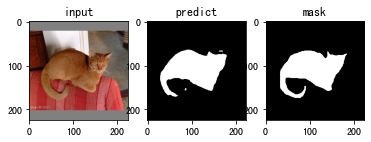

Epoch 1/1:   0%|          | 1/1470 [00:02<1:01:22,  2.51s/it, f_score=0.967]

['/openbayes/input/input3/test_image/Abyssinian_113.png'] : tensor(0.9038)
/openbayes/input/input3/test_image/Abyssinian_113.png
hd: 59.00847396772772
jc: 0.8245295851280888
sc: 0.9240345528455285
sp: 0.9897275086505191


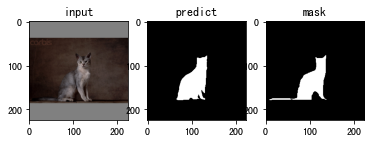

Epoch 1/1:   0%|          | 2/1470 [00:04<56:42,  2.32s/it, f_score=0.957]  

['/openbayes/input/input3/test_image/Abyssinian_120.png'] : tensor(0.9410)
/openbayes/input/input3/test_image/Abyssinian_120.png
hd: 9.848857801796104
jc: 0.8885483421565896
sc: 0.922476135377495
sp: 0.993897646895659


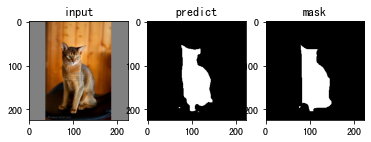

Epoch 1/1:   0%|          | 3/1470 [00:06<56:26,  2.31s/it, f_score=0.96] 

['/openbayes/input/input3/test_image/Abyssinian_130.png'] : tensor(0.6603)
/openbayes/input/input3/test_image/Abyssinian_130.png
hd: 27.16615541441225
jc: 0.4928253339930727
sc: 0.8708196721311475
sp: 0.9230499331155019


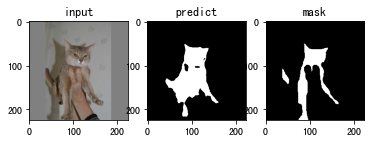

Epoch 1/1:   0%|          | 4/1470 [00:09<54:28,  2.23s/it, f_score=0.922]

['/openbayes/input/input3/test_image/Abyssinian_132.png'] : tensor(0.9141)
/openbayes/input/input3/test_image/Abyssinian_132.png
hd: 4.0
jc: 0.8418341061308604
sc: 0.9703087885985748
sp: 0.9947001567268828


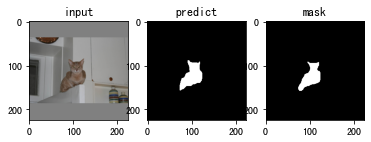

Epoch 1/1:   0%|          | 5/1470 [00:11<53:12,  2.18s/it, f_score=0.929]

['/openbayes/input/input3/test_image/Abyssinian_136.png'] : tensor(0.9488)
/openbayes/input/input3/test_image/Abyssinian_136.png
hd: 10.770329614269007
jc: 0.902673442333186
sc: 0.9666390630545368
sp: 0.9856434101095319


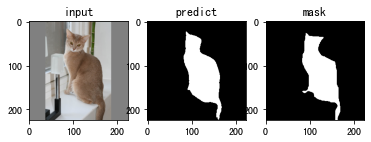

Epoch 1/1:   0%|          | 6/1470 [00:13<50:57,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Abyssinian_14.png'] : tensor(0.8419)
/openbayes/input/input3/test_image/Abyssinian_14.png
hd: 36.49657518178932
jc: 0.7269416049817883
sc: 0.918634001484781
sp: 0.9591169632374945


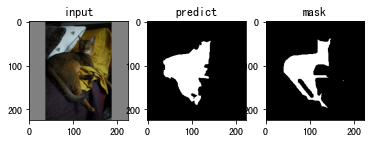

Epoch 1/1:   0%|          | 7/1470 [00:15<51:48,  2.12s/it, f_score=0.931]

['/openbayes/input/input3/test_image/Abyssinian_15.png'] : tensor(0.9633)
/openbayes/input/input3/test_image/Abyssinian_15.png
hd: 12.529964086141668
jc: 0.9291542199830577
sc: 0.9831116143032361
sp: 0.9575194975498654


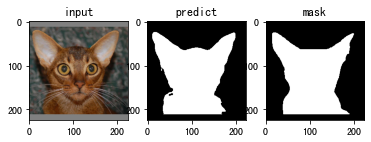

Epoch 1/1:   1%|          | 8/1470 [00:17<51:37,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Abyssinian_156.png'] : tensor(0.9531)
/openbayes/input/input3/test_image/Abyssinian_156.png
hd: 23.021728866442675
jc: 0.910368519675203
sc: 0.9365963371532612
sp: 0.9934131589901809


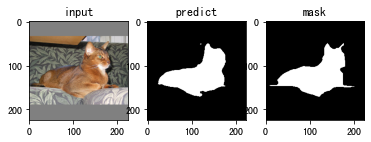

Epoch 1/1:   1%|          | 9/1470 [00:19<51:06,  2.10s/it, f_score=0.94] 

['/openbayes/input/input3/test_image/Abyssinian_159.png'] : tensor(0.9184)
/openbayes/input/input3/test_image/Abyssinian_159.png
hd: 14.866068747318506
jc: 0.8490636239613047
sc: 0.9174484052532833
sp: 0.9859296717703797


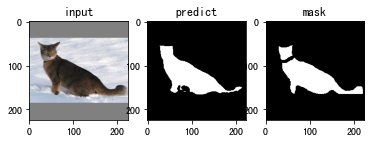

Epoch 1/1:   1%|          | 10/1470 [00:21<52:21,  2.15s/it, f_score=0.941]

['/openbayes/input/input3/test_image/Abyssinian_165.png'] : tensor(0.9525)
/openbayes/input/input3/test_image/Abyssinian_165.png
hd: 13.038404810405298
jc: 0.9093807934742306
sc: 0.9260685697024619
sp: 0.9934206963773217


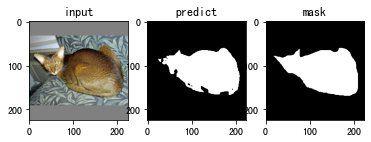

Epoch 1/1:   1%|          | 11/1470 [00:23<51:25,  2.11s/it, f_score=0.944]

['/openbayes/input/input3/test_image/Abyssinian_175.png'] : tensor(0.8503)
/openbayes/input/input3/test_image/Abyssinian_175.png
hd: 15.652475842498529
jc: 0.7396265560165975
sc: 0.9661246612466124
sp: 0.9756916060749473


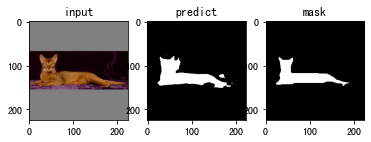

Epoch 1/1:   1%|          | 12/1470 [00:25<50:12,  2.07s/it, f_score=0.941]

['/openbayes/input/input3/test_image/Abyssinian_178.png'] : tensor(0.8088)
/openbayes/input/input3/test_image/Abyssinian_178.png
hd: 49.64876634922564
jc: 0.678996282527881
sc: 0.8078730579974568
sp: 0.8930162984200193


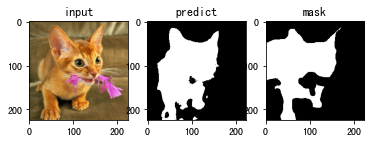

Epoch 1/1:   1%|          | 13/1470 [00:27<49:37,  2.04s/it, f_score=0.934]

['/openbayes/input/input3/test_image/Abyssinian_185.png'] : tensor(0.9276)
/openbayes/input/input3/test_image/Abyssinian_185.png
hd: 66.91038783328041
jc: 0.8649276301577015
sc: 0.9795107033639143
sp: 0.9359664163661089


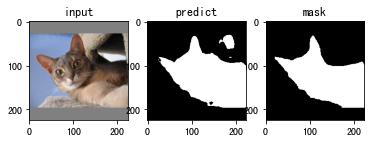

Epoch 1/1:   1%|          | 14/1470 [00:29<49:10,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Abyssinian_19.png'] : tensor(0.9410)
/openbayes/input/input3/test_image/Abyssinian_19.png
hd: 31.575306807693888
jc: 0.8886082344026269
sc: 0.9531292332701164
sp: 0.9794389177300974


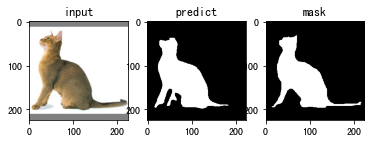

Epoch 1/1:   1%|          | 15/1470 [00:31<49:49,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Abyssinian_191.png'] : tensor(0.9700)
/openbayes/input/input3/test_image/Abyssinian_191.png
hd: 19.4164878389476
jc: 0.9417894358605821
sc: 0.9643829568032968
sp: 0.9910897313253342


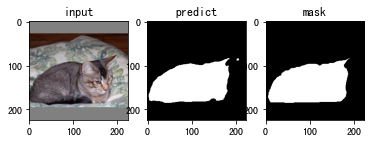

Epoch 1/1:   1%|          | 16/1470 [00:33<49:53,  2.06s/it, f_score=0.94] 

['/openbayes/input/input3/test_image/Abyssinian_2.png'] : tensor(0.9223)
/openbayes/input/input3/test_image/Abyssinian_2.png
hd: 76.00657866263946
jc: 0.8557825006900359
sc: 0.9230425721941053
sp: 0.987850338257628


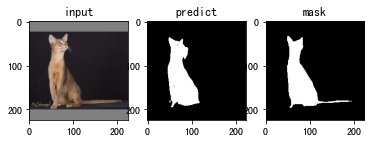

Epoch 1/1:   1%|          | 17/1470 [00:35<49:32,  2.05s/it, f_score=0.941]

['/openbayes/input/input3/test_image/Abyssinian_205.png'] : tensor(0.8224)
/openbayes/input/input3/test_image/Abyssinian_205.png
hd: 19.4164878389476
jc: 0.6984200314145801
sc: 0.8417594654788418
sp: 0.9552626468589184


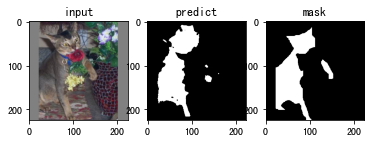

Epoch 1/1:   1%|          | 18/1470 [00:38<50:43,  2.10s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Abyssinian_215.png'] : tensor(0.8862)
/openbayes/input/input3/test_image/Abyssinian_215.png
hd: 33.015148038438355
jc: 0.7955906110424784
sc: 0.9111885067479321
sp: 0.9674294915585049


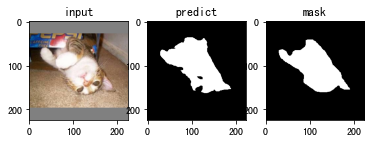

Epoch 1/1:   1%|▏         | 19/1470 [00:40<50:07,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Abyssinian_221.png'] : tensor(0.9446)
/openbayes/input/input3/test_image/Abyssinian_221.png
hd: 20.8806130178211
jc: 0.8949481601951617
sc: 0.945551200128873
sp: 0.9666275789940735


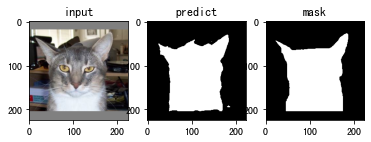

Epoch 1/1:   1%|▏         | 20/1470 [00:42<50:06,  2.07s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Abyssinian_29.png'] : tensor(0.8744)
/openbayes/input/input3/test_image/Abyssinian_29.png
hd: 21.95449840010015
jc: 0.7768121301775148
sc: 0.9015021459227468
sp: 0.983566218472625


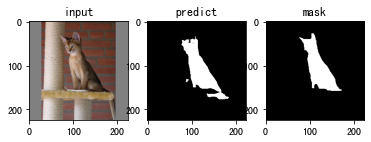

Epoch 1/1:   1%|▏         | 21/1470 [00:44<51:23,  2.13s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Abyssinian_31.png'] : tensor(0.9444)
/openbayes/input/input3/test_image/Abyssinian_31.png
hd: 27.0
jc: 0.8947251609084856
sc: 0.9109671587827659
sp: 0.9934688346883469


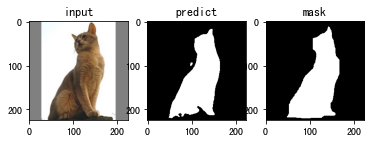

Epoch 1/1:   1%|▏         | 22/1470 [00:46<50:04,  2.07s/it, f_score=0.939]

['/openbayes/input/input3/test_image/Abyssinian_36.png'] : tensor(0.8524)
/openbayes/input/input3/test_image/Abyssinian_36.png
hd: 24.596747752497688
jc: 0.7428360413589364
sc: 0.9610166252627556
sp: 0.9658011258705471


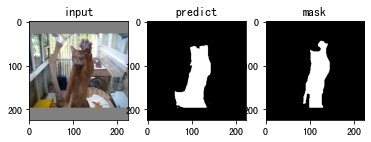

Epoch 1/1:   2%|▏         | 23/1470 [00:48<48:10,  2.00s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Abyssinian_43.png'] : tensor(0.8798)
/openbayes/input/input3/test_image/Abyssinian_43.png
hd: 17.08800749063506
jc: 0.785473411154345
sc: 0.8822843822843823
sp: 0.9909507102515831


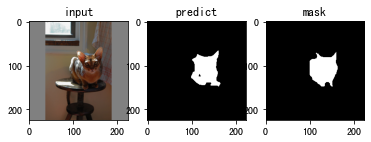

Epoch 1/1:   2%|▏         | 24/1470 [00:50<49:21,  2.05s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Abyssinian_44.png'] : tensor(0.9409)
/openbayes/input/input3/test_image/Abyssinian_44.png
hd: 18.110770276274835
jc: 0.8884829840415305
sc: 0.9665341978665551
sp: 0.9793174767321613


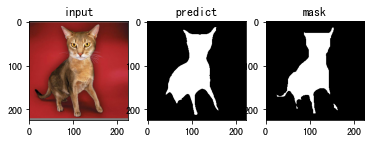

Epoch 1/1:   2%|▏         | 25/1470 [00:52<49:02,  2.04s/it, f_score=0.939]

['/openbayes/input/input3/test_image/Abyssinian_46.png'] : tensor(0.8778)
/openbayes/input/input3/test_image/Abyssinian_46.png
hd: 18.439088914585774
jc: 0.7821782178217822
sc: 0.9066564651874521
sp: 0.9865095665333478


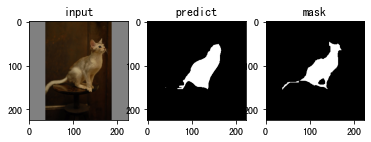

Epoch 1/1:   2%|▏         | 26/1470 [00:54<49:58,  2.08s/it, f_score=0.939]

['/openbayes/input/input3/test_image/Abyssinian_49.png'] : tensor(0.9023)
/openbayes/input/input3/test_image/Abyssinian_49.png
hd: 27.51363298439521
jc: 0.8219539272828199
sc: 0.8321547323561093
sp: 0.9908059535787392


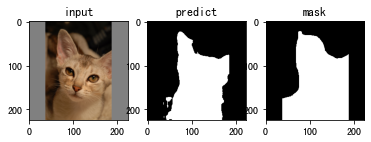

Epoch 1/1:   2%|▏         | 27/1470 [00:56<49:37,  2.06s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Abyssinian_52.png'] : tensor(0.9109)
/openbayes/input/input3/test_image/Abyssinian_52.png
hd: 22.02271554554524
jc: 0.8363371909188643
sc: 0.9792669381710477
sp: 0.9370619835837583


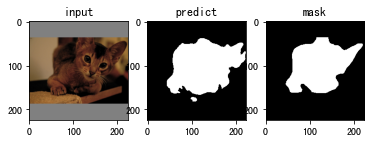

Epoch 1/1:   2%|▏         | 28/1470 [00:58<49:49,  2.07s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Abyssinian_55.png'] : tensor(0.9625)
/openbayes/input/input3/test_image/Abyssinian_55.png
hd: 20.615528128088304
jc: 0.927682119205298
sc: 0.9535924067374645
sp: 0.9706567493563284


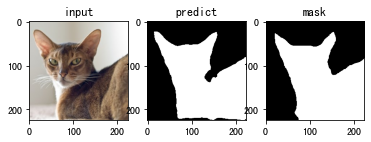

Epoch 1/1:   2%|▏         | 29/1470 [01:00<50:04,  2.08s/it, f_score=0.939]

['/openbayes/input/input3/test_image/Abyssinian_56.png'] : tensor(0.9609)
/openbayes/input/input3/test_image/Abyssinian_56.png
hd: 5.0
jc: 0.9246913580246914
sc: 0.9909592061742006
sp: 0.9841872232764073


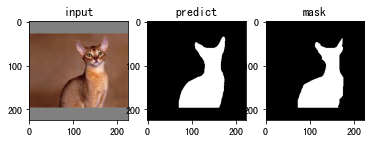

Epoch 1/1:   2%|▏         | 30/1470 [01:02<49:34,  2.07s/it, f_score=0.94] 

['/openbayes/input/input3/test_image/Abyssinian_60.png'] : tensor(0.8325)
/openbayes/input/input3/test_image/Abyssinian_60.png
hd: 16.401219466856727
jc: 0.7130267766354085
sc: 0.883646037524503
sp: 0.960287214760422


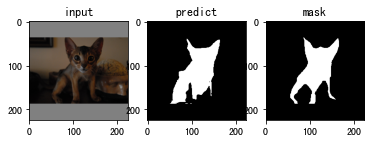

Epoch 1/1:   2%|▏         | 31/1470 [01:04<49:31,  2.06s/it, f_score=0.939]

['/openbayes/input/input3/test_image/Abyssinian_63.png'] : tensor(0.9550)
/openbayes/input/input3/test_image/Abyssinian_63.png
hd: 11.313708498984761
jc: 0.9137903694698452
sc: 0.9904892861235247
sp: 0.9552288979891205


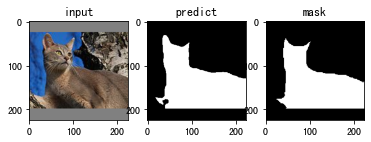

Epoch 1/1:   2%|▏         | 32/1470 [01:06<49:12,  2.05s/it, f_score=0.94] 

['/openbayes/input/input3/test_image/Abyssinian_66.png'] : tensor(0.9207)
/openbayes/input/input3/test_image/Abyssinian_66.png
hd: 12.041594578792296
jc: 0.853043637697103
sc: 0.8687330781439642
sp: 0.9950082351450652


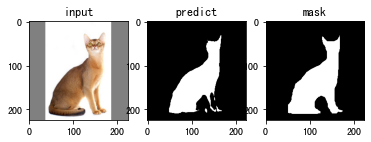

Epoch 1/1:   2%|▏         | 33/1470 [01:08<47:38,  1.99s/it, f_score=0.94]

['/openbayes/input/input3/test_image/Abyssinian_67.png'] : tensor(0.9152)
/openbayes/input/input3/test_image/Abyssinian_67.png
hd: 18.027756377319946
jc: 0.843710292249047
sc: 0.9422449269192564
sp: 0.9809177119803381


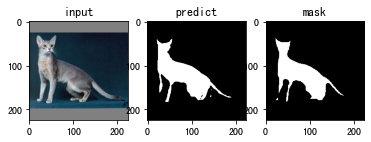

Epoch 1/1:   2%|▏         | 34/1470 [01:10<46:59,  1.96s/it, f_score=0.94]

['/openbayes/input/input3/test_image/Abyssinian_69.png'] : tensor(0.8991)
/openbayes/input/input3/test_image/Abyssinian_69.png
hd: 16.55294535724685
jc: 0.8166277210675194
sc: 0.9263392857142857
sp: 0.9776088169642857


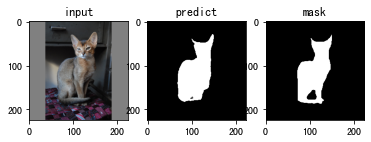

Epoch 1/1:   2%|▏         | 35/1470 [01:12<46:22,  1.94s/it, f_score=0.94]

['/openbayes/input/input3/test_image/Abyssinian_9.png'] : tensor(0.9399)
/openbayes/input/input3/test_image/Abyssinian_9.png
hd: 17.4928556845359
jc: 0.8866464850319542
sc: 0.9457350435016594
sp: 0.9809618981730597


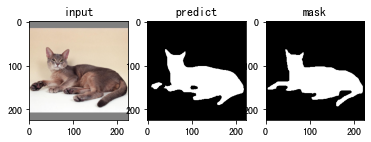

Epoch 1/1:   2%|▏         | 36/1470 [01:14<47:11,  1.97s/it, f_score=0.941]

['/openbayes/input/input3/test_image/Abyssinian_92.png'] : tensor(0.9398)
/openbayes/input/input3/test_image/Abyssinian_92.png
hd: 23.0
jc: 0.8863903511013441
sc: 0.9420966865833786
sp: 0.96357740980923


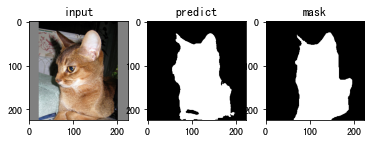

Epoch 1/1:   3%|▎         | 37/1470 [01:16<47:18,  1.98s/it, f_score=0.941]

['/openbayes/input/input3/test_image/Abyssinian_94.png'] : tensor(0.6339)
/openbayes/input/input3/test_image/Abyssinian_94.png
hd: 84.0535543567314
jc: 0.4640231092436975
sc: 0.49385131358300727
sp: 0.9893072989307299


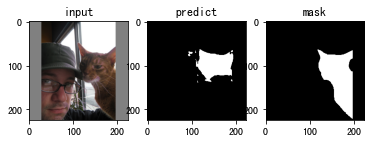

Epoch 1/1:   3%|▎         | 38/1470 [01:18<46:42,  1.96s/it, f_score=0.937]

['/openbayes/input/input3/test_image/american_bulldog_109.png'] : tensor(0.8734)
/openbayes/input/input3/test_image/american_bulldog_109.png
hd: 11.180339887498949
jc: 0.7751871042026482
sc: 0.8365952159055607
sp: 0.9945694997550951


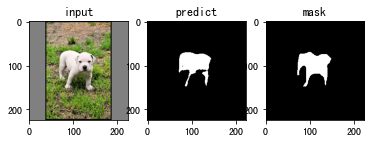

Epoch 1/1:   3%|▎         | 39/1470 [01:20<46:11,  1.94s/it, f_score=0.937]

['/openbayes/input/input3/test_image/american_bulldog_115.png'] : tensor(0.9280)
/openbayes/input/input3/test_image/american_bulldog_115.png
hd: 7.810249675906654
jc: 0.8656282450674974
sc: 0.9690769588467798
sp: 0.9887956403269754


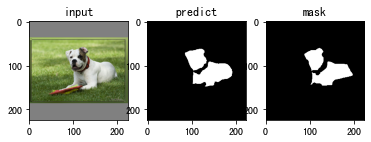

Epoch 1/1:   3%|▎         | 40/1470 [01:22<48:10,  2.02s/it, f_score=0.938]

['/openbayes/input/input3/test_image/american_bulldog_121.png'] : tensor(0.7105)
/openbayes/input/input3/test_image/american_bulldog_121.png
hd: 110.07270324653611
jc: 0.5509483899426555
sc: 0.8734265734265734
sp: 0.9828293603577729


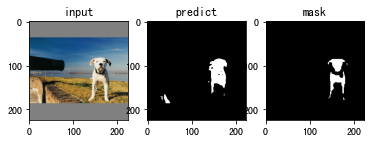

Epoch 1/1:   3%|▎         | 41/1470 [01:24<46:59,  1.97s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_126.png'] : tensor(0.8910)
/openbayes/input/input3/test_image/american_bulldog_126.png
hd: 31.78049716414141
jc: 0.8035056827277093
sc: 0.9618664367155313
sp: 0.9482372480434837


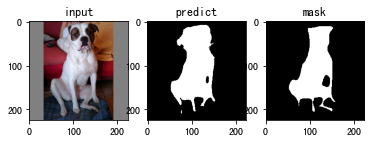

Epoch 1/1:   3%|▎         | 42/1470 [01:26<46:30,  1.95s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_129.png'] : tensor(0.9022)
/openbayes/input/input3/test_image/american_bulldog_129.png
hd: 30.23243291566195
jc: 0.8218822919367385
sc: 0.955106959927689
sp: 0.9598697133195754


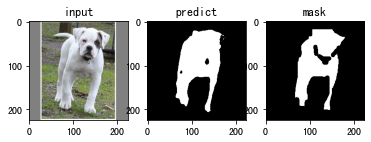

Epoch 1/1:   3%|▎         | 43/1470 [01:28<48:07,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_131.png'] : tensor(0.9599)
/openbayes/input/input3/test_image/american_bulldog_131.png
hd: 21.213203435596427
jc: 0.9228133453561768
sc: 0.9754098360655737
sp: 0.9849309545408729


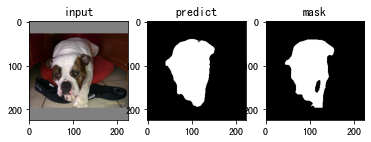

Epoch 1/1:   3%|▎         | 44/1470 [01:30<49:50,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_138.png'] : tensor(0.8498)
/openbayes/input/input3/test_image/american_bulldog_138.png
hd: 21.02379604162864
jc: 0.7388213476200288
sc: 0.8289215119639348
sp: 0.9745936183022276


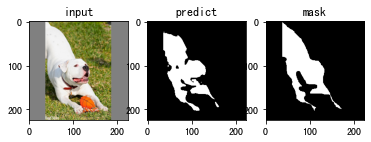

Epoch 1/1:   3%|▎         | 45/1470 [01:32<48:44,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_142.png'] : tensor(0.9150)
/openbayes/input/input3/test_image/american_bulldog_142.png
hd: 65.80273550544841
jc: 0.8433624253559945
sc: 0.9018947368421053
sp: 0.9724711907810499


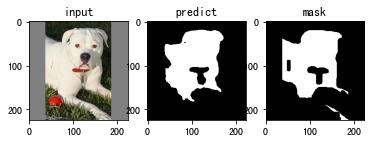

Epoch 1/1:   3%|▎         | 46/1470 [01:34<49:03,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_143.png'] : tensor(0.8668)
/openbayes/input/input3/test_image/american_bulldog_143.png
hd: 42.638011210655684
jc: 0.764878621769773
sc: 0.8093215950284827
sp: 0.9636493228795439


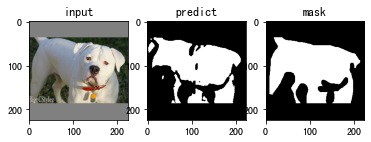

Epoch 1/1:   3%|▎         | 47/1470 [01:36<48:43,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_148.png'] : tensor(0.9386)
/openbayes/input/input3/test_image/american_bulldog_148.png
hd: 13.0
jc: 0.8843143561702584
sc: 0.8941890719861232
sp: 0.9974848603242821


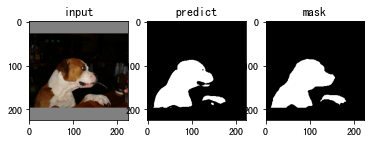

Epoch 1/1:   3%|▎         | 48/1470 [01:39<49:14,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_149.png'] : tensor(0.8920)
/openbayes/input/input3/test_image/american_bulldog_149.png
hd: 11.0
jc: 0.805098493626883
sc: 0.8241992882562278
sp: 0.9978242422923783


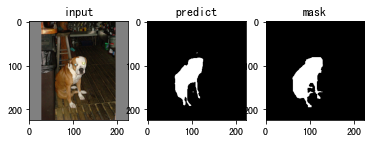

Epoch 1/1:   3%|▎         | 49/1470 [01:41<49:10,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_166.png'] : tensor(0.9219)
/openbayes/input/input3/test_image/american_bulldog_166.png
hd: 74.84650960465692
jc: 0.8550677100417038
sc: 0.8766754744174874
sp: 0.9820850788460883


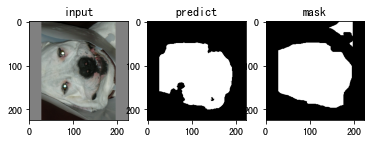

Epoch 1/1:   3%|▎         | 50/1470 [01:43<48:22,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_178.png'] : tensor(0.8250)
/openbayes/input/input3/test_image/american_bulldog_178.png
hd: 23.769728648009426
jc: 0.702113606340819
sc: 0.7211668928086838
sp: 0.9973772784893125


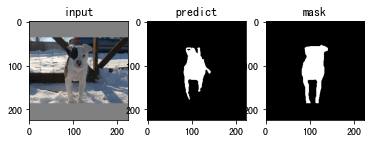

Epoch 1/1:   3%|▎         | 51/1470 [01:45<47:58,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_191.png'] : tensor(0.8932)
/openbayes/input/input3/test_image/american_bulldog_191.png
hd: 20.518284528683193
jc: 0.8070336391437309
sc: 0.8185483870967742
sp: 0.997896084888401


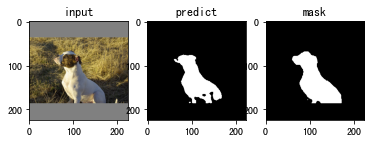

Epoch 1/1:   4%|▎         | 52/1470 [01:47<48:26,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_199.png'] : tensor(0.9323)
/openbayes/input/input3/test_image/american_bulldog_199.png
hd: 18.027756377319946
jc: 0.8731397023523764
sc: 0.9415647447097651
sp: 0.9651239812228206


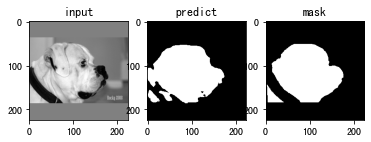

Epoch 1/1:   4%|▎         | 53/1470 [01:49<47:10,  2.00s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_200.png'] : tensor(0.9083)
/openbayes/input/input3/test_image/american_bulldog_200.png
hd: 20.248456731316587
jc: 0.8320333955838735
sc: 0.926596525568877
sp: 0.97788200561878


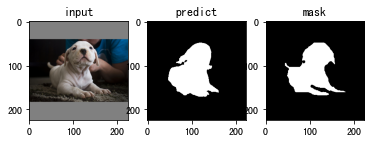

Epoch 1/1:   4%|▎         | 54/1470 [01:51<48:38,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_205.png'] : tensor(0.8712)
/openbayes/input/input3/test_image/american_bulldog_205.png
hd: 29.832867780352597
jc: 0.7717728910423655
sc: 0.9339948879867689
sp: 0.9678805284319356


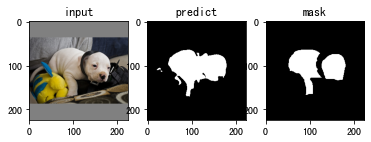

Epoch 1/1:   4%|▎         | 55/1470 [01:53<48:01,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_214.png'] : tensor(0.8876)
/openbayes/input/input3/test_image/american_bulldog_214.png
hd: 26.0
jc: 0.7979137783059351
sc: 0.9160918668991131
sp: 0.9471649136089555


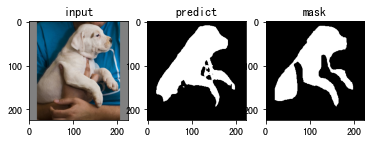

Epoch 1/1:   4%|▍         | 56/1470 [01:55<48:57,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_216.png'] : tensor(0.8200)
/openbayes/input/input3/test_image/american_bulldog_216.png
hd: 53.53503525729669
jc: 0.694893173527879
sc: 0.9732688623300794
sp: 0.8880275404819584


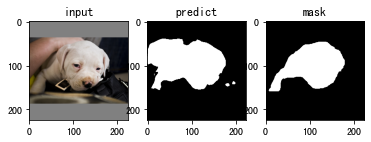

Epoch 1/1:   4%|▍         | 57/1470 [01:57<48:23,  2.05s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_bulldog_26.png'] : tensor(0.9474)
/openbayes/input/input3/test_image/american_bulldog_26.png
hd: 12.529964086141668
jc: 0.9001224989791752
sc: 0.9422123439904257
sp: 0.9857840844118717


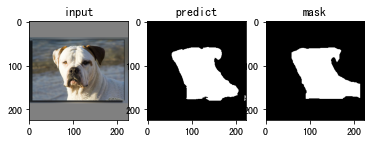

Epoch 1/1:   4%|▍         | 58/1470 [01:59<47:50,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_28.png'] : tensor(0.8792)
/openbayes/input/input3/test_image/american_bulldog_28.png
hd: 15.0
jc: 0.7845056065239552
sc: 0.8568247606323759
sp: 0.9909379446207727


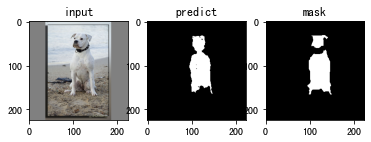

Epoch 1/1:   4%|▍         | 59/1470 [02:01<48:57,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_29.png'] : tensor(0.9339)
/openbayes/input/input3/test_image/american_bulldog_29.png
hd: 10.295630140987
jc: 0.876011690647482
sc: 0.9427776433583354
sp: 0.9849677881173944


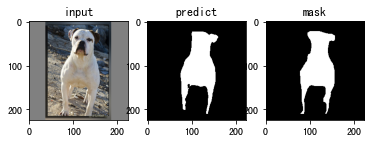

Epoch 1/1:   4%|▍         | 60/1470 [02:03<48:53,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_38.png'] : tensor(0.9285)
/openbayes/input/input3/test_image/american_bulldog_38.png
hd: 34.23448553724738
jc: 0.866567901234568
sc: 0.8991596638655462
sp: 0.9909198871789796


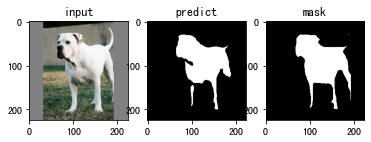

Epoch 1/1:   4%|▍         | 61/1470 [02:05<48:31,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_45.png'] : tensor(0.8388)
/openbayes/input/input3/test_image/american_bulldog_45.png
hd: 24.0
jc: 0.7223345464348295
sc: 0.8575772123539767
sp: 0.9733649008582421


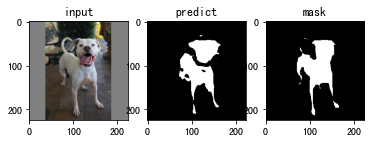

Epoch 1/1:   4%|▍         | 62/1470 [02:07<48:35,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_50.png'] : tensor(0.8427)
/openbayes/input/input3/test_image/american_bulldog_50.png
hd: 17.08800749063506
jc: 0.7281343843843844
sc: 0.8427283588573912
sp: 0.9646317947716566


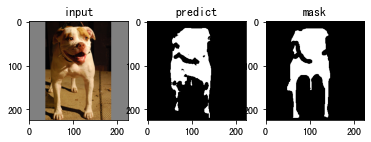

Epoch 1/1:   4%|▍         | 63/1470 [02:09<47:37,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_51.png'] : tensor(0.9152)
/openbayes/input/input3/test_image/american_bulldog_51.png
hd: 18.867962264113206
jc: 0.8436781609195402
sc: 0.9087157477715417
sp: 0.9894147513486559


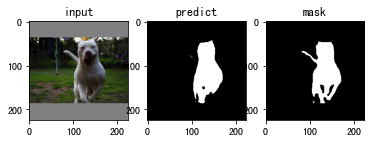

Epoch 1/1:   4%|▍         | 64/1470 [02:11<48:24,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_58.png'] : tensor(0.9243)
/openbayes/input/input3/test_image/american_bulldog_58.png
hd: 13.45362404707371
jc: 0.859333504668894
sc: 0.9166590514484145
sp: 0.9813932148956236


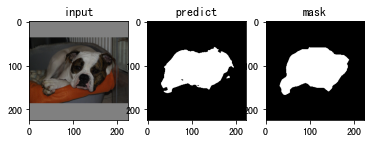

Epoch 1/1:   4%|▍         | 65/1470 [02:14<49:47,  2.13s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_64.png'] : tensor(0.9298)
/openbayes/input/input3/test_image/american_bulldog_64.png
hd: 34.48187929913333
jc: 0.8688686364427933
sc: 0.9158100832109642
sp: 0.9739004492787893


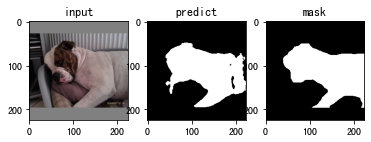

Epoch 1/1:   4%|▍         | 66/1470 [02:16<49:46,  2.13s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_68.png'] : tensor(0.8982)
/openbayes/input/input3/test_image/american_bulldog_68.png
hd: 20.09975124224178
jc: 0.8152565256525652
sc: 0.9457060819629339
sp: 0.9867731146833532


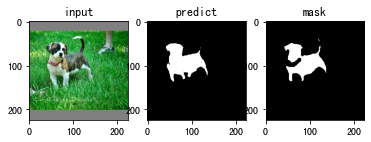

Epoch 1/1:   5%|▍         | 67/1470 [02:18<48:16,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/american_bulldog_70.png'] : tensor(0.8115)
/openbayes/input/input3/test_image/american_bulldog_70.png
hd: 42.0
jc: 0.6827764233471963
sc: 0.7218010915706489
sp: 0.9796128055375297


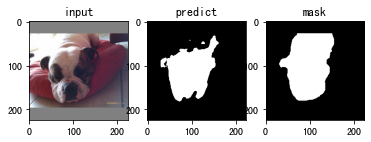

Epoch 1/1:   5%|▍         | 68/1470 [02:20<48:23,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_bulldog_76.png'] : tensor(0.8240)
/openbayes/input/input3/test_image/american_bulldog_76.png
hd: 11.40175425099138
jc: 0.7007160909856782
sc: 0.8532957168504745
sp: 0.9816539533677637


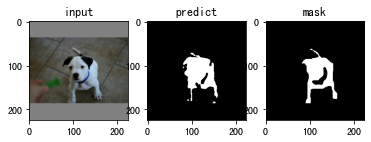

Epoch 1/1:   5%|▍         | 69/1470 [02:22<48:00,  2.06s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_bulldog_78.png'] : tensor(0.8487)
/openbayes/input/input3/test_image/american_bulldog_78.png
hd: 29.614185789921695
jc: 0.7371669661692319
sc: 0.8232984293193717
sp: 0.9654148155801219


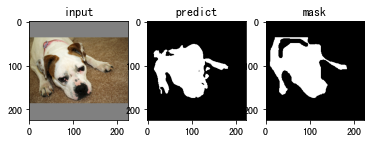

Epoch 1/1:   5%|▍         | 70/1470 [02:24<47:44,  2.05s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_bulldog_87.png'] : tensor(0.8434)
/openbayes/input/input3/test_image/american_bulldog_87.png
hd: 36.87817782917155
jc: 0.7291366330289925
sc: 0.7734481196193929
sp: 0.9670049200492005


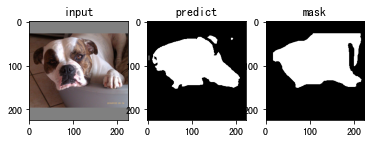

Epoch 1/1:   5%|▍         | 71/1470 [02:26<47:36,  2.04s/it, f_score=0.933]

['/openbayes/input/input3/test_image/american_bulldog_97.png'] : tensor(0.8231)
/openbayes/input/input3/test_image/american_bulldog_97.png
hd: 19.79898987322333
jc: 0.6993548387096774
sc: 0.7725199543899658
sp: 0.9921359389731722


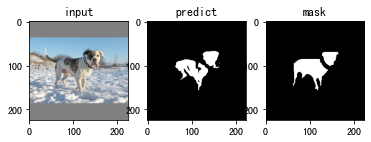

Epoch 1/1:   5%|▍         | 72/1470 [02:28<46:59,  2.02s/it, f_score=0.933]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_1.png'] : tensor(0.8816)
/openbayes/input/input3/test_image/american_pit_bull_terrier_1.png
hd: 48.75448697299562
jc: 0.7882130475890324
sc: 0.9053393665158371
sp: 0.9816129537972273


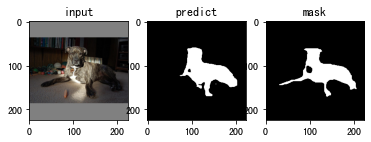

Epoch 1/1:   5%|▍         | 73/1470 [02:30<47:54,  2.06s/it, f_score=0.933]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_103.png'] : tensor(0.9720)
/openbayes/input/input3/test_image/american_pit_bull_terrier_103.png
hd: 14.7648230602334
jc: 0.9455510458944739
sc: 0.9701454289192133
sp: 0.988254693783088


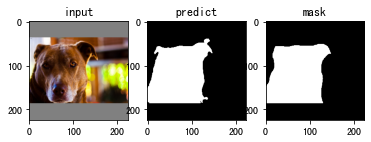

Epoch 1/1:   5%|▌         | 74/1470 [02:32<47:42,  2.05s/it, f_score=0.933]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_104.png'] : tensor(0.9534)
/openbayes/input/input3/test_image/american_pit_bull_terrier_104.png
hd: 25.0
jc: 0.9109565807327001
sc: 0.9447669305189094
sp: 0.9808882582047643


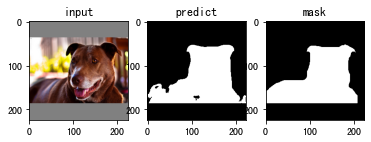

Epoch 1/1:   5%|▌         | 75/1470 [02:34<47:00,  2.02s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_122.png'] : tensor(0.9458)
/openbayes/input/input3/test_image/american_pit_bull_terrier_122.png
hd: 14.866068747318506
jc: 0.8971768613340714
sc: 0.9604444444444444
sp: 0.98903882466725


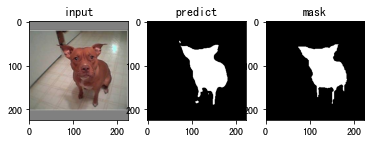

Epoch 1/1:   5%|▌         | 76/1470 [02:36<47:46,  2.06s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_147.png'] : tensor(0.8817)
/openbayes/input/input3/test_image/american_pit_bull_terrier_147.png
hd: 14.7648230602334
jc: 0.7883803959753327
sc: 0.8684304612084376
sp: 0.9872594320577812


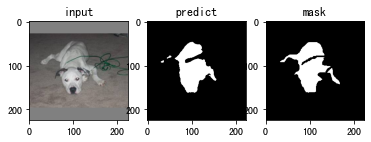

Epoch 1/1:   5%|▌         | 77/1470 [02:38<46:33,  2.01s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_15.png'] : tensor(0.8228)
/openbayes/input/input3/test_image/american_pit_bull_terrier_15.png
hd: 26.1725046566048
jc: 0.6989711251244607
sc: 0.8147001934235977
sp: 0.9910067029480364


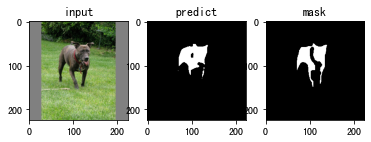

Epoch 1/1:   5%|▌         | 78/1470 [02:40<46:03,  1.99s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_150.png'] : tensor(0.8951)
/openbayes/input/input3/test_image/american_pit_bull_terrier_150.png
hd: 31.38470965295043
jc: 0.8101983002832861
sc: 0.9236980218005651
sp: 0.9540895980524463


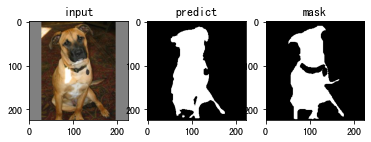

Epoch 1/1:   5%|▌         | 79/1470 [02:42<47:38,  2.05s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_151.png'] : tensor(0.9149)
/openbayes/input/input3/test_image/american_pit_bull_terrier_151.png
hd: 38.47076812334269
jc: 0.8431251288394146
sc: 0.8998899889988999
sp: 0.9851044151292411


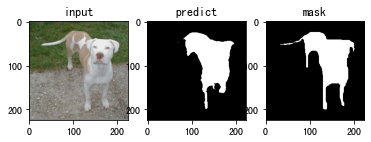

Epoch 1/1:   5%|▌         | 80/1470 [02:44<48:26,  2.09s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_154.png'] : tensor(0.9092)
/openbayes/input/input3/test_image/american_pit_bull_terrier_154.png
hd: 11.40175425099138
jc: 0.8334395581049501
sc: 0.9133876600698486
sp: 0.9910202480329549


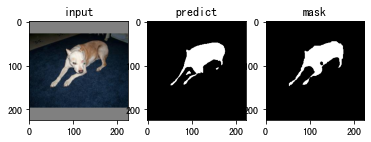

Epoch 1/1:   6%|▌         | 81/1470 [02:46<47:48,  2.07s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_158.png'] : tensor(0.9119)
/openbayes/input/input3/test_image/american_pit_bull_terrier_158.png
hd: 16.64331697709324
jc: 0.8380037363223912
sc: 0.8986834573554665
sp: 0.9808787222250214


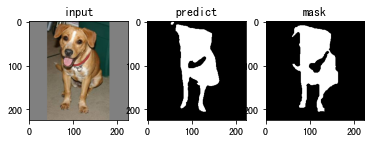

Epoch 1/1:   6%|▌         | 82/1470 [02:49<49:13,  2.13s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_16.png'] : tensor(0.9177)
/openbayes/input/input3/test_image/american_pit_bull_terrier_16.png
hd: 21.0
jc: 0.8478795910639909
sc: 0.9791211193703542
sp: 0.9654869844983913


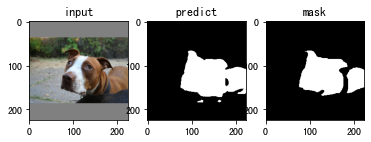

Epoch 1/1:   6%|▌         | 83/1470 [02:51<50:09,  2.17s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_162.png'] : tensor(0.9187)
/openbayes/input/input3/test_image/american_pit_bull_terrier_162.png
hd: 80.02499609497022
jc: 0.8496072589382448
sc: 0.8977532913566113
sp: 0.9781215469613259


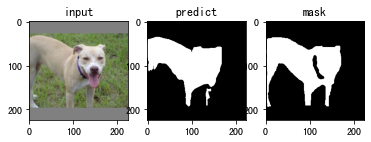

Epoch 1/1:   6%|▌         | 84/1470 [02:53<49:45,  2.15s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_164.png'] : tensor(0.8761)
/openbayes/input/input3/test_image/american_pit_bull_terrier_164.png
hd: 37.73592452822641
jc: 0.7794572615575002
sc: 0.8363843308356256
sp: 0.980571745767416


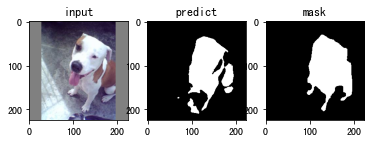

Epoch 1/1:   6%|▌         | 85/1470 [02:55<48:54,  2.12s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_18.png'] : tensor(0.8565)
/openbayes/input/input3/test_image/american_pit_bull_terrier_18.png
hd: 23.345235059857504
jc: 0.7490489475019021
sc: 0.8929705215419501
sp: 0.9311968819357982


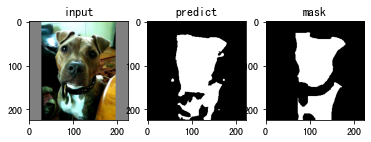

Epoch 1/1:   6%|▌         | 86/1470 [02:57<48:26,  2.10s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_184.png'] : tensor(0.9409)
/openbayes/input/input3/test_image/american_pit_bull_terrier_184.png
hd: 18.601075237738275
jc: 0.8883684621389539
sc: 0.9500751377525464
sp: 0.978218754908634


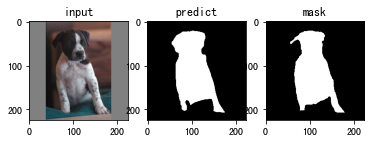

Epoch 1/1:   6%|▌         | 87/1470 [02:59<47:57,  2.08s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_186.png'] : tensor(0.7739)
/openbayes/input/input3/test_image/american_pit_bull_terrier_186.png
hd: 25.709920264364882
jc: 0.6312292358803987
sc: 0.8755760368663594
sp: 0.9692817346785123


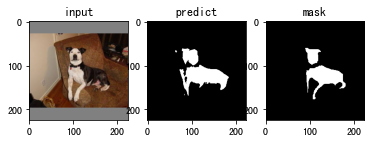

Epoch 1/1:   6%|▌         | 88/1470 [03:01<47:39,  2.07s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_190.png'] : tensor(0.8457)
/openbayes/input/input3/test_image/american_pit_bull_terrier_190.png
hd: 24.758836806279895
jc: 0.7326505765236697
sc: 0.8498795380908865
sp: 0.9495005112876583


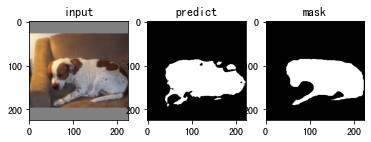

Epoch 1/1:   6%|▌         | 89/1470 [03:03<48:23,  2.10s/it, f_score=0.933]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_193.png'] : tensor(0.9266)
/openbayes/input/input3/test_image/american_pit_bull_terrier_193.png
hd: 17.804493814764857
jc: 0.8632633357470432
sc: 0.9441034778591698
sp: 0.959483767809725


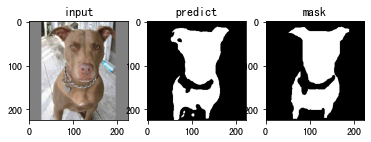

Epoch 1/1:   6%|▌         | 90/1470 [03:05<46:47,  2.03s/it, f_score=0.933]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_194.png'] : tensor(0.9427)
/openbayes/input/input3/test_image/american_pit_bull_terrier_194.png
hd: 12.165525060596439
jc: 0.8915981198589894
sc: 0.9549029889879391
sp: 0.9833419453261485


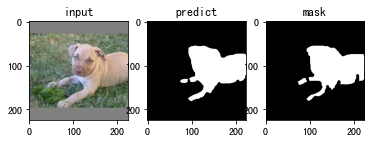

Epoch 1/1:   6%|▌         | 91/1470 [03:07<47:10,  2.05s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_200.png'] : tensor(0.7965)
/openbayes/input/input3/test_image/american_pit_bull_terrier_200.png
hd: 18.439088914585774
jc: 0.6618692253020612
sc: 0.9141104294478528
sp: 0.9663130951606256


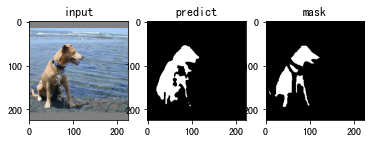

Epoch 1/1:   6%|▋         | 92/1470 [03:09<46:06,  2.01s/it, f_score=0.933]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_204.png'] : tensor(0.8315)
/openbayes/input/input3/test_image/american_pit_bull_terrier_204.png
hd: 31.0
jc: 0.7115874363327674
sc: 0.8004296968250179
sp: 0.988627220736295


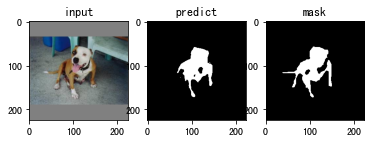

Epoch 1/1:   6%|▋         | 93/1470 [03:11<46:13,  2.01s/it, f_score=0.933]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_23.png'] : tensor(0.9216)
/openbayes/input/input3/test_image/american_pit_bull_terrier_23.png
hd: 20.518284528683193
jc: 0.8546831241572451
sc: 0.9251150780285169
sp: 0.9546381558618132


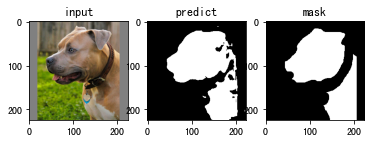

Epoch 1/1:   6%|▋         | 94/1470 [03:13<46:10,  2.01s/it, f_score=0.933]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_27.png'] : tensor(0.9170)
/openbayes/input/input3/test_image/american_pit_bull_terrier_27.png
hd: 20.808652046684813
jc: 0.8467248908296944
sc: 0.9242135367016205
sp: 0.9816197587593337


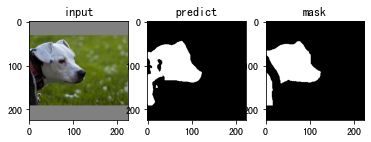

Epoch 1/1:   6%|▋         | 95/1470 [03:15<46:38,  2.04s/it, f_score=0.933]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_29.png'] : tensor(0.9669)
/openbayes/input/input3/test_image/american_pit_bull_terrier_29.png
hd: 7.810249675906654
jc: 0.9359296482412061
sc: 0.9585312747426762
sp: 0.9939109602715113


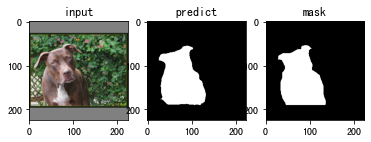

Epoch 1/1:   7%|▋         | 96/1470 [03:17<46:12,  2.02s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_31.png'] : tensor(0.9093)
/openbayes/input/input3/test_image/american_pit_bull_terrier_31.png
hd: 25.0
jc: 0.8336798336798337
sc: 0.8760240305843802
sp: 0.991318958274993


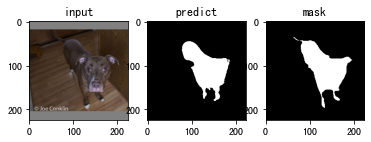

Epoch 1/1:   7%|▋         | 97/1470 [03:19<45:56,  2.01s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_39.png'] : tensor(0.9477)
/openbayes/input/input3/test_image/american_pit_bull_terrier_39.png
hd: 28.844410203711913
jc: 0.9005616543272913
sc: 0.9770791496433765
sp: 0.965663914929341


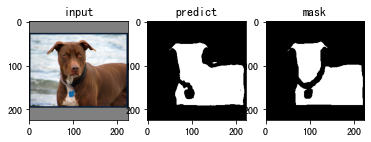

Epoch 1/1:   7%|▋         | 98/1470 [03:22<47:28,  2.08s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_43.png'] : tensor(0.9157)
/openbayes/input/input3/test_image/american_pit_bull_terrier_43.png
hd: 17.26267650163207
jc: 0.8445796460176991
sc: 0.9693186627168853
sp: 0.9657204596797957


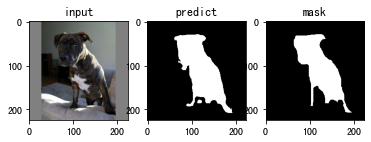

Epoch 1/1:   7%|▋         | 99/1470 [03:24<46:56,  2.05s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_45.png'] : tensor(0.9012)
/openbayes/input/input3/test_image/american_pit_bull_terrier_45.png
hd: 21.213203435596427
jc: 0.820201318986463
sc: 0.8697092381302908
sp: 0.9965443856802714


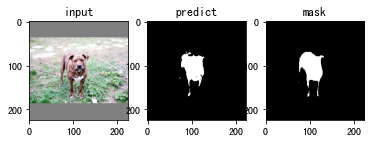

Epoch 1/1:   7%|▋         | 100/1470 [03:26<46:24,  2.03s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_49.png'] : tensor(0.9219)
/openbayes/input/input3/test_image/american_pit_bull_terrier_49.png
hd: 14.317821063276353
jc: 0.8551634430494288
sc: 0.8906756199564116
sp: 0.9787644206150787


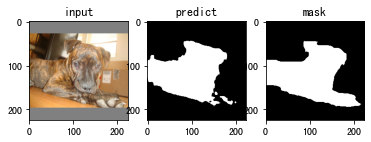

Epoch 1/1:   7%|▋         | 101/1470 [03:28<46:53,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_52.png'] : tensor(0.9569)
/openbayes/input/input3/test_image/american_pit_bull_terrier_52.png
hd: 21.633307652783937
jc: 0.9173671570099069
sc: 0.963579030350808
sp: 0.9829559094182604


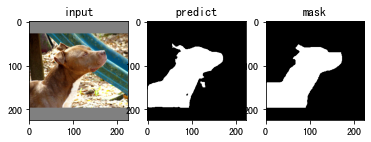

Epoch 1/1:   7%|▋         | 102/1470 [03:30<47:17,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_58.png'] : tensor(0.9526)
/openbayes/input/input3/test_image/american_pit_bull_terrier_58.png
hd: 22.0
jc: 0.9095335544421707
sc: 0.9156720659278204
sp: 0.9913730475844533


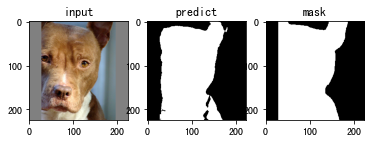

Epoch 1/1:   7%|▋         | 103/1470 [03:32<47:53,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_6.png'] : tensor(0.7124)
/openbayes/input/input3/test_image/american_pit_bull_terrier_6.png
hd: 70.71067811865476
jc: 0.5533209843874041
sc: 0.8745294855708908
sp: 0.93884654359607


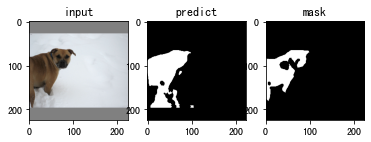

Epoch 1/1:   7%|▋         | 104/1470 [03:34<46:48,  2.06s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_7.png'] : tensor(0.9529)
/openbayes/input/input3/test_image/american_pit_bull_terrier_7.png
hd: 9.848857801796104
jc: 0.9099706238119925
sc: 0.9278477667165889
sp: 0.9942562781712814


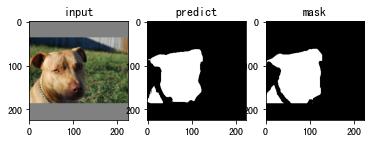

Epoch 1/1:   7%|▋         | 105/1470 [03:36<46:49,  2.06s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_80.png'] : tensor(0.7780)
/openbayes/input/input3/test_image/american_pit_bull_terrier_80.png
hd: 56.4003546088143
jc: 0.6366303436714166
sc: 0.8627005537413034
sp: 0.942016553450954


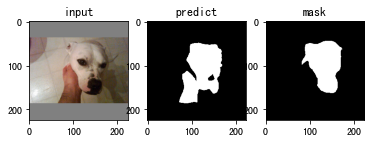

Epoch 1/1:   7%|▋         | 106/1470 [03:38<47:04,  2.07s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_81.png'] : tensor(0.8260)
/openbayes/input/input3/test_image/american_pit_bull_terrier_81.png
hd: 53.907327887774215
jc: 0.7036086365695304
sc: 0.7517947890618698
sp: 0.9775271976494878


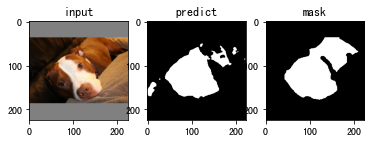

Epoch 1/1:   7%|▋         | 107/1470 [03:40<45:51,  2.02s/it, f_score=0.933]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_82.png'] : tensor(0.9610)
/openbayes/input/input3/test_image/american_pit_bull_terrier_82.png
hd: 10.0
jc: 0.924925291211807
sc: 0.9787673443046144
sp: 0.9739915227357919


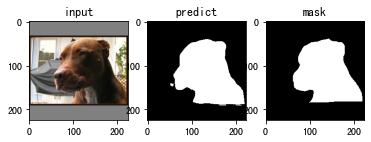

Epoch 1/1:   7%|▋         | 108/1470 [03:42<46:34,  2.05s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_86.png'] : tensor(0.9616)
/openbayes/input/input3/test_image/american_pit_bull_terrier_86.png
hd: 16.15549442140351
jc: 0.9260902204326759
sc: 0.9636415281920182
sp: 0.9841801961544855


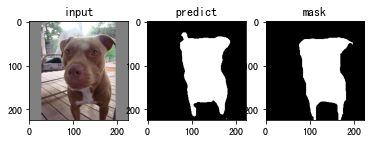

Epoch 1/1:   7%|▋         | 109/1470 [03:44<46:41,  2.06s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_89.png'] : tensor(0.7754)
/openbayes/input/input3/test_image/american_pit_bull_terrier_89.png
hd: 14.422205101855956
jc: 0.6331521739130435
sc: 0.8604135893648449
sp: 0.9900454713039204


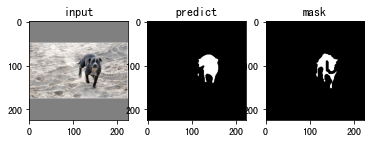

Epoch 1/1:   7%|▋         | 110/1470 [03:46<47:11,  2.08s/it, f_score=0.934]

['/openbayes/input/input3/test_image/american_pit_bull_terrier_97.png'] : tensor(0.9017)
/openbayes/input/input3/test_image/american_pit_bull_terrier_97.png
hd: 38.05259518088089
jc: 0.8210265413611484
sc: 0.8576977020174776
sp: 0.9898794827291173


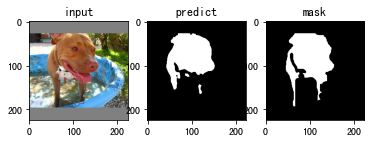

Epoch 1/1:   8%|▊         | 111/1470 [03:48<46:59,  2.07s/it, f_score=0.934]

['/openbayes/input/input3/test_image/basset_hound_1.png'] : tensor(0.9334)
/openbayes/input/input3/test_image/basset_hound_1.png
hd: 22.80350850198276
jc: 0.8751187084520418
sc: 0.9685980817238208
sp: 0.9808998003054152


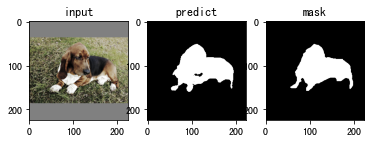

Epoch 1/1:   8%|▊         | 112/1470 [03:50<47:05,  2.08s/it, f_score=0.934]

['/openbayes/input/input3/test_image/basset_hound_10.png'] : tensor(0.9123)
/openbayes/input/input3/test_image/basset_hound_10.png
hd: 14.422205101855956
jc: 0.8387679671457906
sc: 0.94076462459696
sp: 0.9664301518272679


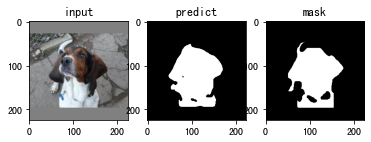

Epoch 1/1:   8%|▊         | 113/1470 [03:53<47:22,  2.09s/it, f_score=0.934]

['/openbayes/input/input3/test_image/basset_hound_105.png'] : tensor(0.9358)
/openbayes/input/input3/test_image/basset_hound_105.png
hd: 31.144823004794873
jc: 0.8793862123434503
sc: 0.9542115572967679
sp: 0.9589243498817966


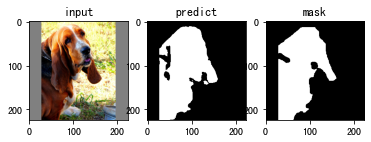

Epoch 1/1:   8%|▊         | 114/1470 [03:54<46:26,  2.06s/it, f_score=0.934]

['/openbayes/input/input3/test_image/basset_hound_107.png'] : tensor(0.8528)
/openbayes/input/input3/test_image/basset_hound_107.png
hd: 23.40939982143925
jc: 0.743440565822496
sc: 0.9868261659600243
sp: 0.9503809786101166


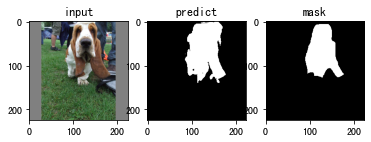

Epoch 1/1:   8%|▊         | 115/1470 [03:56<46:01,  2.04s/it, f_score=0.934]

['/openbayes/input/input3/test_image/basset_hound_109.png'] : tensor(0.8872)
/openbayes/input/input3/test_image/basset_hound_109.png
hd: 33.421549934136806
jc: 0.7973300970873787
sc: 0.9436265709156194
sp: 0.9633437746586643


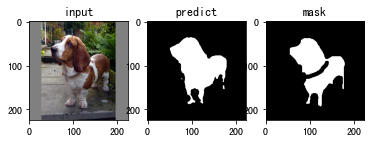

Epoch 1/1:   8%|▊         | 116/1470 [03:59<45:59,  2.04s/it, f_score=0.934]

['/openbayes/input/input3/test_image/basset_hound_111.png'] : tensor(0.9324)
/openbayes/input/input3/test_image/basset_hound_111.png
hd: 7.0
jc: 0.8733812949640288
sc: 0.961051298290057
sp: 0.9932579012293165


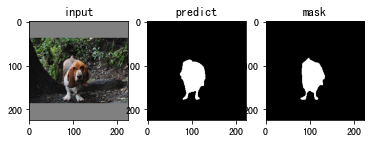

Epoch 1/1:   8%|▊         | 117/1470 [04:01<46:08,  2.05s/it, f_score=0.934]

['/openbayes/input/input3/test_image/basset_hound_113.png'] : tensor(0.8944)
/openbayes/input/input3/test_image/basset_hound_113.png
hd: 41.86884283091664
jc: 0.808976756612343
sc: 0.9555064689176397
sp: 0.9738126739358547


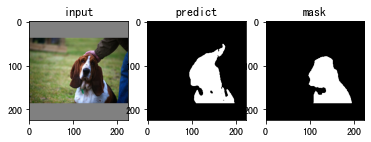

Epoch 1/1:   8%|▊         | 118/1470 [04:03<47:01,  2.09s/it, f_score=0.934]

['/openbayes/input/input3/test_image/basset_hound_115.png'] : tensor(0.9431)
/openbayes/input/input3/test_image/basset_hound_115.png
hd: 28.284271247461902
jc: 0.8923771416846209
sc: 0.9482175951161016
sp: 0.986001024315294


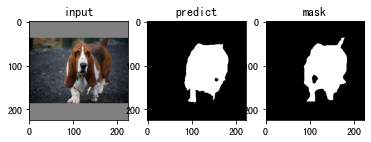

Epoch 1/1:   8%|▊         | 119/1470 [04:05<45:58,  2.04s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_118.png'] : tensor(0.9475)
/openbayes/input/input3/test_image/basset_hound_118.png
hd: 46.0
jc: 0.90022381905996
sc: 0.9308727693525793
sp: 0.9834404716058891


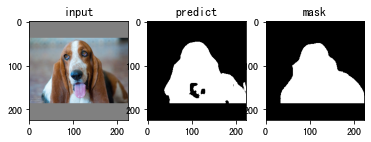

Epoch 1/1:   8%|▊         | 120/1470 [04:07<47:38,  2.12s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_119.png'] : tensor(0.9229)
/openbayes/input/input3/test_image/basset_hound_119.png
hd: 17.46424919657298
jc: 0.8568544316575812
sc: 0.901572015295284
sp: 0.9795584401176014


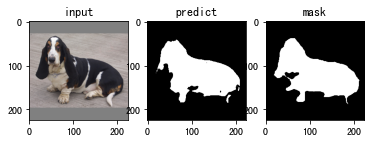

Epoch 1/1:   8%|▊         | 121/1470 [04:09<48:24,  2.15s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_153.png'] : tensor(0.9351)
/openbayes/input/input3/test_image/basset_hound_153.png
hd: 18.0
jc: 0.8781481173634776
sc: 0.9354524526297149
sp: 0.9810452137235739


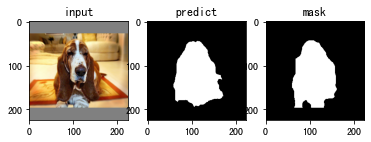

Epoch 1/1:   8%|▊         | 122/1470 [04:11<47:32,  2.12s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_164.png'] : tensor(0.8463)
/openbayes/input/input3/test_image/basset_hound_164.png
hd: 21.587033144922902
jc: 0.7335017366592991
sc: 0.864104153750775
sp: 0.9658996461732089


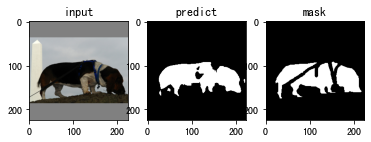

Epoch 1/1:   8%|▊         | 123/1470 [04:13<46:27,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_170.png'] : tensor(0.9493)
/openbayes/input/input3/test_image/basset_hound_170.png
hd: 21.2602916254693
jc: 0.903568667869106
sc: 0.9314077025232403
sp: 0.9867866499601321


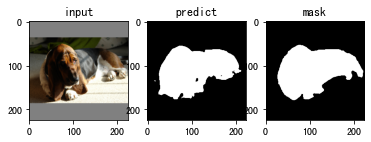

Epoch 1/1:   8%|▊         | 124/1470 [04:15<46:29,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_18.png'] : tensor(0.8955)
/openbayes/input/input3/test_image/basset_hound_18.png
hd: 11.0
jc: 0.8108515448379804
sc: 0.9011725293132329
sp: 0.981447038035897


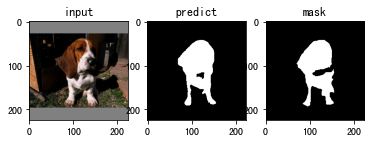

Epoch 1/1:   9%|▊         | 125/1470 [04:17<46:24,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_187.png'] : tensor(0.9146)
/openbayes/input/input3/test_image/basset_hound_187.png
hd: 38.01315561749642
jc: 0.8426233134262331
sc: 0.9040104413858566
sp: 0.9852927086327489


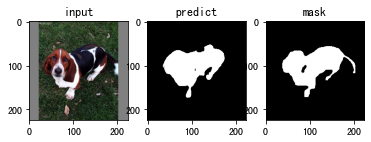

Epoch 1/1:   9%|▊         | 126/1470 [04:19<45:26,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_191.png'] : tensor(0.9035)
/openbayes/input/input3/test_image/basset_hound_191.png
hd: 31.016124838541646
jc: 0.8239306245737114
sc: 0.8487403392552444
sp: 0.9925397259592669


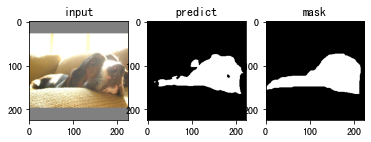

Epoch 1/1:   9%|▊         | 127/1470 [04:21<45:55,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_192.png'] : tensor(0.8842)
/openbayes/input/input3/test_image/basset_hound_192.png
hd: 39.81205847478876
jc: 0.7923980006974312
sc: 0.8008693609022557
sp: 0.9945101351351351


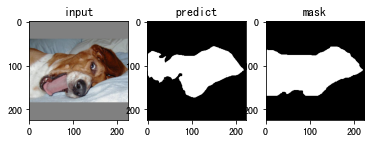

Epoch 1/1:   9%|▊         | 128/1470 [04:24<47:45,  2.13s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_21.png'] : tensor(0.9393)
/openbayes/input/input3/test_image/basset_hound_21.png
hd: 19.1049731745428
jc: 0.8855119018202784
sc: 0.9358461002785515
sp: 0.9831213813068652


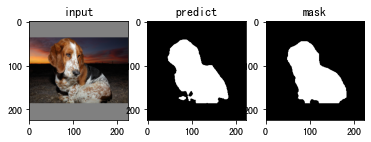

Epoch 1/1:   9%|▉         | 129/1470 [04:26<48:47,  2.18s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_23.png'] : tensor(0.9610)
/openbayes/input/input3/test_image/basset_hound_23.png
hd: 43.0
jc: 0.924997897923148
sc: 0.9392395696966247
sp: 0.9640244713392738


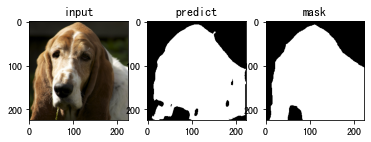

Epoch 1/1:   9%|▉         | 130/1470 [04:28<49:30,  2.22s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_30.png'] : tensor(0.8396)
/openbayes/input/input3/test_image/basset_hound_30.png
hd: 45.18849411078001
jc: 0.7235230547550432
sc: 0.9972691161866931
sp: 0.966975816936812


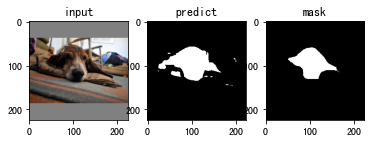

Epoch 1/1:   9%|▉         | 131/1470 [04:31<49:10,  2.20s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_35.png'] : tensor(0.8169)
/openbayes/input/input3/test_image/basset_hound_35.png
hd: 11.0
jc: 0.6904761904761905
sc: 0.8306055646481179
sp: 0.9949340196919557


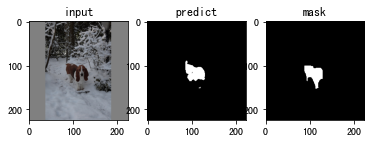

Epoch 1/1:   9%|▉         | 132/1470 [04:33<49:06,  2.20s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_45.png'] : tensor(0.8537)
/openbayes/input/input3/test_image/basset_hound_45.png
hd: 62.12889826803627
jc: 0.7447206224108316
sc: 0.8314156796390298
sp: 0.9363866116008137


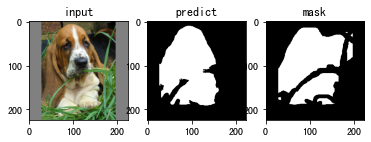

Epoch 1/1:   9%|▉         | 133/1470 [04:35<46:59,  2.11s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_46.png'] : tensor(0.8777)
/openbayes/input/input3/test_image/basset_hound_46.png
hd: 21.95449840010015
jc: 0.78208913257416
sc: 0.9456059833418324
sp: 0.9722303750028222


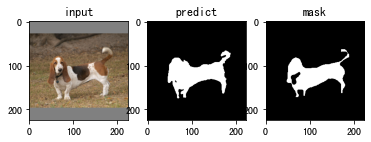

Epoch 1/1:   9%|▉         | 134/1470 [04:37<47:04,  2.11s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_55.png'] : tensor(0.9297)
/openbayes/input/input3/test_image/basset_hound_55.png
hd: 21.540659228538015
jc: 0.868668347467339
sc: 0.9237143553497441
sp: 0.9943567816291538


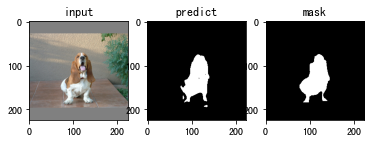

Epoch 1/1:   9%|▉         | 135/1470 [04:39<48:11,  2.17s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_70.png'] : tensor(0.9116)
/openbayes/input/input3/test_image/basset_hound_70.png
hd: 38.48376280978771
jc: 0.8375412293853074
sc: 0.9559860360052023
sp: 0.9419124469311441


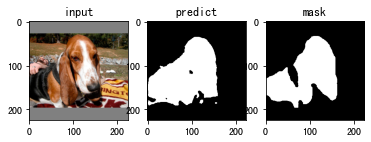

Epoch 1/1:   9%|▉         | 136/1470 [04:41<48:27,  2.18s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_71.png'] : tensor(0.9357)
/openbayes/input/input3/test_image/basset_hound_71.png
hd: 23.706539182259394
jc: 0.8792305598403048
sc: 0.8942414174972314
sp: 0.9952974072191154


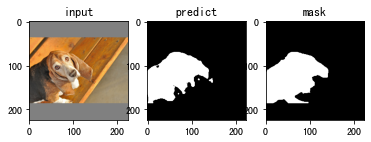

Epoch 1/1:   9%|▉         | 137/1470 [04:43<48:31,  2.18s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_75.png'] : tensor(0.9274)
/openbayes/input/input3/test_image/basset_hound_75.png
hd: 42.04759208325728
jc: 0.8646162295757243
sc: 0.9302703501255725
sp: 0.9881585919321768


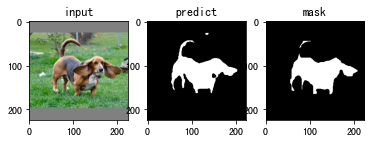

Epoch 1/1:   9%|▉         | 138/1470 [04:46<47:58,  2.16s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_76.png'] : tensor(0.9131)
/openbayes/input/input3/test_image/basset_hound_76.png
hd: 25.317977802344327
jc: 0.8400984009840098
sc: 0.9552447552447553
sp: 0.9798358519466862


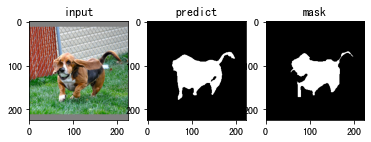

Epoch 1/1:   9%|▉         | 139/1470 [04:48<47:47,  2.15s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_79.png'] : tensor(0.9283)
/openbayes/input/input3/test_image/basset_hound_79.png
hd: 45.0
jc: 0.8661212346597248
sc: 0.8952527388045358
sp: 0.9961087763769373


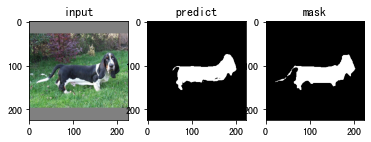

Epoch 1/1:  10%|▉         | 140/1470 [04:50<46:55,  2.12s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_8.png'] : tensor(0.9409)
/openbayes/input/input3/test_image/basset_hound_8.png
hd: 28.635642126552707
jc: 0.8883975026014568
sc: 0.9802889675629126
sp: 0.9727879169288861


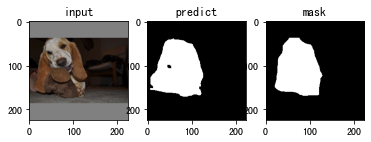

Epoch 1/1:  10%|▉         | 141/1470 [04:52<46:18,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/basset_hound_81.png'] : tensor(0.9335)
/openbayes/input/input3/test_image/basset_hound_81.png
hd: 27.0
jc: 0.8753027209269196
sc: 0.9119829804076786
sp: 0.9717327459618208


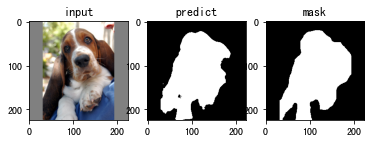

Epoch 1/1:  10%|▉         | 142/1470 [04:54<46:32,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/basset_hound_82.png'] : tensor(0.9431)
/openbayes/input/input3/test_image/basset_hound_82.png
hd: 29.614185789921695
jc: 0.8923083563535912
sc: 0.9250906161900926
sp: 0.9704984009486507


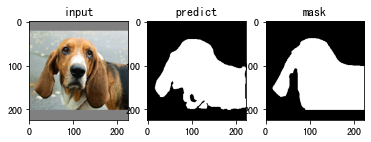

Epoch 1/1:  10%|▉         | 143/1470 [04:56<47:41,  2.16s/it, f_score=0.936]

['/openbayes/input/input3/test_image/basset_hound_86.png'] : tensor(0.7064)
/openbayes/input/input3/test_image/basset_hound_86.png
hd: 18.0
jc: 0.5460385438972163
sc: 0.967741935483871
sp: 0.98342901347665


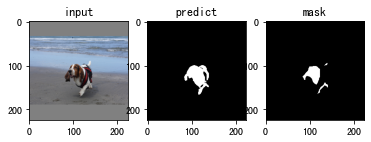

Epoch 1/1:  10%|▉         | 144/1470 [04:58<48:36,  2.20s/it, f_score=0.935]

['/openbayes/input/input3/test_image/basset_hound_94.png'] : tensor(0.9244)
/openbayes/input/input3/test_image/basset_hound_94.png
hd: 30.4138126514911
jc: 0.8594789356984479
sc: 0.8872675250357653
sp: 0.9975793149247016


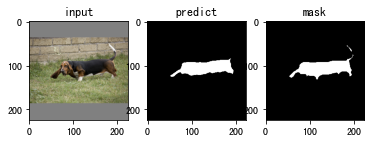

Epoch 1/1:  10%|▉         | 145/1470 [05:01<48:28,  2.19s/it, f_score=0.935]

['/openbayes/input/input3/test_image/beagle_100.png'] : tensor(0.9338)
/openbayes/input/input3/test_image/beagle_100.png
hd: 16.76305461424021
jc: 0.8757685551163812
sc: 0.9337977054553969
sp: 0.9657923365163786


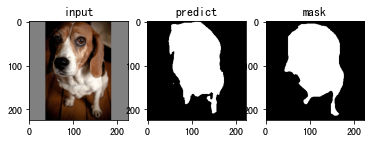

Epoch 1/1:  10%|▉         | 146/1470 [05:03<47:44,  2.16s/it, f_score=0.935]

['/openbayes/input/input3/test_image/beagle_103.png'] : tensor(0.8978)
/openbayes/input/input3/test_image/beagle_103.png
hd: 29.206163733020468
jc: 0.8145352900069881
sc: 0.8579419991167379
sp: 0.9916557176774312


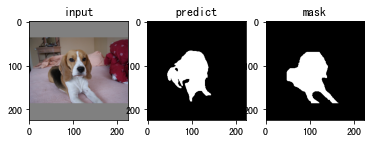

Epoch 1/1:  10%|█         | 147/1470 [05:05<46:56,  2.13s/it, f_score=0.935]

['/openbayes/input/input3/test_image/beagle_114.png'] : tensor(0.7557)
/openbayes/input/input3/test_image/beagle_114.png
hd: 49.040799340956916
jc: 0.6072779165180164
sc: 0.9838168997803722
sp: 0.8708248043347381


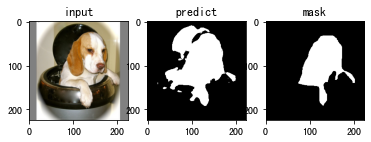

Epoch 1/1:  10%|█         | 148/1470 [05:07<46:31,  2.11s/it, f_score=0.935]

['/openbayes/input/input3/test_image/beagle_117.png'] : tensor(0.9163)
/openbayes/input/input3/test_image/beagle_117.png
hd: 11.40175425099138
jc: 0.8454738909805205
sc: 0.9291239431552437
sp: 0.9876728601205819


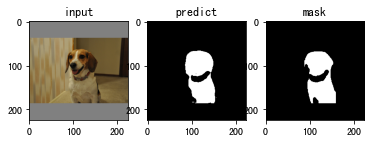

Epoch 1/1:  10%|█         | 149/1470 [05:09<47:43,  2.17s/it, f_score=0.935]

['/openbayes/input/input3/test_image/beagle_12.png'] : tensor(0.9567)
/openbayes/input/input3/test_image/beagle_12.png
hd: 12.649110640673518
jc: 0.9169461432235155
sc: 0.949928469241774
sp: 0.9851255035636814


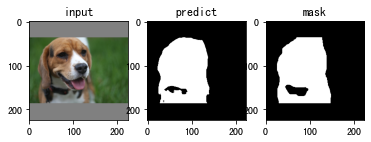

Epoch 1/1:  10%|█         | 150/1470 [05:11<47:55,  2.18s/it, f_score=0.935]

['/openbayes/input/input3/test_image/beagle_128.png'] : tensor(0.9190)
/openbayes/input/input3/test_image/beagle_128.png
hd: 18.867962264113206
jc: 0.8500741289844329
sc: 0.9578200041762372
sp: 0.97009704911572


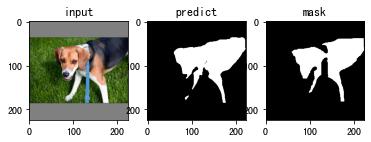

Epoch 1/1:  10%|█         | 151/1470 [05:13<46:49,  2.13s/it, f_score=0.935]

['/openbayes/input/input3/test_image/beagle_134.png'] : tensor(0.9517)
/openbayes/input/input3/test_image/beagle_134.png
hd: 20.615528128088304
jc: 0.9077927376580988
sc: 0.9427966101694916
sp: 0.993665305364767


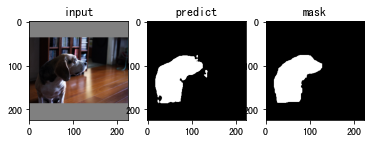

Epoch 1/1:  10%|█         | 152/1470 [05:15<46:06,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/beagle_139.png'] : tensor(0.9102)
/openbayes/input/input3/test_image/beagle_139.png
hd: 9.899494936611665
jc: 0.8351880546555853
sc: 0.860522496371553
sp: 0.9951716490320196


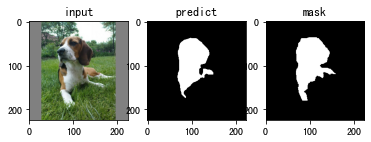

Epoch 1/1:  10%|█         | 153/1470 [05:17<45:39,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/beagle_143.png'] : tensor(0.8749)
/openbayes/input/input3/test_image/beagle_143.png
hd: 38.897300677553446
jc: 0.7775958074025549
sc: 0.7981918708906156
sp: 0.9697112098427888


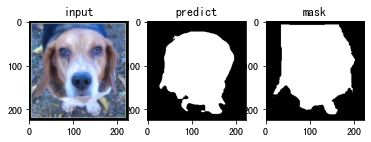

Epoch 1/1:  10%|█         | 154/1470 [05:19<45:36,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/beagle_145.png'] : tensor(0.4581)
/openbayes/input/input3/test_image/beagle_145.png
hd: 34.828149534535996
jc: 0.2970954356846473
sc: 0.30782459157351677
sp: 0.999143084487789


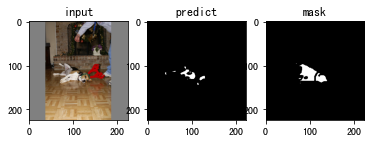

Epoch 1/1:  11%|█         | 155/1470 [05:22<45:55,  2.10s/it, f_score=0.934]

['/openbayes/input/input3/test_image/beagle_149.png'] : tensor(0.9306)
/openbayes/input/input3/test_image/beagle_149.png
hd: 24.041630560342615
jc: 0.8702157116698673
sc: 0.9664219819462355
sp: 0.925734657159992


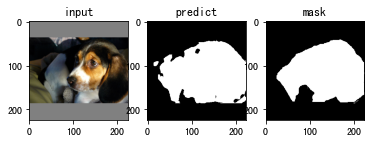

Epoch 1/1:  11%|█         | 156/1470 [05:24<45:56,  2.10s/it, f_score=0.934]

['/openbayes/input/input3/test_image/beagle_152.png'] : tensor(0.7816)
/openbayes/input/input3/test_image/beagle_152.png
hd: 33.0
jc: 0.6415094339622641
sc: 0.6522781774580336
sp: 0.9992722130960054


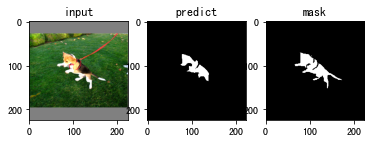

Epoch 1/1:  11%|█         | 157/1470 [05:26<44:34,  2.04s/it, f_score=0.934]

['/openbayes/input/input3/test_image/beagle_156.png'] : tensor(0.9163)
/openbayes/input/input3/test_image/beagle_156.png
hd: 8.0
jc: 0.8455188679245284
sc: 0.8698817106460418
sp: 0.9979735062607991


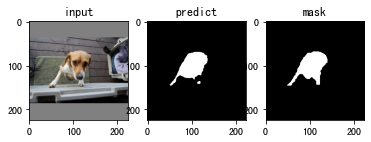

Epoch 1/1:  11%|█         | 158/1470 [05:28<44:07,  2.02s/it, f_score=0.934]

['/openbayes/input/input3/test_image/beagle_172.png'] : tensor(0.8674)
/openbayes/input/input3/test_image/beagle_172.png
hd: 20.396078054371138
jc: 0.7658044717229285
sc: 0.8989296006587073
sp: 0.9582550667325754


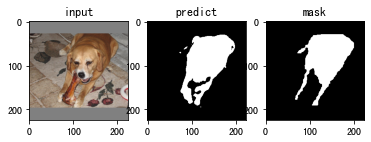

Epoch 1/1:  11%|█         | 159/1470 [05:30<44:26,  2.03s/it, f_score=0.934]

['/openbayes/input/input3/test_image/beagle_176.png'] : tensor(0.8721)
/openbayes/input/input3/test_image/beagle_176.png
hd: 22.825424421026653
jc: 0.7732009317150913
sc: 0.8562894576064083
sp: 0.9553392580053605


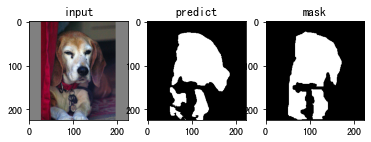

Epoch 1/1:  11%|█         | 160/1470 [05:32<43:55,  2.01s/it, f_score=0.933]

['/openbayes/input/input3/test_image/beagle_180.png'] : tensor(0.8649)
/openbayes/input/input3/test_image/beagle_180.png
hd: 37.0
jc: 0.7619719355557205
sc: 0.7953347799132052
sp: 0.9848411676325391


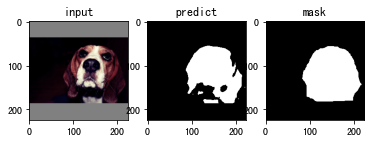

Epoch 1/1:  11%|█         | 161/1470 [05:34<44:21,  2.03s/it, f_score=0.933]

['/openbayes/input/input3/test_image/beagle_186.png'] : tensor(0.9262)
/openbayes/input/input3/test_image/beagle_186.png
hd: 11.0
jc: 0.8625586854460094
sc: 0.9057185112151837
sp: 0.9903475821406496


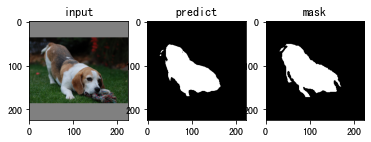

Epoch 1/1:  11%|█         | 162/1470 [05:36<44:46,  2.05s/it, f_score=0.933]

['/openbayes/input/input3/test_image/beagle_188.png'] : tensor(0.9320)
/openbayes/input/input3/test_image/beagle_188.png
hd: 10.0
jc: 0.8726776320170474
sc: 0.9459361917135846
sp: 0.9679808380595782


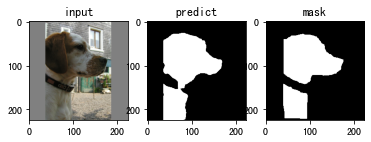

Epoch 1/1:  11%|█         | 163/1470 [05:38<45:04,  2.07s/it, f_score=0.934]

['/openbayes/input/input3/test_image/beagle_189.png'] : tensor(0.8889)
/openbayes/input/input3/test_image/beagle_189.png
hd: 9.0
jc: 0.8
sc: 0.8563218390804598
sp: 0.9979911446375861


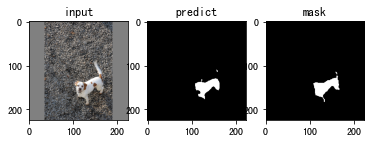

Epoch 1/1:  11%|█         | 164/1470 [05:40<45:23,  2.09s/it, f_score=0.934]

['/openbayes/input/input3/test_image/beagle_19.png'] : tensor(0.8315)
/openbayes/input/input3/test_image/beagle_19.png
hd: 37.21558813185679
jc: 0.7116120218579235
sc: 0.8608494463725004
sp: 0.9712407932011331


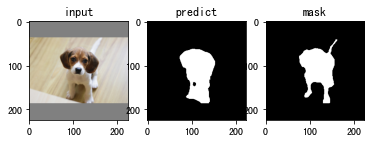

Epoch 1/1:  11%|█         | 165/1470 [05:42<45:18,  2.08s/it, f_score=0.933]

['/openbayes/input/input3/test_image/beagle_191.png'] : tensor(0.7345)
/openbayes/input/input3/test_image/beagle_191.png
hd: 21.02379604162864
jc: 0.5804511278195489
sc: 0.9394993045897079
sp: 0.9623890063424947


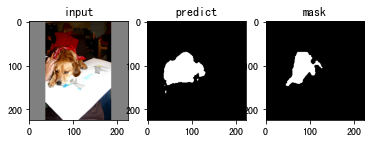

Epoch 1/1:  11%|█▏        | 166/1470 [05:44<44:35,  2.05s/it, f_score=0.933]

['/openbayes/input/input3/test_image/beagle_192.png'] : tensor(0.8549)
/openbayes/input/input3/test_image/beagle_192.png
hd: 29.0
jc: 0.7466483327603988
sc: 0.9664071190211346
sp: 0.971038287252906


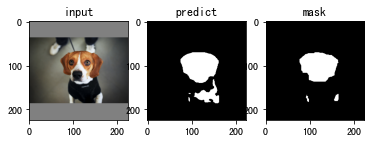

Epoch 1/1:  11%|█▏        | 167/1470 [05:46<44:46,  2.06s/it, f_score=0.933]

['/openbayes/input/input3/test_image/beagle_197.png'] : tensor(0.8935)
/openbayes/input/input3/test_image/beagle_197.png
hd: 16.0
jc: 0.8074570689249588
sc: 0.8859207639695444
sp: 0.9822518679142999


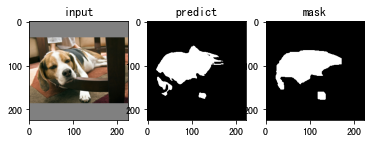

Epoch 1/1:  11%|█▏        | 168/1470 [05:48<44:35,  2.05s/it, f_score=0.933]

['/openbayes/input/input3/test_image/beagle_202.png'] : tensor(0.8270)
/openbayes/input/input3/test_image/beagle_202.png
hd: 10.44030650891055
jc: 0.7050423917893798
sc: 0.7817911924789708
sp: 0.9954314193749351


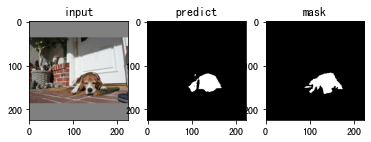

Epoch 1/1:  11%|█▏        | 169/1470 [05:50<44:47,  2.07s/it, f_score=0.933]

['/openbayes/input/input3/test_image/beagle_22.png'] : tensor(0.8723)
/openbayes/input/input3/test_image/beagle_22.png
hd: 26.92582403567252
jc: 0.7734798199435416
sc: 0.931887121978123
sp: 0.9433035600681986


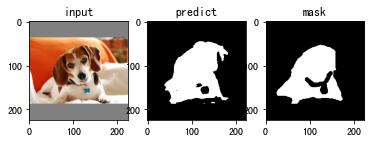

Epoch 1/1:  12%|█▏        | 170/1470 [05:52<45:10,  2.09s/it, f_score=0.933]

['/openbayes/input/input3/test_image/beagle_29.png'] : tensor(0.8075)
/openbayes/input/input3/test_image/beagle_29.png
hd: 23.0
jc: 0.6770987239758227
sc: 0.8704886893455361
sp: 0.9627351582741918


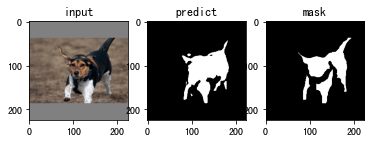

Epoch 1/1:  12%|█▏        | 171/1470 [05:55<46:27,  2.15s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_30.png'] : tensor(0.8197)
/openbayes/input/input3/test_image/beagle_30.png
hd: 15.132745950421556
jc: 0.6944804353459445
sc: 0.8126137052759248
sp: 0.9880327659029822


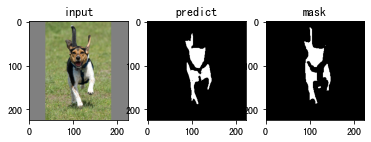

Epoch 1/1:  12%|█▏        | 172/1470 [05:57<45:55,  2.12s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_31.png'] : tensor(0.9133)
/openbayes/input/input3/test_image/beagle_31.png
hd: 55.90169943749474
jc: 0.8404036948340746
sc: 0.9087209840007399
sp: 0.977669384955415


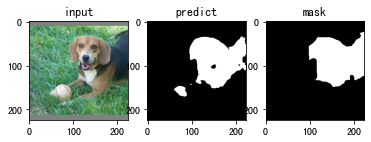

Epoch 1/1:  12%|█▏        | 173/1470 [05:59<45:12,  2.09s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_36.png'] : tensor(0.8148)
/openbayes/input/input3/test_image/beagle_36.png
hd: 29.410882339705484
jc: 0.6875381795968235
sc: 0.869951690821256
sp: 0.9694895668985134


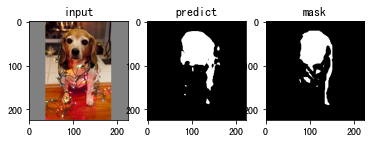

Epoch 1/1:  12%|█▏        | 174/1470 [06:01<45:33,  2.11s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_40.png'] : tensor(0.8927)
/openbayes/input/input3/test_image/beagle_40.png
hd: 32.2490309931942
jc: 0.8061749571183533
sc: 0.8703703703703703
sp: 0.9601327910037086


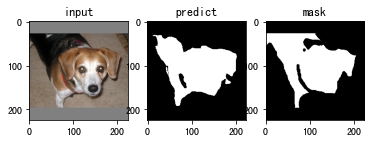

Epoch 1/1:  12%|█▏        | 175/1470 [06:03<46:32,  2.16s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_41.png'] : tensor(0.9439)
/openbayes/input/input3/test_image/beagle_41.png
hd: 30.59411708155671
jc: 0.8938207798130273
sc: 0.97165991902834
sp: 0.9723163396632785


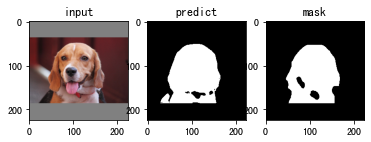

Epoch 1/1:  12%|█▏        | 176/1470 [06:05<46:09,  2.14s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_48.png'] : tensor(0.8537)
/openbayes/input/input3/test_image/beagle_48.png
hd: 23.53720459187964
jc: 0.7447482796088374
sc: 0.8606257193680025
sp: 0.9633915162854821


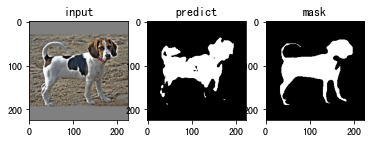

Epoch 1/1:  12%|█▏        | 177/1470 [06:07<46:16,  2.15s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_57.png'] : tensor(0.9252)
/openbayes/input/input3/test_image/beagle_57.png
hd: 19.0
jc: 0.860778148948713
sc: 0.9062790938243509
sp: 0.9873855192673233


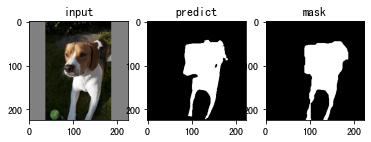

Epoch 1/1:  12%|█▏        | 178/1470 [06:10<46:39,  2.17s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_65.png'] : tensor(0.9138)
/openbayes/input/input3/test_image/beagle_65.png
hd: 25.238858928247925
jc: 0.8413079156672137
sc: 0.871680837148463
sp: 0.9935106157861324


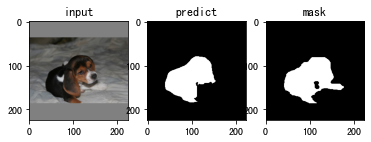

Epoch 1/1:  12%|█▏        | 179/1470 [06:12<45:36,  2.12s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_66.png'] : tensor(0.8651)
/openbayes/input/input3/test_image/beagle_66.png
hd: 21.0
jc: 0.7623098119084701
sc: 0.8349297992389451
sp: 0.9829397250616849


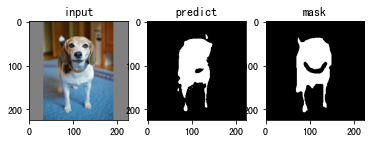

Epoch 1/1:  12%|█▏        | 180/1470 [06:14<45:15,  2.11s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_67.png'] : tensor(0.9341)
/openbayes/input/input3/test_image/beagle_67.png
hd: 43.41658669218482
jc: 0.8763046619921854
sc: 0.9047303271441203
sp: 0.9817019950124688


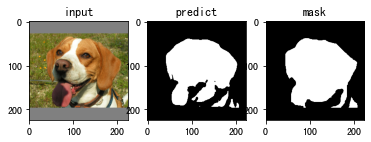

Epoch 1/1:  12%|█▏        | 181/1470 [06:16<45:59,  2.14s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_68.png'] : tensor(0.9348)
/openbayes/input/input3/test_image/beagle_68.png
hd: 21.37755832643195
jc: 0.877592218755735
sc: 0.9232105796611806
sp: 0.9634382319991852


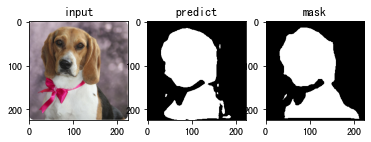

Epoch 1/1:  12%|█▏        | 182/1470 [06:18<45:54,  2.14s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_69.png'] : tensor(0.7406)
/openbayes/input/input3/test_image/beagle_69.png
hd: 33.37663853655727
jc: 0.5880246913580247
sc: 0.5961947678057329
sp: 0.9973688577049802


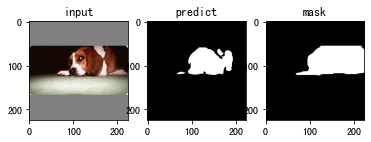

Epoch 1/1:  12%|█▏        | 183/1470 [06:20<45:47,  2.13s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_71.png'] : tensor(0.8502)
/openbayes/input/input3/test_image/beagle_71.png
hd: 30.805843601498726
jc: 0.7393963306372066
sc: 0.9053140096618357
sp: 0.9798201407594057


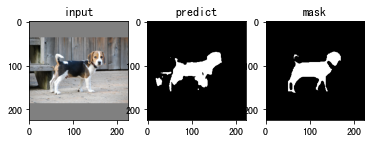

Epoch 1/1:  13%|█▎        | 184/1470 [06:22<45:02,  2.10s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_73.png'] : tensor(0.9742)
/openbayes/input/input3/test_image/beagle_73.png
hd: 8.54400374531753
jc: 0.949602932193036
sc: 0.9750972274495044
sp: 0.9874978091955366


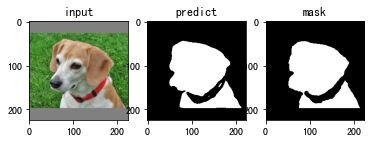

Epoch 1/1:  13%|█▎        | 185/1470 [06:24<44:58,  2.10s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_77.png'] : tensor(0.9214)
/openbayes/input/input3/test_image/beagle_77.png
hd: 17.08800749063506
jc: 0.8541734329327704
sc: 0.9411343710860619
sp: 0.987238432727028


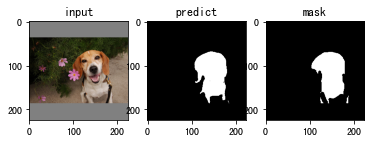

Epoch 1/1:  13%|█▎        | 186/1470 [06:27<45:44,  2.14s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_79.png'] : tensor(0.8064)
/openbayes/input/input3/test_image/beagle_79.png
hd: 30.0
jc: 0.675645342312009
sc: 0.9043565348022033
sp: 0.9859689906390751


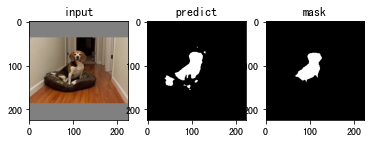

Epoch 1/1:  13%|█▎        | 187/1470 [06:29<44:44,  2.09s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_80.png'] : tensor(0.9432)
/openbayes/input/input3/test_image/beagle_80.png
hd: 20.396078054371138
jc: 0.8925569707997574
sc: 0.9417196142067011
sp: 0.9574189900703205


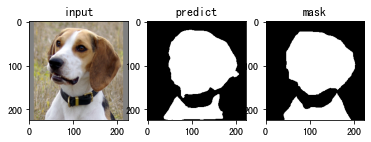

Epoch 1/1:  13%|█▎        | 188/1470 [06:31<44:23,  2.08s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_82.png'] : tensor(0.9397)
/openbayes/input/input3/test_image/beagle_82.png
hd: 21.587033144922902
jc: 0.8861991729841489
sc: 0.9596977329974811
sp: 0.9774691436247054


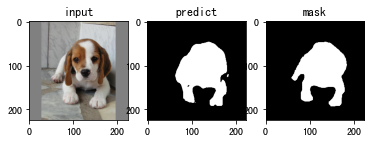

Epoch 1/1:  13%|█▎        | 189/1470 [06:33<44:05,  2.06s/it, f_score=0.932]

['/openbayes/input/input3/test_image/beagle_85.png'] : tensor(0.9506)
/openbayes/input/input3/test_image/beagle_85.png
hd: 12.529964086141668
jc: 0.9059009834972496
sc: 0.9603286799787948
sp: 0.9825003860208966


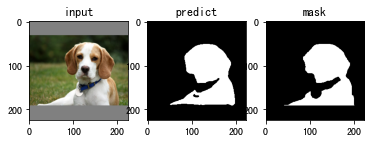

Epoch 1/1:  13%|█▎        | 190/1470 [06:35<44:31,  2.09s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_1.png'] : tensor(0.8866)
/openbayes/input/input3/test_image/Bengal_1.png
hd: 18.027756377319946
jc: 0.7963748553798689
sc: 0.8837375178316691
sp: 0.9821850530510123


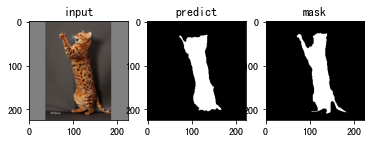

Epoch 1/1:  13%|█▎        | 191/1470 [06:37<43:41,  2.05s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_10.png'] : tensor(0.8341)
/openbayes/input/input3/test_image/Bengal_10.png
hd: 14.212670403551895
jc: 0.7154210819854991
sc: 0.8520425107937563
sp: 0.9739547945825973


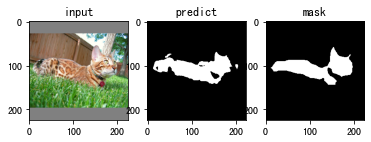

Epoch 1/1:  13%|█▎        | 192/1470 [06:39<43:24,  2.04s/it, f_score=0.932]

['/openbayes/input/input3/test_image/Bengal_100.png'] : tensor(0.9240)
/openbayes/input/input3/test_image/Bengal_100.png
hd: 14.0
jc: 0.8587450742649287
sc: 0.8810449385787591
sp: 0.9961824208480969


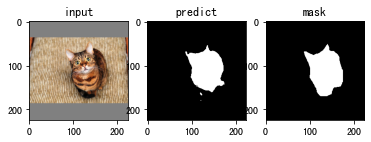

Epoch 1/1:  13%|█▎        | 193/1470 [06:41<43:17,  2.03s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_131.png'] : tensor(0.7408)
/openbayes/input/input3/test_image/Bengal_131.png
hd: 30.463092423455635
jc: 0.5883069427527405
sc: 0.9342359767891683
sp: 0.9876276911806602


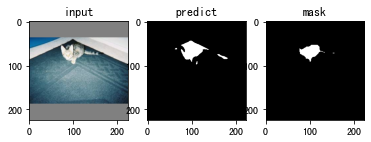

Epoch 1/1:  13%|█▎        | 194/1470 [06:43<43:30,  2.05s/it, f_score=0.932]

['/openbayes/input/input3/test_image/Bengal_134.png'] : tensor(0.9559)
/openbayes/input/input3/test_image/Bengal_134.png
hd: 17.0
jc: 0.9155223691704106
sc: 0.9594800716227867
sp: 0.9793714562498219


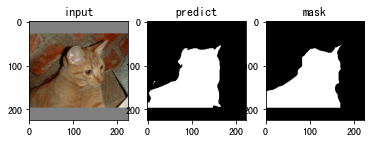

Epoch 1/1:  13%|█▎        | 195/1470 [06:45<43:58,  2.07s/it, f_score=0.932]

['/openbayes/input/input3/test_image/Bengal_137.png'] : tensor(0.9016)
/openbayes/input/input3/test_image/Bengal_137.png
hd: 22.67156809750927
jc: 0.8208967435771559
sc: 0.9749295500923136
sp: 0.9515858092014542


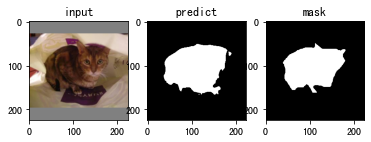

Epoch 1/1:  13%|█▎        | 196/1470 [06:47<44:46,  2.11s/it, f_score=0.932]

['/openbayes/input/input3/test_image/Bengal_139.png'] : tensor(0.9169)
/openbayes/input/input3/test_image/Bengal_139.png
hd: 34.9857113690718
jc: 0.8464705882352941
sc: 0.8768449559918754
sp: 0.9850307857425296


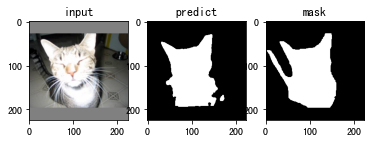

Epoch 1/1:  13%|█▎        | 197/1470 [06:49<45:23,  2.14s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_140.png'] : tensor(0.9165)
/openbayes/input/input3/test_image/Bengal_140.png
hd: 19.235384061671343
jc: 0.8458062694154194
sc: 0.9488357357833043
sp: 0.9824681394341472


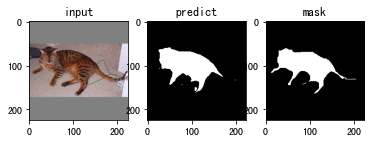

Epoch 1/1:  13%|█▎        | 198/1470 [06:52<45:27,  2.14s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_142.png'] : tensor(0.9379)
/openbayes/input/input3/test_image/Bengal_142.png
hd: 13.152946437965905
jc: 0.8830633497251953
sc: 0.9481326189921577
sp: 0.9745555942837225


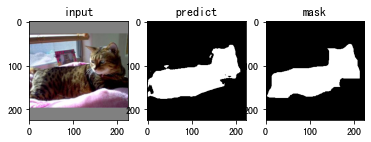

Epoch 1/1:  14%|█▎        | 199/1470 [06:54<47:25,  2.24s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_16.png'] : tensor(0.9604)
/openbayes/input/input3/test_image/Bengal_16.png
hd: 17.0
jc: 0.9238452772005095
sc: 0.9474082221916678
sp: 0.9895874263261296


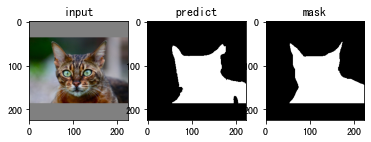

Epoch 1/1:  14%|█▎        | 200/1470 [06:56<46:28,  2.20s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_162.png'] : tensor(0.8737)
/openbayes/input/input3/test_image/Bengal_162.png
hd: 39.6232255123179
jc: 0.775666564511186
sc: 0.8500419815281276
sp: 0.9870875828226409


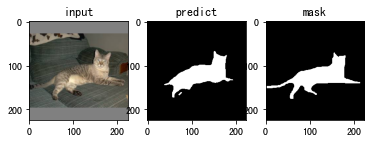

Epoch 1/1:  14%|█▎        | 201/1470 [06:58<45:28,  2.15s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_167.png'] : tensor(0.9141)
/openbayes/input/input3/test_image/Bengal_167.png
hd: 18.384776310850235
jc: 0.84174053182917
sc: 0.9398110661268556
sp: 0.9668467269143135


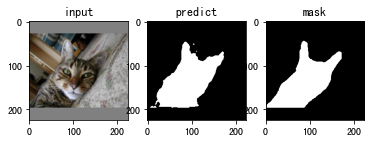

Epoch 1/1:  14%|█▎        | 202/1470 [07:00<44:50,  2.12s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_168.png'] : tensor(0.8861)
/openbayes/input/input3/test_image/Bengal_168.png
hd: 22.20360331117452
jc: 0.7954463750748951
sc: 0.9349295774647888
sp: 0.9710975949484631


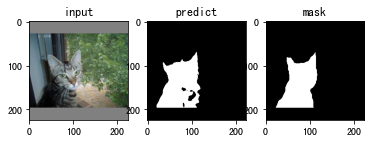

Epoch 1/1:  14%|█▍        | 203/1470 [07:02<45:05,  2.14s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_169.png'] : tensor(0.9229)
/openbayes/input/input3/test_image/Bengal_169.png
hd: 15.132745950421556
jc: 0.8567562691683204
sc: 0.9030233884768968
sp: 0.9856775429925866


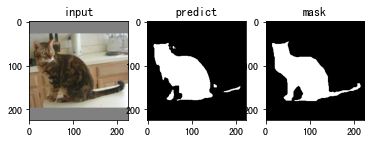

Epoch 1/1:  14%|█▍        | 204/1470 [07:05<44:53,  2.13s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_170.png'] : tensor(0.8960)
/openbayes/input/input3/test_image/Bengal_170.png
hd: 15.811388300841896
jc: 0.8115866929215463
sc: 0.9043769488393579
sp: 0.976154346412313


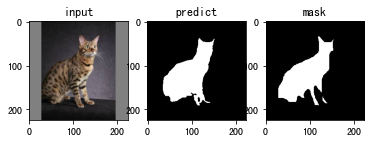

Epoch 1/1:  14%|█▍        | 205/1470 [07:06<43:20,  2.06s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_177.png'] : tensor(0.9447)
/openbayes/input/input3/test_image/Bengal_177.png
hd: 12.529964086141668
jc: 0.8952601156069364
sc: 0.9740880503144654
sp: 0.9924244063981299


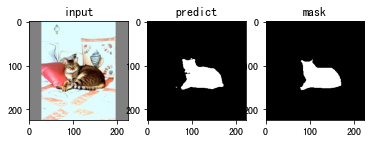

Epoch 1/1:  14%|█▍        | 206/1470 [07:08<43:33,  2.07s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_18.png'] : tensor(0.9234)
/openbayes/input/input3/test_image/Bengal_18.png
hd: 14.317821063276353
jc: 0.8577096006347527
sc: 0.9101880437833286
sp: 0.9953231931006372


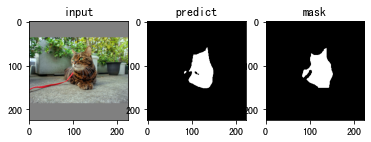

Epoch 1/1:  14%|█▍        | 207/1470 [07:11<43:41,  2.08s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_182.png'] : tensor(0.9182)
/openbayes/input/input3/test_image/Bengal_182.png
hd: 37.589892258425
jc: 0.8488336713995943
sc: 0.8986417565898964
sp: 0.9653554787790422


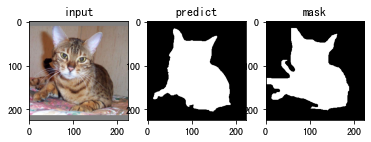

Epoch 1/1:  14%|█▍        | 208/1470 [07:13<45:02,  2.14s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_186.png'] : tensor(0.9148)
/openbayes/input/input3/test_image/Bengal_186.png
hd: 46.861498055439924
jc: 0.8429694496964872
sc: 0.8610489936979061
sp: 0.9861639344262295


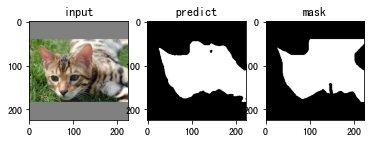

Epoch 1/1:  14%|█▍        | 209/1470 [07:15<46:38,  2.22s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_20.png'] : tensor(0.9077)
/openbayes/input/input3/test_image/Bengal_20.png
hd: 23.53720459187964
jc: 0.8309165526675787
sc: 0.9169685990338164
sp: 0.9926809491293958


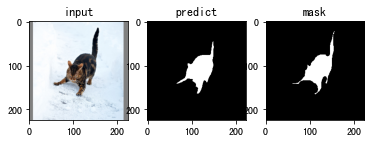

Epoch 1/1:  14%|█▍        | 210/1470 [07:18<47:24,  2.26s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_25.png'] : tensor(0.8539)
/openbayes/input/input3/test_image/Bengal_25.png
hd: 60.440052945046304
jc: 0.7450030284675954
sc: 0.8532778355879292
sp: 0.9911403378935572


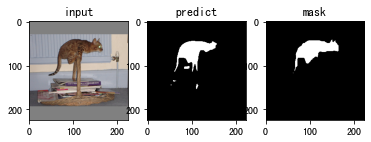

Epoch 1/1:  14%|█▍        | 211/1470 [07:20<45:37,  2.17s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_26.png'] : tensor(0.8314)
/openbayes/input/input3/test_image/Bengal_26.png
hd: 17.4928556845359
jc: 0.7115054378935318
sc: 0.9658119658119658
sp: 0.9702040375688222


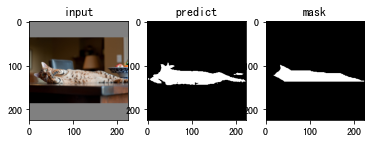

Epoch 1/1:  14%|█▍        | 212/1470 [07:22<44:50,  2.14s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_29.png'] : tensor(0.8749)
/openbayes/input/input3/test_image/Bengal_29.png
hd: 39.56008088970496
jc: 0.7776470588235294
sc: 0.869808372399046
sp: 0.9620959044637926


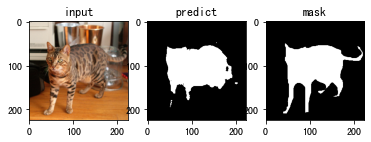

Epoch 1/1:  14%|█▍        | 213/1470 [07:24<43:38,  2.08s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_39.png'] : tensor(0.8706)
/openbayes/input/input3/test_image/Bengal_39.png
hd: 20.0
jc: 0.7708426214890771
sc: 0.9561290322580646
sp: 0.9708609863466738


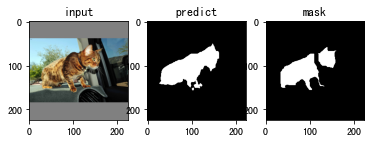

Epoch 1/1:  15%|█▍        | 214/1470 [07:26<42:52,  2.05s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_42.png'] : tensor(0.9033)
/openbayes/input/input3/test_image/Bengal_42.png
hd: 20.12461179749811
jc: 0.8236336032388664
sc: 0.8732980079146824
sp: 0.9745087475543709


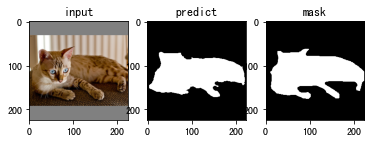

Epoch 1/1:  15%|█▍        | 215/1470 [07:28<42:42,  2.04s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_43.png'] : tensor(0.9575)
/openbayes/input/input3/test_image/Bengal_43.png
hd: 9.848857801796104
jc: 0.9184806556799154
sc: 0.949699289229087
sp: 0.9904851793275853


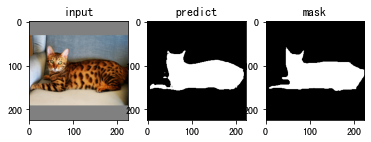

Epoch 1/1:  15%|█▍        | 216/1470 [07:30<42:00,  2.01s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_5.png'] : tensor(0.9030)
/openbayes/input/input3/test_image/Bengal_5.png
hd: 67.91170738539859
jc: 0.8231689088191331
sc: 0.8724651457541192
sp: 0.9913824548604778


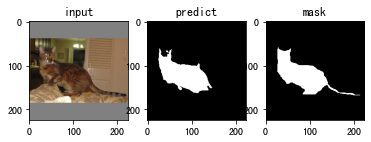

Epoch 1/1:  15%|█▍        | 217/1470 [07:32<42:23,  2.03s/it, f_score=0.933]

['/openbayes/input/input3/test_image/Bengal_60.png'] : tensor(0.9420)
/openbayes/input/input3/test_image/Bengal_60.png
hd: 17.11724276862369
jc: 0.8902796792489732
sc: 0.9196888574603496
sp: 0.9918812225339524


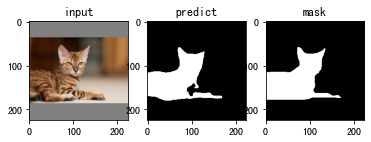

Epoch 1/1:  15%|█▍        | 218/1470 [07:34<41:55,  2.01s/it, f_score=0.934]

['/openbayes/input/input3/test_image/Bengal_72.png'] : tensor(0.9013)
/openbayes/input/input3/test_image/Bengal_72.png
hd: 24.08318915758459
jc: 0.820355341083571
sc: 0.9090909090909091
sp: 0.9903391081585688


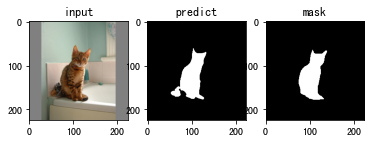

Epoch 1/1:  15%|█▍        | 219/1470 [07:36<42:51,  2.06s/it, f_score=0.934]

['/openbayes/input/input3/test_image/Bengal_84.png'] : tensor(0.9513)
/openbayes/input/input3/test_image/Bengal_84.png
hd: 18.027756377319946
jc: 0.9070639054757972
sc: 0.9521237580849503
sp: 0.9788225930242475


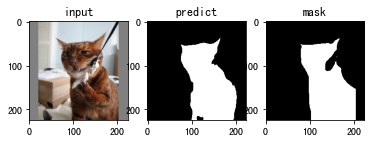

Epoch 1/1:  15%|█▍        | 220/1470 [07:38<43:53,  2.11s/it, f_score=0.934]

['/openbayes/input/input3/test_image/Bengal_88.png'] : tensor(0.9359)
/openbayes/input/input3/test_image/Bengal_88.png
hd: 10.770329614269007
jc: 0.8794412801735828
sc: 0.9325568018406672
sp: 0.9902827263893388


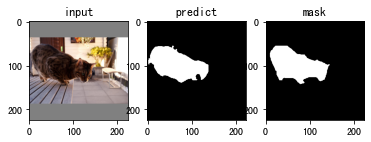

Epoch 1/1:  15%|█▌        | 221/1470 [07:40<43:59,  2.11s/it, f_score=0.934]

['/openbayes/input/input3/test_image/Bengal_89.png'] : tensor(0.9795)
/openbayes/input/input3/test_image/Bengal_89.png
hd: 13.0
jc: 0.9597855227882037
sc: 0.9704694889837352
sp: 0.9941226627687435


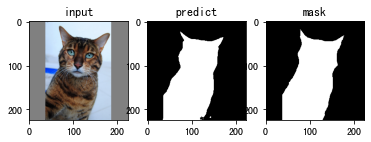

Epoch 1/1:  15%|█▌        | 222/1470 [07:42<45:00,  2.16s/it, f_score=0.934]

['/openbayes/input/input3/test_image/Bengal_9.png'] : tensor(0.9052)
/openbayes/input/input3/test_image/Bengal_9.png
hd: 17.88854381999832
jc: 0.8268765133171913
sc: 0.9448927830297441
sp: 0.9864962150134166


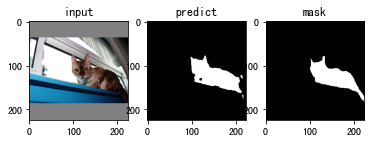

Epoch 1/1:  15%|█▌        | 223/1470 [07:44<43:55,  2.11s/it, f_score=0.934]

['/openbayes/input/input3/test_image/Bengal_94.png'] : tensor(0.9728)
/openbayes/input/input3/test_image/Bengal_94.png
hd: 3.0
jc: 0.9470295580918935
sc: 0.9766599597585514
sp: 0.9922706034397057


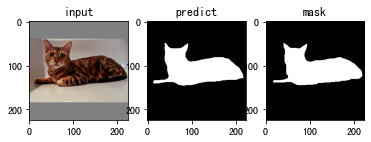

Epoch 1/1:  15%|█▌        | 224/1470 [07:46<42:35,  2.05s/it, f_score=0.934]

['/openbayes/input/input3/test_image/Bengal_97.png'] : tensor(0.9049)
/openbayes/input/input3/test_image/Bengal_97.png
hd: 22.20360331117452
jc: 0.8263414634146341
sc: 0.9345035105315947
sp: 0.9675421578868826


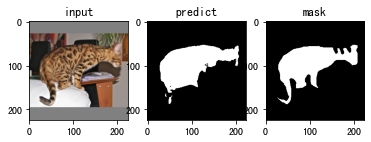

Epoch 1/1:  15%|█▌        | 225/1470 [07:48<41:36,  2.01s/it, f_score=0.934]

['/openbayes/input/input3/test_image/Birman_109.png'] : tensor(0.9682)
/openbayes/input/input3/test_image/Birman_109.png
hd: 20.518284528683193
jc: 0.9383653416703885
sc: 0.9670886075949368
sp: 0.9766264806157956


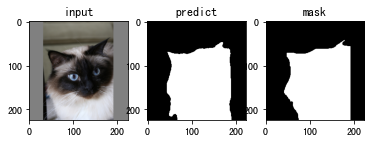

Epoch 1/1:  15%|█▌        | 226/1470 [07:50<41:55,  2.02s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Birman_115.png'] : tensor(0.9578)
/openbayes/input/input3/test_image/Birman_115.png
hd: 12.36931687685298
jc: 0.9190334071435449
sc: 0.9356071743604822
sp: 0.9953968929027093


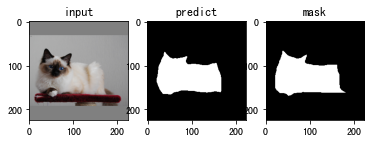

Epoch 1/1:  15%|█▌        | 227/1470 [07:52<41:58,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Birman_119.png'] : tensor(0.9770)
/openbayes/input/input3/test_image/Birman_119.png
hd: 14.866068747318506
jc: 0.955095297102732
sc: 0.9651759093619559
sp: 0.9947015506196492


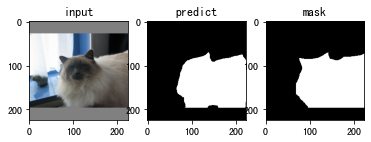

Epoch 1/1:  16%|█▌        | 228/1470 [07:55<43:07,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Birman_136.png'] : tensor(0.9321)
/openbayes/input/input3/test_image/Birman_136.png
hd: 11.661903789690601
jc: 0.8727569331158238
sc: 0.9216722177558286
sp: 0.9882321734307555


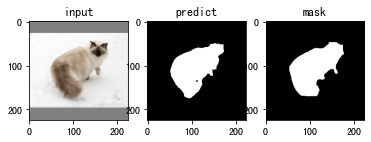

Epoch 1/1:  16%|█▌        | 229/1470 [07:57<43:12,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Birman_143.png'] : tensor(0.8445)
/openbayes/input/input3/test_image/Birman_143.png
hd: 39.05124837953327
jc: 0.7308085977482088
sc: 0.8736616702355461
sp: 0.970713598240066


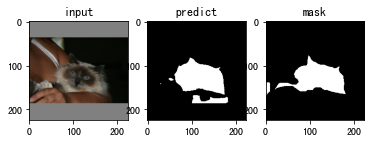

Epoch 1/1:  16%|█▌        | 230/1470 [07:59<43:50,  2.12s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Birman_146.png'] : tensor(0.9294)
/openbayes/input/input3/test_image/Birman_146.png
hd: 14.560219778561036
jc: 0.8681835043897613
sc: 0.957583196944899
sp: 0.982377929231631


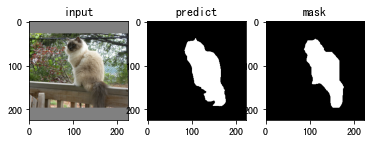

Epoch 1/1:  16%|█▌        | 231/1470 [08:01<44:19,  2.15s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Birman_150.png'] : tensor(0.9277)
/openbayes/input/input3/test_image/Birman_150.png
hd: 32.526911934581186
jc: 0.865191539136368
sc: 0.8728488543612941
sp: 0.9939674240900864


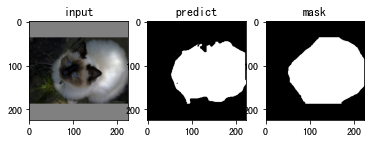

Epoch 1/1:  16%|█▌        | 232/1470 [08:03<44:03,  2.14s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Birman_159.png'] : tensor(0.9115)
/openbayes/input/input3/test_image/Birman_159.png
hd: 17.029386365926403
jc: 0.8374257425742574
sc: 0.9588119709794438
sp: 0.9480835859679515


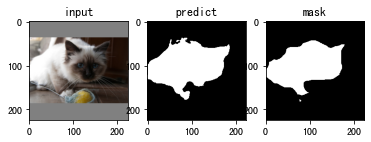

Epoch 1/1:  16%|█▌        | 233/1470 [08:05<43:18,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Birman_161.png'] : tensor(0.8809)
/openbayes/input/input3/test_image/Birman_161.png
hd: 42.2965719651132
jc: 0.7871069734761988
sc: 0.8815660043281527
sp: 0.9864724014813829


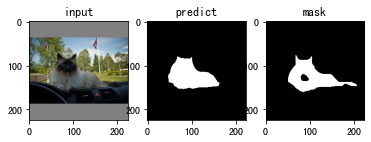

Epoch 1/1:  16%|█▌        | 234/1470 [08:07<41:40,  2.02s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Birman_165.png'] : tensor(0.9708)
/openbayes/input/input3/test_image/Birman_165.png
hd: 14.0
jc: 0.9432386604493429
sc: 0.9723812437180439
sp: 0.97409592203129


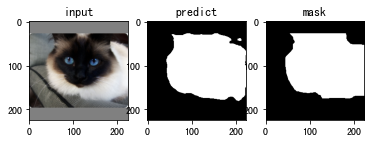

Epoch 1/1:  16%|█▌        | 235/1470 [08:09<41:26,  2.01s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Birman_174.png'] : tensor(0.9168)
/openbayes/input/input3/test_image/Birman_174.png
hd: 21.633307652783937
jc: 0.8464326907233481
sc: 0.9109771236034758
sp: 0.9903451063160967


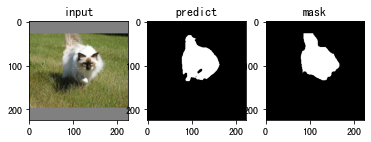

Epoch 1/1:  16%|█▌        | 236/1470 [08:11<42:21,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Birman_183.png'] : tensor(0.9672)
/openbayes/input/input3/test_image/Birman_183.png
hd: 7.615773105863909
jc: 0.9365385853124799
sc: 0.9772330423102753
sp: 0.9816641160800318


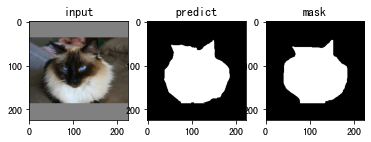

Epoch 1/1:  16%|█▌        | 237/1470 [08:13<42:53,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_185.png'] : tensor(0.9014)
/openbayes/input/input3/test_image/Birman_185.png
hd: 21.587033144922902
jc: 0.8204494382022471
sc: 0.9131304710295957
sp: 0.9645111442864251


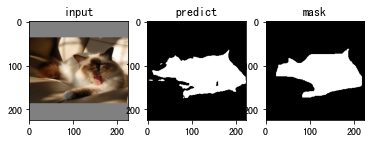

Epoch 1/1:  16%|█▌        | 238/1470 [08:15<42:29,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_187.png'] : tensor(0.8886)
/openbayes/input/input3/test_image/Birman_187.png
hd: 37.0
jc: 0.7995918367346939
sc: 0.9370515641442648
sp: 0.9547617249452458


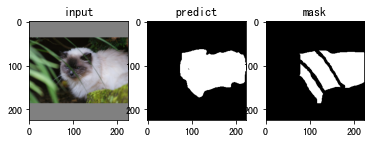

Epoch 1/1:  16%|█▋        | 239/1470 [08:17<41:24,  2.02s/it, f_score=0.935]

['/openbayes/input/input3/test_image/Birman_192.png'] : tensor(0.9557)
/openbayes/input/input3/test_image/Birman_192.png
hd: 10.770329614269007
jc: 0.9151075771749299
sc: 0.9506802721088435
sp: 0.996526270082501


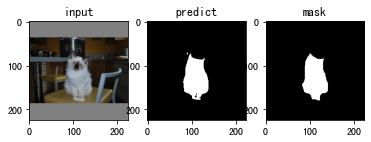

Epoch 1/1:  16%|█▋        | 240/1470 [08:19<41:54,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_24.png'] : tensor(0.8539)
/openbayes/input/input3/test_image/Birman_24.png
hd: 64.88451279003334
jc: 0.7451194752459784
sc: 0.8374583113919607
sp: 0.9841273409923784


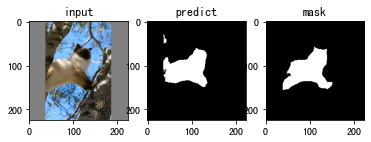

Epoch 1/1:  16%|█▋        | 241/1470 [08:22<42:58,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_3.png'] : tensor(0.9275)
/openbayes/input/input3/test_image/Birman_3.png
hd: 17.46424919657298
jc: 0.8648829431438128
sc: 0.9677586504692268
sp: 0.9370256347730668


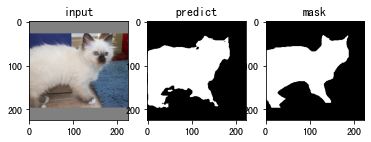

Epoch 1/1:  16%|█▋        | 242/1470 [08:24<43:31,  2.13s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_30.png'] : tensor(0.9309)
/openbayes/input/input3/test_image/Birman_30.png
hd: 14.560219778561036
jc: 0.8707741935483871
sc: 0.9576415495955726
sp: 0.9610332021506568


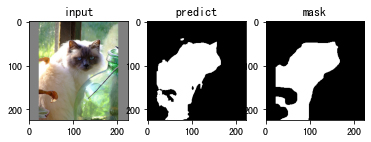

Epoch 1/1:  17%|█▋        | 243/1470 [08:26<42:03,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_36.png'] : tensor(0.9248)
/openbayes/input/input3/test_image/Birman_36.png
hd: 21.93171219946131
jc: 0.8600658921449628
sc: 0.9593810444874274
sp: 0.9700271111557385


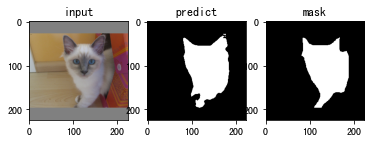

Epoch 1/1:  17%|█▋        | 244/1470 [08:28<42:16,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_38.png'] : tensor(0.9561)
/openbayes/input/input3/test_image/Birman_38.png
hd: 8.06225774829855
jc: 0.915828282197088
sc: 0.9445733436452693
sp: 0.9859492210040393


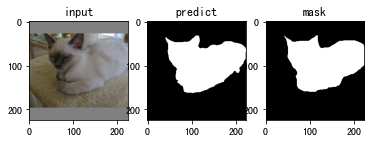

Epoch 1/1:  17%|█▋        | 245/1470 [08:30<41:13,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_39.png'] : tensor(0.9112)
/openbayes/input/input3/test_image/Birman_39.png
hd: 28.635642126552707
jc: 0.836963036963037
sc: 0.9388166741371582
sp: 0.9736740036846698


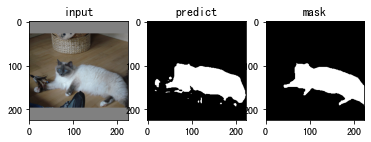

Epoch 1/1:  17%|█▋        | 246/1470 [08:32<41:38,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_41.png'] : tensor(0.9282)
/openbayes/input/input3/test_image/Birman_41.png
hd: 24.758836806279895
jc: 0.8659592897358164
sc: 0.9006756756756756
sp: 0.9913793103448276


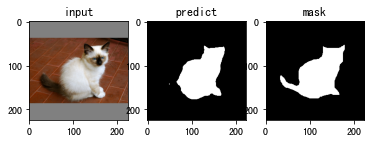

Epoch 1/1:  17%|█▋        | 247/1470 [08:34<41:10,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_43.png'] : tensor(0.9188)
/openbayes/input/input3/test_image/Birman_43.png
hd: 22.825424421026653
jc: 0.8498082030097374
sc: 0.9076583674755752
sp: 0.9769501654039057


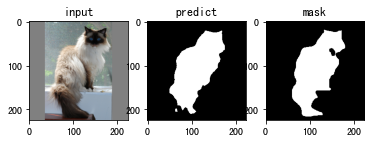

Epoch 1/1:  17%|█▋        | 248/1470 [08:36<42:19,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_48.png'] : tensor(0.9239)
/openbayes/input/input3/test_image/Birman_48.png
hd: 14.317821063276353
jc: 0.8586416652714995
sc: 0.9156153296834088
sp: 0.9665887570418314


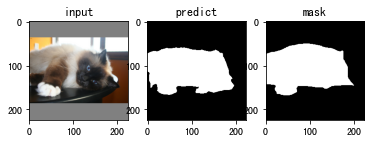

Epoch 1/1:  17%|█▋        | 249/1470 [08:38<41:43,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_52.png'] : tensor(0.8383)
/openbayes/input/input3/test_image/Birman_52.png
hd: 34.0
jc: 0.721612296110414
sc: 0.9363044363044363
sp: 0.9676991736997923


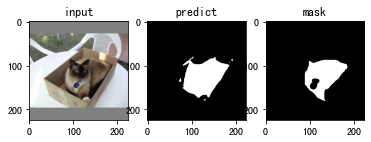

Epoch 1/1:  17%|█▋        | 250/1470 [08:40<41:56,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_56.png'] : tensor(0.8915)
/openbayes/input/input3/test_image/Birman_56.png
hd: 29.0
jc: 0.8041772444034156
sc: 0.8561425061425061
sp: 0.9874869159767818


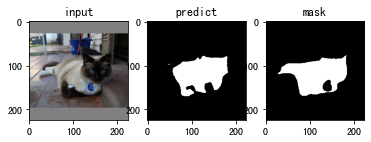

Epoch 1/1:  17%|█▋        | 251/1470 [08:42<42:31,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_58.png'] : tensor(0.9467)
/openbayes/input/input3/test_image/Birman_58.png
hd: 14.422205101855956
jc: 0.8987767747449389
sc: 0.9161992921317724
sp: 0.9888089025808683


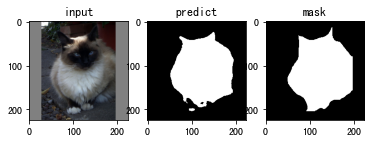

Epoch 1/1:  17%|█▋        | 252/1470 [08:44<43:16,  2.13s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_65.png'] : tensor(0.9794)
/openbayes/input/input3/test_image/Birman_65.png
hd: 6.708203932499369
jc: 0.9595655348667397
sc: 0.9636996974974792
sp: 0.9988030661878932


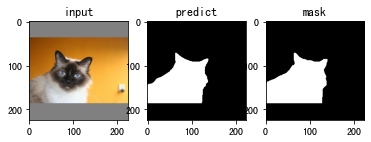

Epoch 1/1:  17%|█▋        | 253/1470 [08:46<42:34,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_70.png'] : tensor(0.9038)
/openbayes/input/input3/test_image/Birman_70.png
hd: 27.018512172212592
jc: 0.8244034862123161
sc: 0.9522237808400033
sp: 0.9506266915416349


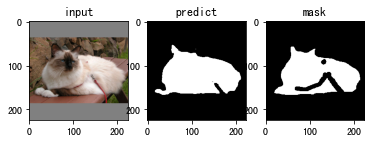

Epoch 1/1:  17%|█▋        | 254/1470 [08:48<42:07,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_83.png'] : tensor(0.8890)
/openbayes/input/input3/test_image/Birman_83.png
hd: 37.20215047547655
jc: 0.800146479904788
sc: 0.8982989876149854
sp: 0.9222905882735944


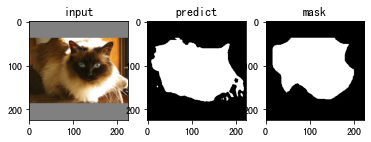

Epoch 1/1:  17%|█▋        | 255/1470 [08:50<42:04,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_95.png'] : tensor(0.9119)
/openbayes/input/input3/test_image/Birman_95.png
hd: 19.6468827043885
jc: 0.83811850946854
sc: 0.8657972233908288
sp: 0.9965435251640175


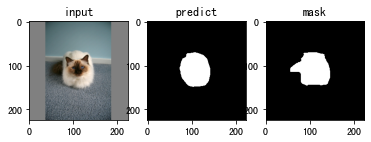

Epoch 1/1:  17%|█▋        | 256/1470 [08:53<41:35,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Birman_98.png'] : tensor(0.9349)
/openbayes/input/input3/test_image/Birman_98.png
hd: 16.278820596099706
jc: 0.877819465901567
sc: 0.981298726931807
sp: 0.9201270478100969


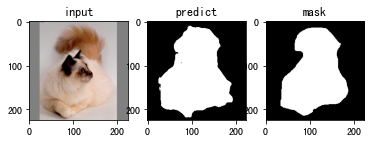

Epoch 1/1:  17%|█▋        | 257/1470 [08:55<41:33,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Bombay_1.png'] : tensor(0.9314)
/openbayes/input/input3/test_image/Bombay_1.png
hd: 15.0
jc: 0.8715858715858716
sc: 0.9302503052503053
sp: 0.9898908857509627


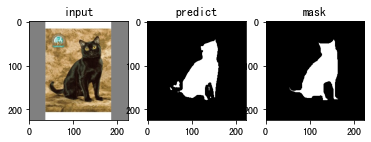

Epoch 1/1:  18%|█▊        | 258/1470 [08:56<40:47,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Bombay_100.png'] : tensor(0.9852)
/openbayes/input/input3/test_image/Bombay_100.png
hd: 6.0
jc: 0.9708408766996649
sc: 0.9883921568627451
sp: 0.9813178797211866


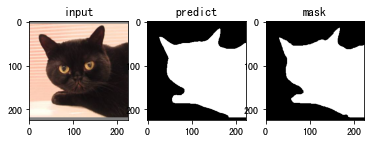

Epoch 1/1:  18%|█▊        | 259/1470 [08:58<40:39,  2.01s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_102.png'] : tensor(0.9750)
/openbayes/input/input3/test_image/Bombay_102.png
hd: 4.242640687119285
jc: 0.9512299648581469
sc: 0.9874543998576386
sp: 0.9890078845314225


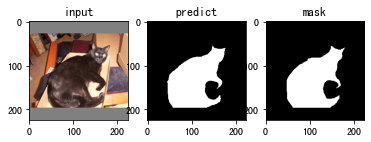

Epoch 1/1:  18%|█▊        | 260/1470 [09:01<42:29,  2.11s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_103.png'] : tensor(0.9210)
/openbayes/input/input3/test_image/Bombay_103.png
hd: 13.0
jc: 0.8536537582446287
sc: 0.9917305212047645
sp: 0.9423705906203541


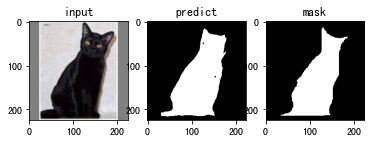

Epoch 1/1:  18%|█▊        | 261/1470 [09:03<42:07,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_107.png'] : tensor(0.9525)
/openbayes/input/input3/test_image/Bombay_107.png
hd: 29.0
jc: 0.9092664092664092
sc: 0.9832985386221295
sp: 0.9731191347224432


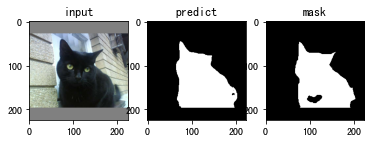

Epoch 1/1:  18%|█▊        | 262/1470 [09:05<41:35,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_111.png'] : tensor(0.7874)
/openbayes/input/input3/test_image/Bombay_111.png
hd: 81.2219182240853
jc: 0.6493047892297507
sc: 0.9806666666666667
sp: 0.9306863455269829


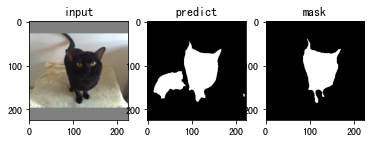

Epoch 1/1:  18%|█▊        | 263/1470 [09:07<41:24,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_112.png'] : tensor(0.9137)
/openbayes/input/input3/test_image/Bombay_112.png
hd: 22.360679774997898
jc: 0.8411915204678363
sc: 0.9714044528859344
sp: 0.9639548883264946


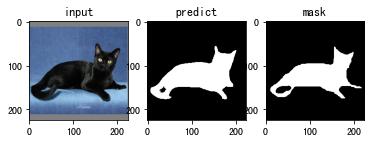

Epoch 1/1:  18%|█▊        | 264/1470 [09:09<41:36,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_113.png'] : tensor(0.9506)
/openbayes/input/input3/test_image/Bombay_113.png
hd: 7.211102550927978
jc: 0.9058823529411765
sc: 0.9171993027309704
sp: 0.9952757635684465


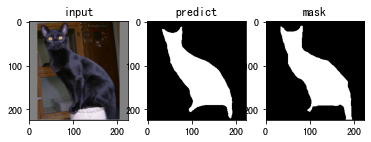

Epoch 1/1:  18%|█▊        | 265/1470 [09:11<41:19,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_121.png'] : tensor(0.9427)
/openbayes/input/input3/test_image/Bombay_121.png
hd: 6.708203932499369
jc: 0.8916341569137408
sc: 0.9994331524819824
sp: 0.9605308377613874


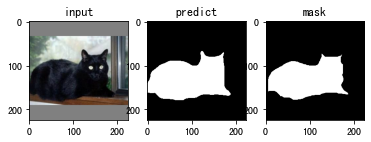

Epoch 1/1:  18%|█▊        | 266/1470 [09:13<41:07,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_123.png'] : tensor(0.9124)
/openbayes/input/input3/test_image/Bombay_123.png
hd: 25.019992006393608
jc: 0.8389849414389292
sc: 0.9697653429602888
sp: 0.9302446342026309


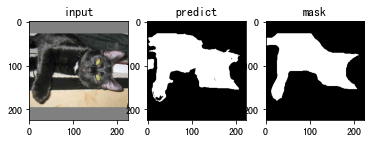

Epoch 1/1:  18%|█▊        | 267/1470 [09:15<40:57,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_130.png'] : tensor(0.9637)
/openbayes/input/input3/test_image/Bombay_130.png
hd: 13.0
jc: 0.9299079011148812
sc: 0.975094032733557
sp: 0.9881504251468802


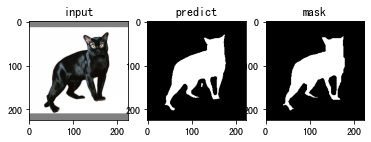

Epoch 1/1:  18%|█▊        | 268/1470 [09:17<40:34,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_132.png'] : tensor(0.9706)
/openbayes/input/input3/test_image/Bombay_132.png
hd: 16.401219466856727
jc: 0.9429278536073197
sc: 0.9844961240310077
sp: 0.9849485362919396


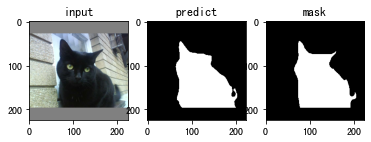

Epoch 1/1:  18%|█▊        | 269/1470 [09:19<40:36,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_133.png'] : tensor(0.9388)
/openbayes/input/input3/test_image/Bombay_133.png
hd: 9.433981132056603
jc: 0.8846573548668704
sc: 0.95804774285039
sp: 0.9831711176103946


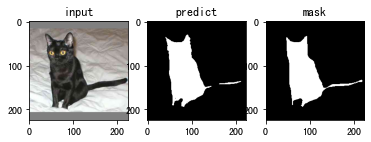

Epoch 1/1:  18%|█▊        | 270/1470 [09:21<42:23,  2.12s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_135.png'] : tensor(0.9156)
/openbayes/input/input3/test_image/Bombay_135.png
hd: 15.132745950421556
jc: 0.8442874692874693
sc: 0.9430531732418524
sp: 0.9927847485241531


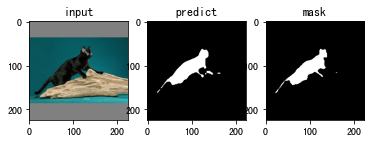

Epoch 1/1:  18%|█▊        | 271/1470 [09:23<41:17,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_137.png'] : tensor(0.8936)
/openbayes/input/input3/test_image/Bombay_137.png
hd: 17.804493814764857
jc: 0.8077052301489529
sc: 0.9296210363495746
sp: 0.9723937950869914


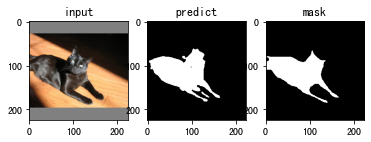

Epoch 1/1:  19%|█▊        | 272/1470 [09:26<41:33,  2.08s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_141.png'] : tensor(0.9437)
/openbayes/input/input3/test_image/Bombay_141.png
hd: 20.518284528683193
jc: 0.8934199837530463
sc: 0.982402858418937
sp: 0.9713963212847284


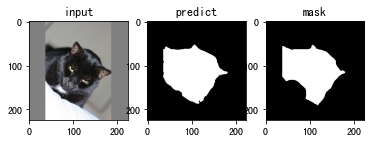

Epoch 1/1:  19%|█▊        | 273/1470 [09:28<40:57,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_143.png'] : tensor(0.9487)
/openbayes/input/input3/test_image/Bombay_143.png
hd: 11.661903789690601
jc: 0.9024139424117774
sc: 0.9914961941008563
sp: 0.9502398081534772


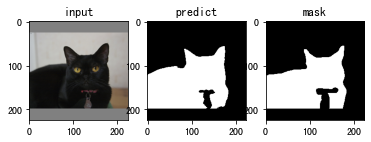

Epoch 1/1:  19%|█▊        | 274/1470 [09:30<42:38,  2.14s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_15.png'] : tensor(0.9785)
/openbayes/input/input3/test_image/Bombay_15.png
hd: 6.324555320336759
jc: 0.9579266886959195
sc: 0.9877183946753298
sp: 0.9685181471826749


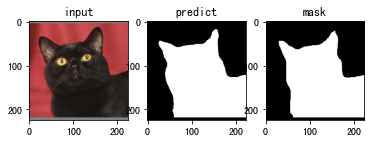

Epoch 1/1:  19%|█▊        | 275/1470 [09:32<42:38,  2.14s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_153.png'] : tensor(0.9417)
/openbayes/input/input3/test_image/Bombay_153.png
hd: 21.213203435596427
jc: 0.8899033297529538
sc: 0.9607189447746051
sp: 0.9873142777918987


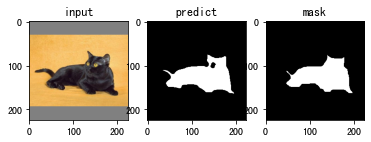

Epoch 1/1:  19%|█▉        | 276/1470 [09:34<42:08,  2.12s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_155.png'] : tensor(0.9524)
/openbayes/input/input3/test_image/Bombay_155.png
hd: 23.021728866442675
jc: 0.9092107431207778
sc: 0.953516502505616
sp: 0.9936470747257203


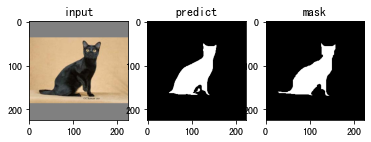

Epoch 1/1:  19%|█▉        | 277/1470 [09:36<42:44,  2.15s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_166.png'] : tensor(0.9511)
/openbayes/input/input3/test_image/Bombay_166.png
hd: 18.788294228055936
jc: 0.9067403595705482
sc: 0.9695672848311936
sp: 0.9712311380623325


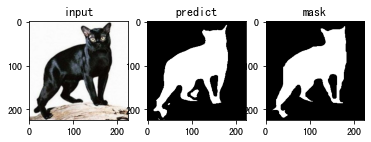

Epoch 1/1:  19%|█▉        | 278/1470 [09:38<41:54,  2.11s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_175.png'] : tensor(0.9002)
/openbayes/input/input3/test_image/Bombay_175.png
hd: 19.697715603592208
jc: 0.8185840707964602
sc: 0.9833451452870304
sp: 0.9744902541992275


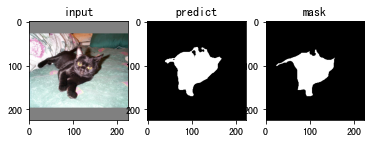

Epoch 1/1:  19%|█▉        | 279/1470 [09:40<41:29,  2.09s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_184.png'] : tensor(0.7744)
/openbayes/input/input3/test_image/Bombay_184.png
hd: 99.62429422585637
jc: 0.6318627450980392
sc: 0.9916655981536094
sp: 0.8952025863086108


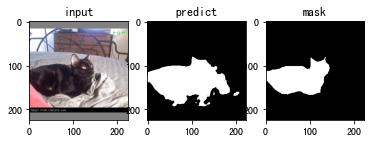

Epoch 1/1:  19%|█▉        | 280/1470 [09:43<42:03,  2.12s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_188.png'] : tensor(0.8335)
/openbayes/input/input3/test_image/Bombay_188.png
hd: 15.231546211727817
jc: 0.7145475372279496
sc: 0.8942087155963303
sp: 0.9812157299520219


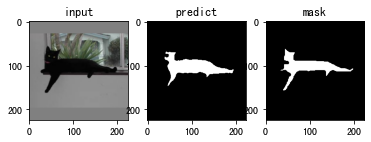

Epoch 1/1:  19%|█▉        | 281/1470 [09:45<41:31,  2.10s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_190.png'] : tensor(0.9408)
/openbayes/input/input3/test_image/Bombay_190.png
hd: 5.385164807134504
jc: 0.8882453151618399
sc: 0.9516335097645556
sp: 0.991252209320536


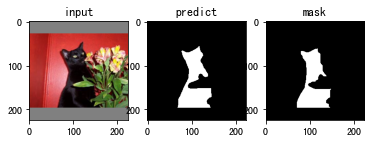

Epoch 1/1:  19%|█▉        | 282/1470 [09:46<40:26,  2.04s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_193.png'] : tensor(0.8785)
/openbayes/input/input3/test_image/Bombay_193.png
hd: 29.068883707497267
jc: 0.7833398821218075
sc: 0.9604933513201002
sp: 0.941027187295844


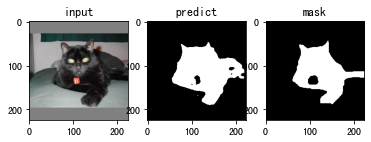

Epoch 1/1:  19%|█▉        | 283/1470 [09:49<40:35,  2.05s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_194.png'] : tensor(0.9566)
/openbayes/input/input3/test_image/Bombay_194.png
hd: 41.677331968349414
jc: 0.9167542229047119
sc: 0.9761197883051503
sp: 0.9441247447558938


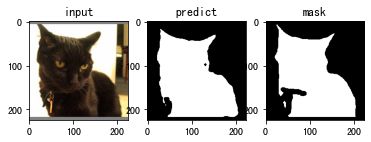

Epoch 1/1:  19%|█▉        | 284/1470 [09:51<40:07,  2.03s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_200.png'] : tensor(0.9561)
/openbayes/input/input3/test_image/Bombay_200.png
hd: 7.0710678118654755
jc: 0.9159159159159159
sc: 0.9428546193252075
sp: 0.9914294538528852


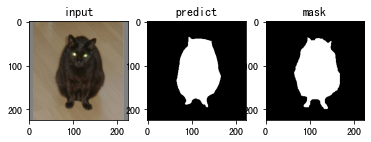

Epoch 1/1:  19%|█▉        | 285/1470 [09:53<41:03,  2.08s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_201.png'] : tensor(0.9569)
/openbayes/input/input3/test_image/Bombay_201.png
hd: 13.601470508735444
jc: 0.917298536413331
sc: 0.9713076492188959
sp: 0.9722653845026239


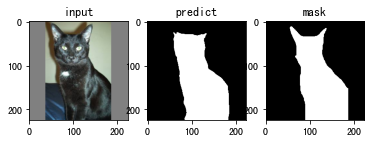

Epoch 1/1:  19%|█▉        | 286/1470 [09:55<40:04,  2.03s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_206.png'] : tensor(0.9658)
/openbayes/input/input3/test_image/Bombay_206.png
hd: 5.0
jc: 0.9338325991189428
sc: 0.9728315741165673
sp: 0.9884167918332019


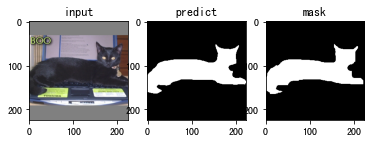

Epoch 1/1:  20%|█▉        | 287/1470 [09:57<40:49,  2.07s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_22.png'] : tensor(0.9176)
/openbayes/input/input3/test_image/Bombay_22.png
hd: 21.0
jc: 0.8477869173521347
sc: 0.9600780695528743
sp: 0.9616234834464322


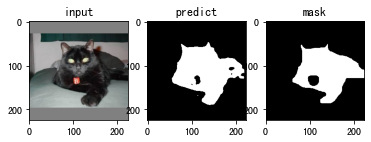

Epoch 1/1:  20%|█▉        | 288/1470 [09:59<40:54,  2.08s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_24.png'] : tensor(0.9540)
/openbayes/input/input3/test_image/Bombay_24.png
hd: 60.07495318350236
jc: 0.9120699517855684
sc: 0.9413004975963566
sp: 0.9900832485190114


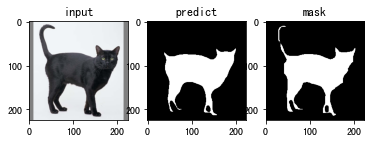

Epoch 1/1:  20%|█▉        | 289/1470 [10:01<39:48,  2.02s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_30.png'] : tensor(0.9477)
/openbayes/input/input3/test_image/Bombay_30.png
hd: 13.038404810405298
jc: 0.900626678603402
sc: 0.9904011813930593
sp: 0.9680153736804696


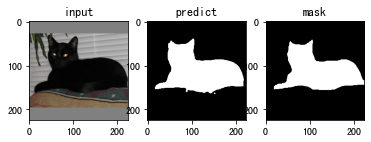

Epoch 1/1:  20%|█▉        | 290/1470 [10:03<39:49,  2.03s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_31.png'] : tensor(0.9484)
/openbayes/input/input3/test_image/Bombay_31.png
hd: 14.0
jc: 0.9018024630943643
sc: 0.9621475809258615
sp: 0.9801209802502326


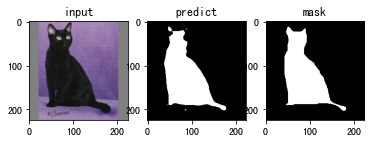

Epoch 1/1:  20%|█▉        | 291/1470 [10:05<39:05,  1.99s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_36.png'] : tensor(0.6932)
/openbayes/input/input3/test_image/Bombay_36.png
hd: 61.220911460055866
jc: 0.5304601425793908
sc: 0.9909200968523002
sp: 0.9704476135520567


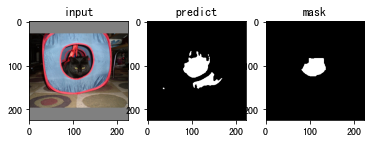

Epoch 1/1:  20%|█▉        | 292/1470 [10:07<39:30,  2.01s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_39.png'] : tensor(0.9527)
/openbayes/input/input3/test_image/Bombay_39.png
hd: 10.816653826391969
jc: 0.909757258448358
sc: 0.9706479788746699
sp: 0.9836598065955864


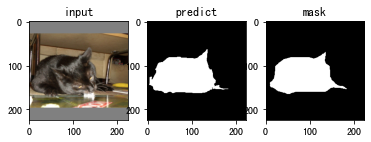

Epoch 1/1:  20%|█▉        | 293/1470 [10:09<39:39,  2.02s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_49.png'] : tensor(0.9477)
/openbayes/input/input3/test_image/Bombay_49.png
hd: 15.0
jc: 0.9005670103092783
sc: 0.9622184281544308
sp: 0.9611792997907492


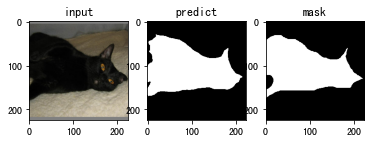

Epoch 1/1:  20%|██        | 294/1470 [10:11<41:35,  2.12s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_57.png'] : tensor(0.9436)
/openbayes/input/input3/test_image/Bombay_57.png
hd: 12.649110640673518
jc: 0.8932926829268293
sc: 0.9880567654910777
sp: 0.9824659188555238


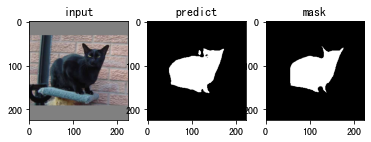

Epoch 1/1:  20%|██        | 295/1470 [10:13<42:04,  2.15s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Bombay_58.png'] : tensor(0.4231)
/openbayes/input/input3/test_image/Bombay_58.png
hd: 55.0
jc: 0.2683078196110881
sc: 0.2753130970070049
sp: 0.993963782696177


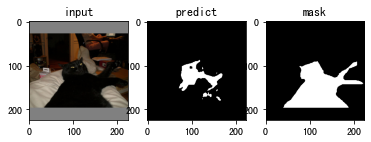

Epoch 1/1:  20%|██        | 296/1470 [10:16<42:25,  2.17s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_59.png'] : tensor(0.9049)
/openbayes/input/input3/test_image/Bombay_59.png
hd: 58.0
jc: 0.8263692828910221
sc: 0.9248674648035671
sp: 0.8434979025492094


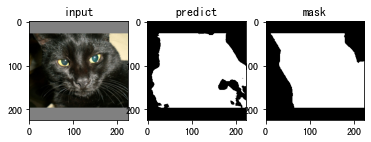

Epoch 1/1:  20%|██        | 297/1470 [10:18<41:18,  2.11s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_61.png'] : tensor(0.9496)
/openbayes/input/input3/test_image/Bombay_61.png
hd: 66.0
jc: 0.9039692701664532
sc: 0.9611046285492026
sp: 0.9560929478519319


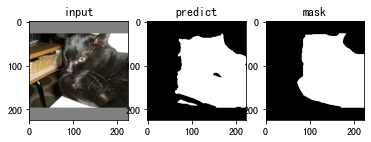

Epoch 1/1:  20%|██        | 298/1470 [10:20<40:56,  2.10s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_66.png'] : tensor(0.9627)
/openbayes/input/input3/test_image/Bombay_66.png
hd: 13.0
jc: 0.9281562802712302
sc: 0.9600868403473614
sp: 0.9808146032534459


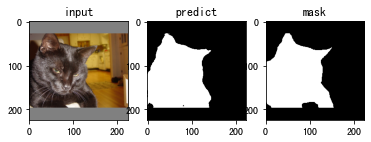

Epoch 1/1:  20%|██        | 299/1470 [10:22<40:46,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_67.png'] : tensor(0.9032)
/openbayes/input/input3/test_image/Bombay_67.png
hd: 58.0
jc: 0.823464022833108
sc: 0.8372739491691105
sp: 0.9685206422018349


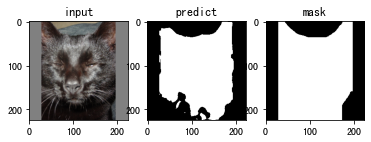

Epoch 1/1:  20%|██        | 300/1470 [10:24<40:46,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_72.png'] : tensor(0.9552)
/openbayes/input/input3/test_image/Bombay_72.png
hd: 61.0
jc: 0.9142591165896251
sc: 0.9440798196764784
sp: 0.9508196721311475


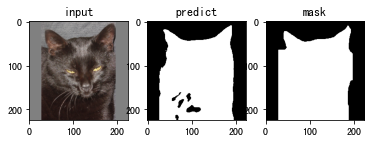

Epoch 1/1:  20%|██        | 301/1470 [10:26<39:30,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_82.png'] : tensor(0.9371)
/openbayes/input/input3/test_image/Bombay_82.png
hd: 14.317821063276353
jc: 0.8815854502322823
sc: 0.9797868834450181
sp: 0.9753122489226499


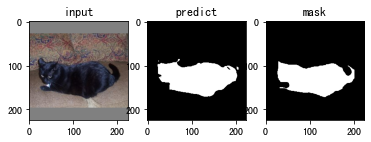

Epoch 1/1:  21%|██        | 302/1470 [10:28<38:03,  1.95s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_85.png'] : tensor(0.9593)
/openbayes/input/input3/test_image/Bombay_85.png
hd: 5.0990195135927845
jc: 0.9217075546895758
sc: 0.9735266604303087
sp: 0.9847794154890341


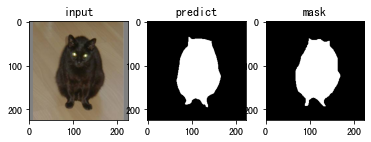

Epoch 1/1:  21%|██        | 303/1470 [10:29<38:08,  1.96s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Bombay_96.png'] : tensor(0.9619)
/openbayes/input/input3/test_image/Bombay_96.png
hd: 22.0
jc: 0.926677367576244
sc: 0.993324156916724
sp: 0.9706839477080177


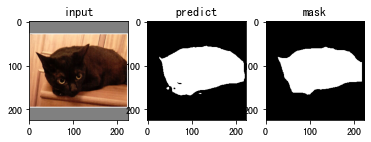

Epoch 1/1:  21%|██        | 304/1470 [10:32<39:47,  2.05s/it, f_score=0.938]

['/openbayes/input/input3/test_image/boxer_107.png'] : tensor(0.9387)
/openbayes/input/input3/test_image/boxer_107.png
hd: 28.178005607210743
jc: 0.8845419146278745
sc: 0.9014300688828991
sp: 0.9782645755199455


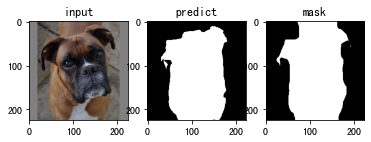

Epoch 1/1:  21%|██        | 305/1470 [10:34<40:27,  2.08s/it, f_score=0.938]

['/openbayes/input/input3/test_image/boxer_120.png'] : tensor(0.8073)
/openbayes/input/input3/test_image/boxer_120.png
hd: 15.524174696260024
jc: 0.6768342951360263
sc: 0.8403275332650972
sp: 0.9952031545356613


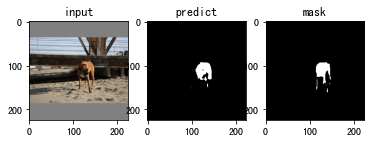

Epoch 1/1:  21%|██        | 306/1470 [10:36<42:38,  2.20s/it, f_score=0.937]

['/openbayes/input/input3/test_image/boxer_136.png'] : tensor(0.7160)
/openbayes/input/input3/test_image/boxer_136.png
hd: 68.87670143089025
jc: 0.5576799140708916
sc: 0.7680473372781065
sp: 0.9727540815454312


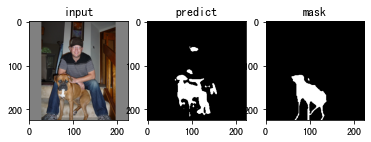

Epoch 1/1:  21%|██        | 307/1470 [10:39<42:22,  2.19s/it, f_score=0.937]

['/openbayes/input/input3/test_image/boxer_14.png'] : tensor(0.6107)
/openbayes/input/input3/test_image/boxer_14.png
hd: 82.97590011563598
jc: 0.4395527603074773
sc: 0.8313233107549975
sp: 0.8777281689821635


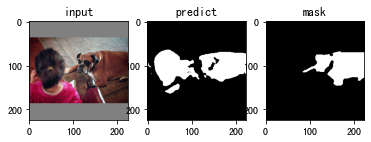

Epoch 1/1:  21%|██        | 308/1470 [10:41<42:29,  2.19s/it, f_score=0.937]

['/openbayes/input/input3/test_image/boxer_141.png'] : tensor(0.6728)
/openbayes/input/input3/test_image/boxer_141.png
hd: 79.05694150420949
jc: 0.5068809643395279
sc: 0.8287075053374938
sp: 0.9123097511738154


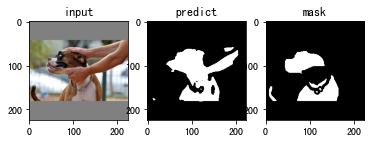

Epoch 1/1:  21%|██        | 309/1470 [10:43<41:45,  2.16s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_155.png'] : tensor(0.9229)
/openbayes/input/input3/test_image/boxer_155.png
hd: 19.209372712298546
jc: 0.8568803852002027
sc: 0.887991596086928
sp: 0.984175132350837


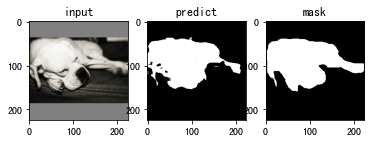

Epoch 1/1:  21%|██        | 310/1470 [10:45<41:06,  2.13s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_156.png'] : tensor(0.8632)
/openbayes/input/input3/test_image/boxer_156.png
hd: 41.0
jc: 0.759270406934746
sc: 0.7690384732638254
sp: 0.9937527757216876


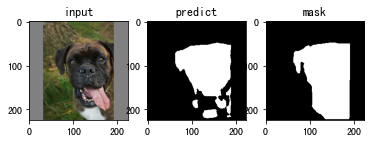

Epoch 1/1:  21%|██        | 311/1470 [10:47<41:22,  2.14s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_16.png'] : tensor(0.8588)
/openbayes/input/input3/test_image/boxer_16.png
hd: 18.0
jc: 0.7525297180469595
sc: 0.916267942583732
sp: 0.9564999043428353


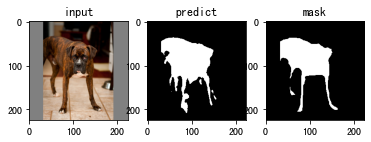

Epoch 1/1:  21%|██        | 312/1470 [10:49<41:02,  2.13s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_164.png'] : tensor(0.8287)
/openbayes/input/input3/test_image/boxer_164.png
hd: 22.090722034374522
jc: 0.7075757575757575
sc: 0.7668308702791461
sp: 0.9934224667899059


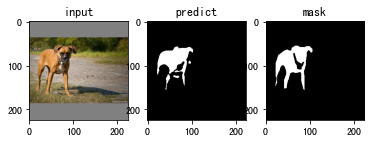

Epoch 1/1:  21%|██▏       | 313/1470 [10:51<41:42,  2.16s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_172.png'] : tensor(0.7081)
/openbayes/input/input3/test_image/boxer_172.png
hd: 21.213203435596427
jc: 0.5481111903064861
sc: 0.6198280494357872
sp: 0.9895165109570758


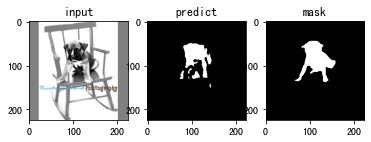

Epoch 1/1:  21%|██▏       | 314/1470 [10:53<40:44,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_174.png'] : tensor(0.9354)
/openbayes/input/input3/test_image/boxer_174.png
hd: 26.076809620810597
jc: 0.878589455016711
sc: 0.946923472763361
sp: 0.9710715555190987


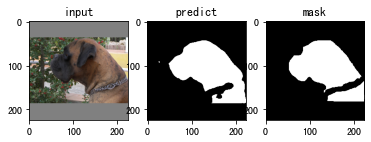

Epoch 1/1:  21%|██▏       | 315/1470 [10:55<40:09,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_175.png'] : tensor(0.8810)
/openbayes/input/input3/test_image/boxer_175.png
hd: 72.02777242147643
jc: 0.7872340425531915
sc: 0.9208969935929029
sp: 0.985060063315842


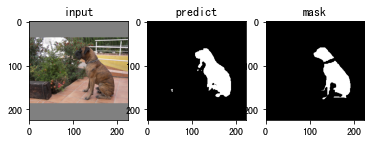

Epoch 1/1:  21%|██▏       | 316/1470 [10:57<39:49,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_182.png'] : tensor(0.8309)
/openbayes/input/input3/test_image/boxer_182.png
hd: 14.866068747318506
jc: 0.7106972715461238
sc: 0.812778603268945
sp: 0.9939780301929106


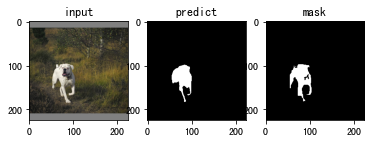

Epoch 1/1:  22%|██▏       | 317/1470 [10:59<39:22,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_184.png'] : tensor(0.9046)
/openbayes/input/input3/test_image/boxer_184.png
hd: 28.319604517012593
jc: 0.8257500496721637
sc: 0.8736598696657557
sp: 0.9939232479799203


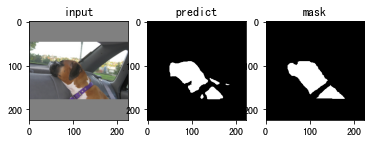

Epoch 1/1:  22%|██▏       | 318/1470 [11:02<40:41,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_190.png'] : tensor(0.9360)
/openbayes/input/input3/test_image/boxer_190.png
hd: 14.0
jc: 0.8797638217928073
sc: 0.9258724579462717
sp: 0.9756161663357085


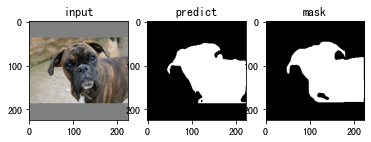

Epoch 1/1:  22%|██▏       | 319/1470 [11:04<40:27,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_199.png'] : tensor(0.9448)
/openbayes/input/input3/test_image/boxer_199.png
hd: 18.027756377319946
jc: 0.8954082977489588
sc: 0.9371551533877731
sp: 0.9736365905403719


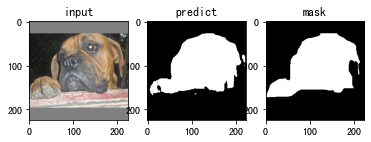

Epoch 1/1:  22%|██▏       | 320/1470 [11:06<40:13,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_24.png'] : tensor(0.8905)
/openbayes/input/input3/test_image/boxer_24.png
hd: 22.135943621178654
jc: 0.8026108288067286
sc: 0.904254269075116
sp: 0.9679610438256961


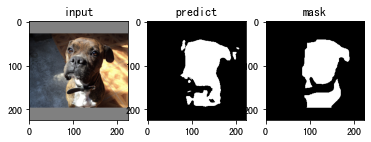

Epoch 1/1:  22%|██▏       | 321/1470 [11:08<39:53,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_25.png'] : tensor(0.8999)
/openbayes/input/input3/test_image/boxer_25.png
hd: 25.942243542145693
jc: 0.8179641493561121
sc: 0.9605593130177065
sp: 0.9380284734041117


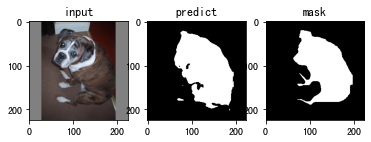

Epoch 1/1:  22%|██▏       | 322/1470 [11:10<40:00,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_32.png'] : tensor(0.9435)
/openbayes/input/input3/test_image/boxer_32.png
hd: 38.07886552931954
jc: 0.8929618768328446
sc: 0.9706860706860707
sp: 0.9648632014770884


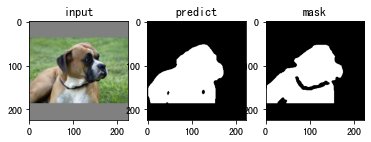

Epoch 1/1:  22%|██▏       | 323/1470 [11:12<41:41,  2.18s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_36.png'] : tensor(0.7918)
/openbayes/input/input3/test_image/boxer_36.png
hd: 40.496913462633174
jc: 0.6553075024149404
sc: 0.8546930776230139
sp: 0.8788765359859567


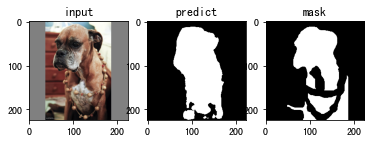

Epoch 1/1:  22%|██▏       | 324/1470 [11:15<41:17,  2.16s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_38.png'] : tensor(0.9083)
/openbayes/input/input3/test_image/boxer_38.png
hd: 38.47076812334269
jc: 0.8319984983105995
sc: 0.9404484051205885
sp: 0.9488581180453423


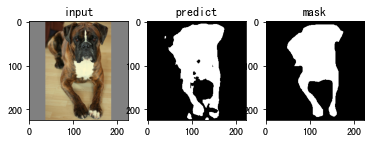

Epoch 1/1:  22%|██▏       | 325/1470 [11:17<41:37,  2.18s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_4.png'] : tensor(0.8561)
/openbayes/input/input3/test_image/boxer_4.png
hd: 18.867962264113206
jc: 0.7484713729849917
sc: 0.877484522645813
sp: 0.9887702464601864


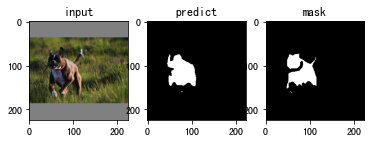

Epoch 1/1:  22%|██▏       | 326/1470 [11:19<40:45,  2.14s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_44.png'] : tensor(0.9569)
/openbayes/input/input3/test_image/boxer_44.png
hd: 36.796738985948195
jc: 0.9174218511353223
sc: 0.9681925639372448
sp: 0.9673678874667343


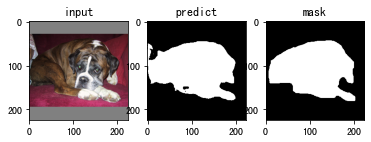

Epoch 1/1:  22%|██▏       | 327/1470 [11:21<41:32,  2.18s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_48.png'] : tensor(0.9412)
/openbayes/input/input3/test_image/boxer_48.png
hd: 18.35755975068582
jc: 0.888962388962389
sc: 0.959212807178546
sp: 0.9808021006217642


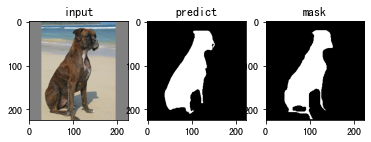

Epoch 1/1:  22%|██▏       | 328/1470 [11:23<41:45,  2.19s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_58.png'] : tensor(0.8972)
/openbayes/input/input3/test_image/boxer_58.png
hd: 49.24428900898052
jc: 0.8135248806767166
sc: 0.8445763626551538
sp: 0.9738864834021415


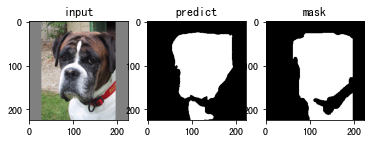

Epoch 1/1:  22%|██▏       | 329/1470 [11:26<42:07,  2.22s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_62.png'] : tensor(0.7246)
/openbayes/input/input3/test_image/boxer_62.png
hd: 32.0
jc: 0.5681595292579275
sc: 0.9157007376185459
sp: 0.921698664628389


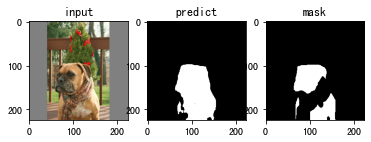

Epoch 1/1:  22%|██▏       | 330/1470 [11:27<40:23,  2.13s/it, f_score=0.935]

['/openbayes/input/input3/test_image/boxer_63.png'] : tensor(0.8808)
/openbayes/input/input3/test_image/boxer_63.png
hd: 18.867962264113206
jc: 0.7869846133351096
sc: 0.90128919063239
sp: 0.948633555453638


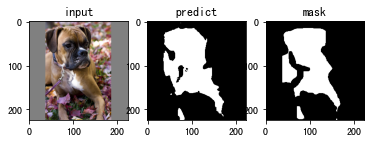

Epoch 1/1:  23%|██▎       | 331/1470 [11:30<40:16,  2.12s/it, f_score=0.935]

['/openbayes/input/input3/test_image/boxer_68.png'] : tensor(0.9132)
/openbayes/input/input3/test_image/boxer_68.png
hd: 24.08318915758459
jc: 0.8402470501474927
sc: 0.9135097213870516
sp: 0.9783571321956316


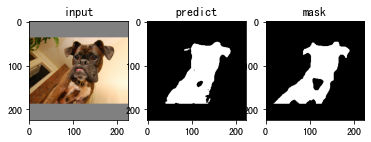

Epoch 1/1:  23%|██▎       | 332/1470 [11:32<40:08,  2.12s/it, f_score=0.935]

['/openbayes/input/input3/test_image/boxer_90.png'] : tensor(0.9691)
/openbayes/input/input3/test_image/boxer_90.png
hd: 21.0
jc: 0.9400346620450607
sc: 0.9686406171869419
sp: 0.988224562567377


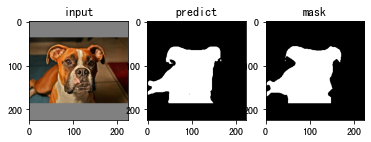

Epoch 1/1:  23%|██▎       | 333/1470 [11:34<39:31,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/boxer_94.png'] : tensor(0.9006)
/openbayes/input/input3/test_image/boxer_94.png
hd: 42.190046219457976
jc: 0.8191417753470761
sc: 0.9611511501628986
sp: 0.8826124740958621


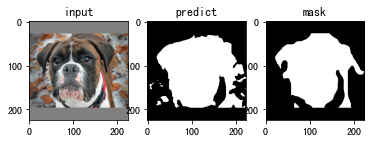

Epoch 1/1:  23%|██▎       | 334/1470 [11:36<39:38,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/boxer_97.png'] : tensor(0.8921)
/openbayes/input/input3/test_image/boxer_97.png
hd: 48.60041152089147
jc: 0.8052740571025732
sc: 0.8211758362725496
sp: 0.8447819177114604


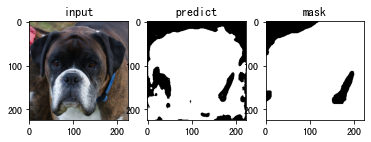

Epoch 1/1:  23%|██▎       | 335/1470 [11:38<40:20,  2.13s/it, f_score=0.935]

['/openbayes/input/input3/test_image/British_Shorthair_103.png'] : tensor(0.9226)
/openbayes/input/input3/test_image/British_Shorthair_103.png
hd: 10.0
jc: 0.8563267637817766
sc: 0.9233138281490607
sp: 0.9945875684544738


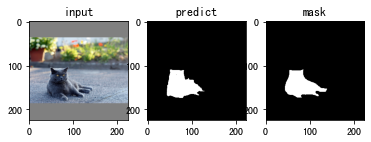

Epoch 1/1:  23%|██▎       | 336/1470 [11:40<39:12,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/British_Shorthair_110.png'] : tensor(0.9525)
/openbayes/input/input3/test_image/British_Shorthair_110.png
hd: 8.0
jc: 0.909398388025331
sc: 0.9480831270162803
sp: 0.9846120443998154


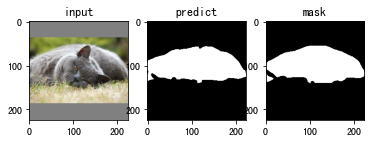

Epoch 1/1:  23%|██▎       | 337/1470 [11:42<38:50,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/British_Shorthair_112.png'] : tensor(0.9469)
/openbayes/input/input3/test_image/British_Shorthair_112.png
hd: 10.0
jc: 0.8990907735877179
sc: 0.9410296411856475
sp: 0.993168212767902


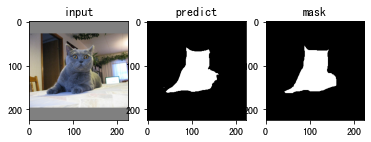

Epoch 1/1:  23%|██▎       | 338/1470 [11:44<38:26,  2.04s/it, f_score=0.935]

['/openbayes/input/input3/test_image/British_Shorthair_134.png'] : tensor(0.9679)
/openbayes/input/input3/test_image/British_Shorthair_134.png
hd: 15.811388300841896
jc: 0.9377368352280152
sc: 0.9634179084440865
sp: 0.9884347185214581


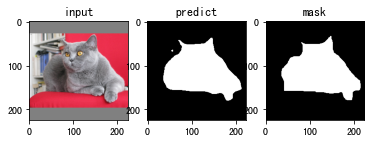

Epoch 1/1:  23%|██▎       | 339/1470 [11:46<37:29,  1.99s/it, f_score=0.935]

['/openbayes/input/input3/test_image/British_Shorthair_136.png'] : tensor(0.9214)
/openbayes/input/input3/test_image/British_Shorthair_136.png
hd: 80.05623023850174
jc: 0.8541953232462174
sc: 0.8925911407291258
sp: 0.991910260329704


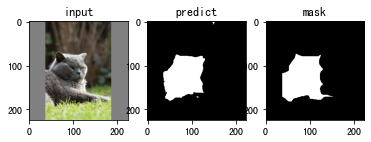

Epoch 1/1:  23%|██▎       | 340/1470 [11:48<37:13,  1.98s/it, f_score=0.935]

['/openbayes/input/input3/test_image/British_Shorthair_137.png'] : tensor(0.9450)
/openbayes/input/input3/test_image/British_Shorthair_137.png
hd: 16.278820596099706
jc: 0.8956639566395664
sc: 0.9689574890057774
sp: 0.9754011249643588


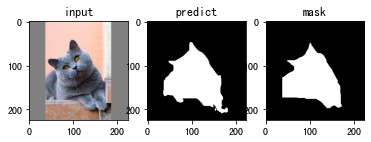

Epoch 1/1:  23%|██▎       | 341/1470 [11:50<37:54,  2.01s/it, f_score=0.935]

['/openbayes/input/input3/test_image/British_Shorthair_139.png'] : tensor(0.9671)
/openbayes/input/input3/test_image/British_Shorthair_139.png
hd: 27.0
jc: 0.9362819187017739
sc: 0.9845664812413736
sp: 0.9530589713328511


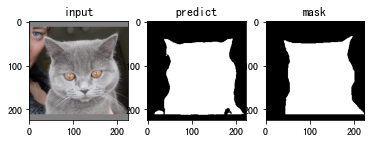

Epoch 1/1:  23%|██▎       | 342/1470 [11:52<37:54,  2.02s/it, f_score=0.935]

['/openbayes/input/input3/test_image/British_Shorthair_141.png'] : tensor(0.9454)
/openbayes/input/input3/test_image/British_Shorthair_141.png
hd: 35.014282800023196
jc: 0.8964833559428154
sc: 0.9596738159070599
sp: 0.9188250428816467


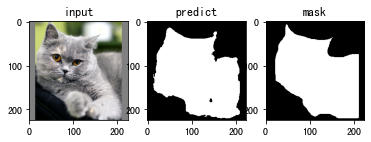

Epoch 1/1:  23%|██▎       | 343/1470 [11:54<37:33,  2.00s/it, f_score=0.935]

['/openbayes/input/input3/test_image/British_Shorthair_151.png'] : tensor(0.8664)
/openbayes/input/input3/test_image/British_Shorthair_151.png
hd: 14.0
jc: 0.7642369020501139
sc: 0.8784638882827842
sp: 0.9849757638233939


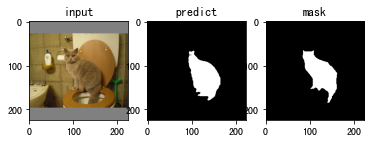

Epoch 1/1:  23%|██▎       | 344/1470 [11:56<37:43,  2.01s/it, f_score=0.935]

['/openbayes/input/input3/test_image/British_Shorthair_155.png'] : tensor(0.9339)
/openbayes/input/input3/test_image/British_Shorthair_155.png
hd: 16.1245154965971
jc: 0.8759737597375974
sc: 0.8877116443336449
sp: 0.9968186638388123


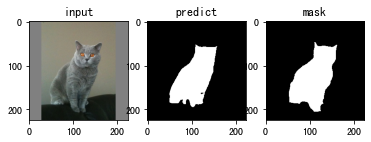

Epoch 1/1:  23%|██▎       | 345/1470 [11:58<38:42,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/British_Shorthair_164.png'] : tensor(0.9802)
/openbayes/input/input3/test_image/British_Shorthair_164.png
hd: 9.433981132056603
jc: 0.961214247429713
sc: 0.9799314490089911
sp: 0.9869529039773672


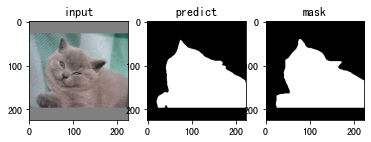

Epoch 1/1:  24%|██▎       | 346/1470 [12:00<39:17,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_167.png'] : tensor(0.9077)
/openbayes/input/input3/test_image/British_Shorthair_167.png
hd: 36.68787265568828
jc: 0.8309930637793943
sc: 0.835326795533133
sp: 0.9971722760104503


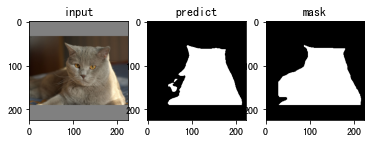

Epoch 1/1:  24%|██▎       | 347/1470 [12:02<38:31,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_169.png'] : tensor(0.8916)
/openbayes/input/input3/test_image/British_Shorthair_169.png
hd: 28.0
jc: 0.8044147843942505
sc: 0.870313801721744
sp: 0.993666129898014


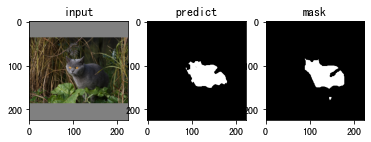

Epoch 1/1:  24%|██▎       | 348/1470 [12:04<37:44,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_170.png'] : tensor(0.9640)
/openbayes/input/input3/test_image/British_Shorthair_170.png
hd: 10.0
jc: 0.9304709642404873
sc: 0.9365705614567527
sp: 0.9967953473190706


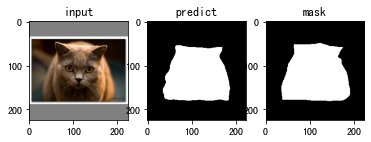

Epoch 1/1:  24%|██▎       | 349/1470 [12:06<38:04,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_174.png'] : tensor(0.8875)
/openbayes/input/input3/test_image/British_Shorthair_174.png
hd: 47.43416490252569
jc: 0.7977101777274845
sc: 0.9789250122528999
sp: 0.926688458902304


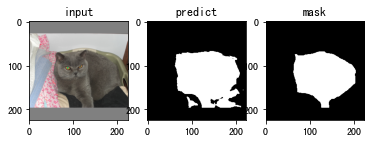

Epoch 1/1:  24%|██▍       | 350/1470 [12:08<37:47,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_177.png'] : tensor(0.9205)
/openbayes/input/input3/test_image/British_Shorthair_177.png
hd: 30.805843601498726
jc: 0.8527773811223761
sc: 0.913988368533823
sp: 0.9892534714266074


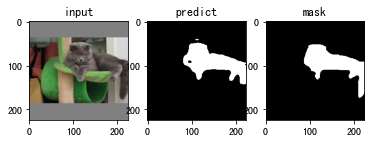

Epoch 1/1:  24%|██▍       | 351/1470 [12:10<37:53,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_178.png'] : tensor(0.9155)
/openbayes/input/input3/test_image/British_Shorthair_178.png
hd: 17.4928556845359
jc: 0.8441483753474552
sc: 0.9504640621627455
sp: 0.9714739672451723


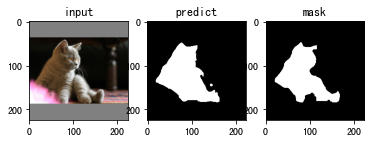

Epoch 1/1:  24%|██▍       | 352/1470 [12:12<38:25,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_182.png'] : tensor(0.8790)
/openbayes/input/input3/test_image/British_Shorthair_182.png
hd: 32.7566787083184
jc: 0.7841917200591424
sc: 0.9645373948624687
sp: 0.917926390654155


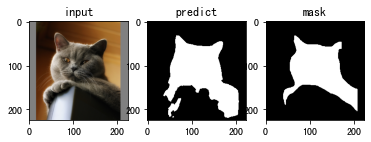

Epoch 1/1:  24%|██▍       | 353/1470 [12:14<37:42,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_184.png'] : tensor(0.9070)
/openbayes/input/input3/test_image/British_Shorthair_184.png
hd: 17.0
jc: 0.8298834903321765
sc: 0.9716296618778116
sp: 0.9353190086277958


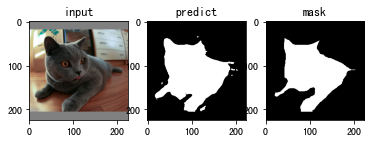

Epoch 1/1:  24%|██▍       | 354/1470 [12:16<37:35,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_193.png'] : tensor(0.9253)
/openbayes/input/input3/test_image/British_Shorthair_193.png
hd: 12.529964086141668
jc: 0.8609575185434929
sc: 0.9643504531722055
sp: 0.981747635228212


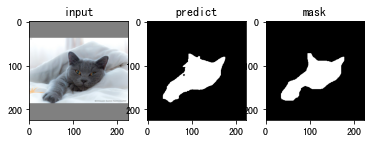

Epoch 1/1:  24%|██▍       | 355/1470 [12:18<36:58,  1.99s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_198.png'] : tensor(0.9789)
/openbayes/input/input3/test_image/British_Shorthair_198.png
hd: 5.0
jc: 0.9586935638808838
sc: 0.9775368943450438
sp: 0.9913659572026848


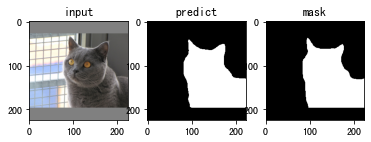

Epoch 1/1:  24%|██▍       | 356/1470 [12:20<37:27,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_199.png'] : tensor(0.9618)
/openbayes/input/input3/test_image/British_Shorthair_199.png
hd: 18.0
jc: 0.9263476391432439
sc: 0.9686927560366362
sp: 0.9856154692658387


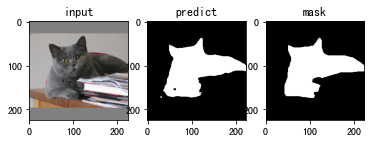

Epoch 1/1:  24%|██▍       | 357/1470 [12:22<37:44,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_210.png'] : tensor(0.9639)
/openbayes/input/input3/test_image/British_Shorthair_210.png
hd: 19.924858845171276
jc: 0.9302424049962951
sc: 0.9734160389898094
sp: 0.9898172450665889


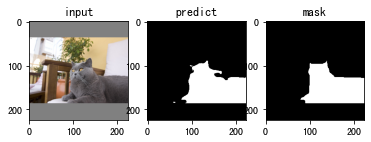

Epoch 1/1:  24%|██▍       | 358/1470 [12:25<38:03,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_223.png'] : tensor(0.9617)
/openbayes/input/input3/test_image/British_Shorthair_223.png
hd: 13.601470508735444
jc: 0.9263082249951002
sc: 0.9781318984547461
sp: 0.9772701793721973


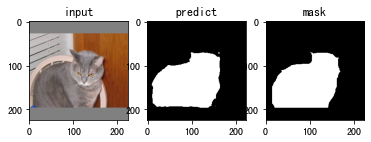

Epoch 1/1:  24%|██▍       | 359/1470 [12:27<37:20,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_25.png'] : tensor(0.9729)
/openbayes/input/input3/test_image/British_Shorthair_25.png
hd: 12.529964086141668
jc: 0.9472782560280955
sc: 0.9619449397642761
sp: 0.9869035794430342


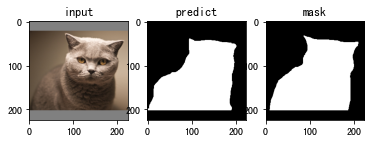

Epoch 1/1:  24%|██▍       | 360/1470 [12:29<37:15,  2.01s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_268.png'] : tensor(0.9690)
/openbayes/input/input3/test_image/British_Shorthair_268.png
hd: 19.849433241279208
jc: 0.9398306081637454
sc: 0.9586057951886736
sp: 0.9900617781359119


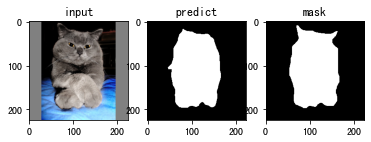

Epoch 1/1:  25%|██▍       | 361/1470 [12:31<37:21,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/British_Shorthair_271.png'] : tensor(0.9741)
/openbayes/input/input3/test_image/British_Shorthair_271.png
hd: 6.0
jc: 0.9494731153742232
sc: 0.9949741629503787
sp: 0.9812200061028045


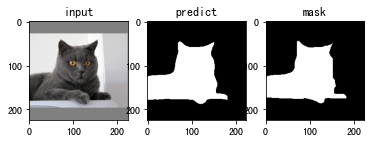

Epoch 1/1:  25%|██▍       | 362/1470 [12:33<37:28,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/British_Shorthair_29.png'] : tensor(0.9733)
/openbayes/input/input3/test_image/British_Shorthair_29.png
hd: 8.06225774829855
jc: 0.947953775306282
sc: 0.9637809187279152
sp: 0.9951358863495985


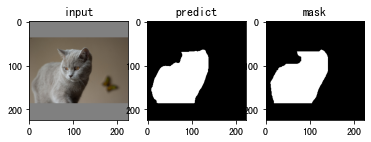

Epoch 1/1:  25%|██▍       | 363/1470 [12:34<36:32,  1.98s/it, f_score=0.937]

['/openbayes/input/input3/test_image/British_Shorthair_32.png'] : tensor(0.9556)
/openbayes/input/input3/test_image/British_Shorthair_32.png
hd: 59.23681287847955
jc: 0.9148838730781812
sc: 0.9719210453155407
sp: 0.9749357326478149


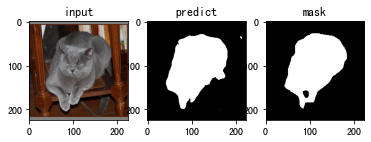

Epoch 1/1:  25%|██▍       | 364/1470 [12:36<36:31,  1.98s/it, f_score=0.937]

['/openbayes/input/input3/test_image/British_Shorthair_33.png'] : tensor(0.9442)
/openbayes/input/input3/test_image/British_Shorthair_33.png
hd: 13.0
jc: 0.8943805737616848
sc: 0.950119849332268
sp: 0.9868163708801159


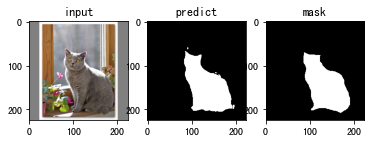

Epoch 1/1:  25%|██▍       | 365/1470 [12:39<36:51,  2.00s/it, f_score=0.937]

['/openbayes/input/input3/test_image/British_Shorthair_45.png'] : tensor(0.9670)
/openbayes/input/input3/test_image/British_Shorthair_45.png
hd: 5.0990195135927845
jc: 0.9360734302656161
sc: 0.9474636191729015
sp: 0.9961065951121985


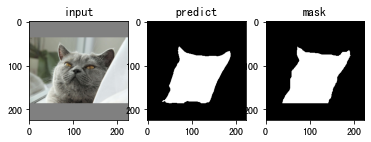

Epoch 1/1:  25%|██▍       | 366/1470 [12:41<36:56,  2.01s/it, f_score=0.937]

['/openbayes/input/input3/test_image/British_Shorthair_47.png'] : tensor(0.9625)
/openbayes/input/input3/test_image/British_Shorthair_47.png
hd: 11.0
jc: 0.9277848369335028
sc: 0.9486106098881271
sp: 0.9914374604223452


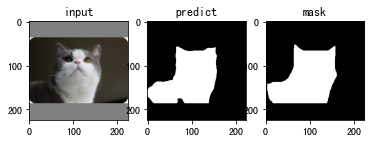

Epoch 1/1:  25%|██▍       | 367/1470 [12:42<36:33,  1.99s/it, f_score=0.937]

['/openbayes/input/input3/test_image/British_Shorthair_58.png'] : tensor(0.9613)
/openbayes/input/input3/test_image/British_Shorthair_58.png
hd: 14.0
jc: 0.9255041518386714
sc: 0.9753719214901863
sp: 0.9747790976651647


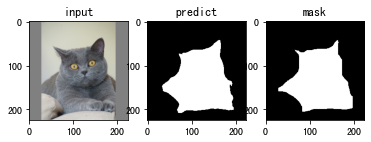

Epoch 1/1:  25%|██▌       | 368/1470 [12:45<37:30,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/British_Shorthair_6.png'] : tensor(0.9624)
/openbayes/input/input3/test_image/British_Shorthair_6.png
hd: 9.0
jc: 0.9275707481087139
sc: 0.9746798174591491
sp: 0.9920475762395409


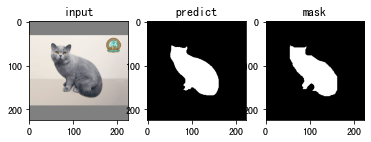

Epoch 1/1:  25%|██▌       | 369/1470 [12:47<38:25,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/British_Shorthair_61.png'] : tensor(0.8598)
/openbayes/input/input3/test_image/British_Shorthair_61.png
hd: 37.0
jc: 0.7541371158392435
sc: 0.9279678625848455
sp: 0.9612635891705659


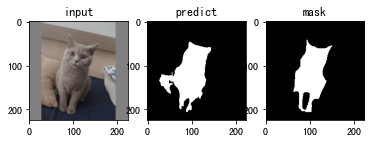

Epoch 1/1:  25%|██▌       | 370/1470 [12:49<38:59,  2.13s/it, f_score=0.937]

['/openbayes/input/input3/test_image/British_Shorthair_66.png'] : tensor(0.9562)
/openbayes/input/input3/test_image/British_Shorthair_66.png
hd: 20.0
jc: 0.9161500214842551
sc: 0.9720593982024228
sp: 0.973091723622997


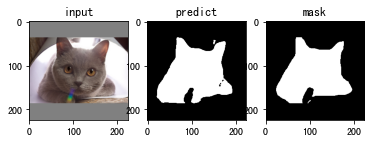

Epoch 1/1:  25%|██▌       | 371/1470 [12:51<37:54,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/British_Shorthair_70.png'] : tensor(0.9681)
/openbayes/input/input3/test_image/British_Shorthair_70.png
hd: 8.0
jc: 0.9381352833638026
sc: 0.9484696140765932
sp: 0.9959345156889495


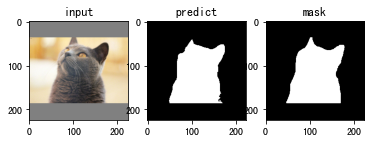

Epoch 1/1:  25%|██▌       | 372/1470 [12:53<37:33,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/British_Shorthair_75.png'] : tensor(0.9600)
/openbayes/input/input3/test_image/British_Shorthair_75.png
hd: 11.313708498984761
jc: 0.9231210968343981
sc: 0.9321542476080024
sp: 0.9962891698735569


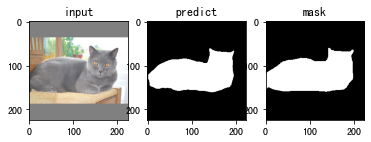

Epoch 1/1:  25%|██▌       | 373/1470 [12:55<37:48,  2.07s/it, f_score=0.938]

['/openbayes/input/input3/test_image/British_Shorthair_82.png'] : tensor(0.9700)
/openbayes/input/input3/test_image/British_Shorthair_82.png
hd: 11.0
jc: 0.9416799817393289
sc: 0.9513432491640724
sp: 0.9945781297593664


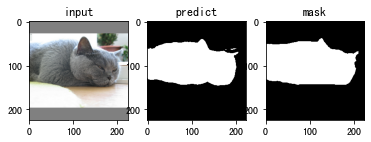

Epoch 1/1:  25%|██▌       | 374/1470 [12:57<36:39,  2.01s/it, f_score=0.938]

['/openbayes/input/input3/test_image/British_Shorthair_85.png'] : tensor(0.9536)
/openbayes/input/input3/test_image/British_Shorthair_85.png
hd: 22.825424421026653
jc: 0.9113790317568827
sc: 0.9301661803881771
sp: 0.9905550712002325


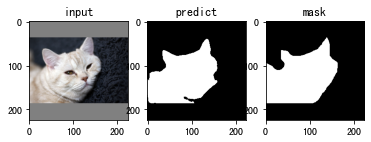

Epoch 1/1:  26%|██▌       | 375/1470 [12:59<35:59,  1.97s/it, f_score=0.938]

['/openbayes/input/input3/test_image/British_Shorthair_92.png'] : tensor(0.9801)
/openbayes/input/input3/test_image/British_Shorthair_92.png
hd: 13.0
jc: 0.960912262566223
sc: 0.979969690979772
sp: 0.9913997542786936


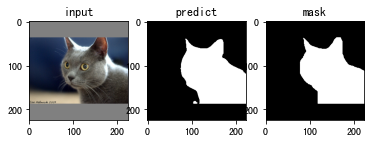

Epoch 1/1:  26%|██▌       | 376/1470 [13:01<36:16,  1.99s/it, f_score=0.938]

['/openbayes/input/input3/test_image/British_Shorthair_94.png'] : tensor(0.9862)
/openbayes/input/input3/test_image/British_Shorthair_94.png
hd: 4.47213595499958
jc: 0.972683014785431
sc: 0.9822916192470524
sp: 0.9923074196178524


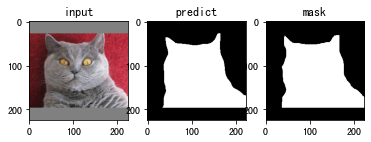

Epoch 1/1:  26%|██▌       | 377/1470 [13:03<36:59,  2.03s/it, f_score=0.938]

['/openbayes/input/input3/test_image/British_Shorthair_96.png'] : tensor(0.5059)
/openbayes/input/input3/test_image/British_Shorthair_96.png
hd: 94.76286192385707
jc: 0.3385811276197973
sc: 0.9396504642271982
sp: 0.8602356279829728


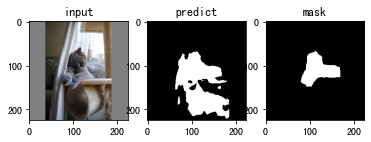

Epoch 1/1:  26%|██▌       | 378/1470 [13:05<36:45,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/British_Shorthair_99.png'] : tensor(0.9280)
/openbayes/input/input3/test_image/British_Shorthair_99.png
hd: 15.132745950421556
jc: 0.8655917865664088
sc: 0.9517449717783608
sp: 0.9666994707024497


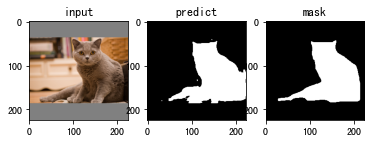

Epoch 1/1:  26%|██▌       | 379/1470 [13:07<36:12,  1.99s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_104.png'] : tensor(0.9556)
/openbayes/input/input3/test_image/chihuahua_104.png
hd: 13.0
jc: 0.9149180993637471
sc: 0.9684746005588594
sp: 0.9774427786520887


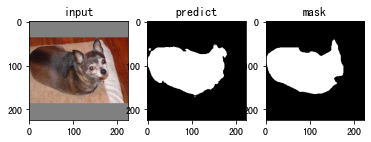

Epoch 1/1:  26%|██▌       | 380/1470 [13:10<39:17,  2.16s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_105.png'] : tensor(0.8246)
/openbayes/input/input3/test_image/chihuahua_105.png
hd: 49.33558553417604
jc: 0.701617735170761
sc: 0.7872268907563025
sp: 0.9736006399844852


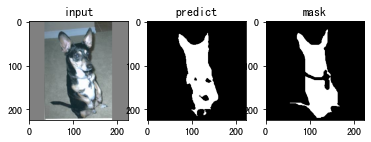

Epoch 1/1:  26%|██▌       | 381/1470 [13:12<39:03,  2.15s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_108.png'] : tensor(0.9456)
/openbayes/input/input3/test_image/chihuahua_108.png
hd: 13.0
jc: 0.8968751518685911
sc: 0.9235350047540409
sp: 0.9803265657602755


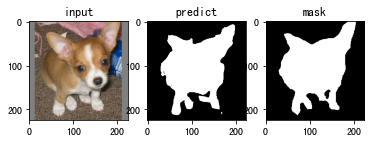

Epoch 1/1:  26%|██▌       | 382/1470 [13:14<38:34,  2.13s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_113.png'] : tensor(0.7118)
/openbayes/input/input3/test_image/chihuahua_113.png
hd: 16.0312195418814
jc: 0.5525525525525525
sc: 0.872813519122443
sp: 0.958229173343589


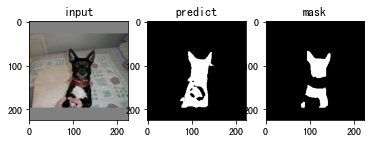

Epoch 1/1:  26%|██▌       | 383/1470 [13:16<37:45,  2.08s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_119.png'] : tensor(0.9196)
/openbayes/input/input3/test_image/chihuahua_119.png
hd: 16.97056274847714
jc: 0.8510958904109589
sc: 0.8946004319654428
sp: 0.9917883000624552


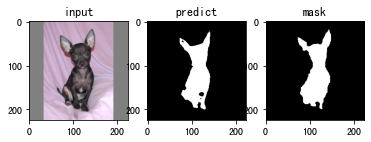

Epoch 1/1:  26%|██▌       | 384/1470 [13:18<38:30,  2.13s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_121.png'] : tensor(0.9438)
/openbayes/input/input3/test_image/chihuahua_121.png
hd: 16.0
jc: 0.8935273841440061
sc: 0.927634194831014
sp: 0.9872343820643068


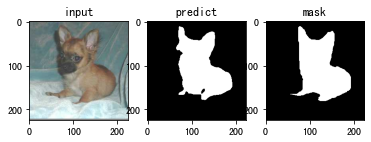

Epoch 1/1:  26%|██▌       | 385/1470 [13:20<40:42,  2.25s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_122.png'] : tensor(0.8752)
/openbayes/input/input3/test_image/chihuahua_122.png
hd: 14.7648230602334
jc: 0.7781019869390023
sc: 0.9384950561421149
sp: 0.9721776108937095


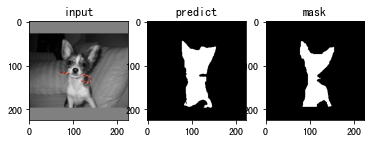

Epoch 1/1:  26%|██▋       | 386/1470 [13:23<39:44,  2.20s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_124.png'] : tensor(0.9110)
/openbayes/input/input3/test_image/chihuahua_124.png
hd: 13.038404810405298
jc: 0.8365901319003419
sc: 0.9672408924032759
sp: 0.988141953468425


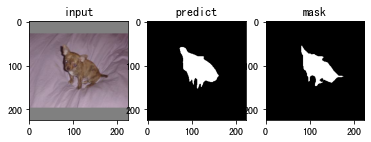

Epoch 1/1:  26%|██▋       | 387/1470 [13:24<38:23,  2.13s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_144.png'] : tensor(0.8159)
/openbayes/input/input3/test_image/chihuahua_144.png
hd: 52.46903848937962
jc: 0.6890128755364807
sc: 0.8460160202360877
sp: 0.9468639402280771


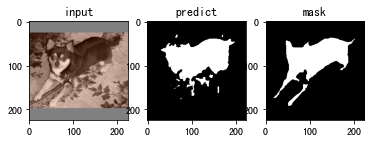

Epoch 1/1:  26%|██▋       | 388/1470 [13:27<38:09,  2.12s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_152.png'] : tensor(0.8878)
/openbayes/input/input3/test_image/chihuahua_152.png
hd: 62.07253821135398
jc: 0.7982226273214083
sc: 0.8915754644947824
sp: 0.9782834727539108


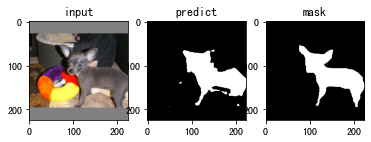

Epoch 1/1:  26%|██▋       | 389/1470 [13:29<37:26,  2.08s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_154.png'] : tensor(0.9106)
/openbayes/input/input3/test_image/chihuahua_154.png
hd: 12.206555615733702
jc: 0.8358554663372452
sc: 0.8797334633512108
sp: 0.9926629261976694


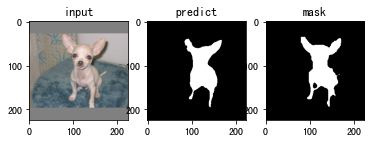

Epoch 1/1:  27%|██▋       | 390/1470 [13:31<37:16,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_156.png'] : tensor(0.6657)
/openbayes/input/input3/test_image/chihuahua_156.png
hd: 83.60023923410746
jc: 0.4989197530864197
sc: 0.9461515949663447
sp: 0.8586590374232845


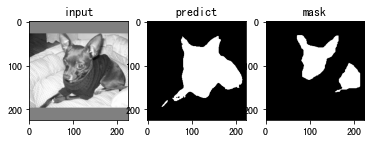

Epoch 1/1:  27%|██▋       | 391/1470 [13:33<37:04,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/chihuahua_164.png'] : tensor(0.5793)
/openbayes/input/input3/test_image/chihuahua_164.png
hd: 55.226805085936306
jc: 0.4077117572692794
sc: 0.9170616113744076
sp: 0.945158740065743


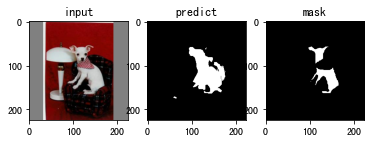

Epoch 1/1:  27%|██▋       | 392/1470 [13:35<36:24,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_169.png'] : tensor(0.8804)
/openbayes/input/input3/test_image/chihuahua_169.png
hd: 19.0
jc: 0.7863409366986098
sc: 0.8743809095002252
sp: 0.9828556982970607


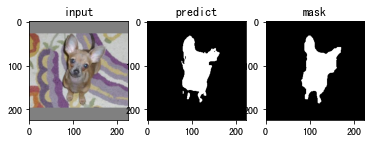

Epoch 1/1:  27%|██▋       | 393/1470 [13:37<36:24,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_17.png'] : tensor(0.8885)
/openbayes/input/input3/test_image/chihuahua_17.png
hd: 8.602325267042627
jc: 0.7994366197183098
sc: 0.8890977443609023
sp: 0.996315356113627


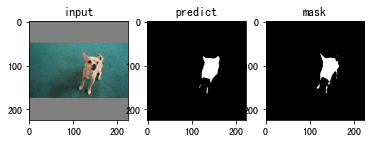

Epoch 1/1:  27%|██▋       | 394/1470 [13:39<36:16,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_172.png'] : tensor(0.7491)
/openbayes/input/input3/test_image/chihuahua_172.png
hd: 45.221676218380054
jc: 0.5988474066649963
sc: 0.9435452033162258
sp: 0.969397393111265


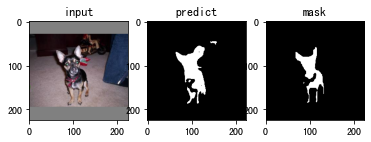

Epoch 1/1:  27%|██▋       | 395/1470 [13:41<37:35,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_173.png'] : tensor(0.9155)
/openbayes/input/input3/test_image/chihuahua_173.png
hd: 26.248809496813376
jc: 0.844202025072324
sc: 0.9247375717963954
sp: 0.9587484655571098


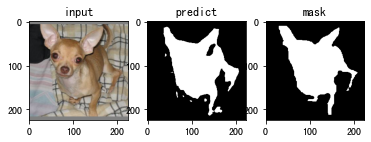

Epoch 1/1:  27%|██▋       | 396/1470 [13:43<36:50,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_176.png'] : tensor(0.9146)
/openbayes/input/input3/test_image/chihuahua_176.png
hd: 25.495097567963924
jc: 0.8426474876081251
sc: 0.9077583499110041
sp: 0.9818338461538462


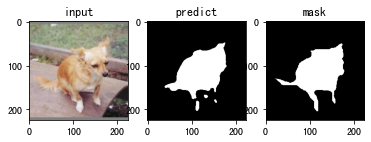

Epoch 1/1:  27%|██▋       | 397/1470 [13:45<37:06,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_178.png'] : tensor(0.8746)
/openbayes/input/input3/test_image/chihuahua_178.png
hd: 9.848857801796104
jc: 0.7771770062606717
sc: 0.8612425102491328
sp: 0.9927029039463887


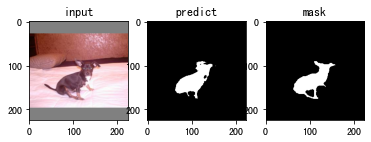

Epoch 1/1:  27%|██▋       | 398/1470 [13:47<37:00,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_18.png'] : tensor(0.9382)
/openbayes/input/input3/test_image/chihuahua_18.png
hd: 47.0
jc: 0.8835601524224279
sc: 0.9348577352839534
sp: 0.9692814042786615


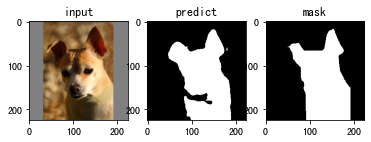

Epoch 1/1:  27%|██▋       | 399/1470 [13:49<36:15,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_189.png'] : tensor(0.8758)
/openbayes/input/input3/test_image/chihuahua_189.png
hd: 10.63014581273465
jc: 0.7790679908326967
sc: 0.8985022026431718
sp: 0.980449877530842


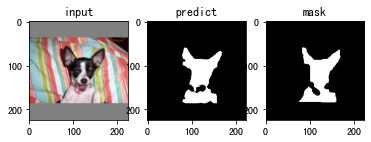

Epoch 1/1:  27%|██▋       | 400/1470 [13:51<37:21,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_192.png'] : tensor(0.8938)
/openbayes/input/input3/test_image/chihuahua_192.png
hd: 40.049968789001575
jc: 0.8080554439533949
sc: 0.8712367338098332
sp: 0.982365297249768


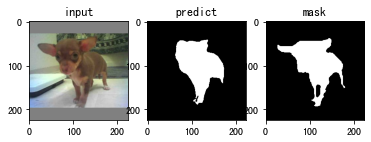

Epoch 1/1:  27%|██▋       | 401/1470 [13:53<37:43,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_196.png'] : tensor(0.9116)
/openbayes/input/input3/test_image/chihuahua_196.png
hd: 25.80697580112788
jc: 0.8374794308392217
sc: 0.971152766864968
sp: 0.9655414738168513


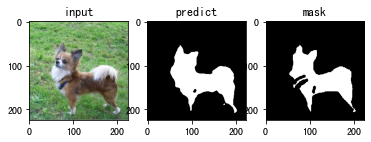

Epoch 1/1:  27%|██▋       | 402/1470 [13:56<38:05,  2.14s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_29.png'] : tensor(0.9182)
/openbayes/input/input3/test_image/chihuahua_29.png
hd: 21.18962010041709
jc: 0.8488178488178488
sc: 0.8613426447398063
sp: 0.9919185687847007


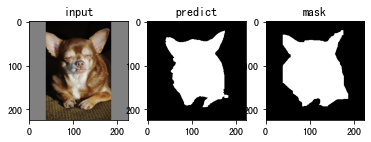

Epoch 1/1:  27%|██▋       | 403/1470 [13:58<37:45,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_38.png'] : tensor(0.9680)
/openbayes/input/input3/test_image/chihuahua_38.png
hd: 11.0
jc: 0.9380039656311963
sc: 0.9569360783961162
sp: 0.9839240959541712


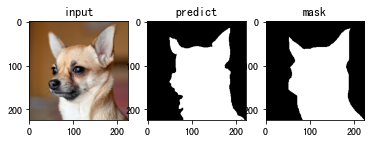

Epoch 1/1:  27%|██▋       | 404/1470 [14:00<37:40,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_55.png'] : tensor(0.8816)
/openbayes/input/input3/test_image/chihuahua_55.png
hd: 15.132745950421556
jc: 0.7883409945674885
sc: 0.8783610755441741
sp: 0.976409763135746


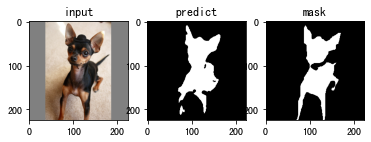

Epoch 1/1:  28%|██▊       | 405/1470 [14:02<37:35,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_56.png'] : tensor(0.7456)
/openbayes/input/input3/test_image/chihuahua_56.png
hd: 21.095023109728988
jc: 0.5943632567849687
sc: 0.9231517509727627
sp: 0.9637730400067952


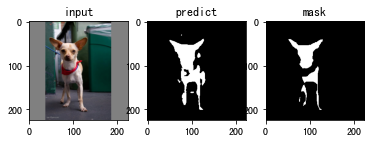

Epoch 1/1:  28%|██▊       | 406/1470 [14:04<37:44,  2.13s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_57.png'] : tensor(0.8702)
/openbayes/input/input3/test_image/chihuahua_57.png
hd: 23.021728866442675
jc: 0.7702451708766717
sc: 0.8064171122994652
sp: 0.9878920057155749


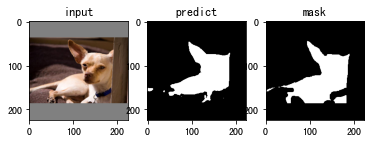

Epoch 1/1:  28%|██▊       | 407/1470 [14:06<35:59,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_58.png'] : tensor(0.8380)
/openbayes/input/input3/test_image/chihuahua_58.png
hd: 12.041594578792296
jc: 0.7211308097747964
sc: 0.872969837587007
sp: 0.9925080492033352


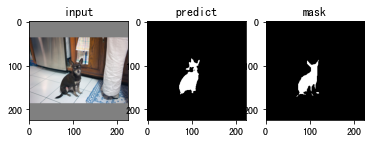

Epoch 1/1:  28%|██▊       | 408/1470 [14:08<37:10,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_59.png'] : tensor(0.8162)
/openbayes/input/input3/test_image/chihuahua_59.png
hd: 97.65244492586962
jc: 0.6895299576356667
sc: 0.8125198098256735
sp: 0.9400628394930237


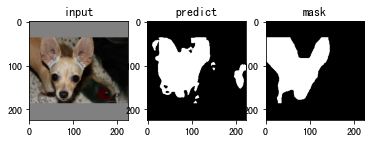

Epoch 1/1:  28%|██▊       | 409/1470 [14:10<37:58,  2.15s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_6.png'] : tensor(0.8076)
/openbayes/input/input3/test_image/chihuahua_6.png
hd: 122.00409829181969
jc: 0.6773399014778325
sc: 0.874602453430259
sp: 0.9866388744137572


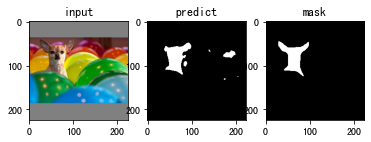

Epoch 1/1:  28%|██▊       | 410/1470 [14:13<37:46,  2.14s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_62.png'] : tensor(0.9001)
/openbayes/input/input3/test_image/chihuahua_62.png
hd: 14.0
jc: 0.8184045159228884
sc: 0.9309425732977951
sp: 0.9729259100233767


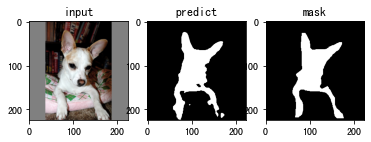

Epoch 1/1:  28%|██▊       | 411/1470 [14:15<38:47,  2.20s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_65.png'] : tensor(0.9320)
/openbayes/input/input3/test_image/chihuahua_65.png
hd: 14.866068747318506
jc: 0.8726691529035695
sc: 0.9656595431098011
sp: 0.9833375584798691


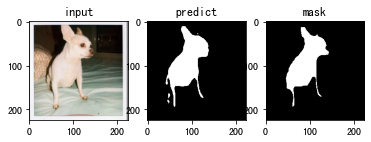

Epoch 1/1:  28%|██▊       | 412/1470 [14:17<37:37,  2.13s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_69.png'] : tensor(0.9363)
/openbayes/input/input3/test_image/chihuahua_69.png
hd: 16.0
jc: 0.8803126247931998
sc: 0.9352121212121212
sp: 0.9694441145029101


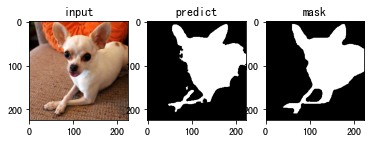

Epoch 1/1:  28%|██▊       | 413/1470 [14:19<37:42,  2.14s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_7.png'] : tensor(0.8830)
/openbayes/input/input3/test_image/chihuahua_7.png
hd: 7.615773105863909
jc: 0.7905320485965647
sc: 0.9059049447911666
sp: 0.9936789137712349


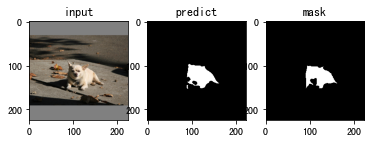

Epoch 1/1:  28%|██▊       | 414/1470 [14:21<37:04,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_72.png'] : tensor(0.7691)
/openbayes/input/input3/test_image/chihuahua_72.png
hd: 113.11056537742175
jc: 0.6248495922278177
sc: 0.9294047461222326
sp: 0.7904531205471644


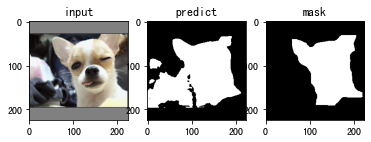

Epoch 1/1:  28%|██▊       | 415/1470 [14:23<36:09,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_82.png'] : tensor(0.7696)
/openbayes/input/input3/test_image/chihuahua_82.png
hd: 36.235341863986875
jc: 0.6255132767588284
sc: 0.9013806706114399
sp: 0.9765328183707311


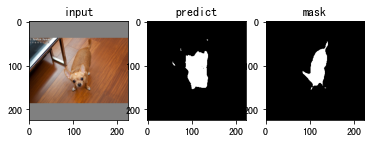

Epoch 1/1:  28%|██▊       | 416/1470 [14:25<36:19,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_84.png'] : tensor(0.8380)
/openbayes/input/input3/test_image/chihuahua_84.png
hd: 20.615528128088304
jc: 0.7211995249406176
sc: 0.8607370659107016
sp: 0.9884698230350129


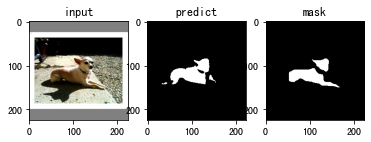

Epoch 1/1:  28%|██▊       | 417/1470 [14:27<37:15,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_88.png'] : tensor(0.9500)
/openbayes/input/input3/test_image/chihuahua_88.png
hd: 5.385164807134504
jc: 0.9046741134367206
sc: 0.947201090042012
sp: 0.9899925064661945


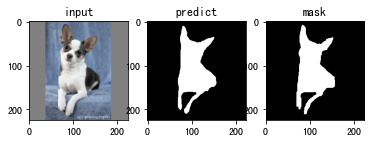

Epoch 1/1:  28%|██▊       | 418/1470 [14:29<37:13,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_90.png'] : tensor(0.8991)
/openbayes/input/input3/test_image/chihuahua_90.png
hd: 3.605551275463989
jc: 0.8167330677290837
sc: 0.8773181169757489
sp: 0.9989489641232946


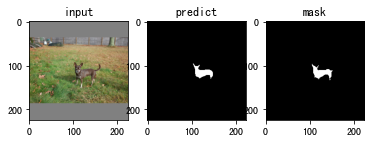

Epoch 1/1:  29%|██▊       | 419/1470 [14:31<36:39,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_95.png'] : tensor(0.8547)
/openbayes/input/input3/test_image/chihuahua_95.png
hd: 23.021728866442675
jc: 0.7462482946793997
sc: 0.9492407809110629
sp: 0.9724794803142695


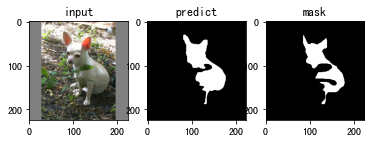

Epoch 1/1:  29%|██▊       | 420/1470 [14:34<36:29,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/chihuahua_97.png'] : tensor(0.8906)
/openbayes/input/input3/test_image/chihuahua_97.png
hd: 20.0
jc: 0.8028001464128843
sc: 0.9863953226894535
sp: 0.9507291313405358


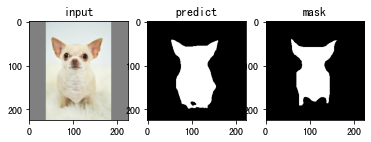

Epoch 1/1:  29%|██▊       | 421/1470 [14:36<36:17,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_112.png'] : tensor(0.9171)
/openbayes/input/input3/test_image/Egyptian_Mau_112.png
hd: 27.65863337187866
jc: 0.8468890554722639
sc: 0.9188694591297275
sp: 0.9792761527020327


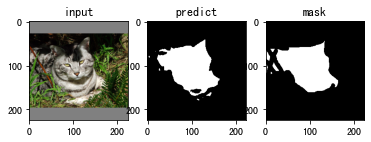

Epoch 1/1:  29%|██▊       | 422/1470 [14:37<35:09,  2.01s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_114.png'] : tensor(0.9291)
/openbayes/input/input3/test_image/Egyptian_Mau_114.png
hd: 11.180339887498949
jc: 0.8675614681078513
sc: 0.9755576332309336
sp: 0.9781676778561221


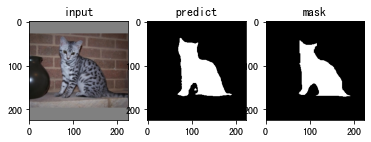

Epoch 1/1:  29%|██▉       | 423/1470 [14:40<35:39,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_116.png'] : tensor(0.9179)
/openbayes/input/input3/test_image/Egyptian_Mau_116.png
hd: 16.0
jc: 0.8481751824817518
sc: 0.949910820451843
sp: 0.9814260725464924


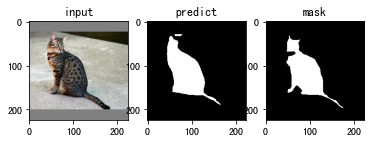

Epoch 1/1:  29%|██▉       | 424/1470 [14:42<35:47,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_118.png'] : tensor(0.9517)
/openbayes/input/input3/test_image/Egyptian_Mau_118.png
hd: 16.0
jc: 0.9078499709567671
sc: 0.9914363389216131
sp: 0.9277022699779407


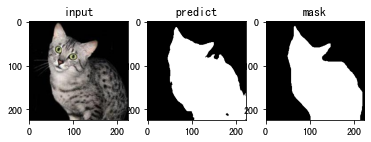

Epoch 1/1:  29%|██▉       | 425/1470 [14:44<35:44,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_121.png'] : tensor(0.8769)
/openbayes/input/input3/test_image/Egyptian_Mau_121.png
hd: 18.027756377319946
jc: 0.7808629372533007
sc: 0.9269671998707384
sp: 0.9736740400572896


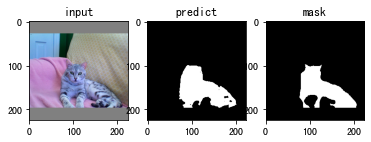

Epoch 1/1:  29%|██▉       | 426/1470 [14:46<35:10,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_122.png'] : tensor(0.9190)
/openbayes/input/input3/test_image/Egyptian_Mau_122.png
hd: 15.0
jc: 0.850133294905973
sc: 0.9931818181818182
sp: 0.9478013369542511


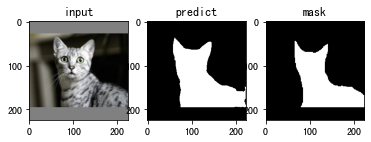

Epoch 1/1:  29%|██▉       | 427/1470 [14:48<34:47,  2.00s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_13.png'] : tensor(0.7938)
/openbayes/input/input3/test_image/Egyptian_Mau_13.png
hd: 37.64306044943742
jc: 0.6581227436823105
sc: 0.9807402625349688
sp: 0.8885573112861406


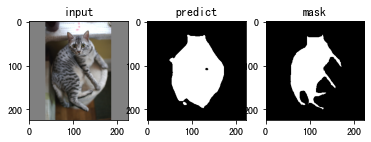

Epoch 1/1:  29%|██▉       | 428/1470 [14:50<36:06,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_136.png'] : tensor(0.9492)
/openbayes/input/input3/test_image/Egyptian_Mau_136.png
hd: 14.0
jc: 0.9033787433235312
sc: 0.9756303065655584
sp: 0.9644861426885775


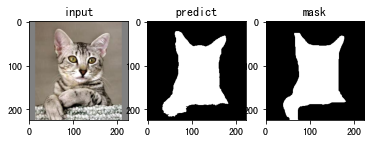

Epoch 1/1:  29%|██▉       | 429/1470 [14:52<35:27,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_147.png'] : tensor(0.9120)
/openbayes/input/input3/test_image/Egyptian_Mau_147.png
hd: 15.297058540778355
jc: 0.8382250781521362
sc: 0.9263026580942328
sp: 0.9724562948056849


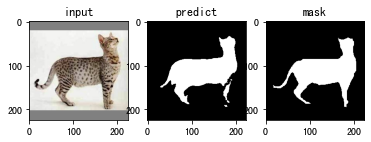

Epoch 1/1:  29%|██▉       | 430/1470 [14:54<36:08,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_148.png'] : tensor(0.9502)
/openbayes/input/input3/test_image/Egyptian_Mau_148.png
hd: 10.63014581273465
jc: 0.9052026013006503
sc: 0.9611366855524079
sp: 0.9820473251028806


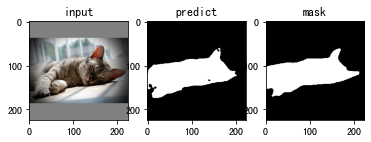

Epoch 1/1:  29%|██▉       | 431/1470 [14:56<36:14,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_153.png'] : tensor(0.9152)
/openbayes/input/input3/test_image/Egyptian_Mau_153.png
hd: 22.80350850198276
jc: 0.8436738879630816
sc: 0.9026882457824715
sp: 0.9713434848569984


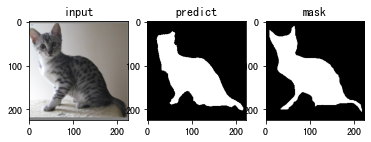

Epoch 1/1:  29%|██▉       | 432/1470 [14:58<36:14,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_155.png'] : tensor(0.9698)
/openbayes/input/input3/test_image/Egyptian_Mau_155.png
hd: 12.649110640673518
jc: 0.9414130995358432
sc: 0.9602314571278274
sp: 0.9953283666494553


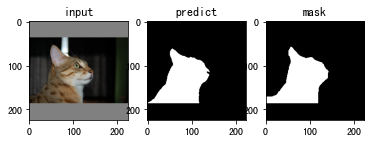

Epoch 1/1:  29%|██▉       | 433/1470 [15:00<36:24,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_168.png'] : tensor(0.8733)
/openbayes/input/input3/test_image/Egyptian_Mau_168.png
hd: 39.05124837953327
jc: 0.7751518498067366
sc: 0.8096666282154804
sp: 0.9907003637940588


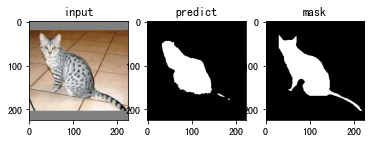

Epoch 1/1:  30%|██▉       | 434/1470 [15:02<36:09,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_172.png'] : tensor(0.8985)
/openbayes/input/input3/test_image/Egyptian_Mau_172.png
hd: 19.313207915827967
jc: 0.8156934306569343
sc: 0.9037149355572404
sp: 0.9665578906148022


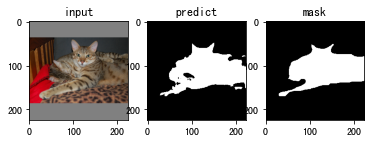

Epoch 1/1:  30%|██▉       | 435/1470 [15:04<36:09,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_176.png'] : tensor(0.8183)
/openbayes/input/input3/test_image/Egyptian_Mau_176.png
hd: 56.302753041036986
jc: 0.6924559825215268
sc: 0.7638219449957471
sp: 0.9831408561755021


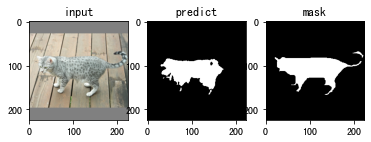

Epoch 1/1:  30%|██▉       | 436/1470 [15:07<37:03,  2.15s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_183.png'] : tensor(0.9123)
/openbayes/input/input3/test_image/Egyptian_Mau_183.png
hd: 25.079872407968907
jc: 0.8387956301625367
sc: 0.9268364492860297
sp: 0.9610276031702651


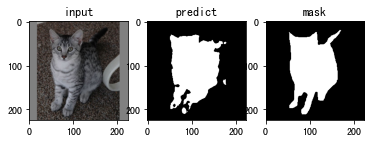

Epoch 1/1:  30%|██▉       | 437/1470 [15:09<35:57,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_186.png'] : tensor(0.9284)
/openbayes/input/input3/test_image/Egyptian_Mau_186.png
hd: 6.324555320336759
jc: 0.866436537440255
sc: 0.985056603773585
sp: 0.9791738421620628


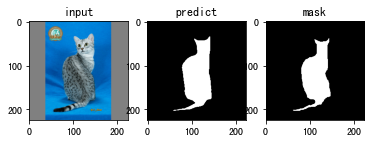

Epoch 1/1:  30%|██▉       | 438/1470 [15:11<36:27,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_187.png'] : tensor(0.9373)
/openbayes/input/input3/test_image/Egyptian_Mau_187.png
hd: 17.029386365926403
jc: 0.8819792711467737
sc: 0.9264809178178413
sp: 0.9896478839410098


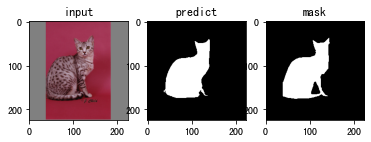

Epoch 1/1:  30%|██▉       | 439/1470 [15:13<35:24,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_194.png'] : tensor(0.6522)
/openbayes/input/input3/test_image/Egyptian_Mau_194.png
hd: 37.12142238654117
jc: 0.48394408764639213
sc: 0.5916859122401847
sp: 0.9789730838022946


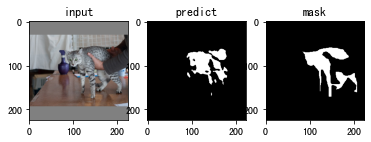

Epoch 1/1:  30%|██▉       | 440/1470 [15:15<35:25,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_198.png'] : tensor(0.8912)
/openbayes/input/input3/test_image/Egyptian_Mau_198.png
hd: 14.035668847618199
jc: 0.8038179648883587
sc: 0.8984568489236044
sp: 0.9862443519487168


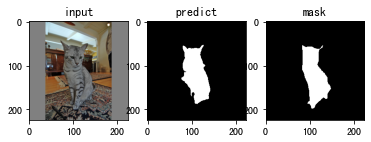

Epoch 1/1:  30%|███       | 441/1470 [15:17<34:45,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_210.png'] : tensor(0.9189)
/openbayes/input/input3/test_image/Egyptian_Mau_210.png
hd: 13.601470508735444
jc: 0.8499412581437573
sc: 0.9009396581003056
sp: 0.987180417483008


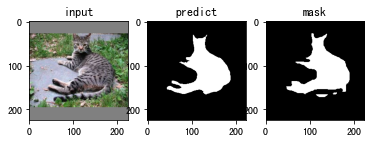

Epoch 1/1:  30%|███       | 442/1470 [15:19<34:57,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_213.png'] : tensor(0.9450)
/openbayes/input/input3/test_image/Egyptian_Mau_213.png
hd: 14.0
jc: 0.8956612242242893
sc: 0.9110699397869384
sp: 0.9925847759746742


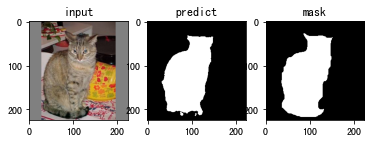

Epoch 1/1:  30%|███       | 443/1470 [15:21<35:30,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_23.png'] : tensor(0.9490)
/openbayes/input/input3/test_image/Egyptian_Mau_23.png
hd: 7.615773105863909
jc: 0.902943189596167
sc: 0.9724310776942355
sp: 0.9879704099739589


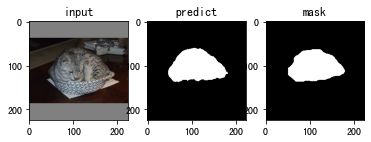

Epoch 1/1:  30%|███       | 444/1470 [15:23<35:56,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_26.png'] : tensor(0.9003)
/openbayes/input/input3/test_image/Egyptian_Mau_26.png
hd: 79.02531240052139
jc: 0.8186813186813187
sc: 0.9009302325581395
sp: 0.9792187800654224


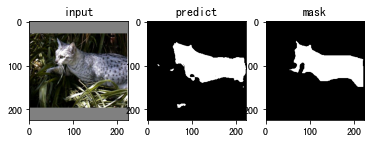

Epoch 1/1:  30%|███       | 445/1470 [15:25<35:41,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_31.png'] : tensor(0.9088)
/openbayes/input/input3/test_image/Egyptian_Mau_31.png
hd: 28.284271247461902
jc: 0.8328634716069271
sc: 0.8741968211024688
sp: 0.9846928131845207


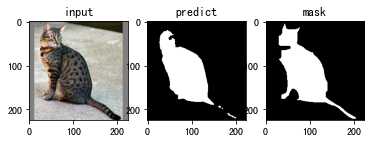

Epoch 1/1:  30%|███       | 446/1470 [15:27<35:44,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_4.png'] : tensor(0.9368)
/openbayes/input/input3/test_image/Egyptian_Mau_4.png
hd: 26.40075756488817
jc: 0.8811860940695296
sc: 0.9622599374720857
sp: 0.9800097040271712


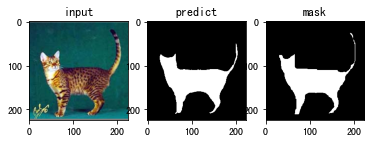

Epoch 1/1:  30%|███       | 447/1470 [15:30<36:00,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_43.png'] : tensor(0.8700)
/openbayes/input/input3/test_image/Egyptian_Mau_43.png
hd: 36.68787265568828
jc: 0.7699499807618315
sc: 0.7885176136811411
sp: 0.9753205903701911


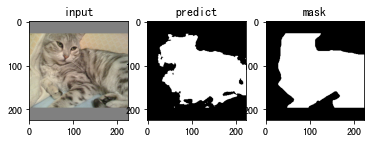

Epoch 1/1:  30%|███       | 448/1470 [15:32<35:53,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_44.png'] : tensor(0.8603)
/openbayes/input/input3/test_image/Egyptian_Mau_44.png
hd: 53.23532661682466
jc: 0.754880694143167
sc: 0.8437293365660128
sp: 0.9882994807072898


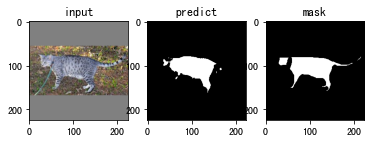

Epoch 1/1:  31%|███       | 449/1470 [15:34<35:29,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_47.png'] : tensor(0.8464)
/openbayes/input/input3/test_image/Egyptian_Mau_47.png
hd: 26.019223662515376
jc: 0.7336362106680128
sc: 0.8548460884909483
sp: 0.9275125448028674


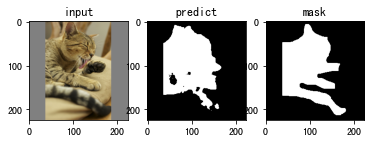

Epoch 1/1:  31%|███       | 450/1470 [15:36<36:35,  2.15s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_54.png'] : tensor(0.9252)
/openbayes/input/input3/test_image/Egyptian_Mau_54.png
hd: 7.810249675906654
jc: 0.8607838422697763
sc: 0.9490986214209968
sp: 0.9916602017067494


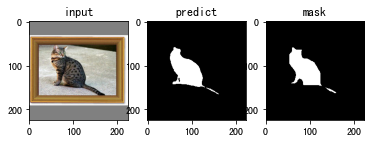

Epoch 1/1:  31%|███       | 451/1470 [15:38<37:12,  2.19s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_70.png'] : tensor(0.9640)
/openbayes/input/input3/test_image/Egyptian_Mau_70.png
hd: 15.652475842498529
jc: 0.9304914744232698
sc: 0.9543256866577513
sp: 0.9938450129773823


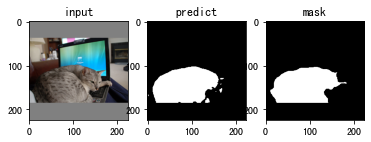

Epoch 1/1:  31%|███       | 452/1470 [15:40<36:17,  2.14s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_79.png'] : tensor(0.8401)
/openbayes/input/input3/test_image/Egyptian_Mau_79.png
hd: 19.1049731745428
jc: 0.7242976227230626
sc: 0.8417653390742734
sp: 0.9904619215429741


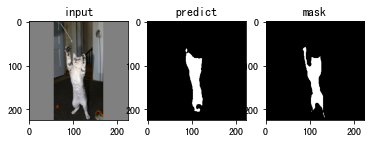

Epoch 1/1:  31%|███       | 453/1470 [15:42<36:28,  2.15s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_80.png'] : tensor(0.9695)
/openbayes/input/input3/test_image/Egyptian_Mau_80.png
hd: 42.04759208325728
jc: 0.9407727578049706
sc: 0.9652702864676975
sp: 0.948286122351821


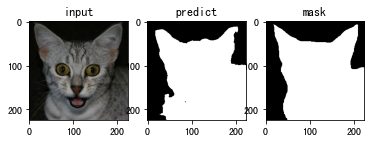

Epoch 1/1:  31%|███       | 454/1470 [15:44<35:35,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_82.png'] : tensor(0.9233)
/openbayes/input/input3/test_image/Egyptian_Mau_82.png
hd: 15.0
jc: 0.8574712643678161
sc: 0.879976408139192
sp: 0.9958980504217173


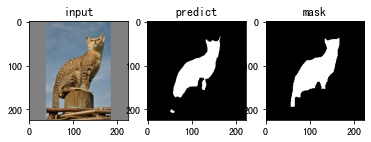

Epoch 1/1:  31%|███       | 455/1470 [15:47<35:16,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_83.png'] : tensor(0.8499)
/openbayes/input/input3/test_image/Egyptian_Mau_83.png
hd: 48.877397639399746
jc: 0.7389524382901866
sc: 0.7562072577167149
sp: 0.9888348799528649


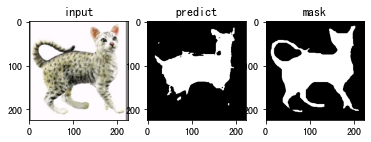

Epoch 1/1:  31%|███       | 456/1470 [15:48<34:10,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_84.png'] : tensor(0.9040)
/openbayes/input/input3/test_image/Egyptian_Mau_84.png
hd: 16.0
jc: 0.8248746238716148
sc: 0.9205283187821804
sp: 0.9748799767227584


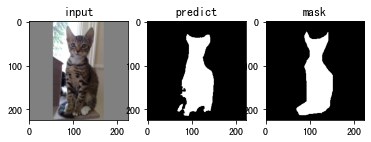

Epoch 1/1:  31%|███       | 457/1470 [15:50<33:40,  2.00s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Egyptian_Mau_93.png'] : tensor(0.9248)
/openbayes/input/input3/test_image/Egyptian_Mau_93.png
hd: 34.058772731852805
jc: 0.860078705728028
sc: 0.9609184171958964
sp: 0.9771363246641898


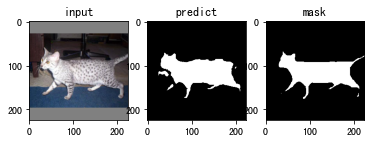

Epoch 1/1:  31%|███       | 458/1470 [15:52<34:10,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_106.png'] : tensor(0.7394)
/openbayes/input/input3/test_image/english_cocker_spaniel_106.png
hd: 65.14598989960932
jc: 0.5865019011406845
sc: 0.9628923183631004
sp: 0.9166610371771488


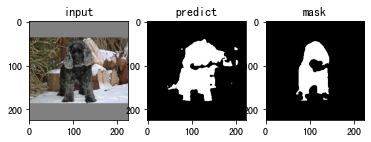

Epoch 1/1:  31%|███       | 459/1470 [15:54<34:28,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_119.png'] : tensor(0.9717)
/openbayes/input/input3/test_image/english_cocker_spaniel_119.png
hd: 9.055385138137417
jc: 0.9449070111275387
sc: 0.984594178221033
sp: 0.986311867452369


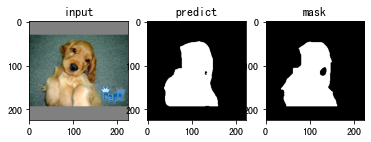

Epoch 1/1:  31%|███▏      | 460/1470 [15:57<34:38,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_12.png'] : tensor(0.9287)
/openbayes/input/input3/test_image/english_cocker_spaniel_12.png
hd: 14.035668847618199
jc: 0.8669553919445647
sc: 0.9514258555133079
sp: 0.9741527133346782


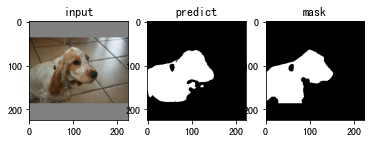

Epoch 1/1:  31%|███▏      | 461/1470 [15:59<35:05,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_124.png'] : tensor(0.9109)
/openbayes/input/input3/test_image/english_cocker_spaniel_124.png
hd: 21.213203435596427
jc: 0.8363706119317091
sc: 0.9149092435211416
sp: 0.9779800713494895


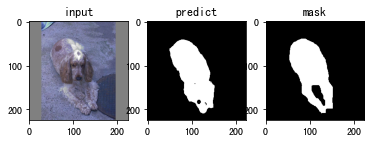

Epoch 1/1:  31%|███▏      | 462/1470 [16:01<34:53,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_127.png'] : tensor(0.8745)
/openbayes/input/input3/test_image/english_cocker_spaniel_127.png
hd: 57.271284253105414
jc: 0.7770475227502528
sc: 0.8988304093567251
sp: 0.9885362306441954


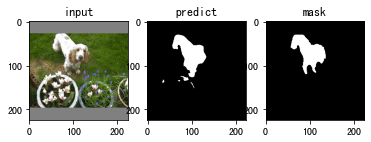

Epoch 1/1:  31%|███▏      | 463/1470 [16:03<34:59,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_134.png'] : tensor(0.9128)
/openbayes/input/input3/test_image/english_cocker_spaniel_134.png
hd: 23.259406699226016
jc: 0.8395198012970885
sc: 0.927439024390244
sp: 0.984248899486427


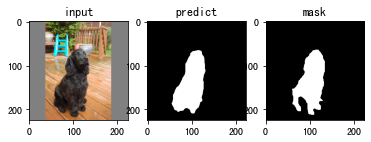

Epoch 1/1:  32%|███▏      | 464/1470 [16:05<35:35,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_139.png'] : tensor(0.9482)
/openbayes/input/input3/test_image/english_cocker_spaniel_139.png
hd: 4.47213595499958
jc: 0.9014463504877228
sc: 0.943994364212751
sp: 0.9939772574048272


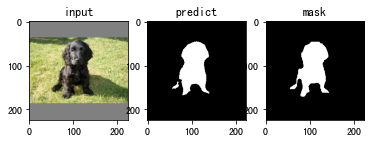

Epoch 1/1:  32%|███▏      | 465/1470 [16:07<35:29,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_141.png'] : tensor(0.9098)
/openbayes/input/input3/test_image/english_cocker_spaniel_141.png
hd: 18.439088914585774
jc: 0.8345406297066629
sc: 0.9529113094750634
sp: 0.9543790333201633


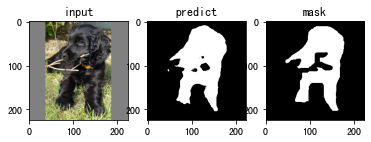

Epoch 1/1:  32%|███▏      | 466/1470 [16:10<37:24,  2.24s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_147.png'] : tensor(0.9543)
/openbayes/input/input3/test_image/english_cocker_spaniel_147.png
hd: 9.219544457292887
jc: 0.9126345917950116
sc: 0.9809551714034573
sp: 0.9882122260668973


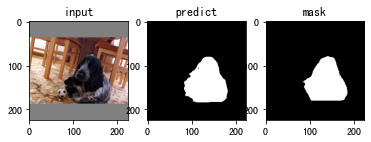

Epoch 1/1:  32%|███▏      | 467/1470 [16:12<38:40,  2.31s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_148.png'] : tensor(0.8332)
/openbayes/input/input3/test_image/english_cocker_spaniel_148.png
hd: 10.770329614269007
jc: 0.7141389934953783
sc: 0.884272997032641
sp: 0.9882468578120752


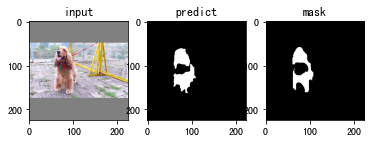

Epoch 1/1:  32%|███▏      | 468/1470 [16:14<37:06,  2.22s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_151.png'] : tensor(0.9023)
/openbayes/input/input3/test_image/english_cocker_spaniel_151.png
hd: 26.476404589747453
jc: 0.8219542242105946
sc: 0.9175593514765489
sp: 0.9558030803080309


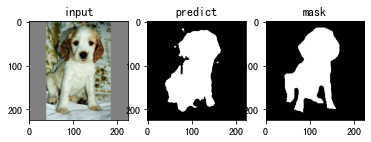

Epoch 1/1:  32%|███▏      | 469/1470 [16:16<35:42,  2.14s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_155.png'] : tensor(0.9142)
/openbayes/input/input3/test_image/english_cocker_spaniel_155.png
hd: 28.284271247461902
jc: 0.8419283960191288
sc: 0.9269958730610502
sp: 0.9835453892326589


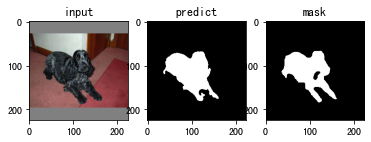

Epoch 1/1:  32%|███▏      | 470/1470 [16:18<35:10,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_156.png'] : tensor(0.9335)
/openbayes/input/input3/test_image/english_cocker_spaniel_156.png
hd: 9.433981132056603
jc: 0.8752871677059403
sc: 0.8869304955104755
sp: 0.9981884878402246


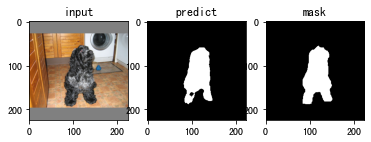

Epoch 1/1:  32%|███▏      | 471/1470 [16:20<35:13,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_182.png'] : tensor(0.8352)
/openbayes/input/input3/test_image/english_cocker_spaniel_182.png
hd: 35.6931365951495
jc: 0.7170966331438566
sc: 0.9295295673531079
sp: 0.9650647238375332


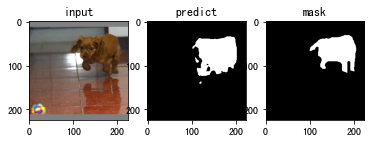

Epoch 1/1:  32%|███▏      | 472/1470 [16:23<35:43,  2.15s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_185.png'] : tensor(0.8447)
/openbayes/input/input3/test_image/english_cocker_spaniel_185.png
hd: 72.11102550927978
jc: 0.7311500380807312
sc: 0.9523809523809523
sp: 0.9937967783924504


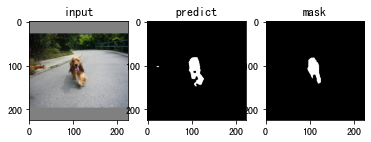

Epoch 1/1:  32%|███▏      | 473/1470 [16:25<35:01,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_199.png'] : tensor(0.9039)
/openbayes/input/input3/test_image/english_cocker_spaniel_199.png
hd: 28.231188426986208
jc: 0.8246019866648524
sc: 0.8923575320276838
sp: 0.9871384118935116


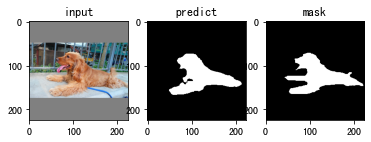

Epoch 1/1:  32%|███▏      | 474/1470 [16:27<34:24,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_200.png'] : tensor(0.8986)
/openbayes/input/input3/test_image/english_cocker_spaniel_200.png
hd: 31.11269837220809
jc: 0.8158336833263334
sc: 0.8469587965990844
sp: 0.9780067864773155


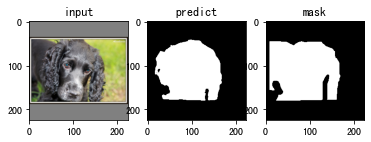

Epoch 1/1:  32%|███▏      | 475/1470 [16:29<34:29,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_21.png'] : tensor(0.9187)
/openbayes/input/input3/test_image/english_cocker_spaniel_21.png
hd: 14.0
jc: 0.8496440335777282
sc: 0.9488548712471817
sp: 0.9764305731873817


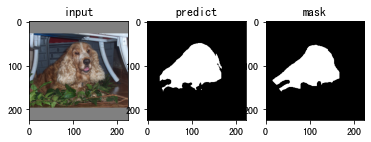

Epoch 1/1:  32%|███▏      | 476/1470 [16:31<34:26,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_25.png'] : tensor(0.8690)
/openbayes/input/input3/test_image/english_cocker_spaniel_25.png
hd: 29.68164415931166
jc: 0.7682756789057832
sc: 0.8714414821509263
sp: 0.9516775977017724


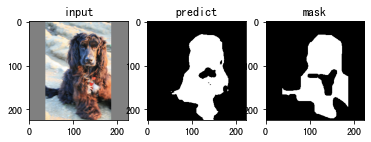

Epoch 1/1:  32%|███▏      | 477/1470 [16:33<34:31,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_27.png'] : tensor(0.9313)
/openbayes/input/input3/test_image/english_cocker_spaniel_27.png
hd: 26.019223662515376
jc: 0.8714667907409561
sc: 0.9477545857052498
sp: 0.9836294386222233


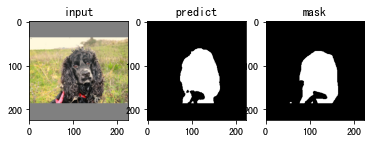

Epoch 1/1:  33%|███▎      | 478/1470 [16:35<35:03,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_3.png'] : tensor(0.9178)
/openbayes/input/input3/test_image/english_cocker_spaniel_3.png
hd: 27.784887978899608
jc: 0.8480382393945429
sc: 0.9709269182533349
sp: 0.9693032242482792


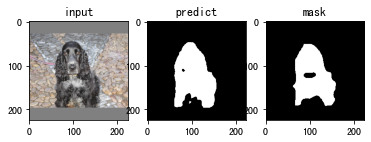

Epoch 1/1:  33%|███▎      | 479/1470 [16:37<34:51,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_30.png'] : tensor(0.9560)
/openbayes/input/input3/test_image/english_cocker_spaniel_30.png
hd: 15.033296378372908
jc: 0.9157691450642501
sc: 0.9542569659442725
sp: 0.9854251664161477


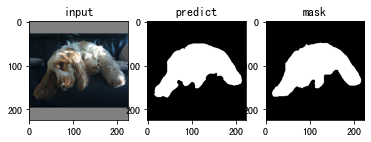

Epoch 1/1:  33%|███▎      | 480/1470 [16:39<34:42,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_33.png'] : tensor(0.9382)
/openbayes/input/input3/test_image/english_cocker_spaniel_33.png
hd: 31.575306807693888
jc: 0.8836481502179502
sc: 0.9088400965628233
sp: 0.9940207826024061


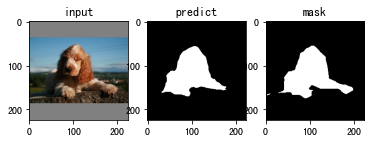

Epoch 1/1:  33%|███▎      | 481/1470 [16:41<34:33,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_38.png'] : tensor(0.9109)
/openbayes/input/input3/test_image/english_cocker_spaniel_38.png
hd: 16.492422502470642
jc: 0.8364496508222573
sc: 0.9192869522158951
sp: 0.9913301688449617


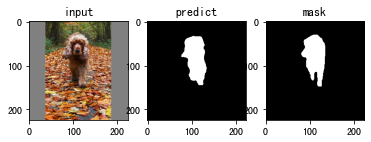

Epoch 1/1:  33%|███▎      | 482/1470 [16:43<34:22,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_39.png'] : tensor(0.9456)
/openbayes/input/input3/test_image/english_cocker_spaniel_39.png
hd: 14.866068747318506
jc: 0.8968719815736682
sc: 0.9875644277182362
sp: 0.9674334044739547


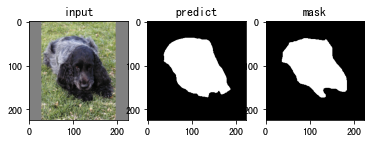

Epoch 1/1:  33%|███▎      | 483/1470 [16:46<34:37,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_41.png'] : tensor(0.8409)
/openbayes/input/input3/test_image/english_cocker_spaniel_41.png
hd: 23.0
jc: 0.72552783109405
sc: 0.849756463094792
sp: 0.9796155047058299


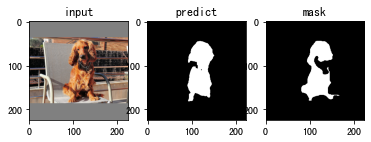

Epoch 1/1:  33%|███▎      | 484/1470 [16:47<33:48,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_43.png'] : tensor(0.9298)
/openbayes/input/input3/test_image/english_cocker_spaniel_43.png
hd: 33.0
jc: 0.8687528140477262
sc: 0.904064659716528
sp: 0.9916664665337784


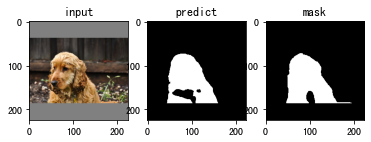

Epoch 1/1:  33%|███▎      | 485/1470 [16:49<33:10,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_57.png'] : tensor(0.9516)
/openbayes/input/input3/test_image/english_cocker_spaniel_57.png
hd: 15.524174696260024
jc: 0.9077527884439568
sc: 0.976494885916601
sp: 0.980753849230154


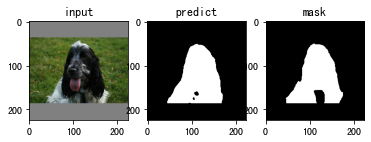

Epoch 1/1:  33%|███▎      | 486/1470 [16:51<33:04,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_63.png'] : tensor(0.8785)
/openbayes/input/input3/test_image/english_cocker_spaniel_63.png
hd: 55.31726674375732
jc: 0.7832854627999629
sc: 0.9070815450643777
sp: 0.9639465439592716


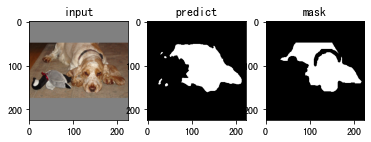

Epoch 1/1:  33%|███▎      | 487/1470 [16:54<33:29,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_66.png'] : tensor(0.9175)
/openbayes/input/input3/test_image/english_cocker_spaniel_66.png
hd: 15.0
jc: 0.8475752163758759
sc: 0.8693722257450857
sp: 0.9898563210404914


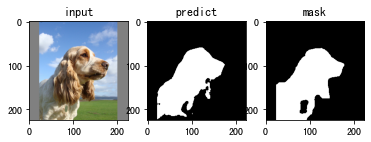

Epoch 1/1:  33%|███▎      | 488/1470 [16:56<33:16,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_79.png'] : tensor(0.9517)
/openbayes/input/input3/test_image/english_cocker_spaniel_79.png
hd: 13.0
jc: 0.9078044293497488
sc: 0.9541871188457534
sp: 0.9812959433705418


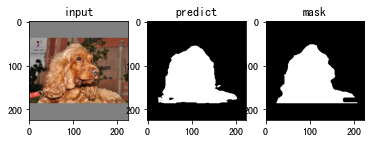

Epoch 1/1:  33%|███▎      | 489/1470 [16:58<33:16,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_80.png'] : tensor(0.8839)
/openbayes/input/input3/test_image/english_cocker_spaniel_80.png
hd: 33.015148038438355
jc: 0.7919783197831979
sc: 0.921311475409836
sp: 0.9693462102920987


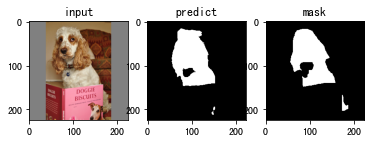

Epoch 1/1:  33%|███▎      | 490/1470 [17:00<33:52,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_81.png'] : tensor(0.4915)
/openbayes/input/input3/test_image/english_cocker_spaniel_81.png
hd: 110.25878649794764
jc: 0.3258466193413243
sc: 0.9759498082955733
sp: 0.8790031073625467


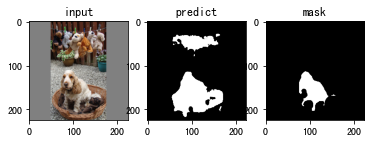

Epoch 1/1:  33%|███▎      | 491/1470 [17:02<33:57,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_cocker_spaniel_86.png'] : tensor(0.9326)
/openbayes/input/input3/test_image/english_cocker_spaniel_86.png
hd: 15.620499351813308
jc: 0.8737128811532585
sc: 0.9255453905700212
sp: 0.9765611966857588


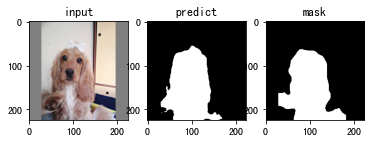

Epoch 1/1:  33%|███▎      | 492/1470 [17:04<33:29,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_setter_120.png'] : tensor(0.8602)
/openbayes/input/input3/test_image/english_setter_120.png
hd: 24.08318915758459
jc: 0.7547188457357447
sc: 0.8517733660495204
sp: 0.9720213540402814


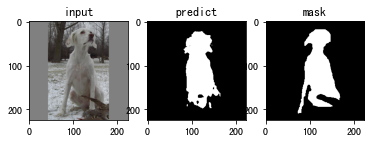

Epoch 1/1:  34%|███▎      | 493/1470 [17:06<33:33,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_setter_123.png'] : tensor(0.7380)
/openbayes/input/input3/test_image/english_setter_123.png
hd: 64.93843238021688
jc: 0.5847320852162685
sc: 0.9457060819629339
sp: 0.948969683892545


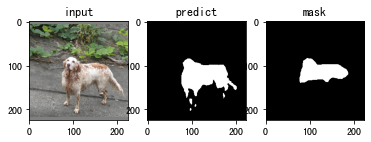

Epoch 1/1:  34%|███▎      | 494/1470 [17:08<34:19,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_setter_125.png'] : tensor(0.8853)
/openbayes/input/input3/test_image/english_setter_125.png
hd: 33.13608305156178
jc: 0.7941707147814018
sc: 0.8688126328575767
sp: 0.9857994952970864


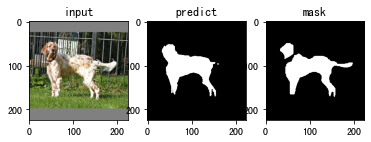

Epoch 1/1:  34%|███▎      | 495/1470 [17:10<34:26,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_setter_127.png'] : tensor(0.8941)
/openbayes/input/input3/test_image/english_setter_127.png
hd: 38.62641583165593
jc: 0.8085151601020119
sc: 0.9178126256533977
sp: 0.9554595797673617


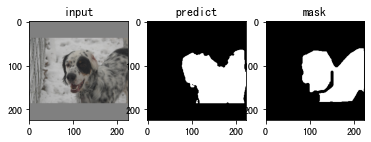

Epoch 1/1:  34%|███▎      | 496/1470 [17:13<36:00,  2.22s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_setter_135.png'] : tensor(0.9417)
/openbayes/input/input3/test_image/english_setter_135.png
hd: 19.6468827043885
jc: 0.8898664734499534
sc: 0.9467019050765334
sp: 0.9637658524395577


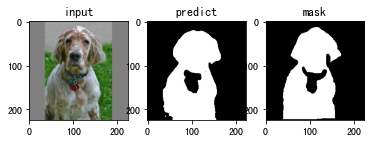

Epoch 1/1:  34%|███▍      | 497/1470 [17:15<35:17,  2.18s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_setter_138.png'] : tensor(0.8953)
/openbayes/input/input3/test_image/english_setter_138.png
hd: 15.033296378372908
jc: 0.8105184632599777
sc: 0.945330626450116
sp: 0.9734981515711645


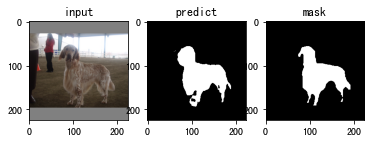

Epoch 1/1:  34%|███▍      | 498/1470 [17:17<34:58,  2.16s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_setter_144.png'] : tensor(0.8836)
/openbayes/input/input3/test_image/english_setter_144.png
hd: 21.0
jc: 0.7914658349872413
sc: 0.9161470298654414
sp: 0.9782224037021914


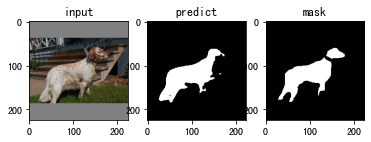

Epoch 1/1:  34%|███▍      | 499/1470 [17:19<34:42,  2.14s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_setter_146.png'] : tensor(0.8768)
/openbayes/input/input3/test_image/english_setter_146.png
hd: 38.01315561749642
jc: 0.7806651957179047
sc: 0.9695524205825636
sp: 0.9408774148748853


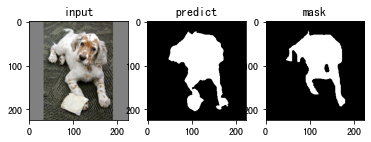

Epoch 1/1:  34%|███▍      | 500/1470 [17:21<34:13,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_setter_150.png'] : tensor(0.9617)
/openbayes/input/input3/test_image/english_setter_150.png
hd: 16.97056274847714
jc: 0.9261514028586554
sc: 0.9608677742688453
sp: 0.9846672283066554


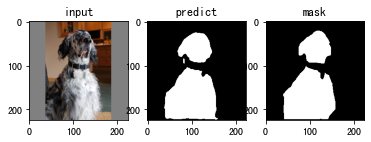

Epoch 1/1:  34%|███▍      | 501/1470 [17:23<33:18,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_setter_155.png'] : tensor(0.8266)
/openbayes/input/input3/test_image/english_setter_155.png
hd: 35.4682957019364
jc: 0.7044595616024187
sc: 0.9190624288856861
sp: 0.8914389208769227


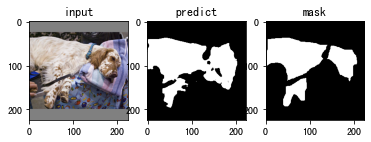

Epoch 1/1:  34%|███▍      | 502/1470 [17:25<33:05,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_setter_160.png'] : tensor(0.8729)
/openbayes/input/input3/test_image/english_setter_160.png
hd: 14.0
jc: 0.7744837758112094
sc: 0.9039421587192288
sp: 0.9781143642797575


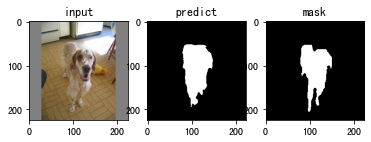

Epoch 1/1:  34%|███▍      | 503/1470 [17:27<33:51,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/english_setter_163.png'] : tensor(0.8203)
/openbayes/input/input3/test_image/english_setter_163.png
hd: 11.704699910719626
jc: 0.6953790028374544
sc: 0.8257521058965103
sp: 0.9830729449599096


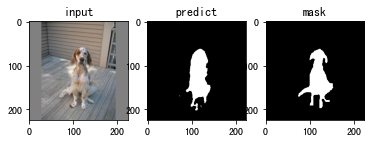

Epoch 1/1:  34%|███▍      | 504/1470 [17:29<33:36,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_171.png'] : tensor(0.8941)
/openbayes/input/input3/test_image/english_setter_171.png
hd: 13.92838827718412
jc: 0.8084207657719036
sc: 0.8931205780520849
sp: 0.984012128729929


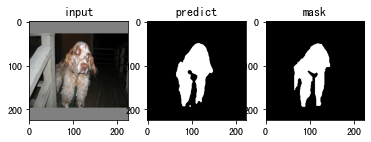

Epoch 1/1:  34%|███▍      | 505/1470 [17:32<34:20,  2.14s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_173.png'] : tensor(0.9013)
/openbayes/input/input3/test_image/english_setter_173.png
hd: 10.0
jc: 0.8204019883293711
sc: 0.9317623956799215
sp: 0.9880048587913757


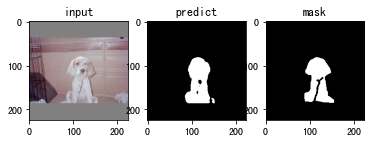

Epoch 1/1:  34%|███▍      | 506/1470 [17:34<34:29,  2.15s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_179.png'] : tensor(0.9209)
/openbayes/input/input3/test_image/english_setter_179.png
hd: 13.601470508735444
jc: 0.8533309978396684
sc: 0.9645591341077085
sp: 0.9436100959342165


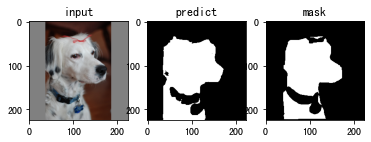

Epoch 1/1:  34%|███▍      | 507/1470 [17:36<33:42,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_180.png'] : tensor(0.8519)
/openbayes/input/input3/test_image/english_setter_180.png
hd: 12.36931687685298
jc: 0.7420514238319049
sc: 0.9342151061608075
sp: 0.9842716106800837


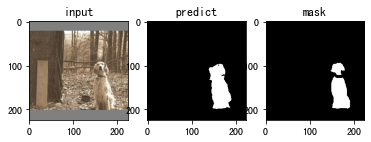

Epoch 1/1:  35%|███▍      | 508/1470 [17:38<33:37,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_19.png'] : tensor(0.8685)
/openbayes/input/input3/test_image/english_setter_19.png
hd: 21.93171219946131
jc: 0.767519804996953
sc: 0.9345782834528815
sp: 0.9581848420052269


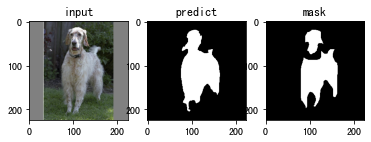

Epoch 1/1:  35%|███▍      | 509/1470 [17:40<32:42,  2.04s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_190.png'] : tensor(0.8248)
/openbayes/input/input3/test_image/english_setter_190.png
hd: 21.840329667841555
jc: 0.7018295698038569
sc: 0.9332602739726027
sp: 0.9267009329857981


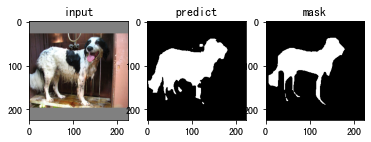

Epoch 1/1:  35%|███▍      | 510/1470 [17:42<32:59,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_2.png'] : tensor(0.8673)
/openbayes/input/input3/test_image/english_setter_2.png
hd: 46.69047011971501
jc: 0.7657222805176636
sc: 0.8772942213673158
sp: 0.9517759091753097


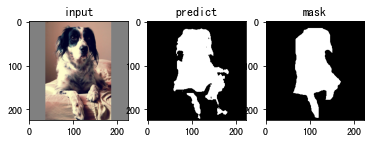

Epoch 1/1:  35%|███▍      | 511/1470 [17:44<32:30,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_21.png'] : tensor(0.9215)
/openbayes/input/input3/test_image/english_setter_21.png
hd: 8.94427190999916
jc: 0.8543689320388349
sc: 0.9279581933557297
sp: 0.9766092245311708


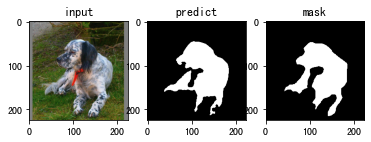

Epoch 1/1:  35%|███▍      | 512/1470 [17:46<32:55,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_27.png'] : tensor(0.9642)
/openbayes/input/input3/test_image/english_setter_27.png
hd: 11.704699910719626
jc: 0.9308626095345285
sc: 0.9916074334161171
sp: 0.9802072781111197


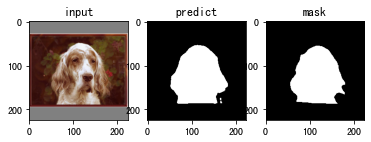

Epoch 1/1:  35%|███▍      | 513/1470 [17:48<33:23,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_29.png'] : tensor(0.9063)
/openbayes/input/input3/test_image/english_setter_29.png
hd: 37.12142238654117
jc: 0.8287357718637339
sc: 0.9832276047673971
sp: 0.8679174611822392


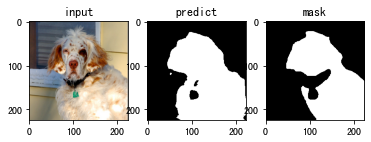

Epoch 1/1:  35%|███▍      | 514/1470 [17:50<33:01,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_32.png'] : tensor(0.8435)
/openbayes/input/input3/test_image/english_setter_32.png
hd: 47.634021455258214
jc: 0.72938663411657
sc: 0.9354990215264188
sp: 0.9034785166172028


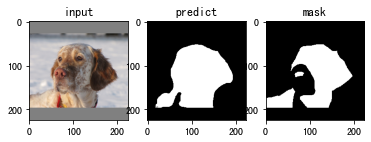

Epoch 1/1:  35%|███▌      | 515/1470 [17:52<33:09,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_34.png'] : tensor(0.8742)
/openbayes/input/input3/test_image/english_setter_34.png
hd: 39.0
jc: 0.776533275337103
sc: 0.873944437645331
sp: 0.975598143078205


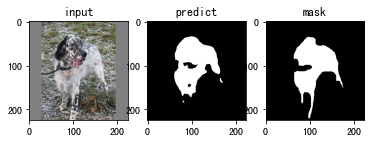

Epoch 1/1:  35%|███▌      | 516/1470 [17:54<34:00,  2.14s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_42.png'] : tensor(0.9040)
/openbayes/input/input3/test_image/english_setter_42.png
hd: 23.345235059857504
jc: 0.8248170281340227
sc: 0.9669395465994962
sp: 0.941583048676345


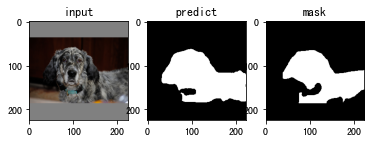

Epoch 1/1:  35%|███▌      | 517/1470 [17:56<33:12,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_43.png'] : tensor(0.8993)
/openbayes/input/input3/test_image/english_setter_43.png
hd: 48.373546489791295
jc: 0.8169743947047553
sc: 0.933290219878619
sp: 0.9048347409722685


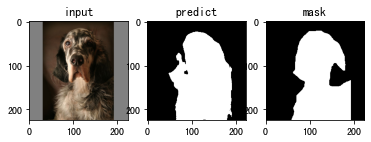

Epoch 1/1:  35%|███▌      | 518/1470 [17:58<32:25,  2.04s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_56.png'] : tensor(0.9171)
/openbayes/input/input3/test_image/english_setter_56.png
hd: 27.0
jc: 0.8468518313599646
sc: 0.9140093156574705
sp: 0.9602752019144482


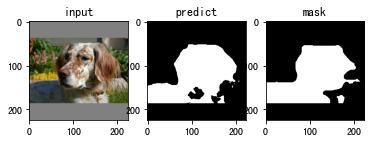

Epoch 1/1:  35%|███▌      | 519/1470 [18:00<32:14,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_57.png'] : tensor(0.9021)
/openbayes/input/input3/test_image/english_setter_57.png
hd: 19.924858845171276
jc: 0.8216492395437263
sc: 0.9055788370874803
sp: 0.9816643159379408


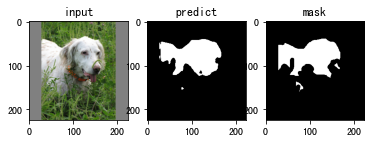

Epoch 1/1:  35%|███▌      | 520/1470 [18:02<31:59,  2.02s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_59.png'] : tensor(0.9392)
/openbayes/input/input3/test_image/english_setter_59.png
hd: 13.038404810405298
jc: 0.8854486000408747
sc: 0.9113378207824989
sp: 0.9931641585521787


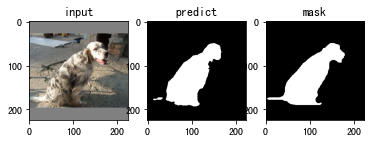

Epoch 1/1:  35%|███▌      | 521/1470 [18:05<32:21,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_6.png'] : tensor(0.9277)
/openbayes/input/input3/test_image/english_setter_6.png
hd: 15.0
jc: 0.8652182091798345
sc: 0.915642263474842
sp: 0.9610743609347472


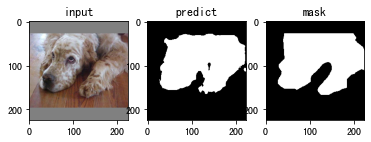

Epoch 1/1:  36%|███▌      | 522/1470 [18:07<32:12,  2.04s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_60.png'] : tensor(0.8051)
/openbayes/input/input3/test_image/english_setter_60.png
hd: 74.52516353554684
jc: 0.6738131699846861
sc: 0.8637873754152824
sp: 0.9571336731413878


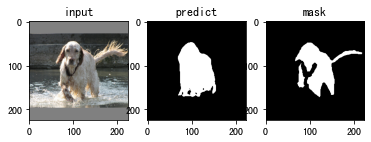

Epoch 1/1:  36%|███▌      | 523/1470 [18:09<32:43,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_63.png'] : tensor(0.9083)
/openbayes/input/input3/test_image/english_setter_63.png
hd: 16.278820596099706
jc: 0.8319301527907702
sc: 0.9188909936283796
sp: 0.9863192769726611


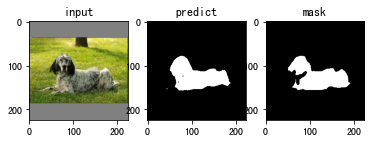

Epoch 1/1:  36%|███▌      | 524/1470 [18:11<33:01,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_74.png'] : tensor(0.9452)
/openbayes/input/input3/test_image/english_setter_74.png
hd: 9.219544457292887
jc: 0.8960621484061077
sc: 0.9826674500587544
sp: 0.9848275225973068


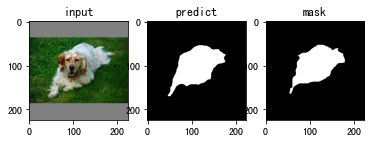

Epoch 1/1:  36%|███▌      | 525/1470 [18:13<33:27,  2.12s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_79.png'] : tensor(0.8952)
/openbayes/input/input3/test_image/english_setter_79.png
hd: 15.264337522473747
jc: 0.8102215245072388
sc: 0.9158123028391167
sp: 0.9853449804895353


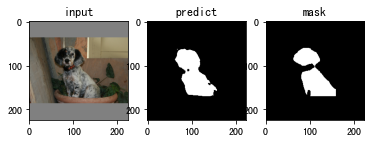

Epoch 1/1:  36%|███▌      | 526/1470 [18:15<32:33,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_90.png'] : tensor(0.8683)
/openbayes/input/input3/test_image/english_setter_90.png
hd: 39.824615503479755
jc: 0.767191011235955
sc: 0.8883684621389539
sp: 0.9528812068207105


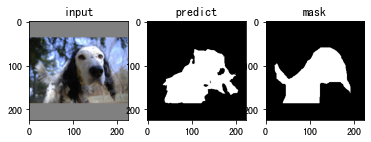

Epoch 1/1:  36%|███▌      | 527/1470 [18:17<32:36,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/english_setter_94.png'] : tensor(0.9662)
/openbayes/input/input3/test_image/english_setter_94.png
hd: 8.0
jc: 0.9346964856230032
sc: 0.9759156714924277
sp: 0.9812146531389434


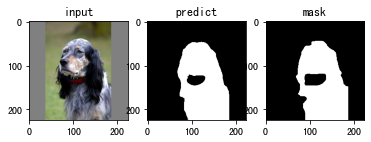

Epoch 1/1:  36%|███▌      | 528/1470 [18:19<32:58,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_1.png'] : tensor(0.7716)
/openbayes/input/input3/test_image/german_shorthaired_1.png
hd: 20.248456731316587
jc: 0.6280842527582748
sc: 0.9099099099099099
sp: 0.9669626618166256


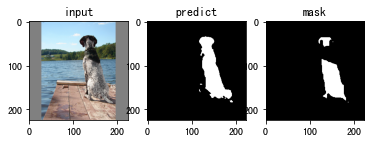

Epoch 1/1:  36%|███▌      | 529/1470 [18:21<32:52,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_105.png'] : tensor(0.8950)
/openbayes/input/input3/test_image/german_shorthaired_105.png
hd: 18.788294228055936
jc: 0.8098864395457582
sc: 0.8296154372519502
sp: 0.9958478154377289


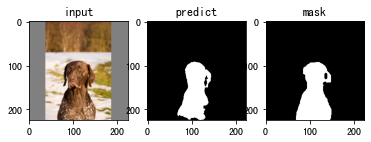

Epoch 1/1:  36%|███▌      | 530/1470 [18:23<32:56,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_107.png'] : tensor(0.8940)
/openbayes/input/input3/test_image/german_shorthaired_107.png
hd: 29.154759474226502
jc: 0.8083903600119012
sc: 0.930373245063349
sp: 0.9190298278924481


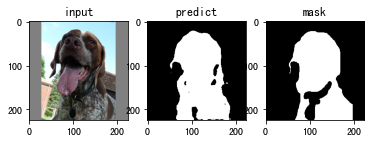

Epoch 1/1:  36%|███▌      | 531/1470 [18:25<32:13,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_110.png'] : tensor(0.8358)
/openbayes/input/input3/test_image/german_shorthaired_110.png
hd: 43.18564576337837
jc: 0.7179076594609021
sc: 0.8745123537061118
sp: 0.9695166272942032


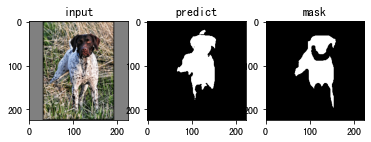

Epoch 1/1:  36%|███▌      | 532/1470 [18:27<32:04,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_120.png'] : tensor(0.9082)
/openbayes/input/input3/test_image/german_shorthaired_120.png
hd: 14.560219778561036
jc: 0.8318199258217164
sc: 0.9025811823480433
sp: 0.9857342331859437


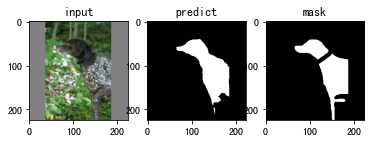

Epoch 1/1:  36%|███▋      | 533/1470 [18:29<31:40,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_122.png'] : tensor(0.9120)
/openbayes/input/input3/test_image/german_shorthaired_122.png
hd: 9.0
jc: 0.8382970599465445
sc: 0.9092979913025471
sp: 0.9909806602421329


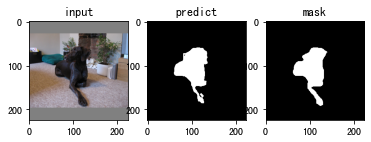

Epoch 1/1:  36%|███▋      | 534/1470 [18:32<32:15,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_129.png'] : tensor(0.8950)
/openbayes/input/input3/test_image/german_shorthaired_129.png
hd: 24.186773244895647
jc: 0.8100358422939068
sc: 0.8389791183294664
sp: 0.9983965348493368


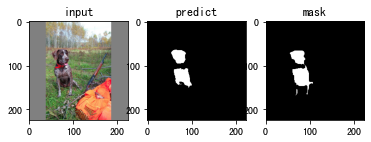

Epoch 1/1:  36%|███▋      | 535/1470 [18:33<31:39,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_13.png'] : tensor(0.8725)
/openbayes/input/input3/test_image/german_shorthaired_13.png
hd: 13.601470508735444
jc: 0.7739130434782608
sc: 0.9012658227848102
sp: 0.9828329958623119


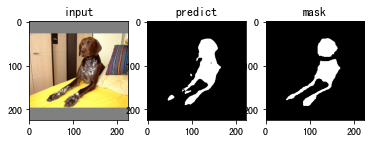

Epoch 1/1:  36%|███▋      | 536/1470 [18:36<31:33,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_130.png'] : tensor(0.8889)
/openbayes/input/input3/test_image/german_shorthaired_130.png
hd: 20.12461179749811
jc: 0.7999440794072418
sc: 0.908831003811944
sp: 0.9804694621695533


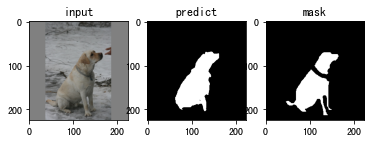

Epoch 1/1:  37%|███▋      | 537/1470 [18:37<31:04,  2.00s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_141.png'] : tensor(0.9301)
/openbayes/input/input3/test_image/german_shorthaired_141.png
hd: 32.0624390837628
jc: 0.8692798021120731
sc: 0.9261098722886681
sp: 0.9839990076903994


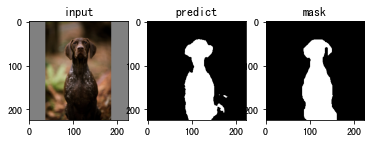

Epoch 1/1:  37%|███▋      | 538/1470 [18:40<32:18,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_142.png'] : tensor(0.7823)
/openbayes/input/input3/test_image/german_shorthaired_142.png
hd: 22.360679774997898
jc: 0.642433234421365
sc: 0.7863196125907991
sp: 0.9923749072623856


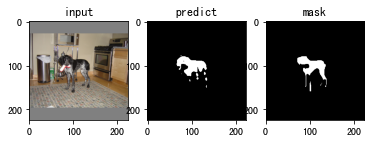

Epoch 1/1:  37%|███▋      | 539/1470 [18:42<32:41,  2.11s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_146.png'] : tensor(0.8190)
/openbayes/input/input3/test_image/german_shorthaired_146.png
hd: 38.47076812334269
jc: 0.6934483688325694
sc: 0.7746987951807229
sp: 0.9916979682431278


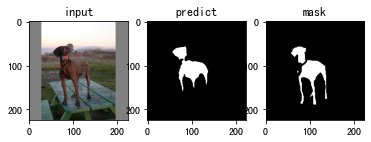

Epoch 1/1:  37%|███▋      | 540/1470 [18:44<32:16,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_147.png'] : tensor(0.9646)
/openbayes/input/input3/test_image/german_shorthaired_147.png
hd: 15.264337522473747
jc: 0.9317026493630763
sc: 0.9426393174804865
sp: 0.9942345983535915


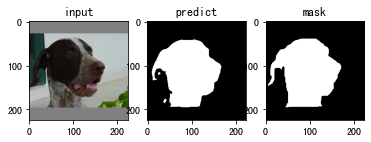

Epoch 1/1:  37%|███▋      | 541/1470 [18:46<32:24,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_150.png'] : tensor(0.7699)
/openbayes/input/input3/test_image/german_shorthaired_150.png
hd: 28.844410203711913
jc: 0.6258596973865199
sc: 0.7076205287713841
sp: 0.996563714461035


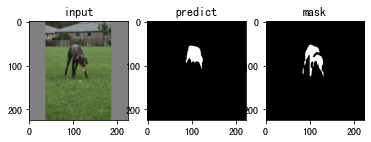

Epoch 1/1:  37%|███▋      | 542/1470 [18:48<32:24,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_156.png'] : tensor(0.7627)
/openbayes/input/input3/test_image/german_shorthaired_156.png
hd: 25.709920264364882
jc: 0.6163917255826132
sc: 0.665535764772406
sp: 0.9869147603359473


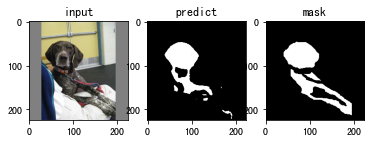

Epoch 1/1:  37%|███▋      | 543/1470 [18:50<32:17,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_160.png'] : tensor(0.8960)
/openbayes/input/input3/test_image/german_shorthaired_160.png
hd: 25.0
jc: 0.8116058143527527
sc: 0.846585482330468
sp: 0.9913636363636363


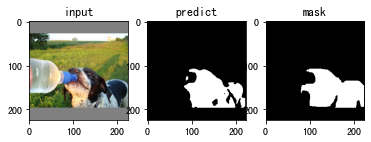

Epoch 1/1:  37%|███▋      | 544/1470 [18:52<32:47,  2.12s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_171.png'] : tensor(0.8868)
/openbayes/input/input3/test_image/german_shorthaired_171.png
hd: 35.12833614050059
jc: 0.7965741601380959
sc: 0.8358645673679811
sp: 0.9917672504011721


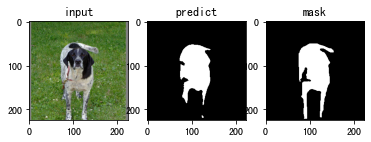

Epoch 1/1:  37%|███▋      | 545/1470 [18:55<32:47,  2.13s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_173.png'] : tensor(0.8439)
/openbayes/input/input3/test_image/german_shorthaired_173.png
hd: 34.0147027033899
jc: 0.7299451918285998
sc: 0.7650130548302873
sp: 0.998093698845859


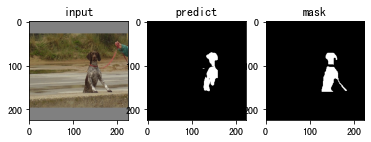

Epoch 1/1:  37%|███▋      | 546/1470 [18:57<33:23,  2.17s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_183.png'] : tensor(0.9353)
/openbayes/input/input3/test_image/german_shorthaired_183.png
hd: 41.43669871020132
jc: 0.8785186146063043
sc: 0.8951820765316238
sp: 0.9918105293194465


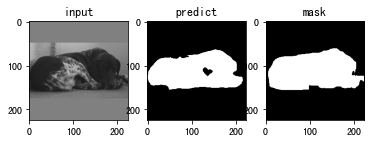

Epoch 1/1:  37%|███▋      | 547/1470 [18:59<33:24,  2.17s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_190.png'] : tensor(0.9329)
/openbayes/input/input3/test_image/german_shorthaired_190.png
hd: 26.476404589747453
jc: 0.8743248690044337
sc: 0.9323476317372991
sp: 0.9799704226448382


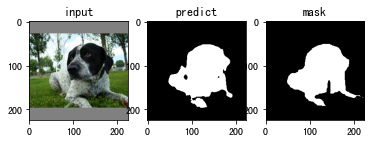

Epoch 1/1:  37%|███▋      | 548/1470 [19:01<33:11,  2.16s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_195.png'] : tensor(0.8615)
/openbayes/input/input3/test_image/german_shorthaired_195.png
hd: 17.46424919657298
jc: 0.7566745843230404
sc: 0.7932270916334662
sp: 0.9879160853099462


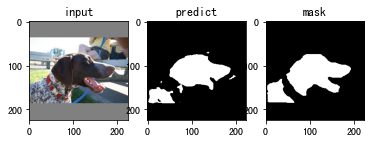

Epoch 1/1:  37%|███▋      | 549/1470 [19:03<33:06,  2.16s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_22.png'] : tensor(0.9011)
/openbayes/input/input3/test_image/german_shorthaired_22.png
hd: 17.0
jc: 0.8199975342127974
sc: 0.8986623429266315
sp: 0.9834015195791934


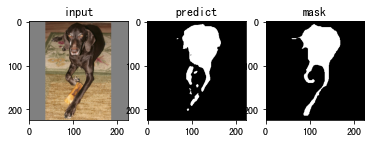

Epoch 1/1:  37%|███▋      | 550/1470 [19:05<32:06,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_29.png'] : tensor(0.9126)
/openbayes/input/input3/test_image/german_shorthaired_29.png
hd: 16.1245154965971
jc: 0.8392022792022792
sc: 0.9606052700234803
sp: 0.9739120207010116


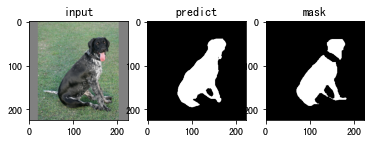

Epoch 1/1:  37%|███▋      | 551/1470 [19:07<32:07,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_3.png'] : tensor(0.7088)
/openbayes/input/input3/test_image/german_shorthaired_3.png
hd: 31.144823004794873
jc: 0.5489749430523918
sc: 0.75
sp: 0.9928269527757457


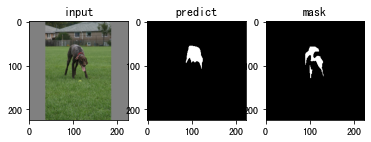

Epoch 1/1:  38%|███▊      | 552/1470 [19:09<32:05,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_36.png'] : tensor(0.8110)
/openbayes/input/input3/test_image/german_shorthaired_36.png
hd: 20.808652046684813
jc: 0.6820753415206292
sc: 0.8034785435630689
sp: 0.9751272033436308


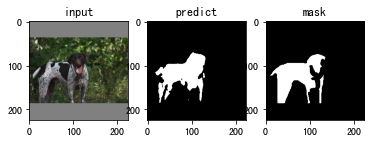

Epoch 1/1:  38%|███▊      | 553/1470 [19:12<32:27,  2.12s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_46.png'] : tensor(0.9189)
/openbayes/input/input3/test_image/german_shorthaired_46.png
hd: 25.0
jc: 0.8500057425060297
sc: 0.8914719344736208
sp: 0.9903281272388594


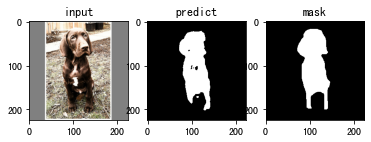

Epoch 1/1:  38%|███▊      | 554/1470 [19:14<32:05,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_50.png'] : tensor(0.8686)
/openbayes/input/input3/test_image/german_shorthaired_50.png
hd: 34.058772731852805
jc: 0.7677873338545739
sc: 0.7954637505062778
sp: 0.9981344456788313


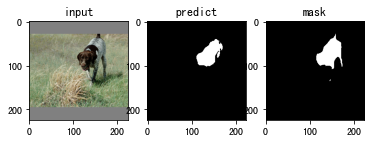

Epoch 1/1:  38%|███▊      | 555/1470 [19:16<31:53,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_54.png'] : tensor(0.6206)
/openbayes/input/input3/test_image/german_shorthaired_54.png
hd: 27.018512172212592
jc: 0.44993526111350884
sc: 0.8427647534357317
sp: 0.9547188797115425


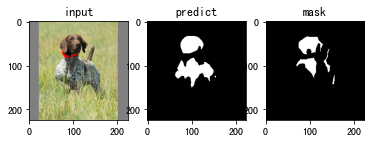

Epoch 1/1:  38%|███▊      | 556/1470 [19:18<31:12,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_66.png'] : tensor(0.9340)
/openbayes/input/input3/test_image/german_shorthaired_66.png
hd: 16.1245154965971
jc: 0.8761911020569101
sc: 0.9833321041374733
sp: 0.9547204850206188


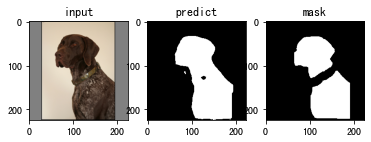

Epoch 1/1:  38%|███▊      | 557/1470 [19:20<31:23,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_67.png'] : tensor(0.8193)
/openbayes/input/input3/test_image/german_shorthaired_67.png
hd: 28.071337695236398
jc: 0.6939359267734554
sc: 0.8655012486621477
sp: 0.9853714140966373


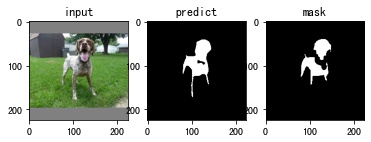

Epoch 1/1:  38%|███▊      | 558/1470 [19:22<31:17,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_73.png'] : tensor(0.9012)
/openbayes/input/input3/test_image/german_shorthaired_73.png
hd: 12.36931687685298
jc: 0.8202190395956193
sc: 0.9068554396423248
sp: 0.9873460096411355


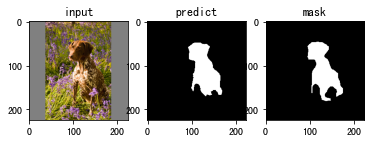

Epoch 1/1:  38%|███▊      | 559/1470 [19:24<31:19,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/german_shorthaired_76.png'] : tensor(0.8323)
/openbayes/input/input3/test_image/german_shorthaired_76.png
hd: 13.0
jc: 0.7127407016618307
sc: 0.8830065359477124
sp: 0.9844851006027676


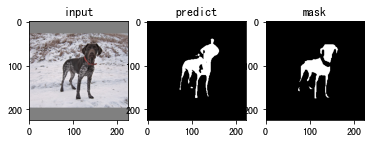

Epoch 1/1:  38%|███▊      | 560/1470 [19:26<31:43,  2.09s/it, f_score=0.934]

['/openbayes/input/input3/test_image/german_shorthaired_79.png'] : tensor(0.8779)
/openbayes/input/input3/test_image/german_shorthaired_79.png
hd: 10.770329614269007
jc: 0.7823232323232323
sc: 0.9348219674109837
sp: 0.9862148435832871


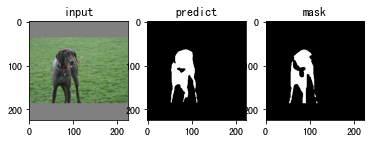

Epoch 1/1:  38%|███▊      | 561/1470 [19:28<30:54,  2.04s/it, f_score=0.934]

['/openbayes/input/input3/test_image/german_shorthaired_82.png'] : tensor(0.7336)
/openbayes/input/input3/test_image/german_shorthaired_82.png
hd: 32.14031735997639
jc: 0.5792892625143294
sc: 0.9708613512648094
sp: 0.9551356980426328


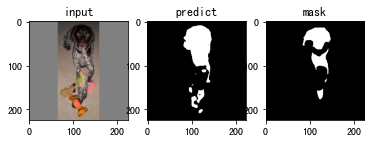

Epoch 1/1:  38%|███▊      | 562/1470 [19:30<30:49,  2.04s/it, f_score=0.934]

['/openbayes/input/input3/test_image/german_shorthaired_86.png'] : tensor(0.8517)
/openbayes/input/input3/test_image/german_shorthaired_86.png
hd: 17.0
jc: 0.7417409873131516
sc: 0.9402866242038217
sp: 0.961704938946601


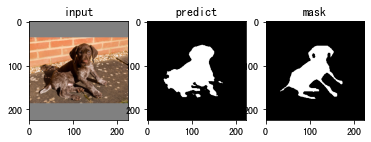

Epoch 1/1:  38%|███▊      | 563/1470 [19:32<30:46,  2.04s/it, f_score=0.934]

['/openbayes/input/input3/test_image/german_shorthaired_90.png'] : tensor(0.8889)
/openbayes/input/input3/test_image/german_shorthaired_90.png
hd: 25.317977802344327
jc: 0.800082508250825
sc: 0.8589016829052258
sp: 0.9786555572699687


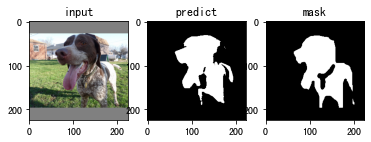

Epoch 1/1:  38%|███▊      | 564/1470 [19:34<30:24,  2.01s/it, f_score=0.934]

['/openbayes/input/input3/test_image/german_shorthaired_93.png'] : tensor(0.8615)
/openbayes/input/input3/test_image/german_shorthaired_93.png
hd: 20.024984394500787
jc: 0.7566291318561569
sc: 0.9455288243304585
sp: 0.9885352177266379


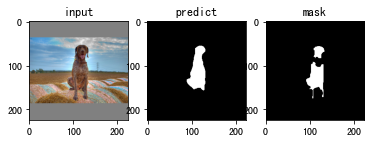

Epoch 1/1:  38%|███▊      | 565/1470 [19:36<30:50,  2.04s/it, f_score=0.934]

['/openbayes/input/input3/test_image/german_shorthaired_99.png'] : tensor(0.8745)
/openbayes/input/input3/test_image/german_shorthaired_99.png
hd: 20.591260281974
jc: 0.7769368232944391
sc: 0.91235649919763
sp: 0.9664408793820558


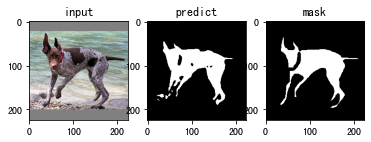

Epoch 1/1:  39%|███▊      | 566/1470 [19:38<30:58,  2.06s/it, f_score=0.934]

['/openbayes/input/input3/test_image/great_pyrenees_10.png'] : tensor(0.9334)
/openbayes/input/input3/test_image/great_pyrenees_10.png
hd: 78.77182237323191
jc: 0.8751046025104603
sc: 0.9784795321637427
sp: 0.9889980610444217


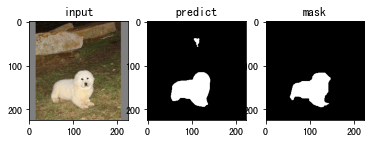

Epoch 1/1:  39%|███▊      | 567/1470 [19:40<30:55,  2.06s/it, f_score=0.934]

['/openbayes/input/input3/test_image/great_pyrenees_101.png'] : tensor(0.9631)
/openbayes/input/input3/test_image/great_pyrenees_101.png
hd: 38.01315561749642
jc: 0.9288252013263856
sc: 0.9569885913001037
sp: 0.985289329584135


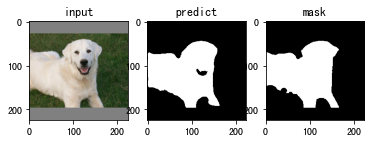

Epoch 1/1:  39%|███▊      | 568/1470 [19:42<30:10,  2.01s/it, f_score=0.934]

['/openbayes/input/input3/test_image/great_pyrenees_11.png'] : tensor(0.9452)
/openbayes/input/input3/test_image/great_pyrenees_11.png
hd: 12.206555615733702
jc: 0.8961447678992919
sc: 0.9372557087019132
sp: 0.9950788921990511


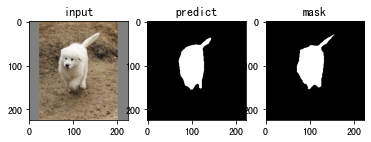

Epoch 1/1:  39%|███▊      | 569/1470 [19:44<30:22,  2.02s/it, f_score=0.934]

['/openbayes/input/input3/test_image/great_pyrenees_112.png'] : tensor(0.9811)
/openbayes/input/input3/test_image/great_pyrenees_112.png
hd: 12.206555615733702
jc: 0.962941554271034
sc: 0.9770609318996416
sp: 0.9935402371450719


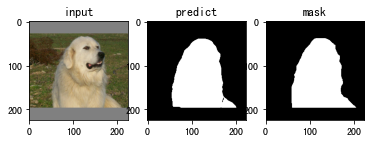

Epoch 1/1:  39%|███▉      | 570/1470 [19:46<30:26,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_119.png'] : tensor(0.9316)
/openbayes/input/input3/test_image/great_pyrenees_119.png
hd: 50.53711507397311
jc: 0.8720405091008622
sc: 0.9003179088661251
sp: 0.9872574331639876


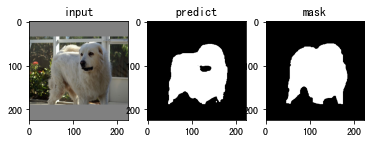

Epoch 1/1:  39%|███▉      | 571/1470 [19:48<31:21,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_126.png'] : tensor(0.6238)
/openbayes/input/input3/test_image/great_pyrenees_126.png
hd: 63.12685640834652
jc: 0.4532303370786517
sc: 0.9722808074721302
sp: 0.9188808502464947


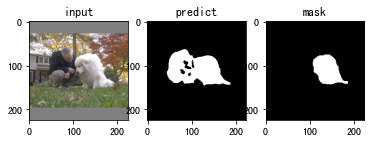

Epoch 1/1:  39%|███▉      | 572/1470 [19:50<31:00,  2.07s/it, f_score=0.934]

['/openbayes/input/input3/test_image/great_pyrenees_127.png'] : tensor(0.8744)
/openbayes/input/input3/test_image/great_pyrenees_127.png
hd: 38.27531841800928
jc: 0.7768822488696678
sc: 0.977491961414791
sp: 0.9773697786833719


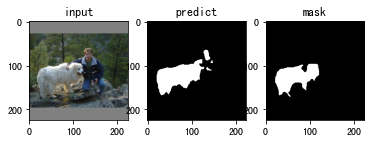

Epoch 1/1:  39%|███▉      | 573/1470 [19:53<31:04,  2.08s/it, f_score=0.934]

['/openbayes/input/input3/test_image/great_pyrenees_13.png'] : tensor(0.9454)
/openbayes/input/input3/test_image/great_pyrenees_13.png
hd: 10.44030650891055
jc: 0.8964511424404472
sc: 0.9372299872935197
sp: 0.9915378433319151


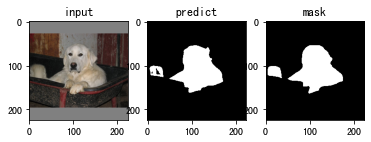

Epoch 1/1:  39%|███▉      | 574/1470 [19:54<30:16,  2.03s/it, f_score=0.934]

['/openbayes/input/input3/test_image/great_pyrenees_132.png'] : tensor(0.8643)
/openbayes/input/input3/test_image/great_pyrenees_132.png
hd: 53.45091205957107
jc: 0.7610501334915455
sc: 0.7797872340425532
sp: 0.9962840627580511


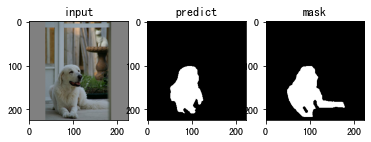

Epoch 1/1:  39%|███▉      | 575/1470 [19:56<29:54,  2.01s/it, f_score=0.934]

['/openbayes/input/input3/test_image/great_pyrenees_133.png'] : tensor(0.9483)
/openbayes/input/input3/test_image/great_pyrenees_133.png
hd: 32.0
jc: 0.9017604670254492
sc: 0.9499375420390122
sp: 0.9860192612336242


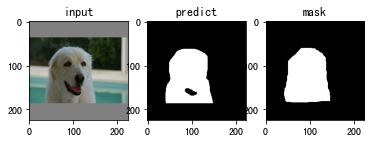

Epoch 1/1:  39%|███▉      | 576/1470 [19:59<30:34,  2.05s/it, f_score=0.934]

['/openbayes/input/input3/test_image/great_pyrenees_135.png'] : tensor(0.9260)
/openbayes/input/input3/test_image/great_pyrenees_135.png
hd: 11.180339887498949
jc: 0.8622352333390735
sc: 0.9261931187569368
sp: 0.9910431092249274


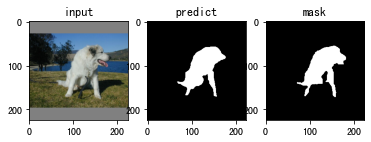

Epoch 1/1:  39%|███▉      | 577/1470 [20:01<30:38,  2.06s/it, f_score=0.934]

['/openbayes/input/input3/test_image/great_pyrenees_137.png'] : tensor(0.9420)
/openbayes/input/input3/test_image/great_pyrenees_137.png
hd: 27.784887978899608
jc: 0.8903542083822412
sc: 0.9875172308163578
sp: 0.9616089228945525


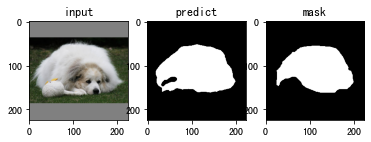

Epoch 1/1:  39%|███▉      | 578/1470 [20:03<29:57,  2.02s/it, f_score=0.934]

['/openbayes/input/input3/test_image/great_pyrenees_142.png'] : tensor(0.9302)
/openbayes/input/input3/test_image/great_pyrenees_142.png
hd: 32.0624390837628
jc: 0.8694451214558453
sc: 0.9276241657276588
sp: 0.980020186857838


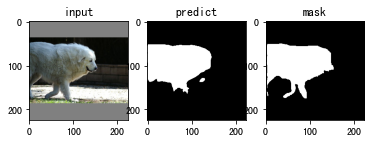

Epoch 1/1:  39%|███▉      | 579/1470 [20:05<30:38,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_144.png'] : tensor(0.8145)
/openbayes/input/input3/test_image/great_pyrenees_144.png
hd: 27.65863337187866
jc: 0.6870219275879653
sc: 0.9390137654643667
sp: 0.9526295654522132


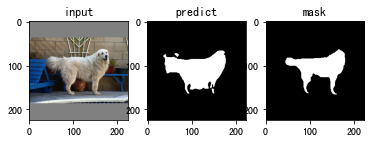

Epoch 1/1:  39%|███▉      | 580/1470 [20:07<30:43,  2.07s/it, f_score=0.934]

['/openbayes/input/input3/test_image/great_pyrenees_148.png'] : tensor(0.9487)
/openbayes/input/input3/test_image/great_pyrenees_148.png
hd: 8.602325267042627
jc: 0.9024830073519212
sc: 0.9648524395669583
sp: 0.9892708309350033


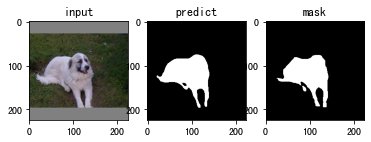

Epoch 1/1:  40%|███▉      | 581/1470 [20:09<30:40,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_167.png'] : tensor(0.9267)
/openbayes/input/input3/test_image/great_pyrenees_167.png
hd: 20.0
jc: 0.8634107746529526
sc: 0.9452712812032443
sp: 0.9678736291592177


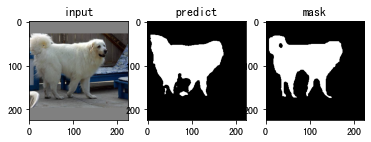

Epoch 1/1:  40%|███▉      | 582/1470 [20:11<31:25,  2.12s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_17.png'] : tensor(0.9523)
/openbayes/input/input3/test_image/great_pyrenees_17.png
hd: 26.40075756488817
jc: 0.9089800540022646
sc: 0.9728721916658898
sp: 0.980886714492129


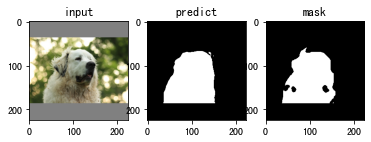

Epoch 1/1:  40%|███▉      | 583/1470 [20:13<30:42,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_171.png'] : tensor(0.8683)
/openbayes/input/input3/test_image/great_pyrenees_171.png
hd: 25.0
jc: 0.767290960035393
sc: 0.9466023833348495
sp: 0.9344358522828777


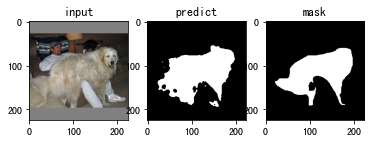

Epoch 1/1:  40%|███▉      | 584/1470 [20:15<30:34,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_177.png'] : tensor(0.8582)
/openbayes/input/input3/test_image/great_pyrenees_177.png
hd: 35.84689665786984
jc: 0.7516914749661705
sc: 0.8940450643776824
sp: 0.984800206682742


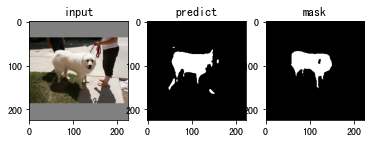

Epoch 1/1:  40%|███▉      | 585/1470 [20:17<29:43,  2.02s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_178.png'] : tensor(0.9251)
/openbayes/input/input3/test_image/great_pyrenees_178.png
hd: 31.78049716414141
jc: 0.8605557776889244
sc: 0.9288951230038843
sp: 0.9820084091131319


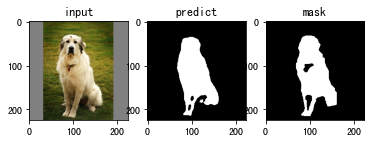

Epoch 1/1:  40%|███▉      | 586/1470 [20:19<29:42,  2.02s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_18.png'] : tensor(0.9512)
/openbayes/input/input3/test_image/great_pyrenees_18.png
hd: 17.0
jc: 0.9068931068931069
sc: 0.9479949874686717
sp: 0.9952190006169032


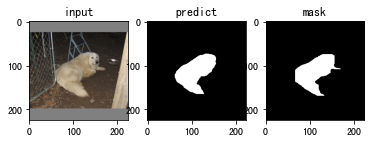

Epoch 1/1:  40%|███▉      | 587/1470 [20:21<30:06,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_183.png'] : tensor(0.8835)
/openbayes/input/input3/test_image/great_pyrenees_183.png
hd: 13.0
jc: 0.7913343965975544
sc: 0.8165112452002194
sp: 0.9975069847410273


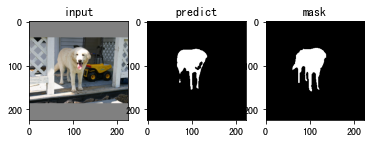

Epoch 1/1:  40%|████      | 588/1470 [20:23<29:53,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_188.png'] : tensor(0.9162)
/openbayes/input/input3/test_image/great_pyrenees_188.png
hd: 10.44030650891055
jc: 0.8453907573191386
sc: 0.9828410689170183
sp: 0.9876021535359601


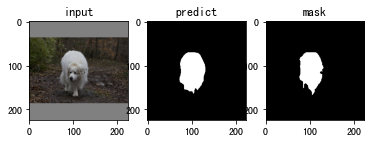

Epoch 1/1:  40%|████      | 589/1470 [20:25<29:53,  2.04s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_194.png'] : tensor(0.9280)
/openbayes/input/input3/test_image/great_pyrenees_194.png
hd: 37.16180835212409
jc: 0.8656261895698515
sc: 0.9834045083518028
sp: 0.9205417179657165


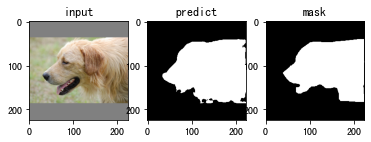

Epoch 1/1:  40%|████      | 590/1470 [20:27<29:14,  1.99s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_196.png'] : tensor(0.9112)
/openbayes/input/input3/test_image/great_pyrenees_196.png
hd: 18.384776310850235
jc: 0.8369059917355371
sc: 0.903905160390516
sp: 0.9866530251592801


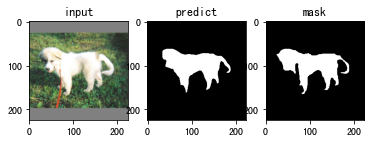

Epoch 1/1:  40%|████      | 591/1470 [20:29<29:18,  2.00s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_199.png'] : tensor(0.9415)
/openbayes/input/input3/test_image/great_pyrenees_199.png
hd: 19.0
jc: 0.8894006495423679
sc: 0.9424942118766034
sp: 0.9721011843836819


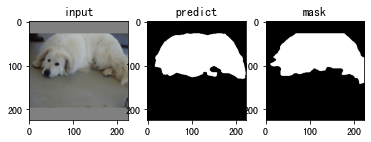

Epoch 1/1:  40%|████      | 592/1470 [20:31<29:55,  2.04s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_22.png'] : tensor(0.9522)
/openbayes/input/input3/test_image/great_pyrenees_22.png
hd: 19.235384061671343
jc: 0.9086701858413478
sc: 0.9308148148148148
sp: 0.9910295561129894


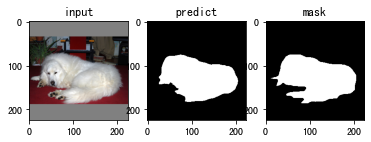

Epoch 1/1:  40%|████      | 593/1470 [20:34<30:59,  2.12s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_27.png'] : tensor(0.9302)
/openbayes/input/input3/test_image/great_pyrenees_27.png
hd: 43.46262762420146
jc: 0.8694350429575631
sc: 0.9364834548513741
sp: 0.9872223771024997


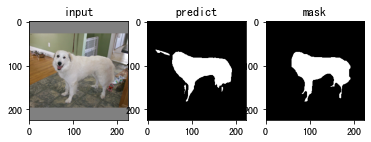

Epoch 1/1:  40%|████      | 594/1470 [20:36<30:21,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_31.png'] : tensor(0.9694)
/openbayes/input/input3/test_image/great_pyrenees_31.png
hd: 18.0
jc: 0.9406494960806271
sc: 0.9851243750385779
sp: 0.9774540103016924


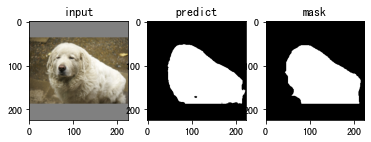

Epoch 1/1:  40%|████      | 595/1470 [20:38<29:58,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_35.png'] : tensor(0.9697)
/openbayes/input/input3/test_image/great_pyrenees_35.png
hd: 14.317821063276353
jc: 0.941114477670926
sc: 0.9550163759107012
sp: 0.9937242652278858


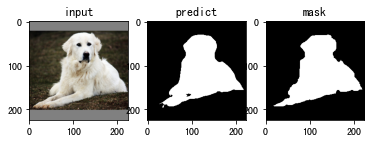

Epoch 1/1:  41%|████      | 596/1470 [20:40<30:17,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_38.png'] : tensor(0.9271)
/openbayes/input/input3/test_image/great_pyrenees_38.png
hd: 18.35755975068582
jc: 0.8641552511415526
sc: 0.8898902821316614
sp: 0.9946378174976481


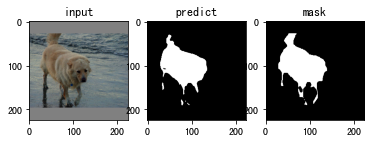

Epoch 1/1:  41%|████      | 597/1470 [20:42<29:53,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_42.png'] : tensor(0.9347)
/openbayes/input/input3/test_image/great_pyrenees_42.png
hd: 14.866068747318506
jc: 0.8774324716816729
sc: 0.9269714636391531
sp: 0.9863362954528577


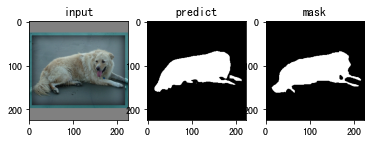

Epoch 1/1:  41%|████      | 598/1470 [20:44<29:59,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_43.png'] : tensor(0.9477)
/openbayes/input/input3/test_image/great_pyrenees_43.png
hd: 10.44030650891055
jc: 0.9006551390828053
sc: 0.9329180109022138
sp: 0.9921819991744968


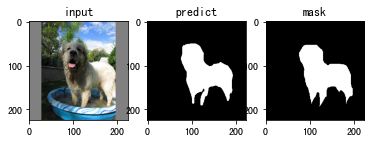

Epoch 1/1:  41%|████      | 599/1470 [20:46<30:05,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_44.png'] : tensor(0.8732)
/openbayes/input/input3/test_image/great_pyrenees_44.png
hd: 32.0
jc: 0.7749731471535983
sc: 0.9300676764421527
sp: 0.9868077241730928


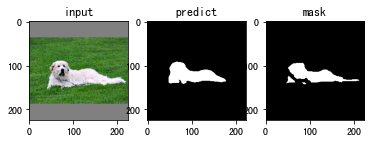

Epoch 1/1:  41%|████      | 600/1470 [20:48<29:56,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_53.png'] : tensor(0.9516)
/openbayes/input/input3/test_image/great_pyrenees_53.png
hd: 17.029386365926403
jc: 0.9075982532751091
sc: 0.9733982765080554
sp: 0.9913689281413087


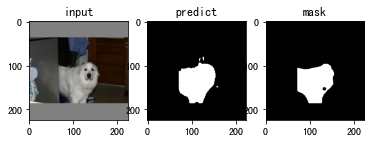

Epoch 1/1:  41%|████      | 601/1470 [20:50<29:24,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_63.png'] : tensor(0.6303)
/openbayes/input/input3/test_image/great_pyrenees_63.png
hd: 56.72741841473134
jc: 0.46016869728209936
sc: 0.9735624586913417
sp: 0.965312455047983


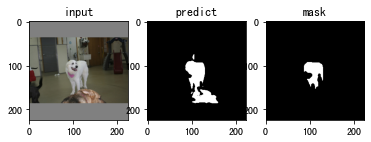

Epoch 1/1:  41%|████      | 602/1470 [20:52<29:47,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_67.png'] : tensor(0.9157)
/openbayes/input/input3/test_image/great_pyrenees_67.png
hd: 17.46424919657298
jc: 0.8445155594791437
sc: 0.9342041015625
sp: 0.9792778201219512


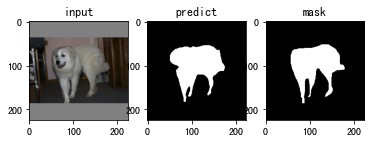

Epoch 1/1:  41%|████      | 603/1470 [20:54<29:43,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_68.png'] : tensor(0.9479)
/openbayes/input/input3/test_image/great_pyrenees_68.png
hd: 9.219544457292887
jc: 0.9008885850991114
sc: 0.9253018814939624
sp: 0.9955172573976866


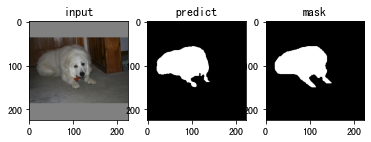

Epoch 1/1:  41%|████      | 604/1470 [20:56<29:39,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_83.png'] : tensor(0.8710)
/openbayes/input/input3/test_image/great_pyrenees_83.png
hd: 22.20360331117452
jc: 0.7714454277286136
sc: 0.8735970069481561
sp: 0.9767872200880727


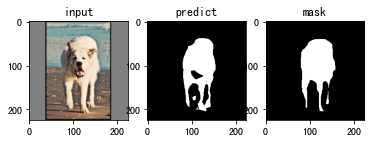

Epoch 1/1:  41%|████      | 605/1470 [20:58<29:17,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_9.png'] : tensor(0.8968)
/openbayes/input/input3/test_image/great_pyrenees_9.png
hd: 21.587033144922902
jc: 0.8128761822871883
sc: 0.9863067292644757
sp: 0.9615131269408111


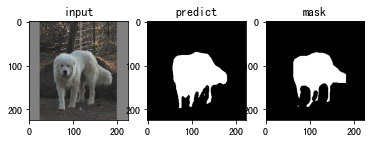

Epoch 1/1:  41%|████      | 606/1470 [21:00<29:34,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_96.png'] : tensor(0.9662)
/openbayes/input/input3/test_image/great_pyrenees_96.png
hd: 4.0
jc: 0.9346534653465347
sc: 0.965893587994543
sp: 0.9942818466134529


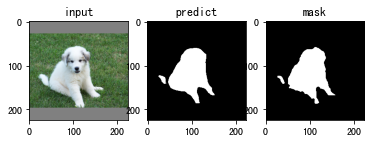

Epoch 1/1:  41%|████▏     | 607/1470 [21:02<29:57,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/great_pyrenees_98.png'] : tensor(0.9162)
/openbayes/input/input3/test_image/great_pyrenees_98.png
hd: 11.40175425099138
jc: 0.8453906053755338
sc: 0.9726878612716763
sp: 0.9759108562973923


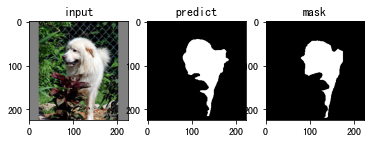

Epoch 1/1:  41%|████▏     | 608/1470 [21:04<29:33,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_107.png'] : tensor(0.9560)
/openbayes/input/input3/test_image/havanese_107.png
hd: 13.0
jc: 0.915732269381578
sc: 0.964777503986085
sp: 0.9796855242179339


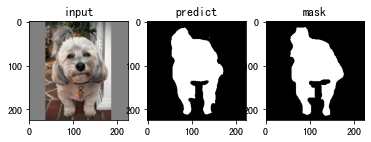

Epoch 1/1:  41%|████▏     | 609/1470 [21:06<29:21,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_108.png'] : tensor(0.9426)
/openbayes/input/input3/test_image/havanese_108.png
hd: 19.235384061671343
jc: 0.8915036045314109
sc: 0.9265225302365407
sp: 0.9766910130200064


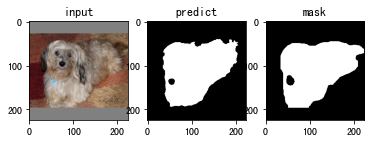

Epoch 1/1:  41%|████▏     | 610/1470 [21:09<29:36,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_114.png'] : tensor(0.8783)
/openbayes/input/input3/test_image/havanese_114.png
hd: 14.0
jc: 0.7830346475507766
sc: 0.929645390070922
sp: 0.9858523933034662


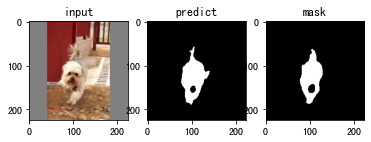

Epoch 1/1:  42%|████▏     | 611/1470 [21:11<30:36,  2.14s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_119.png'] : tensor(0.9486)
/openbayes/input/input3/test_image/havanese_119.png
hd: 8.0
jc: 0.9021410426998911
sc: 0.9157662082514735
sp: 0.9970736581652074


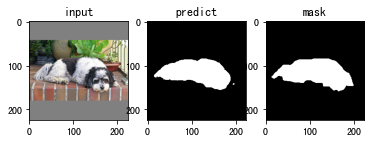

Epoch 1/1:  42%|████▏     | 612/1470 [21:13<30:58,  2.17s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_123.png'] : tensor(0.9104)
/openbayes/input/input3/test_image/havanese_123.png
hd: 37.64306044943742
jc: 0.8355003850858514
sc: 0.8626625502853401
sp: 0.9758663796096951


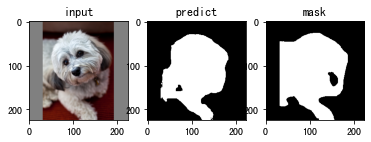

Epoch 1/1:  42%|████▏     | 613/1470 [21:15<30:49,  2.16s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_126.png'] : tensor(0.8725)
/openbayes/input/input3/test_image/havanese_126.png
hd: 92.9623579735368
jc: 0.7737911369846738
sc: 0.9728155339805825
sp: 0.9603964950208137


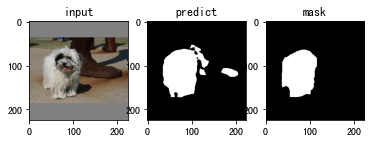

Epoch 1/1:  42%|████▏     | 614/1470 [21:17<30:00,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_128.png'] : tensor(0.9013)
/openbayes/input/input3/test_image/havanese_128.png
hd: 27.018512172212592
jc: 0.8203826630222569
sc: 0.9654591406908172
sp: 0.9377946604164983


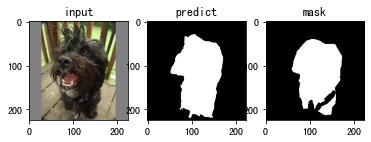

Epoch 1/1:  42%|████▏     | 615/1470 [21:19<29:12,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_132.png'] : tensor(0.9506)
/openbayes/input/input3/test_image/havanese_132.png
hd: 16.64331697709324
jc: 0.9058706816059757
sc: 0.9726799924807319
sp: 0.9656018937954818


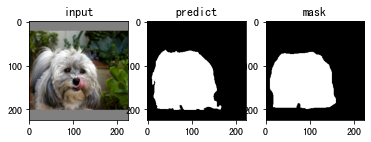

Epoch 1/1:  42%|████▏     | 616/1470 [21:21<29:56,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_133.png'] : tensor(0.9461)
/openbayes/input/input3/test_image/havanese_133.png
hd: 21.02379604162864
jc: 0.8977742083524552
sc: 0.9822997740396686
sp: 0.9822316986496091


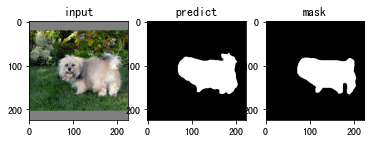

Epoch 1/1:  42%|████▏     | 617/1470 [21:23<29:28,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_136.png'] : tensor(0.8739)
/openbayes/input/input3/test_image/havanese_136.png
hd: 79.51100552753688
jc: 0.7760223048327137
sc: 0.9610957642725598
sp: 0.9500578480524489


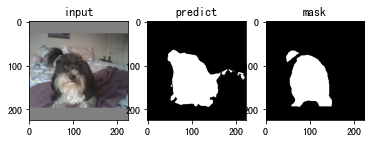

Epoch 1/1:  42%|████▏     | 618/1470 [21:25<29:38,  2.09s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_138.png'] : tensor(0.8838)
/openbayes/input/input3/test_image/havanese_138.png
hd: 66.21933252457322
jc: 0.7918203151190077
sc: 0.9974662162162162
sp: 0.9871360441767069


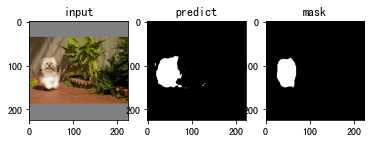

Epoch 1/1:  42%|████▏     | 619/1470 [21:27<28:52,  2.04s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_144.png'] : tensor(0.9012)
/openbayes/input/input3/test_image/havanese_144.png
hd: 6.324555320336759
jc: 0.8202092511013216
sc: 0.929195258889582
sp: 0.9909303810943155


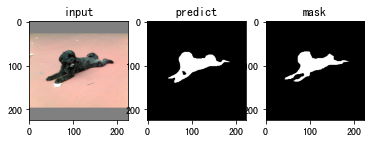

Epoch 1/1:  42%|████▏     | 620/1470 [21:29<28:32,  2.01s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_147.png'] : tensor(0.9416)
/openbayes/input/input3/test_image/havanese_147.png
hd: 25.80697580112788
jc: 0.8896493386650262
sc: 0.9712870455881119
sp: 0.9714360381549719


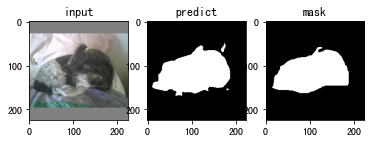

Epoch 1/1:  42%|████▏     | 621/1470 [21:31<28:49,  2.04s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_150.png'] : tensor(0.9297)
/openbayes/input/input3/test_image/havanese_150.png
hd: 15.811388300841896
jc: 0.8685478923845412
sc: 0.9527059502066711
sp: 0.9746561737862369


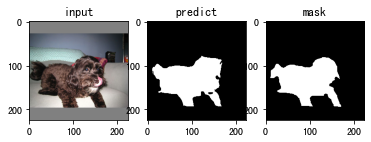

Epoch 1/1:  42%|████▏     | 622/1470 [21:33<28:36,  2.02s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_157.png'] : tensor(0.9111)
/openbayes/input/input3/test_image/havanese_157.png
hd: 24.73863375370596
jc: 0.836636521069848
sc: 0.9776278808319281
sp: 0.9636878951575786


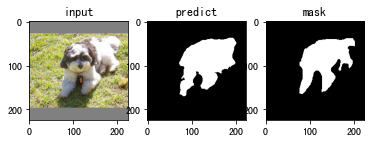

Epoch 1/1:  42%|████▏     | 623/1470 [21:35<28:25,  2.01s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_161.png'] : tensor(0.9426)
/openbayes/input/input3/test_image/havanese_161.png
hd: 18.439088914585774
jc: 0.8914392723381488
sc: 0.9650718257645968
sp: 0.9566723383568303


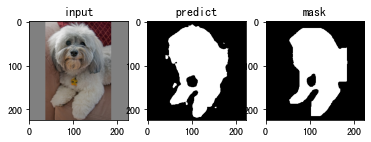

Epoch 1/1:  42%|████▏     | 624/1470 [21:37<28:30,  2.02s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_176.png'] : tensor(0.8711)
/openbayes/input/input3/test_image/havanese_176.png
hd: 23.08679276123039
jc: 0.77159378388146
sc: 0.9662819642453043
sp: 0.9756321437157156


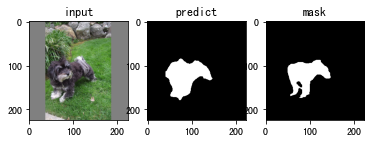

Epoch 1/1:  43%|████▎     | 625/1470 [21:39<28:26,  2.02s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_186.png'] : tensor(0.9519)
/openbayes/input/input3/test_image/havanese_186.png
hd: 14.560219778561036
jc: 0.9082015697872825
sc: 0.986612843432055
sp: 0.9190702343719834


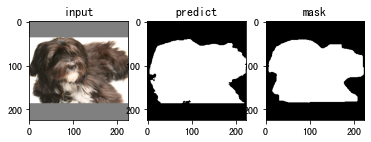

Epoch 1/1:  43%|████▎     | 626/1470 [21:42<29:01,  2.06s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_187.png'] : tensor(0.8158)
/openbayes/input/input3/test_image/havanese_187.png
hd: 33.0
jc: 0.6889698764307272
sc: 0.9496114904638568
sp: 0.8712434887137706


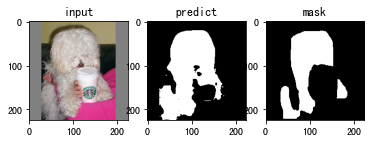

Epoch 1/1:  43%|████▎     | 627/1470 [21:44<28:39,  2.04s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_189.png'] : tensor(0.9645)
/openbayes/input/input3/test_image/havanese_189.png
hd: 5.0
jc: 0.9314939779619031
sc: 0.9936218678815489
sp: 0.981327006964108


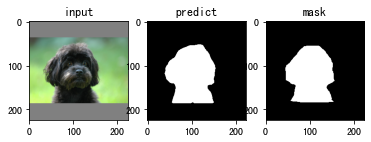

Epoch 1/1:  43%|████▎     | 628/1470 [21:46<28:41,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_19.png'] : tensor(0.9117)
/openbayes/input/input3/test_image/havanese_19.png
hd: 31.78049716414141
jc: 0.837754709727028
sc: 0.9477346864806089
sp: 0.9502212693438883


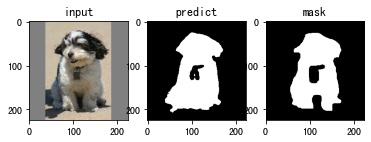

Epoch 1/1:  43%|████▎     | 629/1470 [21:48<28:18,  2.02s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_194.png'] : tensor(0.9451)
/openbayes/input/input3/test_image/havanese_194.png
hd: 21.18962010041709
jc: 0.895918235332169
sc: 0.9799412742774259
sp: 0.8789994979232278


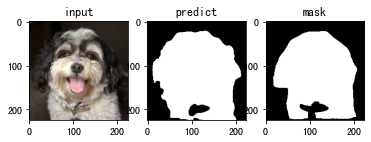

Epoch 1/1:  43%|████▎     | 630/1470 [21:50<29:00,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_197.png'] : tensor(0.9190)
/openbayes/input/input3/test_image/havanese_197.png
hd: 15.556349186104045
jc: 0.8501702610669694
sc: 0.984375
sp: 0.975050775480059


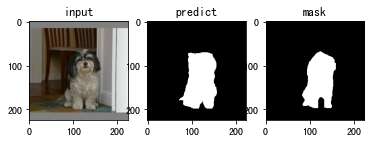

Epoch 1/1:  43%|████▎     | 631/1470 [21:52<29:06,  2.08s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_198.png'] : tensor(0.8866)
/openbayes/input/input3/test_image/havanese_198.png
hd: 21.93171219946131
jc: 0.7962430515622005
sc: 0.9787935909519322
sp: 0.978816511364626


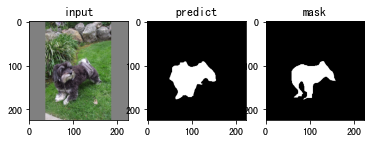

Epoch 1/1:  43%|████▎     | 632/1470 [21:54<29:23,  2.10s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_199.png'] : tensor(0.8417)
/openbayes/input/input3/test_image/havanese_199.png
hd: 18.439088914585774
jc: 0.7266968325791855
sc: 0.9536817102137767
sp: 0.9775252093659204


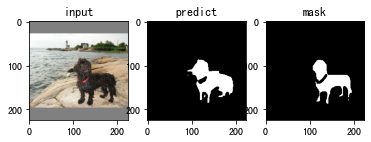

Epoch 1/1:  43%|████▎     | 633/1470 [21:56<28:34,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_200.png'] : tensor(0.8790)
/openbayes/input/input3/test_image/havanese_200.png
hd: 29.154759474226502
jc: 0.7840740317605392
sc: 0.976105817095719
sp: 0.9046353214819738


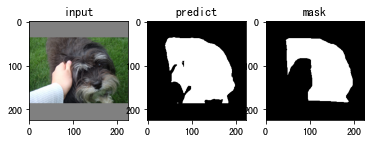

Epoch 1/1:  43%|████▎     | 634/1470 [21:58<28:13,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_25.png'] : tensor(0.9093)
/openbayes/input/input3/test_image/havanese_25.png
hd: 26.1725046566048
jc: 0.8336661674155433
sc: 0.919258647582347
sp: 0.9715100440461338


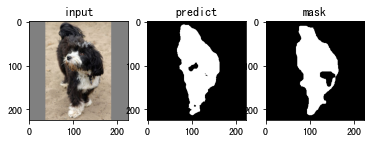

Epoch 1/1:  43%|████▎     | 635/1470 [22:00<28:14,  2.03s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_43.png'] : tensor(0.9423)
/openbayes/input/input3/test_image/havanese_43.png
hd: 29.154759474226502
jc: 0.8908306364617045
sc: 0.9802943969610636
sp: 0.9797374976049051


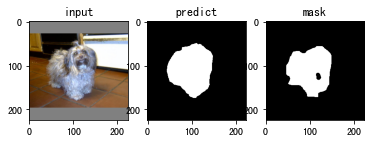

Epoch 1/1:  43%|████▎     | 636/1470 [22:02<28:25,  2.05s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_5.png'] : tensor(0.8968)
/openbayes/input/input3/test_image/havanese_5.png
hd: 36.61966684720111
jc: 0.8128713341888874
sc: 0.8544164668265388
sp: 0.9660809018567639


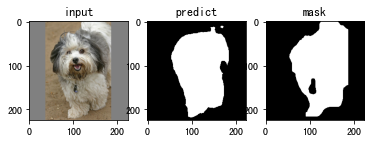

Epoch 1/1:  43%|████▎     | 637/1470 [22:04<28:42,  2.07s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_50.png'] : tensor(0.9436)
/openbayes/input/input3/test_image/havanese_50.png
hd: 11.180339887498949
jc: 0.8931841302136317
sc: 0.956114559512142
sp: 0.9842168175054278


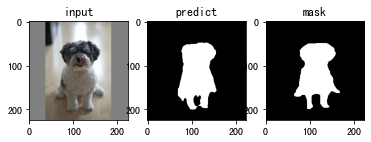

Epoch 1/1:  43%|████▎     | 638/1470 [22:06<28:19,  2.04s/it, f_score=0.935]

['/openbayes/input/input3/test_image/havanese_59.png'] : tensor(0.9589)
/openbayes/input/input3/test_image/havanese_59.png
hd: 15.231546211727817
jc: 0.9209877865866724
sc: 0.9248520710059172
sp: 0.9975305515101627


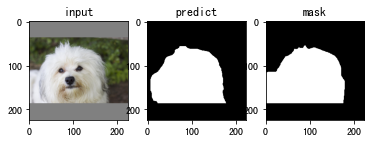

Epoch 1/1:  43%|████▎     | 639/1470 [22:08<28:15,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/havanese_6.png'] : tensor(0.9221)
/openbayes/input/input3/test_image/havanese_6.png
hd: 58.463663928973865
jc: 0.8554908031323984
sc: 0.9670114765066131
sp: 0.9176126199382013


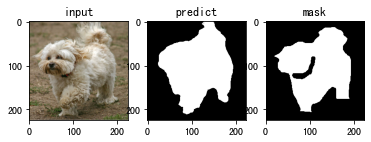

Epoch 1/1:  44%|████▎     | 640/1470 [22:10<28:38,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/havanese_65.png'] : tensor(0.9284)
/openbayes/input/input3/test_image/havanese_65.png
hd: 16.278820596099706
jc: 0.8663930084745762
sc: 0.9076154806491885
sp: 0.9920171294249075


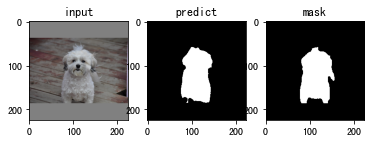

Epoch 1/1:  44%|████▎     | 641/1470 [22:12<28:30,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/havanese_75.png'] : tensor(0.9313)
/openbayes/input/input3/test_image/havanese_75.png
hd: 11.045361017187261
jc: 0.8714325685506435
sc: 0.9621563175780043
sp: 0.9845773648803259


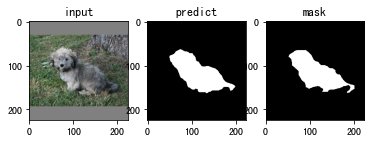

Epoch 1/1:  44%|████▎     | 642/1470 [22:14<28:12,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/havanese_80.png'] : tensor(0.9622)
/openbayes/input/input3/test_image/havanese_80.png
hd: 12.165525060596439
jc: 0.9271825396825397
sc: 0.982445075160307
sp: 0.9635955056179776


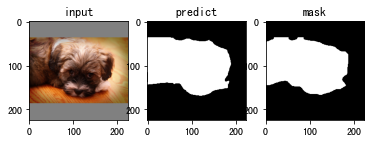

Epoch 1/1:  44%|████▎     | 643/1470 [22:17<28:24,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/havanese_85.png'] : tensor(0.9143)
/openbayes/input/input3/test_image/havanese_85.png
hd: 59.682493245507096
jc: 0.8421346744900811
sc: 0.964943172722907
sp: 0.9792619909399258


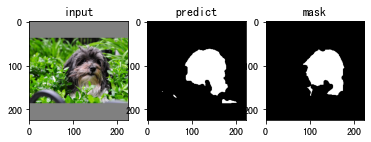

Epoch 1/1:  44%|████▍     | 644/1470 [22:18<27:59,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/havanese_86.png'] : tensor(0.9300)
/openbayes/input/input3/test_image/havanese_86.png
hd: 15.811388300841896
jc: 0.8691488012178105
sc: 0.9059834710743802
sp: 0.9817123619868192


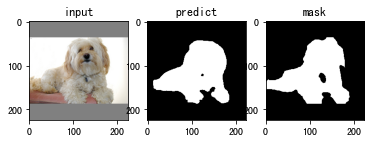

Epoch 1/1:  44%|████▍     | 645/1470 [22:21<28:41,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/havanese_87.png'] : tensor(0.8649)
/openbayes/input/input3/test_image/havanese_87.png
hd: 30.083217912982647
jc: 0.7619047619047619
sc: 0.8501632331419565
sp: 0.9750805221223936


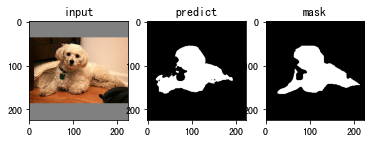

Epoch 1/1:  44%|████▍     | 646/1470 [22:23<28:26,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/havanese_89.png'] : tensor(0.9417)
/openbayes/input/input3/test_image/havanese_89.png
hd: 12.083045973594572
jc: 0.8898054996646546
sc: 0.960889403925545
sp: 0.9696719733839259


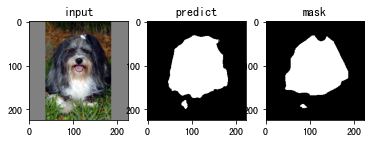

Epoch 1/1:  44%|████▍     | 647/1470 [22:25<27:46,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/havanese_92.png'] : tensor(0.9159)
/openbayes/input/input3/test_image/havanese_92.png
hd: 46.238512086787566
jc: 0.8448244246813973
sc: 0.9606442869057548
sp: 0.9151393908105317


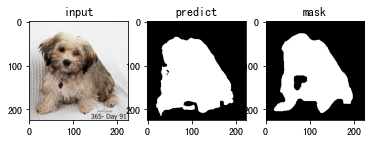

Epoch 1/1:  44%|████▍     | 648/1470 [22:27<28:14,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/havanese_93.png'] : tensor(0.9688)
/openbayes/input/input3/test_image/havanese_93.png
hd: 10.816653826391969
jc: 0.9395464103334334
sc: 0.9701457816377171
sp: 0.9887339055793991


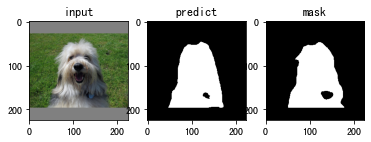

Epoch 1/1:  44%|████▍     | 649/1470 [22:29<28:24,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/havanese_99.png'] : tensor(0.9541)
/openbayes/input/input3/test_image/havanese_99.png
hd: 8.0
jc: 0.9121867881548975
sc: 0.9876680231841164
sp: 0.9840492547602634


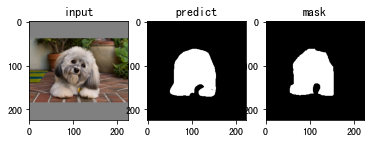

Epoch 1/1:  44%|████▍     | 650/1470 [22:31<28:12,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_103.png'] : tensor(0.9532)
/openbayes/input/input3/test_image/japanese_chin_103.png
hd: 14.560219778561036
jc: 0.9105334086858236
sc: 0.9669005631982273
sp: 0.9529704706459985


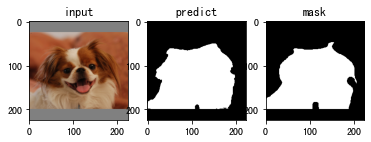

Epoch 1/1:  44%|████▍     | 651/1470 [22:33<28:31,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_105.png'] : tensor(0.8802)
/openbayes/input/input3/test_image/japanese_chin_105.png
hd: 25.553864678361276
jc: 0.7859698242339399
sc: 0.9343565088757396
sp: 0.948119918699187


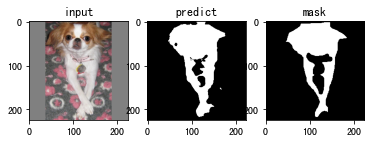

Epoch 1/1:  44%|████▍     | 652/1470 [22:35<28:18,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_11.png'] : tensor(0.9339)
/openbayes/input/input3/test_image/japanese_chin_11.png
hd: 15.264337522473747
jc: 0.8759918385853548
sc: 0.9618320610687023
sp: 0.9690221382855944


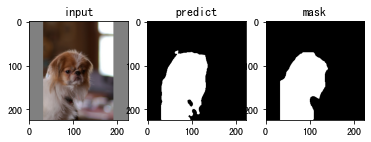

Epoch 1/1:  44%|████▍     | 653/1470 [22:37<28:11,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_112.png'] : tensor(0.8753)
/openbayes/input/input3/test_image/japanese_chin_112.png
hd: 23.600847442411894
jc: 0.7782143636760532
sc: 0.958075786079011
sp: 0.9814874609837477


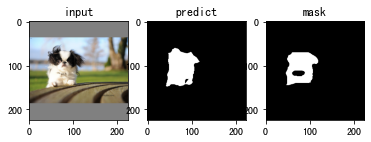

Epoch 1/1:  44%|████▍     | 654/1470 [22:39<28:12,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_115.png'] : tensor(0.6633)
/openbayes/input/input3/test_image/japanese_chin_115.png
hd: 68.30812543175226
jc: 0.4962224236929586
sc: 0.9014548449080428
sp: 0.9360668772698945


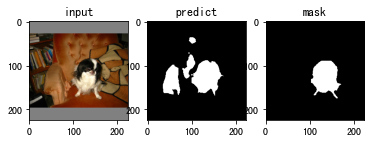

Epoch 1/1:  45%|████▍     | 655/1470 [22:41<27:46,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_120.png'] : tensor(0.9677)
/openbayes/input/input3/test_image/japanese_chin_120.png
hd: 15.0
jc: 0.9374284624189241
sc: 0.9741785200971403
sp: 0.9736324544151471


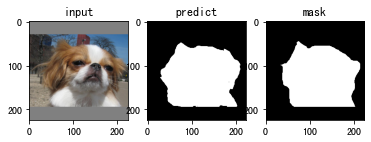

Epoch 1/1:  45%|████▍     | 656/1470 [22:43<27:48,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_123.png'] : tensor(0.9454)
/openbayes/input/input3/test_image/japanese_chin_123.png
hd: 12.206555615733702
jc: 0.8965132256956372
sc: 0.9278286374544485
sp: 0.9899036608863199


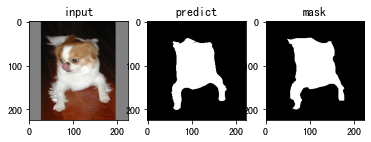

Epoch 1/1:  45%|████▍     | 657/1470 [22:45<28:05,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_13.png'] : tensor(0.9308)
/openbayes/input/input3/test_image/japanese_chin_13.png
hd: 31.622776601683793
jc: 0.8706027335872731
sc: 0.955960142698979
sp: 0.9072860521927953


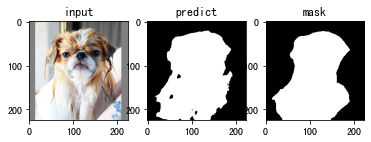

Epoch 1/1:  45%|████▍     | 658/1470 [22:48<28:16,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_142.png'] : tensor(0.9364)
/openbayes/input/input3/test_image/japanese_chin_142.png
hd: 47.16990566028302
jc: 0.8804246504401865
sc: 0.8928627698125099
sp: 0.9913602055564478


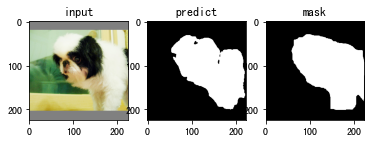

Epoch 1/1:  45%|████▍     | 659/1470 [22:50<29:30,  2.18s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_149.png'] : tensor(0.9511)
/openbayes/input/input3/test_image/japanese_chin_149.png
hd: 25.079872407968907
jc: 0.9067225214442449
sc: 0.9674769060491252
sp: 0.9410155518081319


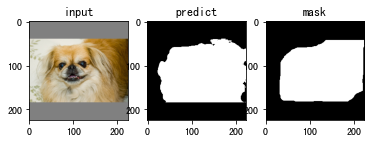

Epoch 1/1:  45%|████▍     | 660/1470 [22:52<29:42,  2.20s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_153.png'] : tensor(0.7084)
/openbayes/input/input3/test_image/japanese_chin_153.png
hd: 131.24404748406687
jc: 0.548474801061008
sc: 0.9904203089450365
sp: 0.8391153616258219


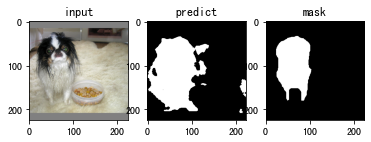

Epoch 1/1:  45%|████▍     | 661/1470 [22:55<30:07,  2.23s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_157.png'] : tensor(0.8845)
/openbayes/input/input3/test_image/japanese_chin_157.png
hd: 28.160255680657446
jc: 0.7928489321798052
sc: 0.9182315022421524
sp: 0.9371379233511586


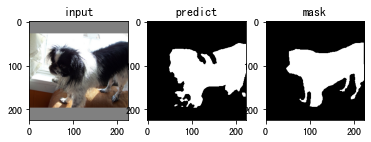

Epoch 1/1:  45%|████▌     | 662/1470 [22:57<29:27,  2.19s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_161.png'] : tensor(0.9590)
/openbayes/input/input3/test_image/japanese_chin_161.png
hd: 29.0
jc: 0.9212298950648399
sc: 0.9914681659022538
sp: 0.9482925850362889


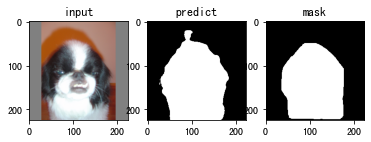

Epoch 1/1:  45%|████▌     | 663/1470 [22:59<29:35,  2.20s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_17.png'] : tensor(0.9496)
/openbayes/input/input3/test_image/japanese_chin_17.png
hd: 13.341664064126334
jc: 0.9041123572799838
sc: 0.9354939884997386
sp: 0.9918248750338579


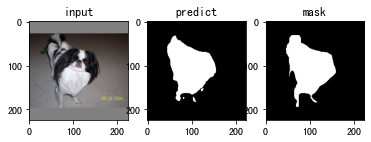

Epoch 1/1:  45%|████▌     | 664/1470 [23:01<29:15,  2.18s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_171.png'] : tensor(0.9678)
/openbayes/input/input3/test_image/japanese_chin_171.png
hd: 13.0
jc: 0.9376637963309622
sc: 0.9649857920339064
sp: 0.979430863903716


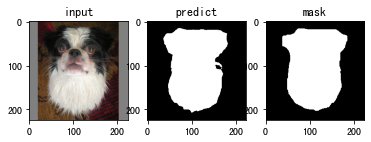

Epoch 1/1:  45%|████▌     | 665/1470 [23:03<28:37,  2.13s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_173.png'] : tensor(0.9093)
/openbayes/input/input3/test_image/japanese_chin_173.png
hd: 23.345235059857504
jc: 0.8336794225254622
sc: 0.9071443942328384
sp: 0.979966733525757


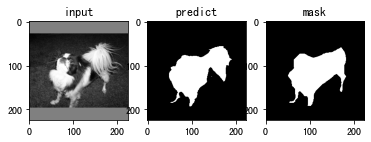

Epoch 1/1:  45%|████▌     | 666/1470 [23:05<28:50,  2.15s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_181.png'] : tensor(0.8119)
/openbayes/input/input3/test_image/japanese_chin_181.png
hd: 81.27115109311545
jc: 0.6833232992173389
sc: 0.791492329149233
sp: 0.9851549897545451


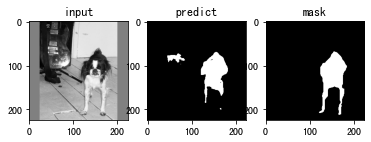

Epoch 1/1:  45%|████▌     | 667/1470 [23:07<27:41,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_186.png'] : tensor(0.9206)
/openbayes/input/input3/test_image/japanese_chin_186.png
hd: 30.0
jc: 0.8529202048356777
sc: 0.8744019138755981
sp: 0.9892108859029833


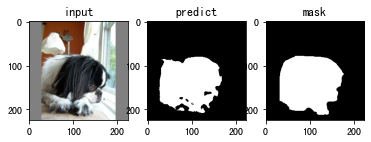

Epoch 1/1:  45%|████▌     | 668/1470 [23:09<27:38,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_195.png'] : tensor(0.9049)
/openbayes/input/input3/test_image/japanese_chin_195.png
hd: 28.0
jc: 0.8262926220353459
sc: 0.9447866586538461
sp: 0.9482150607638888


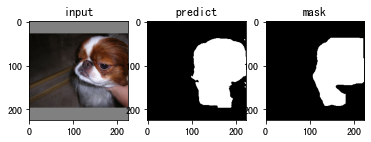

Epoch 1/1:  46%|████▌     | 669/1470 [23:11<27:40,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_198.png'] : tensor(0.8911)
/openbayes/input/input3/test_image/japanese_chin_198.png
hd: 33.0
jc: 0.8036009002250563
sc: 0.9256026959301823
sp: 0.9544854026889101


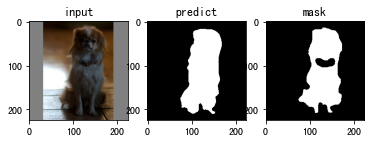

Epoch 1/1:  46%|████▌     | 670/1470 [23:13<27:49,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_21.png'] : tensor(0.9616)
/openbayes/input/input3/test_image/japanese_chin_21.png
hd: 7.0710678118654755
jc: 0.9260757314974183
sc: 0.9505344050878898
sp: 0.9923047226869128


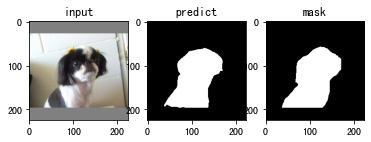

Epoch 1/1:  46%|████▌     | 671/1470 [23:15<27:31,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_26.png'] : tensor(0.8846)
/openbayes/input/input3/test_image/japanese_chin_26.png
hd: 48.54894437575342
jc: 0.7930587450922291
sc: 0.8701536210680322
sp: 0.9064528744622604


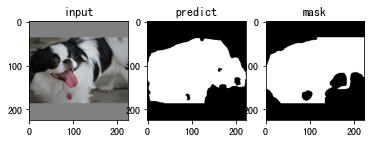

Epoch 1/1:  46%|████▌     | 672/1470 [23:17<26:57,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_30.png'] : tensor(0.8898)
/openbayes/input/input3/test_image/japanese_chin_30.png
hd: 47.29693436154187
jc: 0.8015297906602254
sc: 0.9559859154929577
sp: 0.9360934182590234


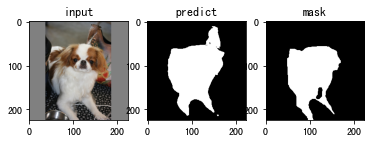

Epoch 1/1:  46%|████▌     | 673/1470 [23:19<26:33,  2.00s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_32.png'] : tensor(0.9352)
/openbayes/input/input3/test_image/japanese_chin_32.png
hd: 10.770329614269007
jc: 0.8782727895819055
sc: 0.9313853757813636
sp: 0.9903919440145968


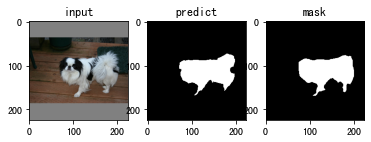

Epoch 1/1:  46%|████▌     | 674/1470 [23:21<26:34,  2.00s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_45.png'] : tensor(0.8103)
/openbayes/input/input3/test_image/japanese_chin_45.png
hd: 28.792360097775937
jc: 0.6810391730141458
sc: 0.9831140781464756
sp: 0.9498924206463634


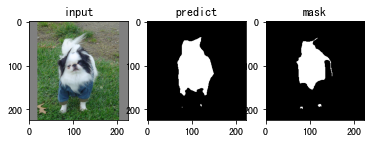

Epoch 1/1:  46%|████▌     | 675/1470 [23:23<26:20,  1.99s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_46.png'] : tensor(0.9554)
/openbayes/input/input3/test_image/japanese_chin_46.png
hd: 43.0
jc: 0.9145965494753068
sc: 0.9756506340321918
sp: 0.8862178623403223


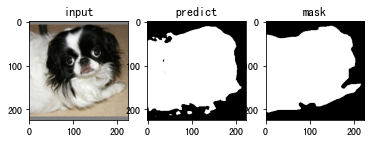

Epoch 1/1:  46%|████▌     | 676/1470 [23:25<26:13,  1.98s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_48.png'] : tensor(0.8986)
/openbayes/input/input3/test_image/japanese_chin_48.png
hd: 23.345235059857504
jc: 0.8158410665272513
sc: 0.9266627078384798
sp: 0.9789364640883977


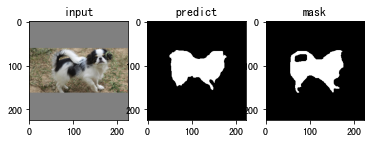

Epoch 1/1:  46%|████▌     | 677/1470 [23:27<26:53,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_51.png'] : tensor(0.9606)
/openbayes/input/input3/test_image/japanese_chin_51.png
hd: 23.345235059857504
jc: 0.9242481712273096
sc: 0.9498802695327727
sp: 0.9845432819143983


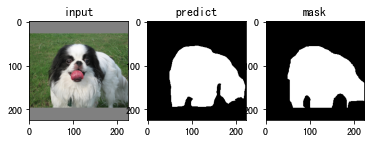

Epoch 1/1:  46%|████▌     | 678/1470 [23:29<26:46,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_56.png'] : tensor(0.9358)
/openbayes/input/input3/test_image/japanese_chin_56.png
hd: 38.0
jc: 0.8793301069791136
sc: 0.9731501057082452
sp: 0.9579280831434447


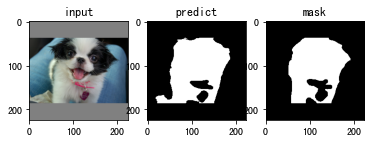

Epoch 1/1:  46%|████▌     | 679/1470 [23:31<27:04,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_57.png'] : tensor(0.8535)
/openbayes/input/input3/test_image/japanese_chin_57.png
hd: 23.706539182259394
jc: 0.7444407008086253
sc: 0.9571150097465887
sp: 0.9710485304769639


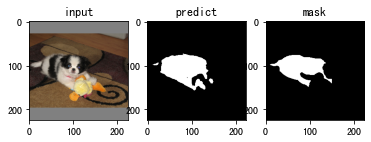

Epoch 1/1:  46%|████▋     | 680/1470 [23:34<27:37,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_61.png'] : tensor(0.6922)
/openbayes/input/input3/test_image/japanese_chin_61.png
hd: 54.817880294662984
jc: 0.5292703862660945
sc: 0.761798863355572
sp: 0.9614559171020399


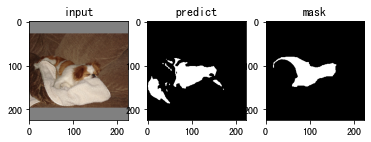

Epoch 1/1:  46%|████▋     | 681/1470 [23:36<27:41,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_67.png'] : tensor(0.9223)
/openbayes/input/input3/test_image/japanese_chin_67.png
hd: 21.095023109728988
jc: 0.8557948717948718
sc: 0.9322905027932961
sp: 0.9912474562919849


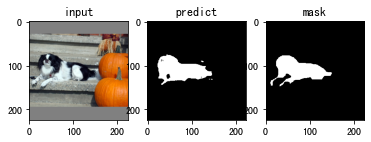

Epoch 1/1:  46%|████▋     | 682/1470 [23:38<27:56,  2.13s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_81.png'] : tensor(0.9409)
/openbayes/input/input3/test_image/japanese_chin_81.png
hd: 8.602325267042627
jc: 0.888387432737372
sc: 0.9286880783886772
sp: 0.9872299126526025


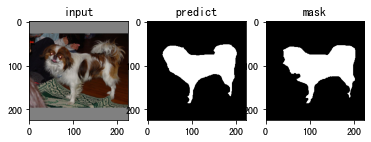

Epoch 1/1:  46%|████▋     | 683/1470 [23:40<27:23,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_84.png'] : tensor(0.8961)
/openbayes/input/input3/test_image/japanese_chin_84.png
hd: 14.866068747318506
jc: 0.811798142243172
sc: 0.8778860569715142
sp: 0.9705179715495711


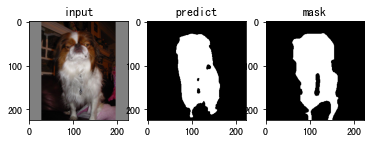

Epoch 1/1:  47%|████▋     | 684/1470 [23:42<27:23,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_85.png'] : tensor(0.9419)
/openbayes/input/input3/test_image/japanese_chin_85.png
hd: 5.0
jc: 0.8901909722222222
sc: 0.9473441108545034
sp: 0.9971048301430923


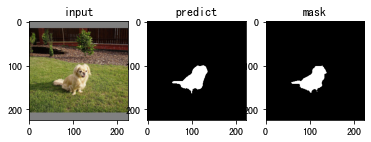

Epoch 1/1:  47%|████▋     | 685/1470 [23:44<27:13,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/japanese_chin_97.png'] : tensor(0.9658)
/openbayes/input/input3/test_image/japanese_chin_97.png
hd: 11.180339887498949
jc: 0.93377854574324
sc: 0.9625012034273611
sp: 0.9782667845724781


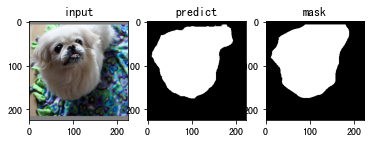

Epoch 1/1:  47%|████▋     | 686/1470 [23:46<27:08,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_100.png'] : tensor(0.9620)
/openbayes/input/input3/test_image/keeshond_100.png
hd: 14.7648230602334
jc: 0.9267488014846126
sc: 0.9607738349722104
sp: 0.9781655225019069


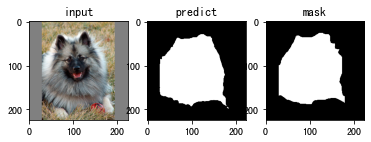

Epoch 1/1:  47%|████▋     | 687/1470 [23:48<26:32,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_114.png'] : tensor(0.9175)
/openbayes/input/input3/test_image/keeshond_114.png
hd: 35.4400902933387
jc: 0.847590006954475
sc: 0.9262788658287051
sp: 0.951982099120075


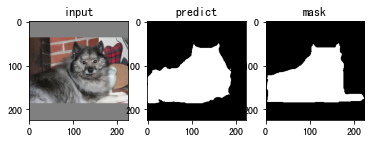

Epoch 1/1:  47%|████▋     | 688/1470 [23:50<26:48,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_118.png'] : tensor(0.9568)
/openbayes/input/input3/test_image/keeshond_118.png
hd: 13.416407864998739
jc: 0.9172583142048791
sc: 0.9795906732797446
sp: 0.963474796997089


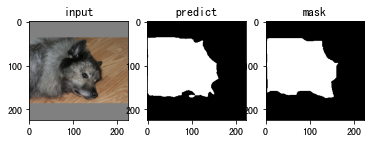

Epoch 1/1:  47%|████▋     | 689/1470 [23:52<26:49,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_119.png'] : tensor(0.9237)
/openbayes/input/input3/test_image/keeshond_119.png
hd: 15.0
jc: 0.8582724252491695
sc: 0.9079215576017432
sp: 0.9771064563687446


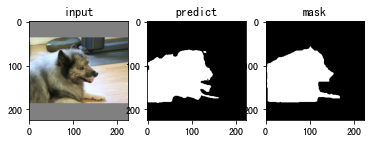

Epoch 1/1:  47%|████▋     | 690/1470 [23:54<26:36,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_120.png'] : tensor(0.9611)
/openbayes/input/input3/test_image/keeshond_120.png
hd: 8.54400374531753
jc: 0.9250777136331917
sc: 0.9739513759016831
sp: 0.9775309623906374


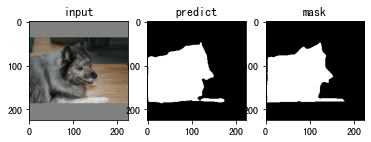

Epoch 1/1:  47%|████▋     | 691/1470 [23:56<26:36,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_124.png'] : tensor(0.9102)
/openbayes/input/input3/test_image/keeshond_124.png
hd: 25.0
jc: 0.835209667424086
sc: 0.917825322058907
sp: 0.9464598371985871


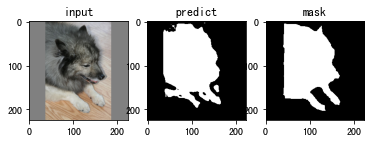

Epoch 1/1:  47%|████▋     | 692/1470 [23:58<26:43,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_127.png'] : tensor(0.9212)
/openbayes/input/input3/test_image/keeshond_127.png
hd: 15.811388300841896
jc: 0.8539010708822029
sc: 0.9468476109697483
sp: 0.9821353997494315


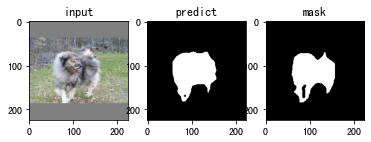

Epoch 1/1:  47%|████▋     | 693/1470 [24:01<27:02,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_130.png'] : tensor(0.8986)
/openbayes/input/input3/test_image/keeshond_130.png
hd: 21.18962010041709
jc: 0.8158834027364664
sc: 0.8877980364656382
sp: 0.9800278680910358


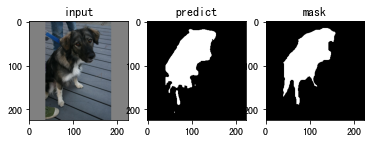

Epoch 1/1:  47%|████▋     | 694/1470 [24:03<27:03,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_141.png'] : tensor(0.9634)
/openbayes/input/input3/test_image/keeshond_141.png
hd: 23.769728648009426
jc: 0.929438982070561
sc: 0.9604781471796787
sp: 0.9878502894729689


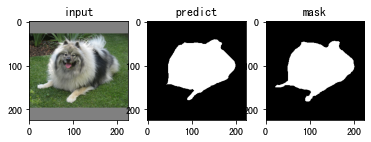

Epoch 1/1:  47%|████▋     | 695/1470 [24:05<26:29,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_143.png'] : tensor(0.9149)
/openbayes/input/input3/test_image/keeshond_143.png
hd: 13.038404810405298
jc: 0.8430684382050639
sc: 0.8769230769230769
sp: 0.9966768088733519


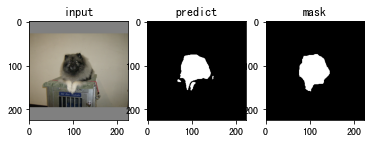

Epoch 1/1:  47%|████▋     | 696/1470 [24:07<26:40,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_144.png'] : tensor(0.9172)
/openbayes/input/input3/test_image/keeshond_144.png
hd: 36.235341863986875
jc: 0.8469913483036843
sc: 0.9334690379258624
sp: 0.9766661769746829


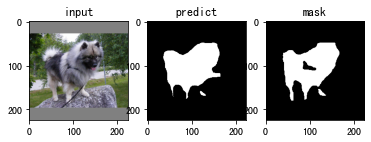

Epoch 1/1:  47%|████▋     | 697/1470 [24:09<26:16,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_173.png'] : tensor(0.9603)
/openbayes/input/input3/test_image/keeshond_173.png
hd: 9.848857801796104
jc: 0.9236577181208053
sc: 0.981234836856959
sp: 0.9580039360885954


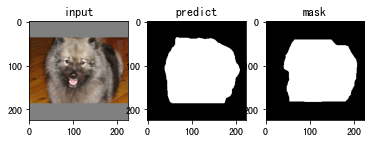

Epoch 1/1:  47%|████▋     | 698/1470 [24:11<26:13,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_175.png'] : tensor(0.9578)
/openbayes/input/input3/test_image/keeshond_175.png
hd: 11.0
jc: 0.9191038696537678
sc: 0.9557777024737377
sp: 0.9877254247889086


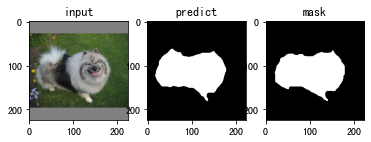

Epoch 1/1:  48%|████▊     | 699/1470 [24:13<26:34,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_176.png'] : tensor(0.9153)
/openbayes/input/input3/test_image/keeshond_176.png
hd: 21.93171219946131
jc: 0.8437993057746923
sc: 0.9354011194029851
sp: 0.9776201923076923


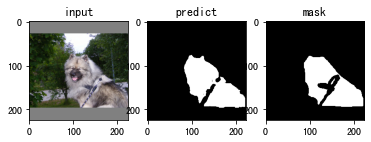

Epoch 1/1:  48%|████▊     | 700/1470 [24:15<26:23,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_178.png'] : tensor(0.9261)
/openbayes/input/input3/test_image/keeshond_178.png
hd: 24.596747752497688
jc: 0.8623384003409575
sc: 0.9255870692284233
sp: 0.9889724425695814


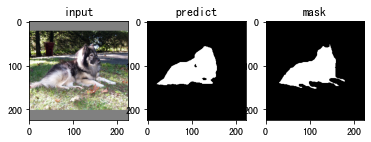

Epoch 1/1:  48%|████▊     | 701/1470 [24:17<26:48,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_183.png'] : tensor(0.8735)
/openbayes/input/input3/test_image/keeshond_183.png
hd: 24.186773244895647
jc: 0.7753503709810388
sc: 0.9861074705111402
sp: 0.9776320614309442


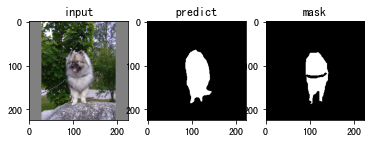

Epoch 1/1:  48%|████▊     | 702/1470 [24:19<26:29,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_184.png'] : tensor(0.9346)
/openbayes/input/input3/test_image/keeshond_184.png
hd: 19.4164878389476
jc: 0.8773164351766569
sc: 0.9612869368642015
sp: 0.9066682412218549


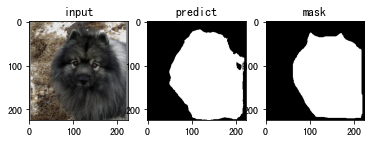

Epoch 1/1:  48%|████▊     | 703/1470 [24:21<26:45,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_188.png'] : tensor(0.8787)
/openbayes/input/input3/test_image/keeshond_188.png
hd: 45.221676218380054
jc: 0.7836041358936484
sc: 0.8495319044099532
sp: 0.959752504419564


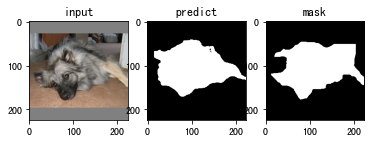

Epoch 1/1:  48%|████▊     | 704/1470 [24:23<26:27,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_191.png'] : tensor(0.9256)
/openbayes/input/input3/test_image/keeshond_191.png
hd: 19.849433241279208
jc: 0.8614292411760767
sc: 0.9495053890447365
sp: 0.9621894621894622


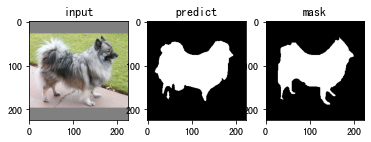

Epoch 1/1:  48%|████▊     | 705/1470 [24:25<26:06,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_194.png'] : tensor(0.8938)
/openbayes/input/input3/test_image/keeshond_194.png
hd: 33.015148038438355
jc: 0.8079922027290448
sc: 0.9211679733316871
sp: 0.9332195308591106


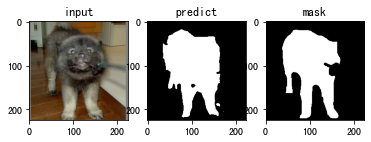

Epoch 1/1:  48%|████▊     | 706/1470 [24:27<25:27,  2.00s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_200.png'] : tensor(0.9380)
/openbayes/input/input3/test_image/keeshond_200.png
hd: 16.1245154965971
jc: 0.8833055323881012
sc: 0.9826799659785046
sp: 0.9609322557259082


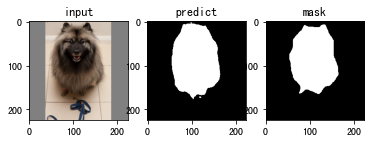

Epoch 1/1:  48%|████▊     | 707/1470 [24:29<25:42,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_22.png'] : tensor(0.9560)
/openbayes/input/input3/test_image/keeshond_22.png
hd: 28.231188426986208
jc: 0.9157889079965607
sc: 0.9582208726945569
sp: 0.9745616201531242


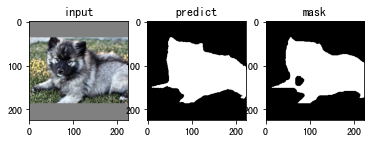

Epoch 1/1:  48%|████▊     | 708/1470 [24:31<25:31,  2.01s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_27.png'] : tensor(0.9562)
/openbayes/input/input3/test_image/keeshond_27.png
hd: 7.810249675906654
jc: 0.9160995917060284
sc: 0.9386432614223608
sp: 0.9921021455837831


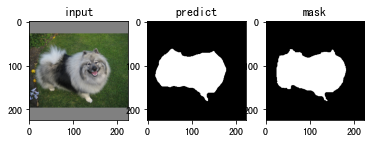

Epoch 1/1:  48%|████▊     | 709/1470 [24:33<26:16,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_34.png'] : tensor(0.9433)
/openbayes/input/input3/test_image/keeshond_34.png
hd: 18.0
jc: 0.8927206116597642
sc: 0.9308640950047752
sp: 0.9605641359751658


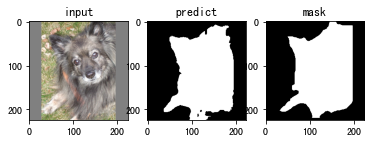

Epoch 1/1:  48%|████▊     | 710/1470 [24:35<25:40,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_35.png'] : tensor(0.9545)
/openbayes/input/input3/test_image/keeshond_35.png
hd: 11.0
jc: 0.9129851362510322
sc: 0.9199167966718669
sp: 0.9982002416114001


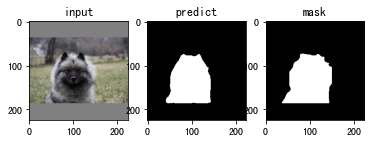

Epoch 1/1:  48%|████▊     | 711/1470 [24:37<25:34,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_40.png'] : tensor(0.6962)
/openbayes/input/input3/test_image/keeshond_40.png
hd: 19.1049731745428
jc: 0.5339830725827135
sc: 0.8682235195996664
sp: 0.9685838670517811


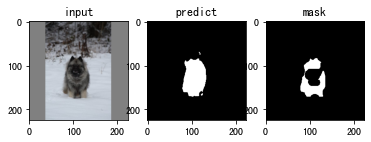

Epoch 1/1:  48%|████▊     | 712/1470 [24:39<25:34,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_5.png'] : tensor(0.9417)
/openbayes/input/input3/test_image/keeshond_5.png
hd: 16.55294535724685
jc: 0.8898767188240873
sc: 0.9596062891473859
sp: 0.9855264089910987


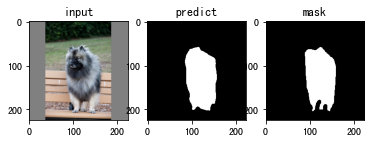

Epoch 1/1:  49%|████▊     | 713/1470 [24:41<25:37,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_52.png'] : tensor(0.9743)
/openbayes/input/input3/test_image/keeshond_52.png
hd: 12.0
jc: 0.9499689247980112
sc: 0.9723724269550598
sp: 0.9815754907877454


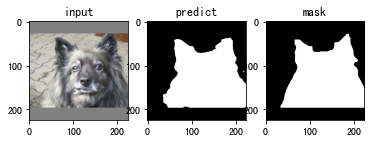

Epoch 1/1:  49%|████▊     | 714/1470 [24:43<25:40,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_53.png'] : tensor(0.9486)
/openbayes/input/input3/test_image/keeshond_53.png
hd: 27.85677655436824
jc: 0.9022513536620119
sc: 0.9437599364069952
sp: 0.9304943955164131


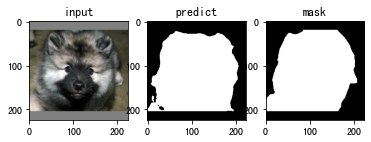

Epoch 1/1:  49%|████▊     | 715/1470 [24:46<25:37,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_57.png'] : tensor(0.8923)
/openbayes/input/input3/test_image/keeshond_57.png
hd: 71.69379331573968
jc: 0.8055650979045001
sc: 0.9834346823233382
sp: 0.9768097429911687


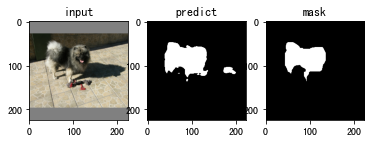

Epoch 1/1:  49%|████▊     | 716/1470 [24:47<25:18,  2.01s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_64.png'] : tensor(0.8723)
/openbayes/input/input3/test_image/keeshond_64.png
hd: 36.76955262170047
jc: 0.7734509466437177
sc: 0.8524007113218731
sp: 0.9793727989267147


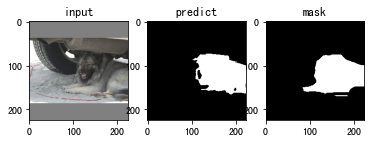

Epoch 1/1:  49%|████▉     | 717/1470 [24:50<25:34,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_65.png'] : tensor(0.9612)
/openbayes/input/input3/test_image/keeshond_65.png
hd: 40.607881008493905
jc: 0.9253067047075606
sc: 0.9787542250120714
sp: 0.9715246369911926


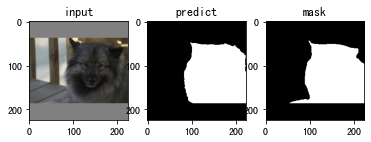

Epoch 1/1:  49%|████▉     | 718/1470 [24:52<25:34,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_67.png'] : tensor(0.9379)
/openbayes/input/input3/test_image/keeshond_67.png
hd: 17.69180601295413
jc: 0.8830372081905824
sc: 0.9455677843187441
sp: 0.9784163307762319


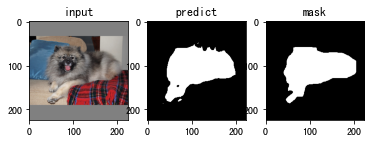

Epoch 1/1:  49%|████▉     | 719/1470 [24:54<26:11,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_68.png'] : tensor(0.9654)
/openbayes/input/input3/test_image/keeshond_68.png
hd: 17.029386365926403
jc: 0.9330279945786792
sc: 0.9484986697073357
sp: 0.988018401538039


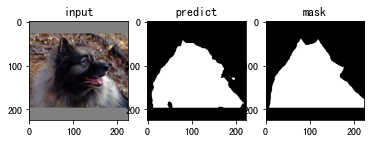

Epoch 1/1:  49%|████▉     | 720/1470 [24:56<25:46,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_70.png'] : tensor(0.9271)
/openbayes/input/input3/test_image/keeshond_70.png
hd: 13.152946437965905
jc: 0.864029255319149
sc: 0.9712257100149477
sp: 0.976368985479738


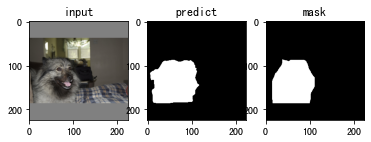

Epoch 1/1:  49%|████▉     | 721/1470 [24:58<25:19,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_73.png'] : tensor(0.9350)
/openbayes/input/input3/test_image/keeshond_73.png
hd: 24.596747752497688
jc: 0.8779941643482392
sc: 0.9285252960172228
sp: 0.9778703678154577


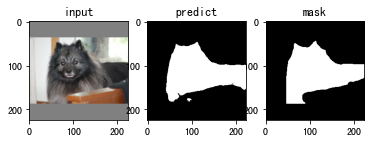

Epoch 1/1:  49%|████▉     | 722/1470 [25:00<25:18,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_79.png'] : tensor(0.9425)
/openbayes/input/input3/test_image/keeshond_79.png
hd: 25.495097567963924
jc: 0.8911748781808337
sc: 0.9140382052421147
sp: 0.9943893908481493


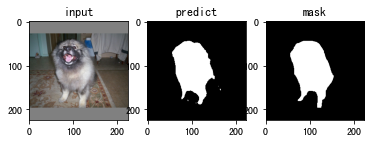

Epoch 1/1:  49%|████▉     | 723/1470 [25:02<25:54,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/keeshond_80.png'] : tensor(0.9390)
/openbayes/input/input3/test_image/keeshond_80.png
hd: 35.77708763999664
jc: 0.8850812407680946
sc: 0.9494031900285201
sp: 0.9830995602937925


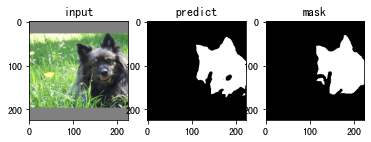

Epoch 1/1:  49%|████▉     | 724/1470 [25:04<25:31,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/keeshond_81.png'] : tensor(0.9655)
/openbayes/input/input3/test_image/keeshond_81.png
hd: 19.0
jc: 0.9333436277537575
sc: 0.9515138794143884
sp: 0.9880780230727209


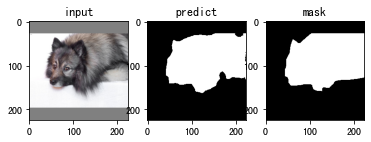

Epoch 1/1:  49%|████▉     | 725/1470 [25:06<25:54,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/keeshond_82.png'] : tensor(0.9353)
/openbayes/input/input3/test_image/keeshond_82.png
hd: 14.866068747318506
jc: 0.8785007546536978
sc: 0.9264302767707135
sp: 0.9841253505544549


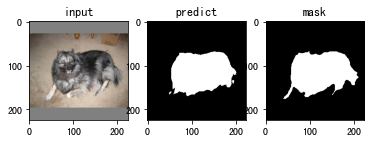

Epoch 1/1:  49%|████▉     | 726/1470 [25:08<25:28,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/keeshond_84.png'] : tensor(0.9550)
/openbayes/input/input3/test_image/keeshond_84.png
hd: 23.0
jc: 0.9139000761946229
sc: 0.925026166473861
sp: 0.9930987103019705


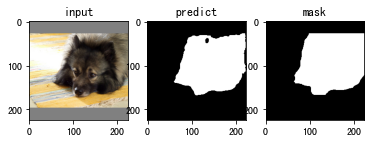

Epoch 1/1:  49%|████▉     | 727/1470 [25:10<25:53,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/keeshond_88.png'] : tensor(0.9460)
/openbayes/input/input3/test_image/keeshond_88.png
hd: 28.442925306655784
jc: 0.8974795417348609
sc: 0.93557633249164
sp: 0.982490217605495


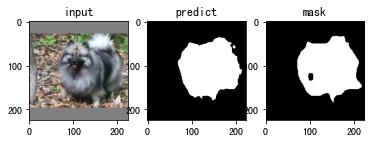

Epoch 1/1:  50%|████▉     | 728/1470 [25:12<25:31,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/keeshond_91.png'] : tensor(0.9337)
/openbayes/input/input3/test_image/keeshond_91.png
hd: 8.54400374531753
jc: 0.8757072802715956
sc: 0.896159042655858
sp: 0.9973108123124792


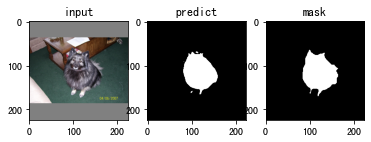

Epoch 1/1:  50%|████▉     | 729/1470 [25:14<25:11,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/keeshond_94.png'] : tensor(0.9537)
/openbayes/input/input3/test_image/keeshond_94.png
hd: 13.341664064126334
jc: 0.9115843270868824
sc: 0.9733338183934808
sp: 0.9179301833568406


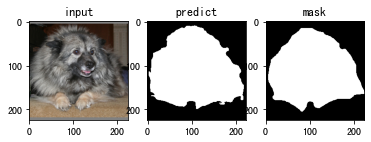

Epoch 1/1:  50%|████▉     | 730/1470 [25:16<25:30,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/keeshond_98.png'] : tensor(0.9373)
/openbayes/input/input3/test_image/keeshond_98.png
hd: 21.93171219946131
jc: 0.8819188191881919
sc: 0.947400518371703
sp: 0.9888346286998189


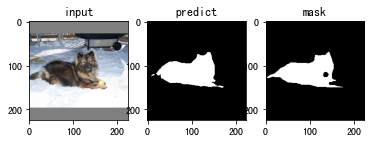

Epoch 1/1:  50%|████▉     | 731/1470 [25:18<25:02,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/keeshond_99.png'] : tensor(0.9564)
/openbayes/input/input3/test_image/keeshond_99.png
hd: 7.0
jc: 0.9164022842639594
sc: 0.9779922126290841
sp: 0.9793024347010062


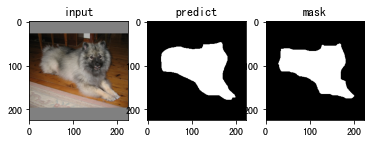

Epoch 1/1:  50%|████▉     | 732/1470 [25:20<25:11,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_10.png'] : tensor(0.7718)
/openbayes/input/input3/test_image/leonberger_10.png
hd: 24.596747752497688
jc: 0.6283430679372887
sc: 0.8992520897492301
sp: 0.9570458031996494


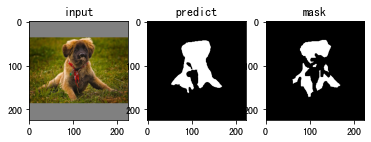

Epoch 1/1:  50%|████▉     | 733/1470 [25:22<24:42,  2.01s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_101.png'] : tensor(0.8445)
/openbayes/input/input3/test_image/leonberger_101.png
hd: 18.0
jc: 0.7308050979173143
sc: 0.9588091353996737
sp: 0.9839703293940156


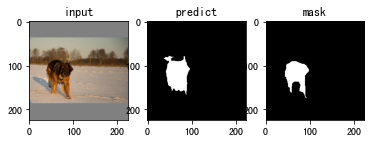

Epoch 1/1:  50%|████▉     | 734/1470 [25:24<24:55,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_104.png'] : tensor(0.9236)
/openbayes/input/input3/test_image/leonberger_104.png
hd: 17.0
jc: 0.8580198331496931
sc: 0.8831821127673364
sp: 0.9958867375693119


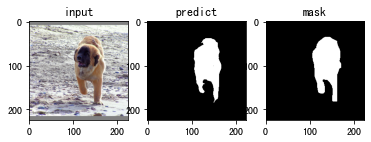

Epoch 1/1:  50%|█████     | 735/1470 [25:27<25:07,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_108.png'] : tensor(0.9495)
/openbayes/input/input3/test_image/leonberger_108.png
hd: 47.0
jc: 0.9038514754345802
sc: 0.9452015153109544
sp: 0.8570371588293324


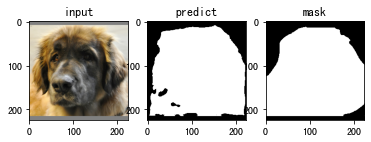

Epoch 1/1:  50%|█████     | 736/1470 [25:29<25:31,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_11.png'] : tensor(0.7412)
/openbayes/input/input3/test_image/leonberger_11.png
hd: 12.36931687685298
jc: 0.5887681159420289
sc: 0.8891928864569083
sp: 0.9924562645363535


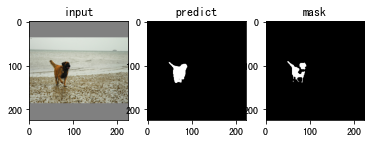

Epoch 1/1:  50%|█████     | 737/1470 [25:31<25:25,  2.08s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_113.png'] : tensor(0.9533)
/openbayes/input/input3/test_image/leonberger_113.png
hd: 11.661903789690601
jc: 0.9107806691449815
sc: 0.9549102025219717
sp: 0.9829069046399396


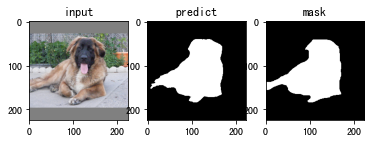

Epoch 1/1:  50%|█████     | 738/1470 [25:33<25:07,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_117.png'] : tensor(0.8751)
/openbayes/input/input3/test_image/leonberger_117.png
hd: 28.635642126552707
jc: 0.7779861241327582
sc: 0.808614305203664
sp: 0.98257769600092


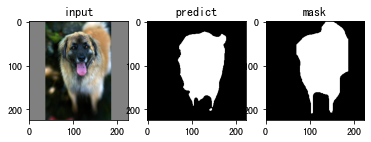

Epoch 1/1:  50%|█████     | 739/1470 [25:35<24:50,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_124.png'] : tensor(0.9311)
/openbayes/input/input3/test_image/leonberger_124.png
hd: 14.866068747318506
jc: 0.8711512978408293
sc: 0.9646957272334916
sp: 0.9677645046772564


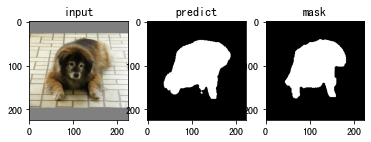

Epoch 1/1:  50%|█████     | 740/1470 [25:37<25:01,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_126.png'] : tensor(0.9399)
/openbayes/input/input3/test_image/leonberger_126.png
hd: 41.773197148410844
jc: 0.8865499513686258
sc: 0.930644690781797
sp: 0.9812966213251426


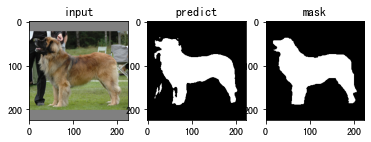

Epoch 1/1:  50%|█████     | 741/1470 [25:39<25:43,  2.12s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_127.png'] : tensor(0.9556)
/openbayes/input/input3/test_image/leonberger_127.png
hd: 14.035668847618199
jc: 0.9149187359804809
sc: 0.9507238079659769
sp: 0.9627944949848379


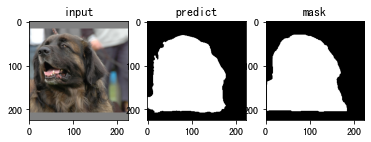

Epoch 1/1:  50%|█████     | 742/1470 [25:41<25:51,  2.13s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_128.png'] : tensor(0.5616)
/openbayes/input/input3/test_image/leonberger_128.png
hd: 139.43457247038842
jc: 0.3903991850767174
sc: 0.8835734870317002
sp: 0.7972291608844482


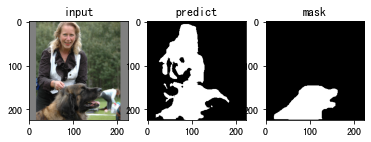

Epoch 1/1:  51%|█████     | 743/1470 [25:43<25:30,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/leonberger_135.png'] : tensor(0.9593)
/openbayes/input/input3/test_image/leonberger_135.png
hd: 14.317821063276353
jc: 0.9217665031015647
sc: 0.9832600859216829
sp: 0.9548538011695906


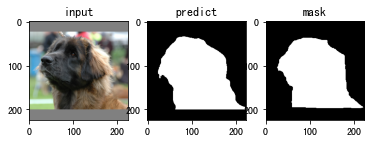

Epoch 1/1:  51%|█████     | 744/1470 [25:45<25:12,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/leonberger_14.png'] : tensor(0.9111)
/openbayes/input/input3/test_image/leonberger_14.png
hd: 45.0
jc: 0.8367839569213629
sc: 0.8603200865442744
sp: 0.9528457886595189


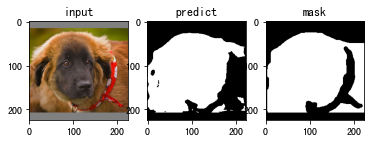

Epoch 1/1:  51%|█████     | 745/1470 [25:48<25:20,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/leonberger_145.png'] : tensor(0.8934)
/openbayes/input/input3/test_image/leonberger_145.png
hd: 12.36931687685298
jc: 0.8072585605905269
sc: 0.9376041914741605
sp: 0.9852534963133741


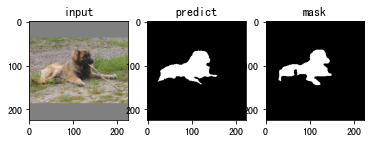

Epoch 1/1:  51%|█████     | 746/1470 [25:49<24:48,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/leonberger_160.png'] : tensor(0.9649)
/openbayes/input/input3/test_image/leonberger_160.png
hd: 21.37755832643195
jc: 0.9320887703590818
sc: 0.9772318753744758
sp: 0.9678253947193843


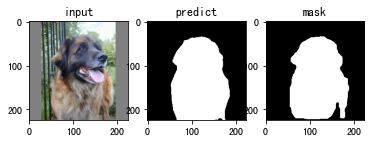

Epoch 1/1:  51%|█████     | 747/1470 [25:52<25:25,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/leonberger_163.png'] : tensor(0.9517)
/openbayes/input/input3/test_image/leonberger_163.png
hd: 25.0
jc: 0.9079260741164142
sc: 0.9482141080489503
sp: 0.9703398284232227


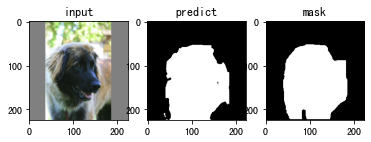

Epoch 1/1:  51%|█████     | 748/1470 [25:54<25:14,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/leonberger_165.png'] : tensor(0.9647)
/openbayes/input/input3/test_image/leonberger_165.png
hd: 4.47213595499958
jc: 0.9317288216370785
sc: 0.9473046638400969
sp: 0.9967080937954724


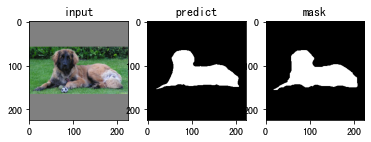

Epoch 1/1:  51%|█████     | 749/1470 [25:56<25:01,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/leonberger_177.png'] : tensor(0.9545)
/openbayes/input/input3/test_image/leonberger_177.png
hd: 7.615773105863909
jc: 0.9129893749401742
sc: 0.9655800769386516
sp: 0.9858801925653878


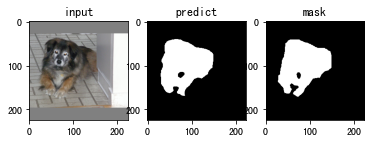

Epoch 1/1:  51%|█████     | 750/1470 [25:58<25:12,  2.10s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_185.png'] : tensor(0.9501)
/openbayes/input/input3/test_image/leonberger_185.png
hd: 15.811388300841896
jc: 0.9048947704081632
sc: 0.9419917012448132
sp: 0.9870429628075329


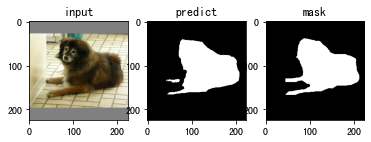

Epoch 1/1:  51%|█████     | 751/1470 [26:00<25:11,  2.10s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_19.png'] : tensor(0.9615)
/openbayes/input/input3/test_image/leonberger_19.png
hd: 7.810249675906654
jc: 0.9258617369535914
sc: 0.9463635468949907
sp: 0.9943771085842809


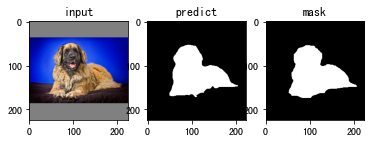

Epoch 1/1:  51%|█████     | 752/1470 [26:02<24:51,  2.08s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_191.png'] : tensor(0.9353)
/openbayes/input/input3/test_image/leonberger_191.png
hd: 17.46424919657298
jc: 0.8785175017158545
sc: 0.953090096798213
sp: 0.964579272942971


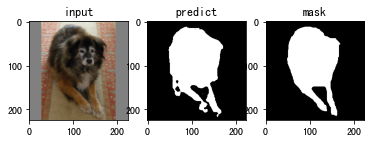

Epoch 1/1:  51%|█████     | 753/1470 [26:04<24:58,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_195.png'] : tensor(0.9519)
/openbayes/input/input3/test_image/leonberger_195.png
hd: 12.041594578792296
jc: 0.9082376526334973
sc: 0.947163356457284
sp: 0.9886263334426146


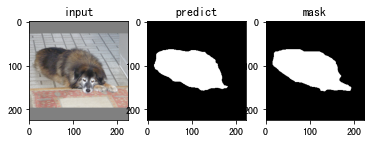

Epoch 1/1:  51%|█████▏    | 754/1470 [26:06<24:09,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_200.png'] : tensor(0.9203)
/openbayes/input/input3/test_image/leonberger_200.png
hd: 10.295630140987
jc: 0.8523688663282571
sc: 0.9916338582677166
sp: 0.9856002775850105


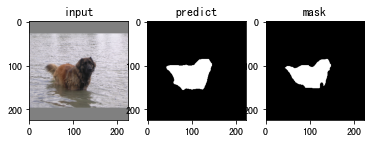

Epoch 1/1:  51%|█████▏    | 755/1470 [26:08<24:02,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_25.png'] : tensor(0.9671)
/openbayes/input/input3/test_image/leonberger_25.png
hd: 12.649110640673518
jc: 0.9363004172461753
sc: 0.9554357082032359
sp: 0.9889438285064955


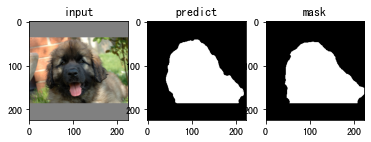

Epoch 1/1:  51%|█████▏    | 756/1470 [26:10<24:45,  2.08s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_28.png'] : tensor(0.9573)
/openbayes/input/input3/test_image/leonberger_28.png
hd: 24.0
jc: 0.918114774942782
sc: 0.978940708604483
sp: 0.9812589486602578


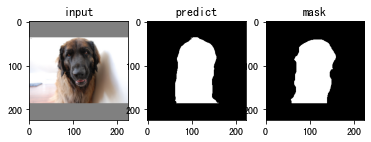

Epoch 1/1:  51%|█████▏    | 757/1470 [26:13<25:15,  2.13s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_29.png'] : tensor(0.9620)
/openbayes/input/input3/test_image/leonberger_29.png
hd: 18.110770276274835
jc: 0.926810595620885
sc: 0.9687900128040973
sp: 0.9849787685774947


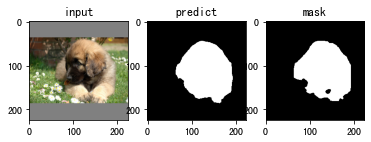

Epoch 1/1:  52%|█████▏    | 758/1470 [26:15<25:04,  2.11s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_34.png'] : tensor(0.9034)
/openbayes/input/input3/test_image/leonberger_34.png
hd: 24.0
jc: 0.8238228252194733
sc: 0.925162446784674
sp: 0.9879902872268282


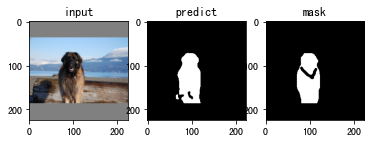

Epoch 1/1:  52%|█████▏    | 759/1470 [26:17<24:26,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_45.png'] : tensor(0.9739)
/openbayes/input/input3/test_image/leonberger_45.png
hd: 47.0
jc: 0.9491182605397889
sc: 0.9820797907128842
sp: 0.9847789944390299


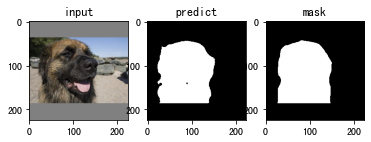

Epoch 1/1:  52%|█████▏    | 760/1470 [26:19<24:08,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_56.png'] : tensor(0.9272)
/openbayes/input/input3/test_image/leonberger_56.png
hd: 20.591260281974
jc: 0.8642728904847397
sc: 0.9178265014299333
sp: 0.9927666866973804


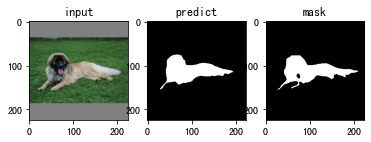

Epoch 1/1:  52%|█████▏    | 761/1470 [26:21<24:01,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_66.png'] : tensor(0.9592)
/openbayes/input/input3/test_image/leonberger_66.png
hd: 25.942243542145693
jc: 0.9216888784054723
sc: 0.9769971246405801
sp: 0.9449940792238053


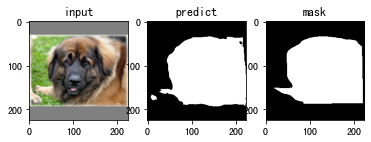

Epoch 1/1:  52%|█████▏    | 762/1470 [26:23<23:53,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_69.png'] : tensor(0.8722)
/openbayes/input/input3/test_image/leonberger_69.png
hd: 25.553864678361276
jc: 0.7733828996282528
sc: 0.9654724336365323
sp: 0.9701265935832459


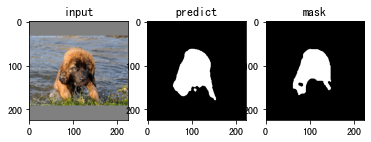

Epoch 1/1:  52%|█████▏    | 763/1470 [26:25<24:01,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_71.png'] : tensor(0.8990)
/openbayes/input/input3/test_image/leonberger_71.png
hd: 46.04345773288535
jc: 0.8165350144311104
sc: 0.9509929674023619
sp: 0.8649472195015779


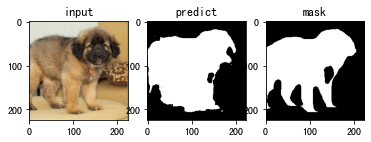

Epoch 1/1:  52%|█████▏    | 764/1470 [26:27<24:00,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_73.png'] : tensor(0.9152)
/openbayes/input/input3/test_image/leonberger_73.png
hd: 15.652475842498529
jc: 0.8437282633897519
sc: 0.9543666404405979
sp: 0.9892155382524859


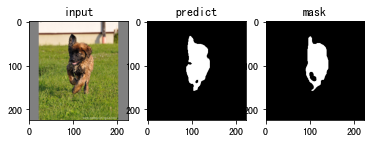

Epoch 1/1:  52%|█████▏    | 765/1470 [26:29<23:44,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_8.png'] : tensor(0.9050)
/openbayes/input/input3/test_image/leonberger_8.png
hd: 28.844410203711913
jc: 0.8265493215988265
sc: 0.9939367214199096
sp: 0.9553095730446418


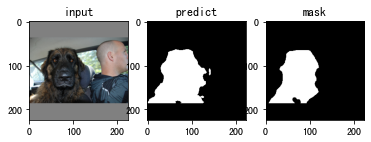

Epoch 1/1:  52%|█████▏    | 766/1470 [26:31<24:20,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_80.png'] : tensor(0.9130)
/openbayes/input/input3/test_image/leonberger_80.png
hd: 13.892443989449804
jc: 0.8398533007334963
sc: 0.8953084274543874
sp: 0.9933292372509436


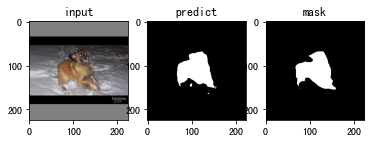

Epoch 1/1:  52%|█████▏    | 767/1470 [26:33<24:02,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_84.png'] : tensor(0.9341)
/openbayes/input/input3/test_image/leonberger_84.png
hd: 12.649110640673518
jc: 0.8763633590115171
sc: 0.9003996551994358
sp: 0.990645463049579


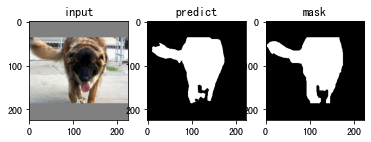

Epoch 1/1:  52%|█████▏    | 768/1470 [26:35<23:42,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_88.png'] : tensor(0.9257)
/openbayes/input/input3/test_image/leonberger_88.png
hd: 11.180339887498949
jc: 0.861606746560142
sc: 0.9170445956160241
sp: 0.9827995554657507


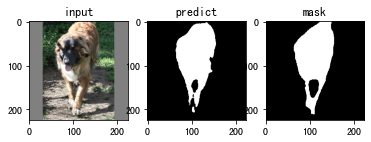

Epoch 1/1:  52%|█████▏    | 769/1470 [26:37<23:30,  2.01s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_90.png'] : tensor(0.9585)
/openbayes/input/input3/test_image/leonberger_90.png
hd: 9.219544457292887
jc: 0.9203620544484985
sc: 0.9718455953174779
sp: 0.9794160146132664


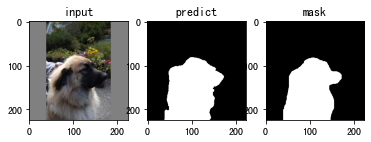

Epoch 1/1:  52%|█████▏    | 770/1470 [26:39<23:36,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_94.png'] : tensor(0.8584)
/openbayes/input/input3/test_image/leonberger_94.png
hd: 18.0
jc: 0.7519319938176198
sc: 0.9798590130916415
sp: 0.9808674280144924


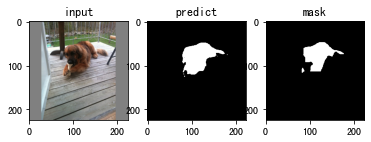

Epoch 1/1:  52%|█████▏    | 771/1470 [26:41<23:34,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_97.png'] : tensor(0.9566)
/openbayes/input/input3/test_image/leonberger_97.png
hd: 15.231546211727817
jc: 0.9167409387997624
sc: 0.973499487341273
sp: 0.9790649918660159


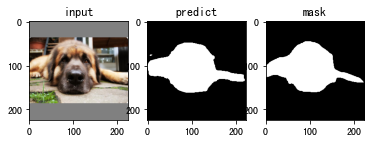

Epoch 1/1:  53%|█████▎    | 772/1470 [26:43<23:45,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/leonberger_99.png'] : tensor(0.8851)
/openbayes/input/input3/test_image/leonberger_99.png
hd: 16.278820596099706
jc: 0.7938494546754872
sc: 0.9154639175257732
sp: 0.9836076424127432


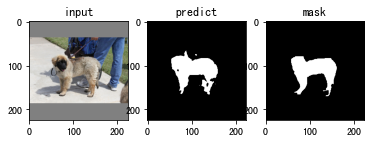

Epoch 1/1:  53%|█████▎    | 773/1470 [26:45<24:26,  2.10s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_101.png'] : tensor(0.8785)
/openbayes/input/input3/test_image/Maine_Coon_101.png
hd: 27.65863337187866
jc: 0.7833375156838143
sc: 0.8517326057298772
sp: 0.9497660983956547


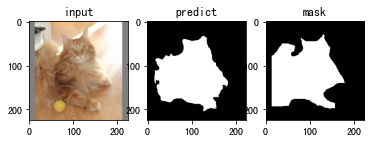

Epoch 1/1:  53%|█████▎    | 774/1470 [26:47<24:10,  2.08s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_103.png'] : tensor(0.9511)
/openbayes/input/input3/test_image/Maine_Coon_103.png
hd: 12.36931687685298
jc: 0.9067537237298511
sc: 0.960190136660725
sp: 0.9655433787070081


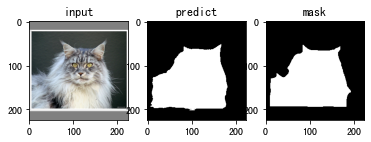

Epoch 1/1:  53%|█████▎    | 775/1470 [26:49<23:54,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_104.png'] : tensor(0.8565)
/openbayes/input/input3/test_image/Maine_Coon_104.png
hd: 21.18962010041709
jc: 0.7489795918367347
sc: 0.9728296885354539
sp: 0.9703607965125195


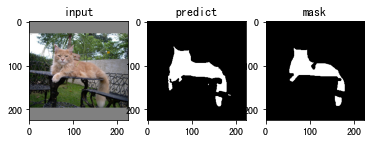

Epoch 1/1:  53%|█████▎    | 776/1470 [26:51<23:41,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_121.png'] : tensor(0.9366)
/openbayes/input/input3/test_image/Maine_Coon_121.png
hd: 13.341664064126334
jc: 0.8807720057720058
sc: 0.9692338229456133
sp: 0.988789933094067


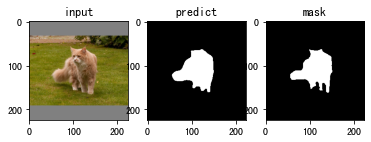

Epoch 1/1:  53%|█████▎    | 777/1470 [26:53<24:01,  2.08s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_128.png'] : tensor(0.9463)
/openbayes/input/input3/test_image/Maine_Coon_128.png
hd: 14.035668847618199
jc: 0.8981151299032094
sc: 0.9447173350004465
sp: 0.9850945380846097


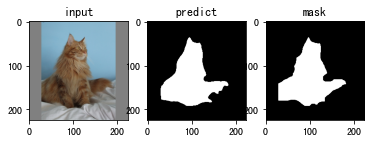

Epoch 1/1:  53%|█████▎    | 778/1470 [26:55<23:44,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_13.png'] : tensor(0.9617)
/openbayes/input/input3/test_image/Maine_Coon_13.png
hd: 57.0087712549569
jc: 0.9261660635303579
sc: 0.9487205889924316
sp: 0.9846193867264982


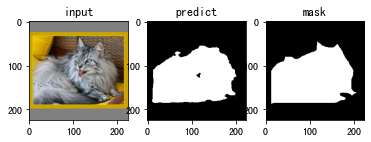

Epoch 1/1:  53%|█████▎    | 779/1470 [26:57<23:31,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_131.png'] : tensor(0.9419)
/openbayes/input/input3/test_image/Maine_Coon_131.png
hd: 8.602325267042627
jc: 0.8901724137931034
sc: 0.9462976539589443
sp: 0.9923076923076923


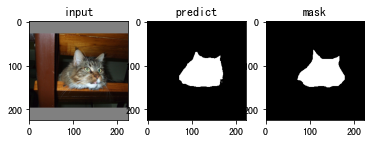

Epoch 1/1:  53%|█████▎    | 780/1470 [27:00<23:27,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_136.png'] : tensor(0.9470)
/openbayes/input/input3/test_image/Maine_Coon_136.png
hd: 9.433981132056603
jc: 0.8993112495900295
sc: 0.9632036532888382
sp: 0.9791435716311325


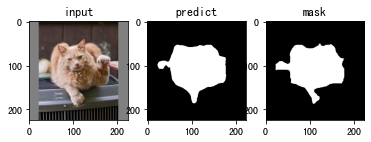

Epoch 1/1:  53%|█████▎    | 781/1470 [27:02<23:19,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_149.png'] : tensor(0.9596)
/openbayes/input/input3/test_image/Maine_Coon_149.png
hd: 9.0
jc: 0.9224070296563628
sc: 0.9592069837643795
sp: 0.9871040902977399


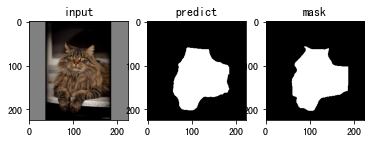

Epoch 1/1:  53%|█████▎    | 782/1470 [27:04<23:17,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_150.png'] : tensor(0.8576)
/openbayes/input/input3/test_image/Maine_Coon_150.png
hd: 8.06225774829855
jc: 0.7507062146892656
sc: 0.8576038725292456
sp: 0.9925991152483384


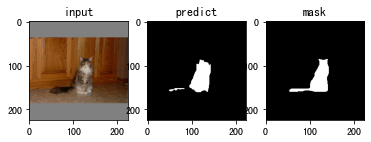

Epoch 1/1:  53%|█████▎    | 783/1470 [27:06<23:15,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_151.png'] : tensor(0.9720)
/openbayes/input/input3/test_image/Maine_Coon_151.png
hd: 45.17742799230607
jc: 0.9454680534918276
sc: 0.9656271340769406
sp: 0.9924047895775333


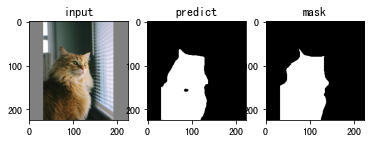

Epoch 1/1:  53%|█████▎    | 784/1470 [27:08<23:25,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_152.png'] : tensor(0.9352)
/openbayes/input/input3/test_image/Maine_Coon_152.png
hd: 18.027756377319946
jc: 0.8783236994219653
sc: 0.9899022801302931
sp: 0.9588347055098163


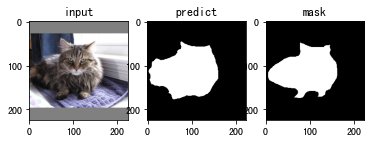

Epoch 1/1:  53%|█████▎    | 785/1470 [27:10<23:12,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_164.png'] : tensor(0.9289)
/openbayes/input/input3/test_image/Maine_Coon_164.png
hd: 14.7648230602334
jc: 0.8672260612043435
sc: 0.8918781725888325
sp: 0.9962047621199115


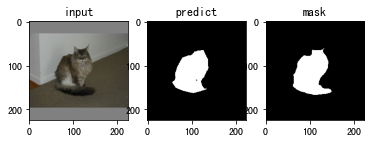

Epoch 1/1:  53%|█████▎    | 786/1470 [27:12<23:22,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_171.png'] : tensor(0.9381)
/openbayes/input/input3/test_image/Maine_Coon_171.png
hd: 18.384776310850235
jc: 0.8834417208604303
sc: 0.944511298301912
sp: 0.9878914209429234


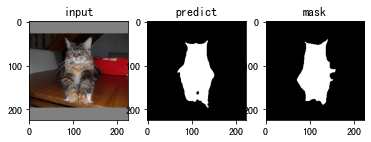

Epoch 1/1:  54%|█████▎    | 787/1470 [27:14<22:48,  2.00s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_197.png'] : tensor(0.9472)
/openbayes/input/input3/test_image/Maine_Coon_197.png
hd: 11.0
jc: 0.8997043918918919
sc: 0.9384084569079431
sp: 0.9839689226897194


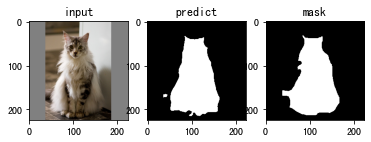

Epoch 1/1:  54%|█████▎    | 788/1470 [27:15<22:10,  1.95s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_201.png'] : tensor(0.9064)
/openbayes/input/input3/test_image/Maine_Coon_201.png
hd: 52.009614495783374
jc: 0.8287748220307232
sc: 0.9471881244647445
sp: 0.9768126013435255


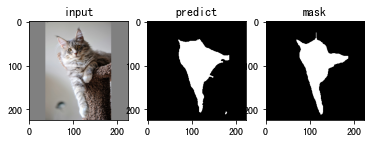

Epoch 1/1:  54%|█████▎    | 789/1470 [27:17<22:14,  1.96s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_205.png'] : tensor(0.9625)
/openbayes/input/input3/test_image/Maine_Coon_205.png
hd: 9.433981132056603
jc: 0.9277749874434957
sc: 0.9892887746358183
sp: 0.9848432908912831


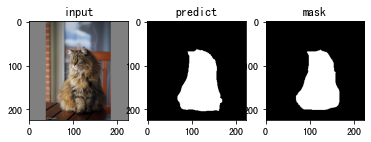

Epoch 1/1:  54%|█████▎    | 790/1470 [27:19<22:07,  1.95s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_207.png'] : tensor(0.9395)
/openbayes/input/input3/test_image/Maine_Coon_207.png
hd: 60.440052945046304
jc: 0.8858308915864378
sc: 0.9879785247432307
sp: 0.9762545664295328


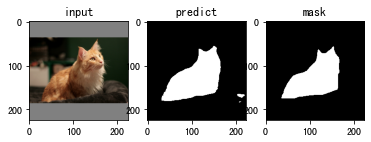

Epoch 1/1:  54%|█████▍    | 791/1470 [27:22<22:42,  2.01s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_21.png'] : tensor(0.7076)
/openbayes/input/input3/test_image/Maine_Coon_21.png
hd: 58.52349955359813
jc: 0.5475086906141368
sc: 0.9221011546592942
sp: 0.9044449996592999


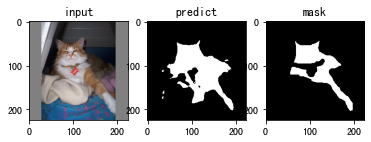

Epoch 1/1:  54%|█████▍    | 792/1470 [27:24<22:38,  2.00s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_211.png'] : tensor(0.9180)
/openbayes/input/input3/test_image/Maine_Coon_211.png
hd: 19.4164878389476
jc: 0.8484404909357054
sc: 0.9449460747429145
sp: 0.8963586501104593


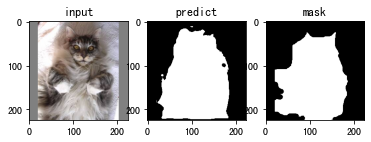

Epoch 1/1:  54%|█████▍    | 793/1470 [27:26<22:52,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_219.png'] : tensor(0.9398)
/openbayes/input/input3/test_image/Maine_Coon_219.png
hd: 26.076809620810597
jc: 0.8865204407373082
sc: 0.8952787021630616
sp: 0.9976577909270217


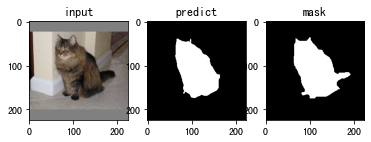

Epoch 1/1:  54%|█████▍    | 794/1470 [27:28<22:43,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_222.png'] : tensor(0.8963)
/openbayes/input/input3/test_image/Maine_Coon_222.png
hd: 25.079872407968907
jc: 0.8120743391434838
sc: 0.9670989323191128
sp: 0.8530666948823757


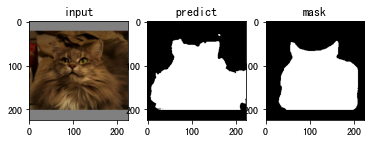

Epoch 1/1:  54%|█████▍    | 795/1470 [27:30<22:38,  2.01s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_227.png'] : tensor(0.9647)
/openbayes/input/input3/test_image/Maine_Coon_227.png
hd: 10.0
jc: 0.9318354245695945
sc: 0.9542221956612682
sp: 0.9879795472894178


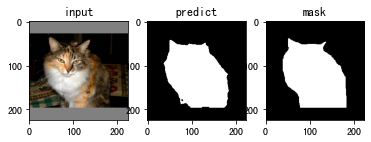

Epoch 1/1:  54%|█████▍    | 796/1470 [27:32<22:35,  2.01s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_238.png'] : tensor(0.8937)
/openbayes/input/input3/test_image/Maine_Coon_238.png
hd: 48.010415536631214
jc: 0.8077474070253854
sc: 0.8476757471886464
sp: 0.975497063820908


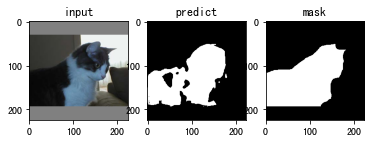

Epoch 1/1:  54%|█████▍    | 797/1470 [27:34<22:40,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_241.png'] : tensor(0.9212)
/openbayes/input/input3/test_image/Maine_Coon_241.png
hd: 11.40175425099138
jc: 0.853909033745546
sc: 0.9863212686115482
sp: 0.9694381486341406


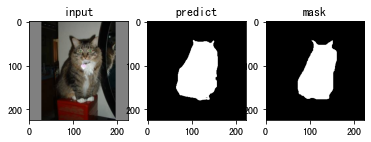

Epoch 1/1:  54%|█████▍    | 798/1470 [27:35<21:36,  1.93s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_244.png'] : tensor(0.9556)
/openbayes/input/input3/test_image/Maine_Coon_244.png
hd: 30.14962686336267
jc: 0.9149760306807286
sc: 0.9620161290322581
sp: 0.9497556746532156


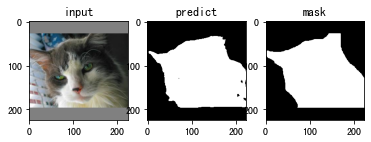

Epoch 1/1:  54%|█████▍    | 799/1470 [27:37<21:57,  1.96s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_245.png'] : tensor(0.9418)
/openbayes/input/input3/test_image/Maine_Coon_245.png
hd: 16.278820596099706
jc: 0.8900124279742402
sc: 0.9843183806072723
sp: 0.9503658179689787


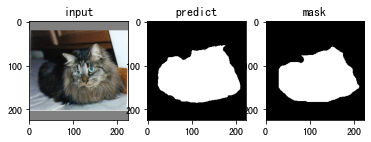

Epoch 1/1:  54%|█████▍    | 800/1470 [27:39<21:56,  1.97s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_263.png'] : tensor(0.9688)
/openbayes/input/input3/test_image/Maine_Coon_263.png
hd: 10.0
jc: 0.9393939393939394
sc: 0.9525679381700324
sp: 0.9934079456228759


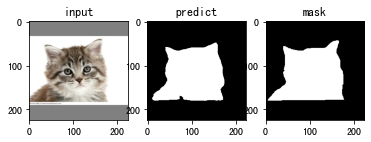

Epoch 1/1:  54%|█████▍    | 801/1470 [27:41<21:38,  1.94s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_264.png'] : tensor(0.9635)
/openbayes/input/input3/test_image/Maine_Coon_264.png
hd: 21.0
jc: 0.9295478443743428
sc: 0.9539568345323741
sp: 0.9925235559197051


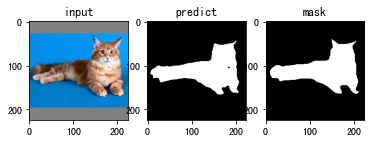

Epoch 1/1:  55%|█████▍    | 802/1470 [27:43<21:36,  1.94s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_270.png'] : tensor(0.7814)
/openbayes/input/input3/test_image/Maine_Coon_270.png
hd: 81.02468759581859
jc: 0.6412767714909434
sc: 0.6880420332974615
sp: 0.9664911719363565


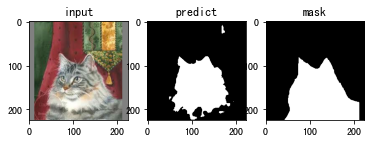

Epoch 1/1:  55%|█████▍    | 803/1470 [27:45<22:13,  2.00s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_272.png'] : tensor(0.9402)
/openbayes/input/input3/test_image/Maine_Coon_272.png
hd: 34.0
jc: 0.8870739840614933
sc: 0.9305703782758212
sp: 0.9751726208345842


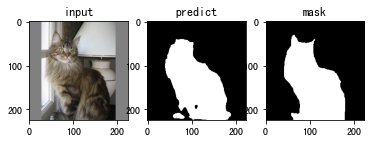

Epoch 1/1:  55%|█████▍    | 804/1470 [27:47<22:30,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_32.png'] : tensor(0.9485)
/openbayes/input/input3/test_image/Maine_Coon_32.png
hd: 10.0
jc: 0.9020172910662824
sc: 0.9621464956964694
sp: 0.9804331013147718


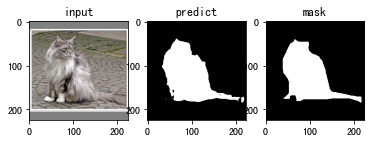

Epoch 1/1:  55%|█████▍    | 805/1470 [27:50<22:58,  2.07s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_33.png'] : tensor(0.9342)
/openbayes/input/input3/test_image/Maine_Coon_33.png
hd: 12.041594578792296
jc: 0.87652190585754
sc: 0.9379359868691014
sp: 0.9831057682794103


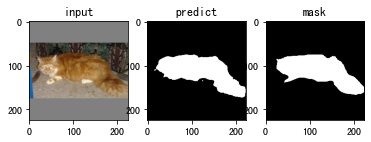

Epoch 1/1:  55%|█████▍    | 806/1470 [27:52<22:59,  2.08s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_44.png'] : tensor(0.8131)
/openbayes/input/input3/test_image/Maine_Coon_44.png
hd: 15.524174696260024
jc: 0.6850731215330308
sc: 0.9470198675496688
sp: 0.9768110427632274


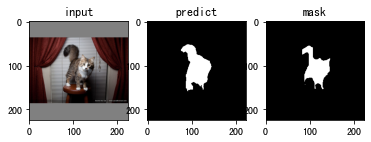

Epoch 1/1:  55%|█████▍    | 807/1470 [27:54<22:41,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_46.png'] : tensor(0.9336)
/openbayes/input/input3/test_image/Maine_Coon_46.png
hd: 28.0178514522438
jc: 0.8755030181086519
sc: 0.9272775705913692
sp: 0.9828853368967466


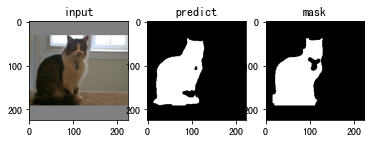

Epoch 1/1:  55%|█████▍    | 808/1470 [27:56<22:48,  2.07s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_47.png'] : tensor(0.8141)
/openbayes/input/input3/test_image/Maine_Coon_47.png
hd: 24.0
jc: 0.6865389803075262
sc: 0.9187725631768953
sp: 0.980234569463781


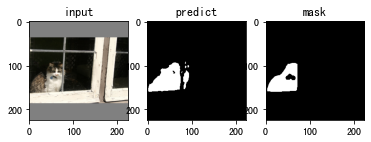

Epoch 1/1:  55%|█████▌    | 809/1470 [27:58<22:51,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_58.png'] : tensor(0.9181)
/openbayes/input/input3/test_image/Maine_Coon_58.png
hd: 13.601470508735444
jc: 0.8486578525641025
sc: 0.9739080459770115
sp: 0.9690423377374867


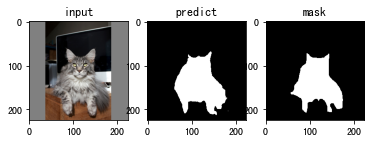

Epoch 1/1:  55%|█████▌    | 810/1470 [28:00<22:53,  2.08s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Maine_Coon_6.png'] : tensor(0.9632)
/openbayes/input/input3/test_image/Maine_Coon_6.png
hd: 5.830951894845301
jc: 0.9289667896678967
sc: 0.9783823172212777
sp: 0.9895570072957894


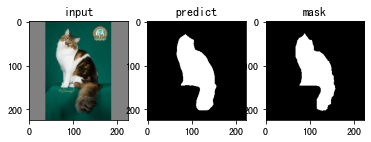

Epoch 1/1:  55%|█████▌    | 811/1470 [28:02<22:42,  2.07s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_61.png'] : tensor(0.9574)
/openbayes/input/input3/test_image/Maine_Coon_61.png
hd: 12.36931687685298
jc: 0.9182287972438951
sc: 0.9694052203679931
sp: 0.9872391496032135


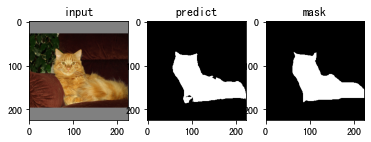

Epoch 1/1:  55%|█████▌    | 812/1470 [28:04<22:45,  2.08s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_76.png'] : tensor(0.8760)
/openbayes/input/input3/test_image/Maine_Coon_76.png
hd: 40.0
jc: 0.7794365126757505
sc: 0.7993096921449646
sp: 0.9857821376462919


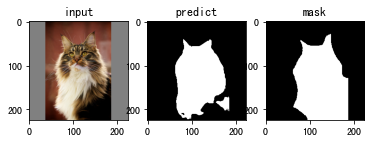

Epoch 1/1:  55%|█████▌    | 813/1470 [28:06<22:57,  2.10s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_83.png'] : tensor(0.9178)
/openbayes/input/input3/test_image/Maine_Coon_83.png
hd: 45.60701700396552
jc: 0.8480891909616646
sc: 0.8978162080282757
sp: 0.9729406967260864


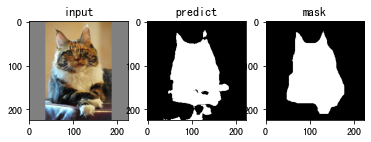

Epoch 1/1:  55%|█████▌    | 814/1470 [28:08<23:01,  2.11s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_93.png'] : tensor(0.9239)
/openbayes/input/input3/test_image/Maine_Coon_93.png
hd: 14.560219778561036
jc: 0.8584805653710247
sc: 0.9842009317399231
sp: 0.9840182143725547


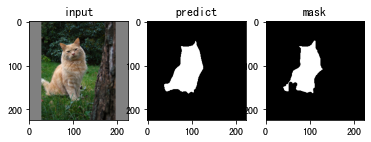

Epoch 1/1:  55%|█████▌    | 815/1470 [28:10<22:20,  2.05s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_94.png'] : tensor(0.7812)
/openbayes/input/input3/test_image/Maine_Coon_94.png
hd: 27.294688127912362
jc: 0.6409175240344072
sc: 0.9526197041865129
sp: 0.9579968389373633


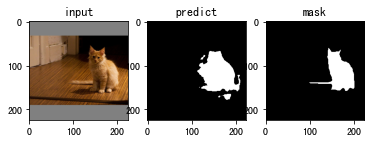

Epoch 1/1:  56%|█████▌    | 816/1470 [28:12<22:26,  2.06s/it, f_score=0.938]

['/openbayes/input/input3/test_image/Maine_Coon_98.png'] : tensor(0.9457)
/openbayes/input/input3/test_image/Maine_Coon_98.png
hd: 32.526911934581186
jc: 0.8969557431568176
sc: 0.9214233154630506
sp: 0.983338683788122


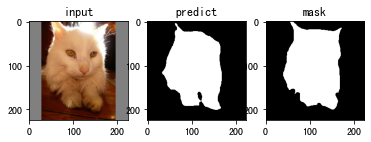

Epoch 1/1:  56%|█████▌    | 817/1470 [28:15<23:38,  2.17s/it, f_score=0.938]

['/openbayes/input/input3/test_image/miniature_pinscher_111.png'] : tensor(0.8019)
/openbayes/input/input3/test_image/miniature_pinscher_111.png
hd: 41.48493702538308
jc: 0.6693202694427434
sc: 0.9480793060718711
sp: 0.9201776468911794


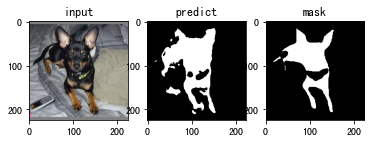

Epoch 1/1:  56%|█████▌    | 818/1470 [28:17<23:01,  2.12s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_112.png'] : tensor(0.8564)
/openbayes/input/input3/test_image/miniature_pinscher_112.png
hd: 11.313708498984761
jc: 0.7488789237668162
sc: 0.8661825726141079
sp: 0.993740673188526


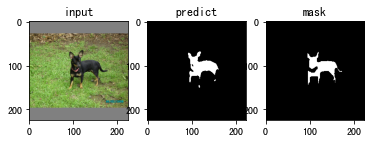

Epoch 1/1:  56%|█████▌    | 819/1470 [28:20<24:48,  2.29s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_117.png'] : tensor(0.7678)
/openbayes/input/input3/test_image/miniature_pinscher_117.png
hd: 20.396078054371138
jc: 0.6231657445273033
sc: 0.7714413341274569
sp: 0.9632305568338703


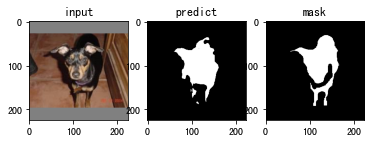

Epoch 1/1:  56%|█████▌    | 820/1470 [28:22<24:11,  2.23s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_122.png'] : tensor(0.8195)
/openbayes/input/input3/test_image/miniature_pinscher_122.png
hd: 16.1245154965971
jc: 0.6941614906832299
sc: 0.870269428437938
sp: 0.9627699691463832


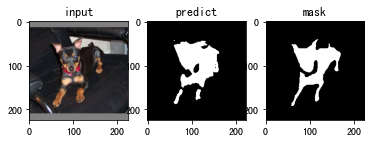

Epoch 1/1:  56%|█████▌    | 821/1470 [28:24<24:29,  2.26s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_126.png'] : tensor(0.9311)
/openbayes/input/input3/test_image/miniature_pinscher_126.png
hd: 13.416407864998739
jc: 0.8711662434069154
sc: 0.9434101967421198
sp: 0.980747507489809


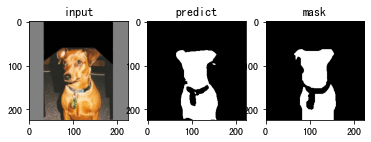

Epoch 1/1:  56%|█████▌    | 822/1470 [28:26<23:17,  2.16s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_129.png'] : tensor(0.9038)
/openbayes/input/input3/test_image/miniature_pinscher_129.png
hd: 9.0
jc: 0.824541921154914
sc: 0.9116022099447514
sp: 0.9926680591670575


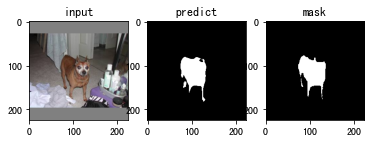

Epoch 1/1:  56%|█████▌    | 823/1470 [28:28<23:02,  2.14s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_132.png'] : tensor(0.9254)
/openbayes/input/input3/test_image/miniature_pinscher_132.png
hd: 18.439088914585774
jc: 0.8612122510173484
sc: 0.9030881527231892
sp: 0.9895083714957233


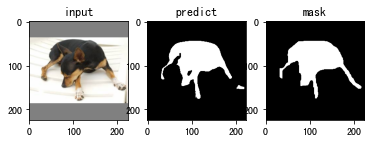

Epoch 1/1:  56%|█████▌    | 824/1470 [28:30<23:00,  2.14s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_141.png'] : tensor(0.8025)
/openbayes/input/input3/test_image/miniature_pinscher_141.png
hd: 35.0
jc: 0.6702092328130189
sc: 0.9295255642561032
sp: 0.9633459876947245


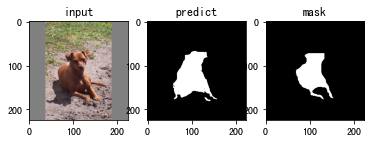

Epoch 1/1:  56%|█████▌    | 825/1470 [28:32<22:49,  2.12s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_146.png'] : tensor(0.8638)
/openbayes/input/input3/test_image/miniature_pinscher_146.png
hd: 67.0
jc: 0.760273440534452
sc: 0.8911450034145231
sp: 0.8659742653574847


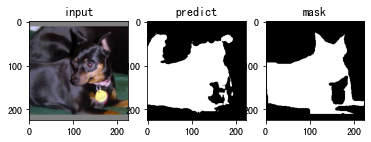

Epoch 1/1:  56%|█████▌    | 826/1470 [28:34<22:16,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_149.png'] : tensor(0.3183)
/openbayes/input/input3/test_image/miniature_pinscher_149.png
hd: 117.0
jc: 0.1893000867987059
sc: 0.9418924224577935
sp: 0.787398433727351


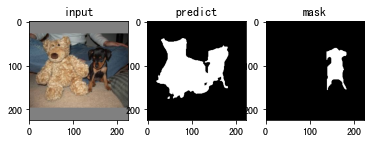

Epoch 1/1:  56%|█████▋    | 827/1470 [28:36<22:12,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_163.png'] : tensor(0.8598)
/openbayes/input/input3/test_image/miniature_pinscher_163.png
hd: 40.24922359499622
jc: 0.7541443100824858
sc: 0.7942813765182186
sp: 0.9835334029227557


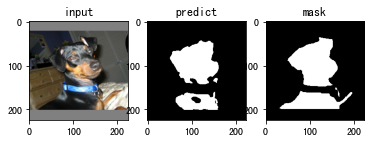

Epoch 1/1:  56%|█████▋    | 828/1470 [28:39<22:54,  2.14s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_164.png'] : tensor(0.9403)
/openbayes/input/input3/test_image/miniature_pinscher_164.png
hd: 15.524174696260024
jc: 0.8872925014310246
sc: 0.9821949055886453
sp: 0.9509216723847183


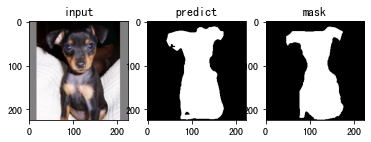

Epoch 1/1:  56%|█████▋    | 829/1470 [28:41<23:33,  2.21s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_167.png'] : tensor(0.8920)
/openbayes/input/input3/test_image/miniature_pinscher_167.png
hd: 22.360679774997898
jc: 0.805126863719592
sc: 0.920362802750922
sp: 0.9642278853100167


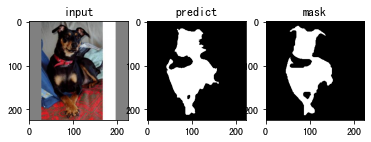

Epoch 1/1:  56%|█████▋    | 830/1470 [28:43<22:56,  2.15s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_171.png'] : tensor(0.8084)
/openbayes/input/input3/test_image/miniature_pinscher_171.png
hd: 52.40229002629561
jc: 0.6784516623550829
sc: 0.9109738839572881
sp: 0.8461449610164598


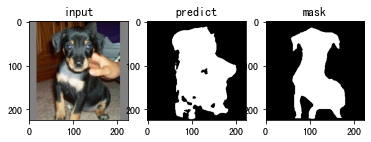

Epoch 1/1:  57%|█████▋    | 831/1470 [28:45<22:47,  2.14s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_174.png'] : tensor(0.8398)
/openbayes/input/input3/test_image/miniature_pinscher_174.png
hd: 19.313207915827967
jc: 0.7238095238095238
sc: 0.7507002801120448
sp: 0.9941926117115664


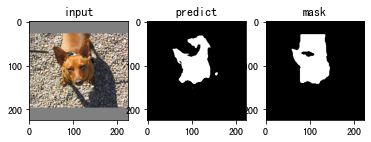

Epoch 1/1:  57%|█████▋    | 832/1470 [28:47<22:15,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_188.png'] : tensor(0.8956)
/openbayes/input/input3/test_image/miniature_pinscher_188.png
hd: 30.4138126514911
jc: 0.8108995403808273
sc: 0.9647495361781077
sp: 0.9513459371478653


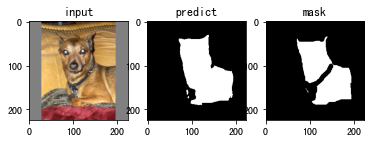

Epoch 1/1:  57%|█████▋    | 833/1470 [28:49<21:50,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_191.png'] : tensor(0.6732)
/openbayes/input/input3/test_image/miniature_pinscher_191.png
hd: 23.194827009486403
jc: 0.5074010327022376
sc: 0.5632403515475736
sp: 0.9939443638428058


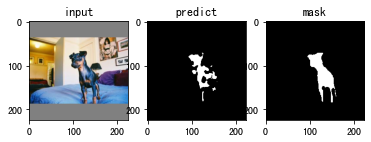

Epoch 1/1:  57%|█████▋    | 834/1470 [28:51<21:07,  1.99s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_2.png'] : tensor(0.8910)
/openbayes/input/input3/test_image/miniature_pinscher_2.png
hd: 47.4236228055175
jc: 0.8033858727378868
sc: 0.8914367146003368
sp: 0.9800739571802058


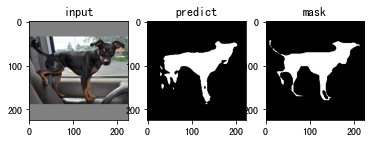

Epoch 1/1:  57%|█████▋    | 835/1470 [28:53<21:25,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_24.png'] : tensor(0.8712)
/openbayes/input/input3/test_image/miniature_pinscher_24.png
hd: 22.0
jc: 0.7717189571365444
sc: 0.84001924001924
sp: 0.9768733817651643


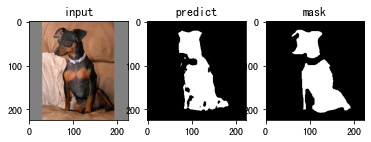

Epoch 1/1:  57%|█████▋    | 836/1470 [28:55<21:41,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_3.png'] : tensor(0.9198)
/openbayes/input/input3/test_image/miniature_pinscher_3.png
hd: 36.68787265568828
jc: 0.8515290638860789
sc: 0.915349226265161
sp: 0.9765573899165381


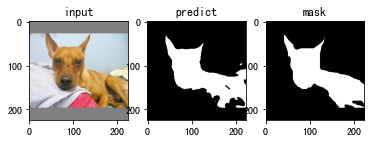

Epoch 1/1:  57%|█████▋    | 837/1470 [28:57<21:46,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_30.png'] : tensor(0.9306)
/openbayes/input/input3/test_image/miniature_pinscher_30.png
hd: 30.083217912982647
jc: 0.8702725544052398
sc: 0.9549090066071636
sp: 0.9798069748971094


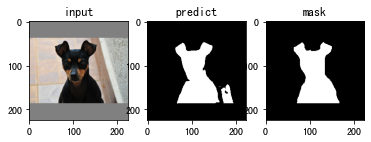

Epoch 1/1:  57%|█████▋    | 838/1470 [28:59<21:34,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_31.png'] : tensor(0.7988)
/openbayes/input/input3/test_image/miniature_pinscher_31.png
hd: 15.620499351813308
jc: 0.6649970536240424
sc: 0.7975265017667844
sp: 0.9880876948422254


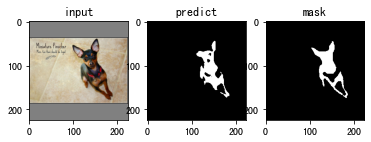

Epoch 1/1:  57%|█████▋    | 839/1470 [29:01<21:56,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_37.png'] : tensor(0.9070)
/openbayes/input/input3/test_image/miniature_pinscher_37.png
hd: 19.235384061671343
jc: 0.8298538622129437
sc: 0.8761296010579678
sp: 0.9876891635443531


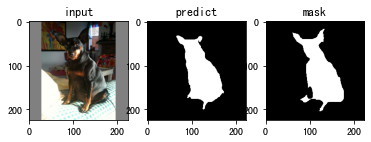

Epoch 1/1:  57%|█████▋    | 840/1470 [29:03<21:42,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/miniature_pinscher_38.png'] : tensor(0.8602)
/openbayes/input/input3/test_image/miniature_pinscher_38.png
hd: 27.073972741361768
jc: 0.7547413793103448
sc: 0.8865822784810127
sp: 0.9766106980633206


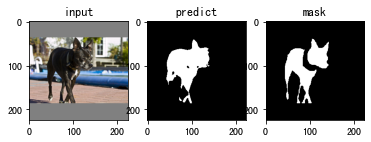

Epoch 1/1:  57%|█████▋    | 841/1470 [29:05<21:22,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_5.png'] : tensor(0.4621)
/openbayes/input/input3/test_image/miniature_pinscher_5.png
hd: 14.142135623730951
jc: 0.3004640371229698
sc: 0.35773480662983426
sp: 0.9972094151904878


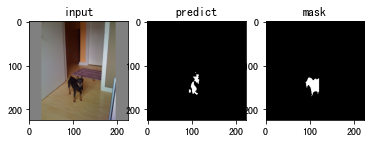

Epoch 1/1:  57%|█████▋    | 842/1470 [29:07<21:18,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_50.png'] : tensor(0.9141)
/openbayes/input/input3/test_image/miniature_pinscher_50.png
hd: 25.0
jc: 0.8417558596396152
sc: 0.9480430304417486
sp: 0.9553535299036932


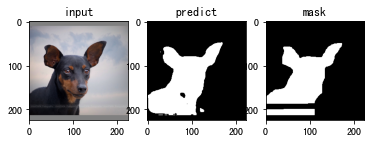

Epoch 1/1:  57%|█████▋    | 843/1470 [29:09<21:13,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_58.png'] : tensor(0.9291)
/openbayes/input/input3/test_image/miniature_pinscher_58.png
hd: 20.808652046684813
jc: 0.8676642586859306
sc: 0.872074127856723
sp: 0.9930833294123182


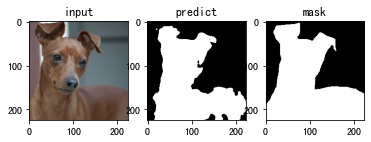

Epoch 1/1:  57%|█████▋    | 844/1470 [29:11<21:28,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_62.png'] : tensor(0.8832)
/openbayes/input/input3/test_image/miniature_pinscher_62.png
hd: 10.63014581273465
jc: 0.7907809887747791
sc: 0.9174286505957329
sp: 0.987587776751777


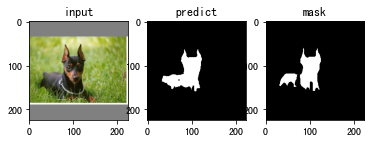

Epoch 1/1:  57%|█████▋    | 845/1470 [29:13<21:13,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_63.png'] : tensor(0.8042)
/openbayes/input/input3/test_image/miniature_pinscher_63.png
hd: 21.587033144922902
jc: 0.6725032425421531
sc: 0.8303971812940423
sp: 0.9666302467449694


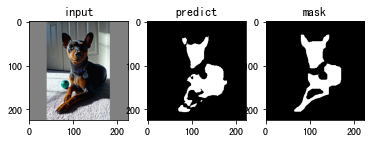

Epoch 1/1:  58%|█████▊    | 846/1470 [29:16<21:25,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_64.png'] : tensor(0.9435)
/openbayes/input/input3/test_image/miniature_pinscher_64.png
hd: 15.231546211727817
jc: 0.8930457746478874
sc: 0.9647204260174972
sp: 0.978719112455875


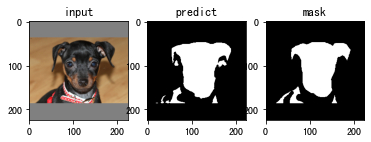

Epoch 1/1:  58%|█████▊    | 847/1470 [29:18<21:01,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_72.png'] : tensor(0.7286)
/openbayes/input/input3/test_image/miniature_pinscher_72.png
hd: 26.92582403567252
jc: 0.5730882352941177
sc: 0.833404619332763
sp: 0.9533186813186814


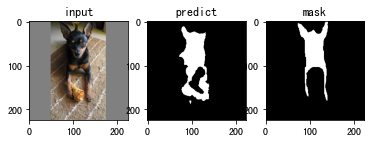

Epoch 1/1:  58%|█████▊    | 848/1470 [29:20<21:06,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_75.png'] : tensor(0.9288)
/openbayes/input/input3/test_image/miniature_pinscher_75.png
hd: 15.231546211727817
jc: 0.8670239660228537
sc: 0.9641290902957382
sp: 0.9758738463774435


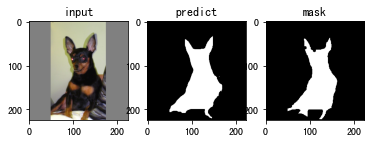

Epoch 1/1:  58%|█████▊    | 849/1470 [29:22<20:59,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_79.png'] : tensor(0.3924)
/openbayes/input/input3/test_image/miniature_pinscher_79.png
hd: 22.847319317591726
jc: 0.2440944881889764
sc: 0.28703703703703703
sp: 0.9980860665645902


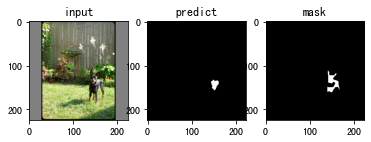

Epoch 1/1:  58%|█████▊    | 850/1470 [29:23<20:36,  1.99s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_85.png'] : tensor(0.9292)
/openbayes/input/input3/test_image/miniature_pinscher_85.png
hd: 14.422205101855956
jc: 0.8676925342364895
sc: 0.9401675309134424
sp: 0.9721845859568025


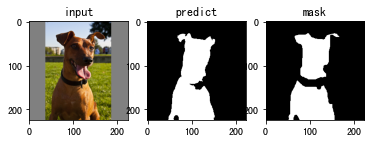

Epoch 1/1:  58%|█████▊    | 851/1470 [29:25<20:03,  1.94s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_86.png'] : tensor(0.7804)
/openbayes/input/input3/test_image/miniature_pinscher_86.png
hd: 51.24451190127583
jc: 0.6399176954732511
sc: 0.8110692552883222
sp: 0.9802461209202782


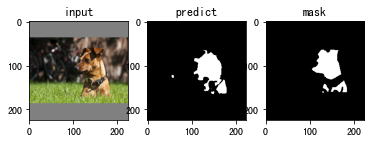

Epoch 1/1:  58%|█████▊    | 852/1470 [29:27<19:25,  1.89s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_96.png'] : tensor(0.9230)
/openbayes/input/input3/test_image/miniature_pinscher_96.png
hd: 10.0
jc: 0.8569659442724458
sc: 0.8818094934692577
sp: 0.9958540252403298


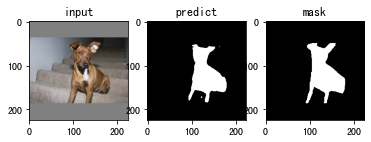

Epoch 1/1:  58%|█████▊    | 853/1470 [29:29<19:51,  1.93s/it, f_score=0.936]

['/openbayes/input/input3/test_image/miniature_pinscher_97.png'] : tensor(0.8685)
/openbayes/input/input3/test_image/miniature_pinscher_97.png
hd: 33.54101966249684
jc: 0.7675417661097852
sc: 0.8337366055997235
sp: 0.9887587294435684


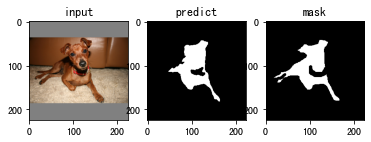

Epoch 1/1:  58%|█████▊    | 854/1470 [29:31<20:19,  1.98s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_10.png'] : tensor(0.9822)
/openbayes/input/input3/test_image/newfoundland_10.png
hd: 39.56008088970496
jc: 0.9650866590080416
sc: 0.9869745109056546
sp: 0.9854897218863361


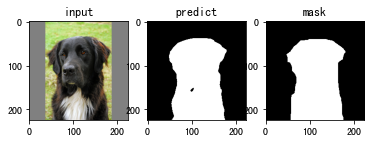

Epoch 1/1:  58%|█████▊    | 855/1470 [29:33<20:22,  1.99s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_101.png'] : tensor(0.9521)
/openbayes/input/input3/test_image/newfoundland_101.png
hd: 11.313708498984761
jc: 0.9085467243099434
sc: 0.9755400821281914
sp: 0.9907347167694897


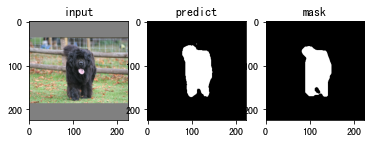

Epoch 1/1:  58%|█████▊    | 856/1470 [29:35<20:18,  1.98s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_102.png'] : tensor(0.9550)
/openbayes/input/input3/test_image/newfoundland_102.png
hd: 42.20189569201838
jc: 0.9138576779026217
sc: 0.969918349806618
sp: 0.986028188313595


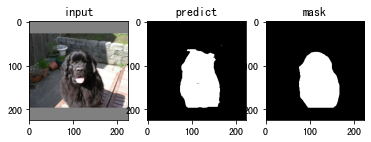

Epoch 1/1:  58%|█████▊    | 857/1470 [29:37<20:45,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_107.png'] : tensor(0.9183)
/openbayes/input/input3/test_image/newfoundland_107.png
hd: 40.80441152620633
jc: 0.8489440121687241
sc: 0.9251514185527574
sp: 0.9591777565161926


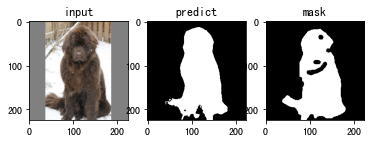

Epoch 1/1:  58%|█████▊    | 858/1470 [29:39<20:52,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_109.png'] : tensor(0.9650)
/openbayes/input/input3/test_image/newfoundland_109.png
hd: 3.0
jc: 0.932296047098402
sc: 0.9775132275132276
sp: 0.9923914045928248


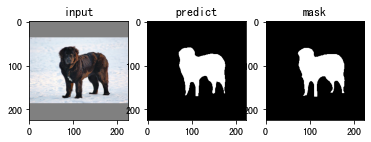

Epoch 1/1:  58%|█████▊    | 859/1470 [29:41<20:39,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_110.png'] : tensor(0.9527)
/openbayes/input/input3/test_image/newfoundland_110.png
hd: 41.593268686170845
jc: 0.909645655641079
sc: 0.9919092627599244
sp: 0.9676328110199994


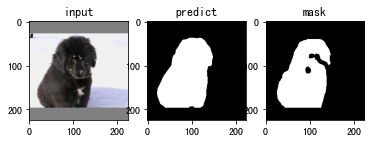

Epoch 1/1:  59%|█████▊    | 860/1470 [29:44<20:57,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_115.png'] : tensor(0.9638)
/openbayes/input/input3/test_image/newfoundland_115.png
hd: 19.026297590440446
jc: 0.930215740629143
sc: 0.9569745815251085
sp: 0.9863713798977853


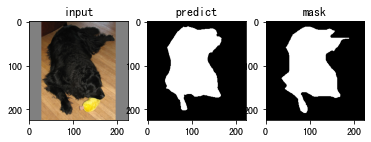

Epoch 1/1:  59%|█████▊    | 861/1470 [29:46<20:40,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_118.png'] : tensor(0.8826)
/openbayes/input/input3/test_image/newfoundland_118.png
hd: 39.05124837953327
jc: 0.7898047315058205
sc: 0.9251154607433473
sp: 0.9025884706765037


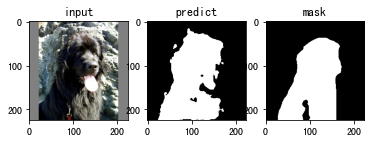

Epoch 1/1:  59%|█████▊    | 862/1470 [29:48<21:08,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_12.png'] : tensor(0.8559)
/openbayes/input/input3/test_image/newfoundland_12.png
hd: 23.08679276123039
jc: 0.7481092761228585
sc: 0.7681458003169572
sp: 0.9961473578625815


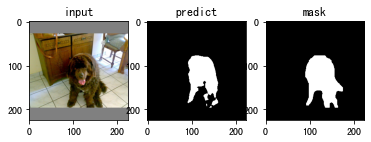

Epoch 1/1:  59%|█████▊    | 863/1470 [29:50<22:03,  2.18s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_120.png'] : tensor(0.9278)
/openbayes/input/input3/test_image/newfoundland_120.png
hd: 16.0
jc: 0.8653821615414061
sc: 0.9272627837024884
sp: 0.9877980495543839


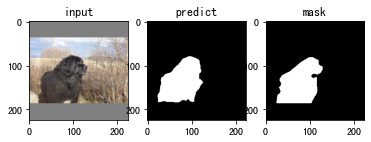

Epoch 1/1:  59%|█████▉    | 864/1470 [29:52<21:49,  2.16s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_135.png'] : tensor(0.9590)
/openbayes/input/input3/test_image/newfoundland_135.png
hd: 14.0
jc: 0.9212932886912198
sc: 0.9735952682720743
sp: 0.9655889884763125


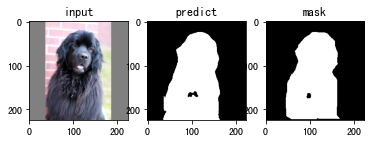

Epoch 1/1:  59%|█████▉    | 865/1470 [29:54<21:40,  2.15s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_144.png'] : tensor(0.9267)
/openbayes/input/input3/test_image/newfoundland_144.png
hd: 10.44030650891055
jc: 0.8633387888707038
sc: 0.9603131257964682
sp: 0.9861916164984446


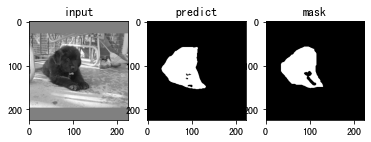

Epoch 1/1:  59%|█████▉    | 866/1470 [29:56<21:13,  2.11s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_15.png'] : tensor(0.8866)
/openbayes/input/input3/test_image/newfoundland_15.png
hd: 34.9857113690718
jc: 0.7962824852274683
sc: 0.8500734933855953
sp: 0.9674131411013944


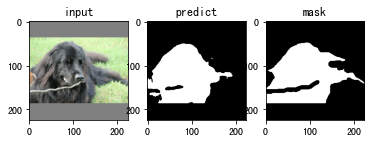

Epoch 1/1:  59%|█████▉    | 867/1470 [29:58<20:41,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_154.png'] : tensor(0.9454)
/openbayes/input/input3/test_image/newfoundland_154.png
hd: 34.0147027033899
jc: 0.8965113556544135
sc: 0.9419434194341944
sp: 0.9757046821559147


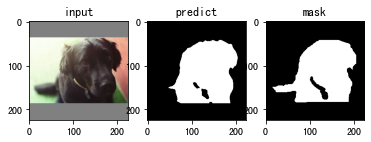

Epoch 1/1:  59%|█████▉    | 868/1470 [30:00<20:56,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_164.png'] : tensor(0.9524)
/openbayes/input/input3/test_image/newfoundland_164.png
hd: 30.528675044947494
jc: 0.9090764710553482
sc: 0.9849436462187043
sp: 0.9748398308821622


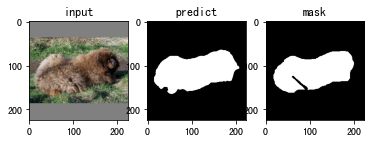

Epoch 1/1:  59%|█████▉    | 869/1470 [30:02<20:35,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_167.png'] : tensor(0.9447)
/openbayes/input/input3/test_image/newfoundland_167.png
hd: 11.40175425099138
jc: 0.8952042628774423
sc: 0.9586719695659692
sp: 0.9907643096884644


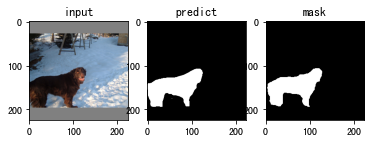

Epoch 1/1:  59%|█████▉    | 870/1470 [30:04<20:16,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_169.png'] : tensor(0.8848)
/openbayes/input/input3/test_image/newfoundland_169.png
hd: 13.152946437965905
jc: 0.7933857762080591
sc: 0.9579375848032564
sp: 0.9762312015460826


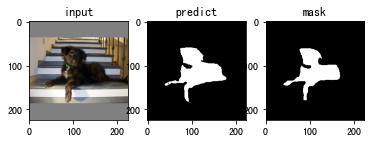

Epoch 1/1:  59%|█████▉    | 871/1470 [30:06<20:08,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_170.png'] : tensor(0.7908)
/openbayes/input/input3/test_image/newfoundland_170.png
hd: 33.83784863137726
jc: 0.6540056271286836
sc: 0.9617813588850174
sp: 0.8945647931303669


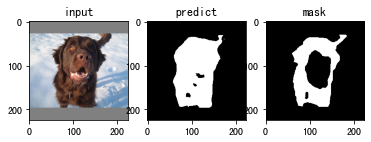

Epoch 1/1:  59%|█████▉    | 872/1470 [30:08<19:59,  2.01s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_172.png'] : tensor(0.9388)
/openbayes/input/input3/test_image/newfoundland_172.png
hd: 19.313207915827967
jc: 0.8847303731591186
sc: 0.968367470609623
sp: 0.9813953488372092


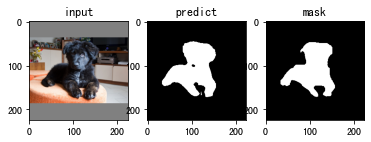

Epoch 1/1:  59%|█████▉    | 873/1470 [30:11<21:32,  2.16s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_18.png'] : tensor(0.9704)
/openbayes/input/input3/test_image/newfoundland_18.png
hd: 8.0
jc: 0.9425258539642746
sc: 0.9846133699993452
sp: 0.9804601323668453


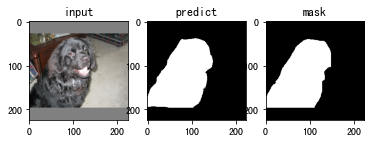

Epoch 1/1:  59%|█████▉    | 874/1470 [30:13<21:01,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_182.png'] : tensor(0.9575)
/openbayes/input/input3/test_image/newfoundland_182.png
hd: 47.38143096192854
jc: 0.9185455161891846
sc: 0.9678485308564794
sp: 0.9567345763443956


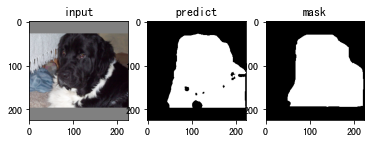

Epoch 1/1:  60%|█████▉    | 875/1470 [30:15<20:38,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_19.png'] : tensor(0.9597)
/openbayes/input/input3/test_image/newfoundland_19.png
hd: 19.6468827043885
jc: 0.9225627926777352
sc: 0.9420535559033212
sp: 0.9821139408214339


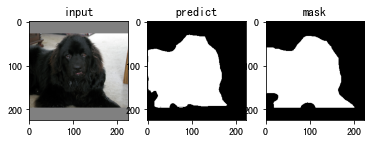

Epoch 1/1:  60%|█████▉    | 876/1470 [30:17<20:39,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_193.png'] : tensor(0.9011)
/openbayes/input/input3/test_image/newfoundland_193.png
hd: 21.0
jc: 0.8199602122015915
sc: 0.9781147000659196
sp: 0.965650019957268


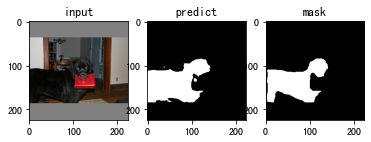

Epoch 1/1:  60%|█████▉    | 877/1470 [30:20<22:28,  2.27s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_195.png'] : tensor(0.9193)
/openbayes/input/input3/test_image/newfoundland_195.png
hd: 47.0
jc: 0.85065395924161
sc: 0.9766034221860086
sp: 0.9694120476133221


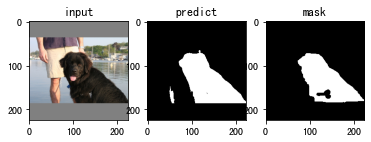

Epoch 1/1:  60%|█████▉    | 878/1470 [30:22<21:53,  2.22s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_200.png'] : tensor(0.9480)
/openbayes/input/input3/test_image/newfoundland_200.png
hd: 8.0
jc: 0.9010737948366461
sc: 0.9864932466233116
sp: 0.9917926285244055


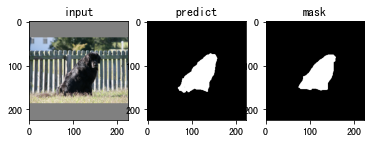

Epoch 1/1:  60%|█████▉    | 879/1470 [30:24<21:48,  2.21s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_30.png'] : tensor(0.8330)
/openbayes/input/input3/test_image/newfoundland_30.png
hd: 38.2099463490856
jc: 0.7138686131386861
sc: 0.9741035856573705
sp: 0.9848031888390633


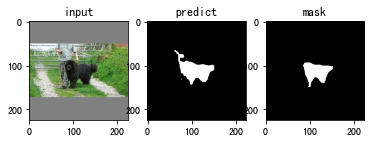

Epoch 1/1:  60%|█████▉    | 880/1470 [30:26<21:07,  2.15s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_34.png'] : tensor(0.9666)
/openbayes/input/input3/test_image/newfoundland_34.png
hd: 7.615773105863909
jc: 0.9353937902309731
sc: 0.9870149328272486
sp: 0.9633535634928532


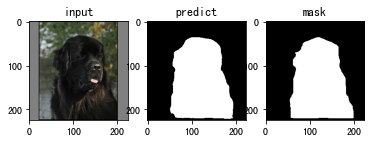

Epoch 1/1:  60%|█████▉    | 881/1470 [30:28<20:35,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_35.png'] : tensor(0.9523)
/openbayes/input/input3/test_image/newfoundland_35.png
hd: 61.1310068623117
jc: 0.9089266619962391
sc: 0.9731554222099403
sp: 0.9279533105252565


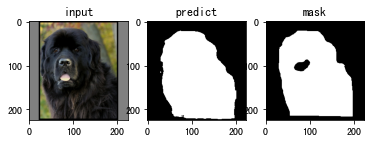

Epoch 1/1:  60%|██████    | 882/1470 [30:30<20:24,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_38.png'] : tensor(0.9679)
/openbayes/input/input3/test_image/newfoundland_38.png
hd: 30.23243291566195
jc: 0.9378126267405705
sc: 0.9834833770468562
sp: 0.9809531730849206


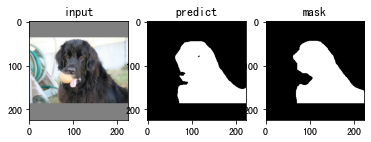

Epoch 1/1:  60%|██████    | 883/1470 [30:32<20:19,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_39.png'] : tensor(0.9188)
/openbayes/input/input3/test_image/newfoundland_39.png
hd: 28.42534080710379
jc: 0.8497652582159625
sc: 0.957843752802942
sp: 0.9636661798242242


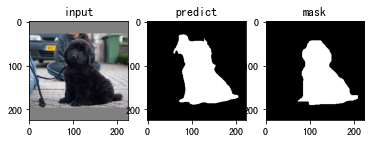

Epoch 1/1:  60%|██████    | 884/1470 [30:34<19:55,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_4.png'] : tensor(0.9396)
/openbayes/input/input3/test_image/newfoundland_4.png
hd: 25.238858928247925
jc: 0.8860164512338425
sc: 0.9509053238446987
sp: 0.9791938579654511


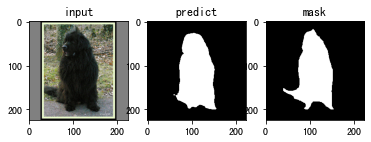

Epoch 1/1:  60%|██████    | 885/1470 [30:36<19:21,  1.99s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_40.png'] : tensor(0.8708)
/openbayes/input/input3/test_image/newfoundland_40.png
hd: 80.2807573457052
jc: 0.7711729909104026
sc: 0.9560007154355213
sp: 0.9699450487832231


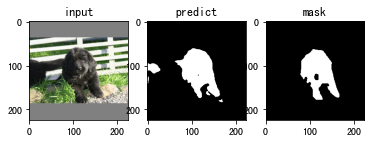

Epoch 1/1:  60%|██████    | 886/1470 [30:38<19:08,  1.97s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_45.png'] : tensor(0.8867)
/openbayes/input/input3/test_image/newfoundland_45.png
hd: 16.0
jc: 0.7964316423043852
sc: 0.9853723404255319
sp: 0.9807824887969666


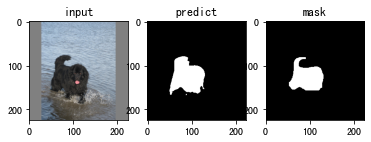

Epoch 1/1:  60%|██████    | 887/1470 [30:40<19:24,  2.00s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_46.png'] : tensor(0.9386)
/openbayes/input/input3/test_image/newfoundland_46.png
hd: 11.0
jc: 0.8842285469719666
sc: 0.9932692307692308
sp: 0.9888517037552156


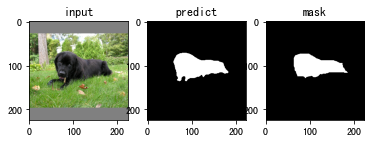

Epoch 1/1:  60%|██████    | 888/1470 [30:42<19:39,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_56.png'] : tensor(0.8795)
/openbayes/input/input3/test_image/newfoundland_56.png
hd: 78.05767098754612
jc: 0.7849908480780964
sc: 0.9491000295072293
sp: 0.9226105953031131


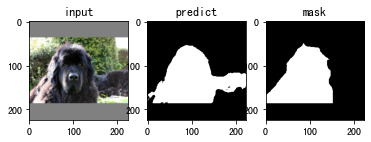

Epoch 1/1:  60%|██████    | 889/1470 [30:44<19:19,  2.00s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_6.png'] : tensor(0.9506)
/openbayes/input/input3/test_image/newfoundland_6.png
hd: 10.0
jc: 0.9058186040510902
sc: 0.9322799097065463
sp: 0.9948411302614609


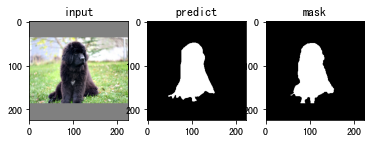

Epoch 1/1:  61%|██████    | 890/1470 [30:46<19:55,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/newfoundland_60.png'] : tensor(0.9479)
/openbayes/input/input3/test_image/newfoundland_60.png
hd: 40.44749683231337
jc: 0.9009394772160798
sc: 0.9466156325543916
sp: 0.9786021992971319


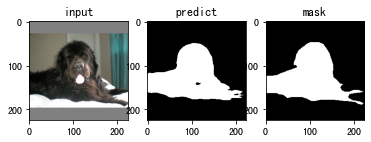

Epoch 1/1:  61%|██████    | 891/1470 [30:48<20:29,  2.12s/it, f_score=0.937]

['/openbayes/input/input3/test_image/newfoundland_63.png'] : tensor(0.9450)
/openbayes/input/input3/test_image/newfoundland_63.png
hd: 22.80350850198276
jc: 0.8957086216279251
sc: 0.9262400514510812
sp: 0.9664795636018657


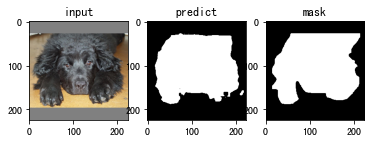

Epoch 1/1:  61%|██████    | 892/1470 [30:51<20:25,  2.12s/it, f_score=0.937]

['/openbayes/input/input3/test_image/newfoundland_64.png'] : tensor(0.8898)
/openbayes/input/input3/test_image/newfoundland_64.png
hd: 75.39230729988306
jc: 0.8014394296092016
sc: 0.9714635140644109
sp: 0.9313655667220596


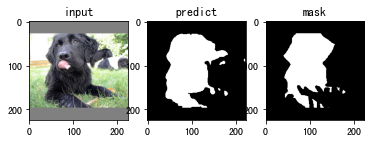

Epoch 1/1:  61%|██████    | 893/1470 [30:52<19:42,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/newfoundland_65.png'] : tensor(0.9881)
/openbayes/input/input3/test_image/newfoundland_65.png
hd: 4.123105625617661
jc: 0.9764427528032096
sc: 0.994447354635935
sp: 0.9886765746638358


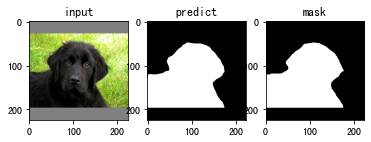

Epoch 1/1:  61%|██████    | 894/1470 [30:54<19:44,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/newfoundland_82.png'] : tensor(0.9354)
/openbayes/input/input3/test_image/newfoundland_82.png
hd: 12.727922061357855
jc: 0.8785835886959482
sc: 0.9865422847530203
sp: 0.9566823009326648


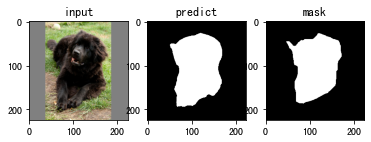

Epoch 1/1:  61%|██████    | 895/1470 [30:56<19:22,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_10.png'] : tensor(0.9513)
/openbayes/input/input3/test_image/Persian_10.png
hd: 23.0
jc: 0.9070533948582729
sc: 0.9774304994995319
sp: 0.8748763342879459


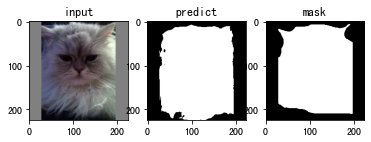

Epoch 1/1:  61%|██████    | 896/1470 [30:58<19:18,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_102.png'] : tensor(0.8648)
/openbayes/input/input3/test_image/Persian_102.png
hd: 43.829214001622255
jc: 0.7618516452872282
sc: 0.8960088803673243
sp: 0.8850347531047205


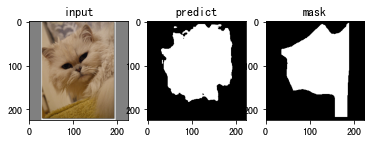

Epoch 1/1:  61%|██████    | 897/1470 [31:00<19:12,  2.01s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_105.png'] : tensor(0.9641)
/openbayes/input/input3/test_image/Persian_105.png
hd: 34.058772731852805
jc: 0.93076035788883
sc: 0.9892644135188867
sp: 0.905131026205241


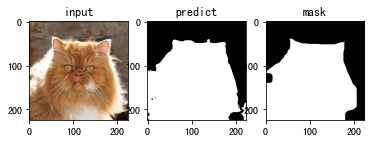

Epoch 1/1:  61%|██████    | 898/1470 [31:03<19:29,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_11.png'] : tensor(0.9471)
/openbayes/input/input3/test_image/Persian_11.png
hd: 21.840329667841555
jc: 0.8994585952545329
sc: 0.9490472721696124
sp: 0.9403146142032955


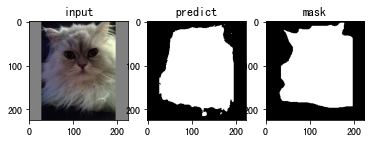

Epoch 1/1:  61%|██████    | 899/1470 [31:05<19:25,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_111.png'] : tensor(0.9309)
/openbayes/input/input3/test_image/Persian_111.png
hd: 33.24154027718932
jc: 0.8707284172661871
sc: 0.9237557640324376
sp: 0.9796265758816959


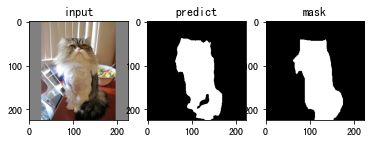

Epoch 1/1:  61%|██████    | 900/1470 [31:07<19:24,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_112.png'] : tensor(0.9117)
/openbayes/input/input3/test_image/Persian_112.png
hd: 92.0
jc: 0.8377554636739516
sc: 0.867580132126254
sp: 0.8436492585428755


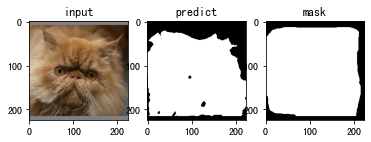

Epoch 1/1:  61%|██████▏   | 901/1470 [31:09<19:54,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_134.png'] : tensor(0.9611)
/openbayes/input/input3/test_image/Persian_134.png
hd: 11.704699910719626
jc: 0.925065445026178
sc: 0.9769933349790175
sp: 0.9619999331573142


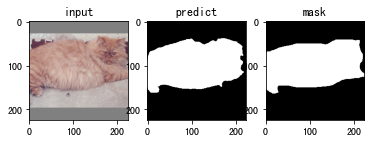

Epoch 1/1:  61%|██████▏   | 902/1470 [31:11<20:38,  2.18s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_14.png'] : tensor(0.9674)
/openbayes/input/input3/test_image/Persian_14.png
hd: 14.0
jc: 0.9367909800520382
sc: 0.952923739280799
sp: 0.9776546545171482


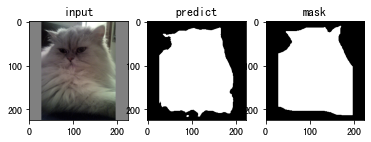

Epoch 1/1:  61%|██████▏   | 903/1470 [31:13<20:08,  2.13s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_140.png'] : tensor(0.9772)
/openbayes/input/input3/test_image/Persian_140.png
hd: 9.899494936611665
jc: 0.9554659622781407
sc: 0.9687544049241178
sp: 0.9897553040528848


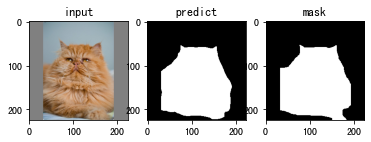

Epoch 1/1:  61%|██████▏   | 904/1470 [31:15<19:56,  2.11s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_156.png'] : tensor(0.9595)
/openbayes/input/input3/test_image/Persian_156.png
hd: 17.0
jc: 0.9221612191492636
sc: 0.9517555473176932
sp: 0.9806346467261049


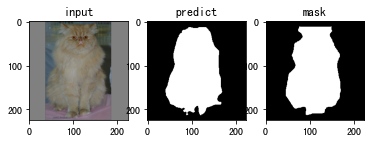

Epoch 1/1:  62%|██████▏   | 905/1470 [31:17<20:03,  2.13s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_158.png'] : tensor(0.9704)
/openbayes/input/input3/test_image/Persian_158.png
hd: 8.0
jc: 0.9425470132743363
sc: 0.9740640182909402
sp: 0.9870646766169154


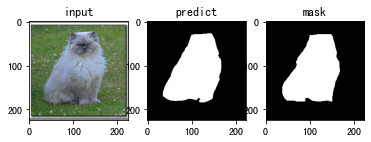

Epoch 1/1:  62%|██████▏   | 906/1470 [31:20<19:45,  2.10s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_163.png'] : tensor(0.9377)
/openbayes/input/input3/test_image/Persian_163.png
hd: 91.7877987534291
jc: 0.8826525198938993
sc: 0.9174018526687252
sp: 0.8972957422324511


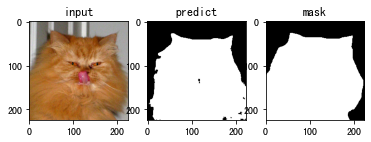

Epoch 1/1:  62%|██████▏   | 907/1470 [31:22<20:07,  2.14s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_165.png'] : tensor(0.9705)
/openbayes/input/input3/test_image/Persian_165.png
hd: 16.0
jc: 0.9426169856633433
sc: 0.9761841956513547
sp: 0.9600236896653834


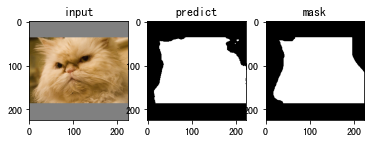

Epoch 1/1:  62%|██████▏   | 908/1470 [31:24<19:42,  2.10s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_17.png'] : tensor(0.9649)
/openbayes/input/input3/test_image/Persian_17.png
hd: 35.0
jc: 0.9320920785375761
sc: 0.9773880941393632
sp: 0.9377868666212225


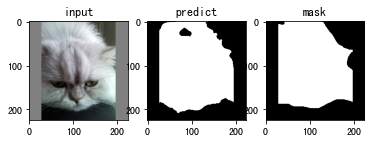

Epoch 1/1:  62%|██████▏   | 909/1470 [31:26<19:16,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_179.png'] : tensor(0.9594)
/openbayes/input/input3/test_image/Persian_179.png
hd: 15.0
jc: 0.9219745869362238
sc: 0.9576235452858829
sp: 0.9653439153439154


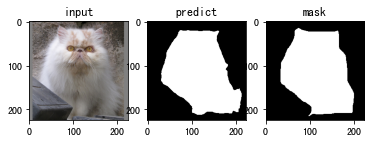

Epoch 1/1:  62%|██████▏   | 910/1470 [31:28<19:04,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_182.png'] : tensor(0.7100)
/openbayes/input/input3/test_image/Persian_182.png
hd: 75.66372975210778
jc: 0.550342788009141
sc: 0.9439704865114135
sp: 0.9323283666746657


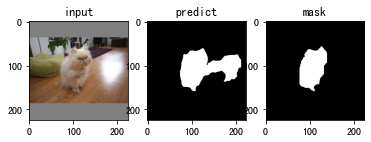

Epoch 1/1:  62%|██████▏   | 911/1470 [31:30<18:49,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_186.png'] : tensor(0.9606)
/openbayes/input/input3/test_image/Persian_186.png
hd: 22.360679774997898
jc: 0.9242674370614941
sc: 0.9766681203663323
sp: 0.9673284744910782


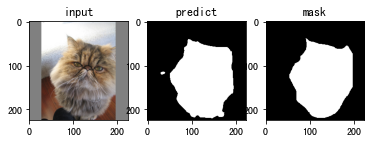

Epoch 1/1:  62%|██████▏   | 912/1470 [31:32<19:09,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_192.png'] : tensor(0.9640)
/openbayes/input/input3/test_image/Persian_192.png
hd: 16.97056274847714
jc: 0.9305911566805511
sc: 0.9952028097828415
sp: 0.939580304893958


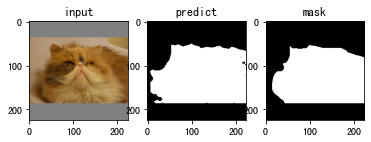

Epoch 1/1:  62%|██████▏   | 913/1470 [31:34<18:54,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_194.png'] : tensor(0.9362)
/openbayes/input/input3/test_image/Persian_194.png
hd: 31.11269837220809
jc: 0.8799958313792924
sc: 0.950098452883263
sp: 0.9562976451344094


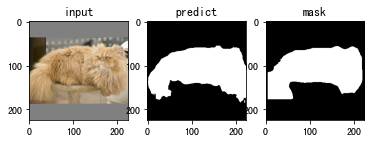

Epoch 1/1:  62%|██████▏   | 914/1470 [31:36<18:52,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_195.png'] : tensor(0.9072)
/openbayes/input/input3/test_image/Persian_195.png
hd: 53.45091205957107
jc: 0.8302401746724891
sc: 0.9185892015943955
sp: 0.9475876018799453


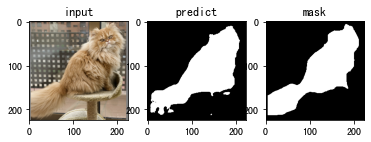

Epoch 1/1:  62%|██████▏   | 915/1470 [31:38<18:49,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_196.png'] : tensor(0.9824)
/openbayes/input/input3/test_image/Persian_196.png
hd: 55.02726596879042
jc: 0.9654090372120496
sc: 0.9875382349609154
sp: 0.9743827811774636


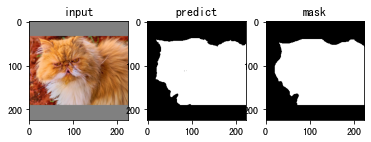

Epoch 1/1:  62%|██████▏   | 916/1470 [31:40<19:10,  2.08s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_221.png'] : tensor(0.9650)
/openbayes/input/input3/test_image/Persian_221.png
hd: 13.0
jc: 0.9323009838998211
sc: 0.9788695192815636
sp: 0.9743202872748121


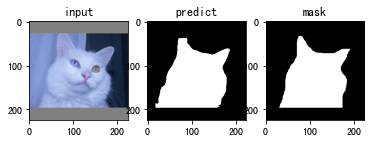

Epoch 1/1:  62%|██████▏   | 917/1470 [31:42<19:18,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_25.png'] : tensor(0.9355)
/openbayes/input/input3/test_image/Persian_25.png
hd: 34.438350715445125
jc: 0.8788716466670855
sc: 0.8902819321580857
sp: 0.994080608188492


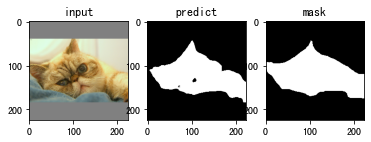

Epoch 1/1:  62%|██████▏   | 918/1470 [31:44<19:01,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_262.png'] : tensor(0.9546)
/openbayes/input/input3/test_image/Persian_262.png
hd: 9.486832980505138
jc: 0.9131284916201118
sc: 0.9274635899375827
sp: 0.9958082925104793


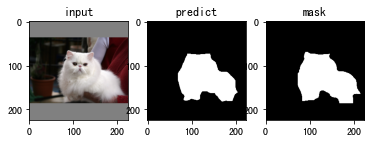

Epoch 1/1:  63%|██████▎   | 919/1470 [31:46<18:54,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_264.png'] : tensor(0.9260)
/openbayes/input/input3/test_image/Persian_264.png
hd: 20.0
jc: 0.8622050068144322
sc: 0.9341726898266884
sp: 0.9712133801495618


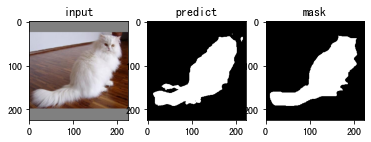

Epoch 1/1:  63%|██████▎   | 920/1470 [31:48<18:36,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_265.png'] : tensor(0.9624)
/openbayes/input/input3/test_image/Persian_265.png
hd: 19.313207915827967
jc: 0.9275247074860843
sc: 0.9415359778597786
sp: 0.9837334437086093


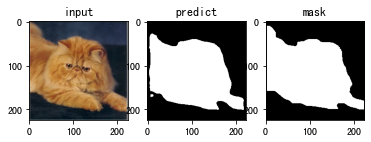

Epoch 1/1:  63%|██████▎   | 921/1470 [31:50<18:48,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_270.png'] : tensor(0.9801)
/openbayes/input/input3/test_image/Persian_270.png
hd: 8.48528137423857
jc: 0.9609888105083921
sc: 0.9716841911086516
sp: 0.9794900849858357


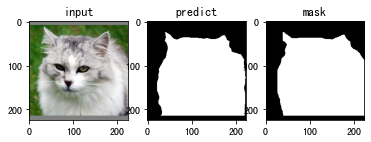

Epoch 1/1:  63%|██████▎   | 922/1470 [31:52<18:40,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_272.png'] : tensor(0.9647)
/openbayes/input/input3/test_image/Persian_272.png
hd: 7.211102550927978
jc: 0.9317277486910994
sc: 0.9401281960977671
sp: 0.9964423691597877


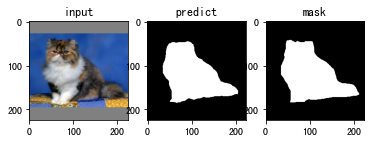

Epoch 1/1:  63%|██████▎   | 923/1470 [31:55<18:55,  2.08s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_273.png'] : tensor(4.3695e-10)
/openbayes/input/input3/test_image/Persian_273.png
hd: 81.59656855530139
jc: 0.0
sc: 0.0
sp: 0.8084488683493305


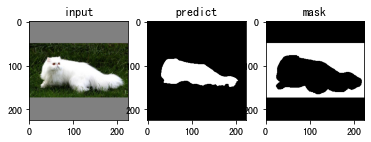

Epoch 1/1:  63%|██████▎   | 924/1470 [31:57<18:42,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_28.png'] : tensor(0.8136)
/openbayes/input/input3/test_image/Persian_28.png
hd: 67.06713054842886
jc: 0.6857222532069158
sc: 0.9670315265124205
sp: 0.8207566081502907


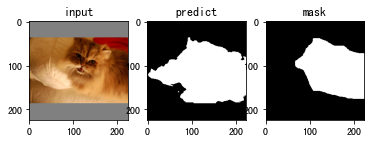

Epoch 1/1:  63%|██████▎   | 925/1470 [31:59<18:45,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_34.png'] : tensor(0.9634)
/openbayes/input/input3/test_image/Persian_34.png
hd: 20.8806130178211
jc: 0.9293982588730508
sc: 0.9624052701966417
sp: 0.9760896388434989


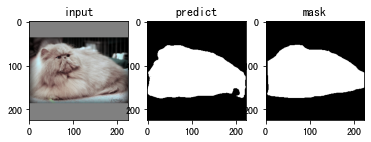

Epoch 1/1:  63%|██████▎   | 926/1470 [32:00<18:14,  2.01s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_36.png'] : tensor(0.9604)
/openbayes/input/input3/test_image/Persian_36.png
hd: 55.0
jc: 0.9239091236927516
sc: 0.9704137031269727
sp: 0.954722695438198


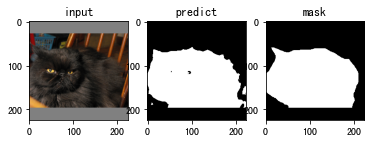

Epoch 1/1:  63%|██████▎   | 927/1470 [32:02<18:10,  2.01s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_38.png'] : tensor(0.9353)
/openbayes/input/input3/test_image/Persian_38.png
hd: 34.132096331752024
jc: 0.8784422065769539
sc: 0.9977730539528292
sp: 0.9666972727498325


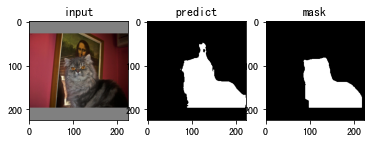

Epoch 1/1:  63%|██████▎   | 928/1470 [32:04<17:56,  1.99s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_49.png'] : tensor(0.9327)
/openbayes/input/input3/test_image/Persian_49.png
hd: 27.294688127912362
jc: 0.8739112957255796
sc: 0.9222719773744992
sp: 0.9594627257346086


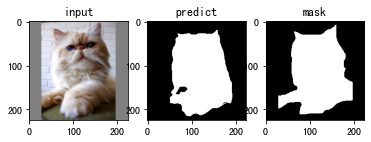

Epoch 1/1:  63%|██████▎   | 929/1470 [32:06<17:52,  1.98s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_53.png'] : tensor(0.9442)
/openbayes/input/input3/test_image/Persian_53.png
hd: 18.384776310850235
jc: 0.8942175938613318
sc: 0.9741025449660422
sp: 0.9674524838893874


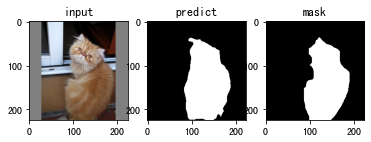

Epoch 1/1:  63%|██████▎   | 930/1470 [32:09<18:11,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_56.png'] : tensor(0.9515)
/openbayes/input/input3/test_image/Persian_56.png
hd: 33.83784863137726
jc: 0.9074618507629847
sc: 0.995637748832637
sp: 0.8205288243304585


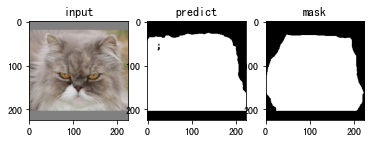

Epoch 1/1:  63%|██████▎   | 931/1470 [32:11<18:45,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_62.png'] : tensor(0.9702)
/openbayes/input/input3/test_image/Persian_62.png
hd: 10.816653826391969
jc: 0.9421176770574361
sc: 0.9544691294239215
sp: 0.9941485068603713


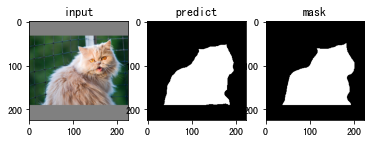

Epoch 1/1:  63%|██████▎   | 932/1470 [32:13<18:21,  2.05s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_65.png'] : tensor(0.9645)
/openbayes/input/input3/test_image/Persian_65.png
hd: 7.810249675906654
jc: 0.9314629605576482
sc: 0.9658361391694725
sp: 0.9705386903695208


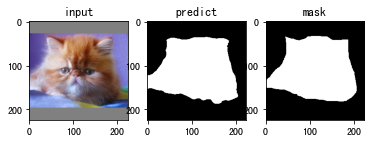

Epoch 1/1:  63%|██████▎   | 933/1470 [32:15<18:15,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_69.png'] : tensor(0.9587)
/openbayes/input/input3/test_image/Persian_69.png
hd: 12.083045973594572
jc: 0.9207071591107999
sc: 0.9829938329284246
sp: 0.9681739589133429


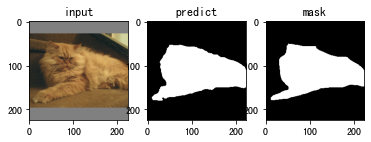

Epoch 1/1:  64%|██████▎   | 934/1470 [32:17<18:41,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_7.png'] : tensor(0.9797)
/openbayes/input/input3/test_image/Persian_7.png
hd: 6.324555320336759
jc: 0.9602656524947494
sc: 0.9786532454009025
sp: 0.9899361508057161


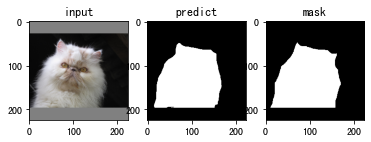

Epoch 1/1:  64%|██████▎   | 935/1470 [32:19<18:30,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_77.png'] : tensor(0.9483)
/openbayes/input/input3/test_image/Persian_77.png
hd: 22.627416997969522
jc: 0.9016601012943163
sc: 0.9778761061946902
sp: 0.9701089888852918


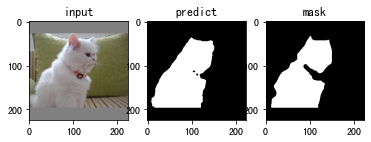

Epoch 1/1:  64%|██████▎   | 936/1470 [32:21<18:36,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/Persian_90.png'] : tensor(0.9738)
/openbayes/input/input3/test_image/Persian_90.png
hd: 11.0
jc: 0.9489344769652489
sc: 0.9757683215130024
sp: 0.9779276082327892


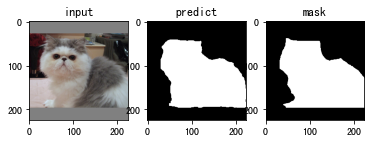

Epoch 1/1:  64%|██████▎   | 937/1470 [32:23<19:15,  2.17s/it, f_score=0.937]

['/openbayes/input/input3/test_image/Persian_98.png'] : tensor(0.9151)
/openbayes/input/input3/test_image/Persian_98.png
hd: 25.495097567963924
jc: 0.8435664709022958
sc: 0.9836745987825124
sp: 0.9327827547592386


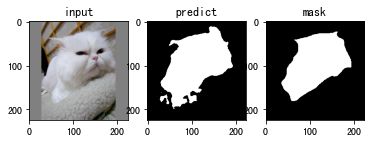

Epoch 1/1:  64%|██████▍   | 938/1470 [32:25<18:50,  2.12s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_103.png'] : tensor(0.8391)
/openbayes/input/input3/test_image/pomeranian_103.png
hd: 9.899494936611665
jc: 0.72277567846101
sc: 0.9772410589874594
sp: 0.98421589654957


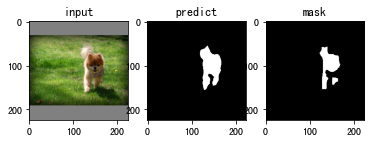

Epoch 1/1:  64%|██████▍   | 939/1470 [32:28<18:50,  2.13s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_105.png'] : tensor(0.9347)
/openbayes/input/input3/test_image/pomeranian_105.png
hd: 35.0
jc: 0.8773426509960521
sc: 0.948628624699475
sp: 0.9444202047323377


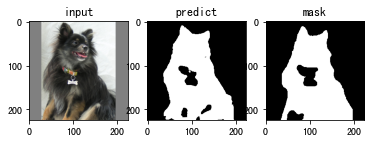

Epoch 1/1:  64%|██████▍   | 940/1470 [32:30<18:26,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_106.png'] : tensor(0.9162)
/openbayes/input/input3/test_image/pomeranian_106.png
hd: 11.0
jc: 0.8452950558213717
sc: 0.8988128886376484
sp: 0.9976862850414197


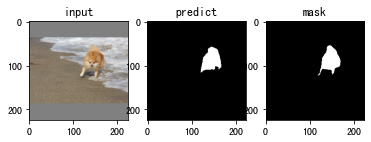

Epoch 1/1:  64%|██████▍   | 941/1470 [32:32<18:14,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_111.png'] : tensor(0.9006)
/openbayes/input/input3/test_image/pomeranian_111.png
hd: 41.036569057366385
jc: 0.8192473781616286
sc: 0.976590268415247
sp: 0.9074369425246618


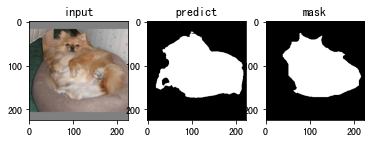

Epoch 1/1:  64%|██████▍   | 942/1470 [32:34<18:08,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_112.png'] : tensor(0.9421)
/openbayes/input/input3/test_image/pomeranian_112.png
hd: 18.384776310850235
jc: 0.8906258061187639
sc: 0.9315741190437645
sp: 0.9730763153736768


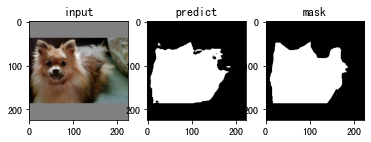

Epoch 1/1:  64%|██████▍   | 943/1470 [32:36<17:53,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_114.png'] : tensor(0.9148)
/openbayes/input/input3/test_image/pomeranian_114.png
hd: 24.186773244895647
jc: 0.8430620650475785
sc: 0.9264866552208522
sp: 0.9855148621170234


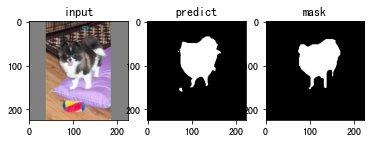

Epoch 1/1:  64%|██████▍   | 944/1470 [32:37<17:19,  1.98s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_117.png'] : tensor(0.9248)
/openbayes/input/input3/test_image/pomeranian_117.png
hd: 25.019992006393608
jc: 0.8601513856671957
sc: 0.9564243534921605
sp: 0.9534745930084925


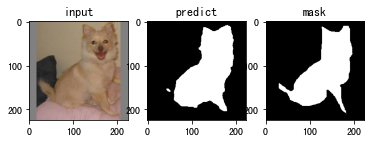

Epoch 1/1:  64%|██████▍   | 945/1470 [32:40<17:24,  1.99s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_118.png'] : tensor(0.8972)
/openbayes/input/input3/test_image/pomeranian_118.png
hd: 23.345235059857504
jc: 0.813644199983581
sc: 0.9809957438384638
sp: 0.9481446360392284


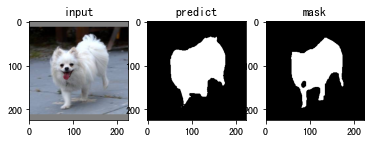

Epoch 1/1:  64%|██████▍   | 946/1470 [32:42<17:41,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_120.png'] : tensor(0.9201)
/openbayes/input/input3/test_image/pomeranian_120.png
hd: 17.029386365926403
jc: 0.8520862171247775
sc: 0.9634791682194231
sp: 0.9522837944448979


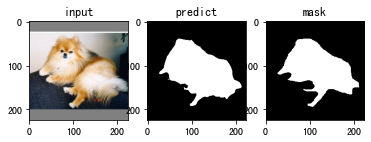

Epoch 1/1:  64%|██████▍   | 947/1470 [32:44<17:52,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_133.png'] : tensor(0.9153)
/openbayes/input/input3/test_image/pomeranian_133.png
hd: 16.0
jc: 0.8438802576733612
sc: 0.9842783179694405
sp: 0.9232628574756829


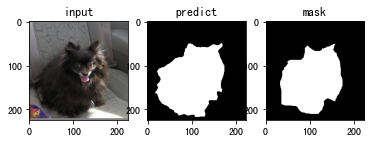

Epoch 1/1:  64%|██████▍   | 948/1470 [32:46<17:40,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_138.png'] : tensor(0.8991)
/openbayes/input/input3/test_image/pomeranian_138.png
hd: 21.840329667841555
jc: 0.8167772346368715
sc: 0.9527543020059057
sp: 0.9594845744021806


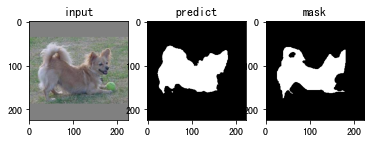

Epoch 1/1:  65%|██████▍   | 949/1470 [32:48<17:49,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_139.png'] : tensor(0.9477)
/openbayes/input/input3/test_image/pomeranian_139.png
hd: 11.0
jc: 0.9006446414182111
sc: 0.966952158491219
sp: 0.9779630732578916


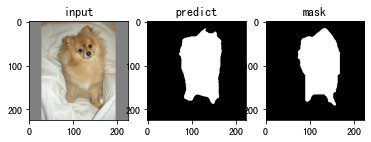

Epoch 1/1:  65%|██████▍   | 950/1470 [32:50<17:33,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_143.png'] : tensor(0.9030)
/openbayes/input/input3/test_image/pomeranian_143.png
hd: 37.8549864614954
jc: 0.8231266641308482
sc: 0.9855402482067631
sp: 0.9581330176599908


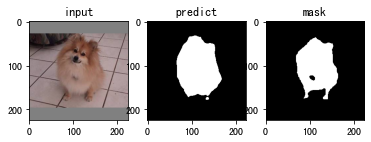

Epoch 1/1:  65%|██████▍   | 951/1470 [32:52<17:17,  2.00s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_145.png'] : tensor(0.9097)
/openbayes/input/input3/test_image/pomeranian_145.png
hd: 18.788294228055936
jc: 0.8343662983921675
sc: 0.9928388200085506
sp: 0.8870455123315535


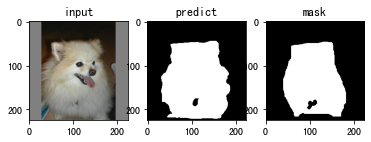

Epoch 1/1:  65%|██████▍   | 952/1470 [32:54<17:12,  1.99s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_146.png'] : tensor(0.8973)
/openbayes/input/input3/test_image/pomeranian_146.png
hd: 21.95449840010015
jc: 0.8136971046770601
sc: 0.9132037742923201
sp: 0.9427325666461827


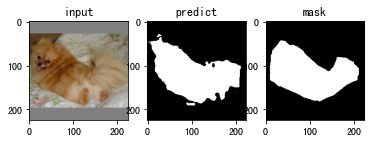

Epoch 1/1:  65%|██████▍   | 953/1470 [32:56<17:23,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_147.png'] : tensor(0.8939)
/openbayes/input/input3/test_image/pomeranian_147.png
hd: 20.396078054371138
jc: 0.8081934566145093
sc: 0.9396044188661772
sp: 0.9298896146495906


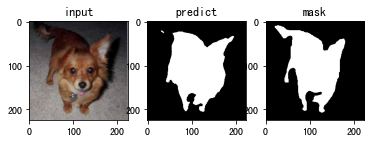

Epoch 1/1:  65%|██████▍   | 954/1470 [32:58<17:26,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_150.png'] : tensor(0.8916)
/openbayes/input/input3/test_image/pomeranian_150.png
hd: 28.284271247461902
jc: 0.8044740541531691
sc: 0.9457498023999426
sp: 0.9325960451198323


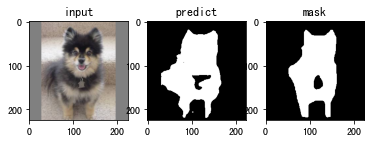

Epoch 1/1:  65%|██████▍   | 955/1470 [33:00<17:45,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_152.png'] : tensor(0.9545)
/openbayes/input/input3/test_image/pomeranian_152.png
hd: 25.0
jc: 0.9129802344485326
sc: 0.9572082174576119
sp: 0.9861641343616285


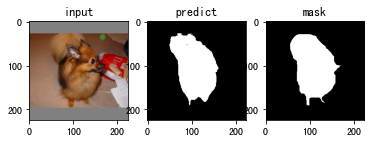

Epoch 1/1:  65%|██████▌   | 956/1470 [33:02<17:40,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_154.png'] : tensor(0.8686)
/openbayes/input/input3/test_image/pomeranian_154.png
hd: 39.84971769034255
jc: 0.767756381549485
sc: 0.9339725430376988
sp: 0.9515342211815211


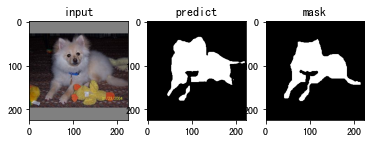

Epoch 1/1:  65%|██████▌   | 957/1470 [33:04<17:21,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_155.png'] : tensor(0.7939)
/openbayes/input/input3/test_image/pomeranian_155.png
hd: 33.24154027718932
jc: 0.6582196231319039
sc: 0.9881721741251067
sp: 0.9020607504466944


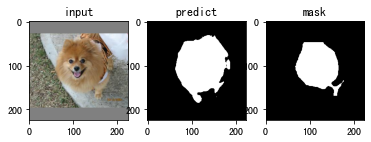

Epoch 1/1:  65%|██████▌   | 958/1470 [33:06<17:45,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_161.png'] : tensor(0.9133)
/openbayes/input/input3/test_image/pomeranian_161.png
hd: 35.34119409414458
jc: 0.8403531625416124
sc: 0.9819042787079316
sp: 0.9480573663624511


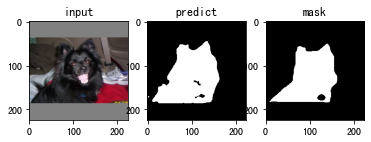

Epoch 1/1:  65%|██████▌   | 959/1470 [33:08<17:39,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_167.png'] : tensor(0.8853)
/openbayes/input/input3/test_image/pomeranian_167.png
hd: 20.591260281974
jc: 0.7941619585687383
sc: 0.9856833985858704
sp: 0.8751776910746152


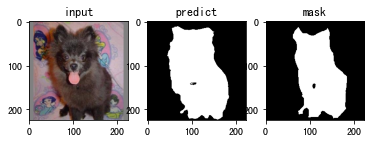

Epoch 1/1:  65%|██████▌   | 960/1470 [33:10<18:01,  2.12s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_168.png'] : tensor(0.8927)
/openbayes/input/input3/test_image/pomeranian_168.png
hd: 35.11409973215888
jc: 0.8062155027597793
sc: 0.9688536409516944
sp: 0.9676464466594205


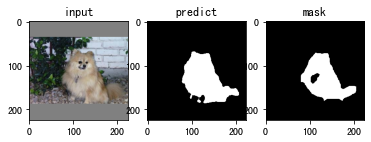

Epoch 1/1:  65%|██████▌   | 961/1470 [33:12<17:40,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_173.png'] : tensor(0.8447)
/openbayes/input/input3/test_image/pomeranian_173.png
hd: 24.331050121192877
jc: 0.731196163750999
sc: 0.9944444444444445
sp: 0.9288476226847432


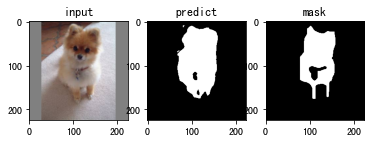

Epoch 1/1:  65%|██████▌   | 962/1470 [33:14<17:06,  2.02s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_181.png'] : tensor(0.9254)
/openbayes/input/input3/test_image/pomeranian_181.png
hd: 20.12461179749811
jc: 0.8611229627101289
sc: 0.9942854327799399
sp: 0.8949359038725441


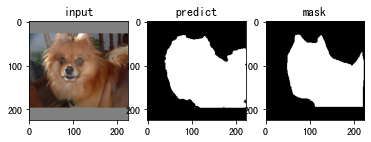

Epoch 1/1:  66%|██████▌   | 963/1470 [33:17<17:25,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_185.png'] : tensor(0.9522)
/openbayes/input/input3/test_image/pomeranian_185.png
hd: 13.0
jc: 0.9088202012983145
sc: 0.9502459679930257
sp: 0.9785444206700472


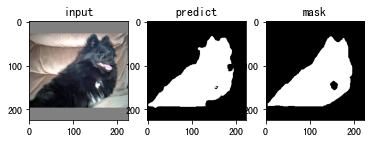

Epoch 1/1:  66%|██████▌   | 964/1470 [33:19<17:42,  2.10s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_188.png'] : tensor(0.9213)
/openbayes/input/input3/test_image/pomeranian_188.png
hd: 15.652475842498529
jc: 0.8541666666666666
sc: 0.9805987623348386
sp: 0.9799760164717062


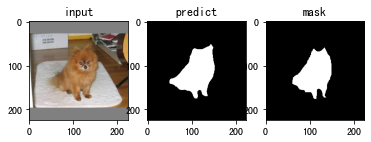

Epoch 1/1:  66%|██████▌   | 965/1470 [33:21<17:59,  2.14s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_19.png'] : tensor(0.9051)
/openbayes/input/input3/test_image/pomeranian_19.png
hd: 16.76305461424021
jc: 0.8266907716328376
sc: 0.8978936094252052
sp: 0.9752386328646208


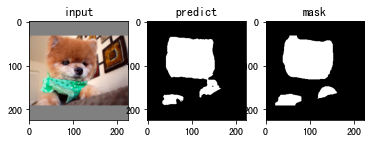

Epoch 1/1:  66%|██████▌   | 966/1470 [33:23<17:58,  2.14s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_196.png'] : tensor(0.9282)
/openbayes/input/input3/test_image/pomeranian_196.png
hd: 18.439088914585774
jc: 0.8661015107053581
sc: 0.913090804926955
sp: 0.971058341737722


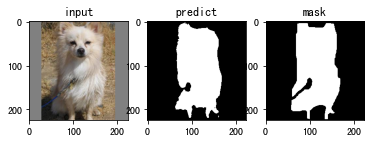

Epoch 1/1:  66%|██████▌   | 967/1470 [33:25<17:29,  2.09s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_198.png'] : tensor(0.7450)
/openbayes/input/input3/test_image/pomeranian_198.png
hd: 49.040799340956916
jc: 0.5936438137117729
sc: 0.9614762058918744
sp: 0.797567424643046


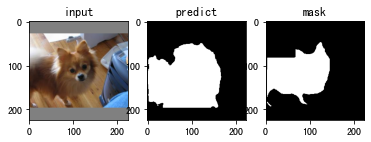

Epoch 1/1:  66%|██████▌   | 968/1470 [33:27<17:02,  2.04s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_2.png'] : tensor(0.9468)
/openbayes/input/input3/test_image/pomeranian_2.png
hd: 18.867962264113206
jc: 0.8989002356637863
sc: 0.9583752093802345
sp: 0.9793388429752066


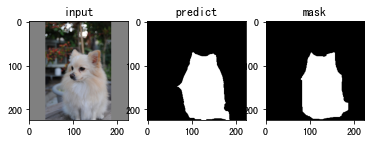

Epoch 1/1:  66%|██████▌   | 969/1470 [33:29<16:48,  2.01s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_20.png'] : tensor(0.8749)
/openbayes/input/input3/test_image/pomeranian_20.png
hd: 47.4236228055175
jc: 0.7775840462049801
sc: 0.7974407688869021
sp: 0.9858426270136307


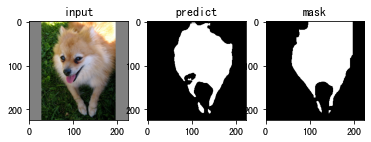

Epoch 1/1:  66%|██████▌   | 970/1470 [33:31<17:11,  2.06s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_22.png'] : tensor(0.9628)
/openbayes/input/input3/test_image/pomeranian_22.png
hd: 10.63014581273465
jc: 0.9281852586051541
sc: 0.9610038249836739
sp: 0.9903946067871353


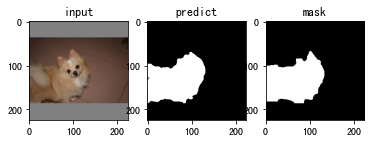

Epoch 1/1:  66%|██████▌   | 971/1470 [33:33<17:10,  2.07s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_29.png'] : tensor(0.9450)
/openbayes/input/input3/test_image/pomeranian_29.png
hd: 11.704699910719626
jc: 0.8957914442210358
sc: 0.9091548800225178
sp: 0.9941053802307799


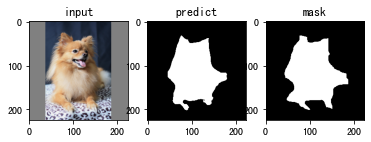

Epoch 1/1:  66%|██████▌   | 972/1470 [33:35<16:51,  2.03s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_32.png'] : tensor(0.9638)
/openbayes/input/input3/test_image/pomeranian_32.png
hd: 17.029386365926403
jc: 0.9301929625425652
sc: 0.9937635339974015
sp: 0.9795759881960084


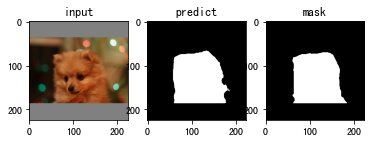

Epoch 1/1:  66%|██████▌   | 973/1470 [33:37<17:14,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_33.png'] : tensor(0.9435)
/openbayes/input/input3/test_image/pomeranian_33.png
hd: 13.892443989449804
jc: 0.8930264831733549
sc: 0.9729116794758725
sp: 0.9831908899358413


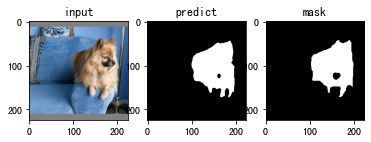

Epoch 1/1:  66%|██████▋   | 974/1470 [33:39<17:21,  2.10s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_59.png'] : tensor(0.9227)
/openbayes/input/input3/test_image/pomeranian_59.png
hd: 19.209372712298546
jc: 0.8565778517901749
sc: 0.8930121527777778
sp: 0.983824823943662


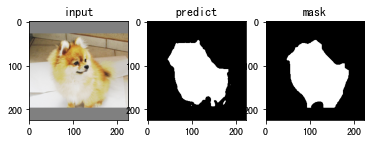

Epoch 1/1:  66%|██████▋   | 975/1470 [33:41<17:01,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_61.png'] : tensor(0.9317)
/openbayes/input/input3/test_image/pomeranian_61.png
hd: 22.825424421026653
jc: 0.8720974495622383
sc: 0.9552998081894755
sp: 0.9700405918554407


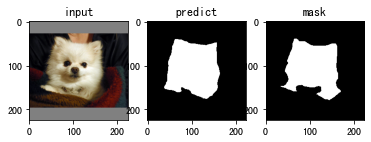

Epoch 1/1:  66%|██████▋   | 976/1470 [33:44<17:03,  2.07s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_74.png'] : tensor(0.8778)
/openbayes/input/input3/test_image/pomeranian_74.png
hd: 14.142135623730951
jc: 0.7822709618460133
sc: 0.9209252286175363
sp: 0.9691623771642489


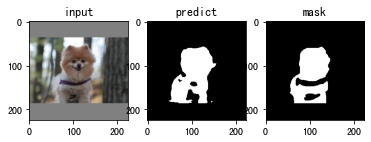

Epoch 1/1:  66%|██████▋   | 977/1470 [33:46<17:19,  2.11s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_76.png'] : tensor(0.8829)
/openbayes/input/input3/test_image/pomeranian_76.png
hd: 28.0
jc: 0.790314465408805
sc: 0.8276361720345122
sp: 0.9795101877518361


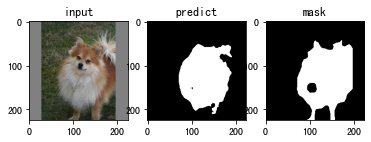

Epoch 1/1:  67%|██████▋   | 978/1470 [33:48<17:22,  2.12s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_77.png'] : tensor(0.8598)
/openbayes/input/input3/test_image/pomeranian_77.png
hd: 10.63014581273465
jc: 0.7541081565581117
sc: 0.9011067475901464
sp: 0.9884749340369393


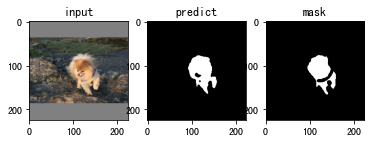

Epoch 1/1:  67%|██████▋   | 979/1470 [33:50<17:00,  2.08s/it, f_score=0.936]

['/openbayes/input/input3/test_image/pomeranian_82.png'] : tensor(0.9676)
/openbayes/input/input3/test_image/pomeranian_82.png
hd: 34.655446902326915
jc: 0.9372153916211293
sc: 0.9439857814470818
sp: 0.996150791226248


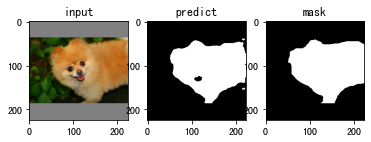

Epoch 1/1:  67%|██████▋   | 980/1470 [33:52<16:42,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_89.png'] : tensor(0.9700)
/openbayes/input/input3/test_image/pomeranian_89.png
hd: 18.0
jc: 0.9417674627452081
sc: 0.9429583005507475
sp: 0.9969152728269811


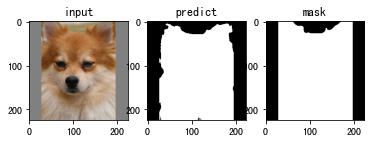

Epoch 1/1:  67%|██████▋   | 981/1470 [33:54<16:34,  2.03s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_92.png'] : tensor(0.9634)
/openbayes/input/input3/test_image/pomeranian_92.png
hd: 5.385164807134504
jc: 0.9293305985455902
sc: 0.9566218809980807
sp: 0.9923030485964383


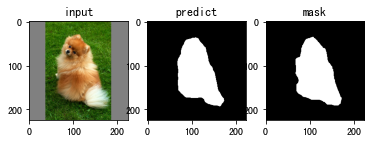

Epoch 1/1:  67%|██████▋   | 982/1470 [33:56<16:25,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_96.png'] : tensor(0.9068)
/openbayes/input/input3/test_image/pomeranian_96.png
hd: 16.0312195418814
jc: 0.8294539917337393
sc: 0.9391625615763547
sp: 0.9883554514702055


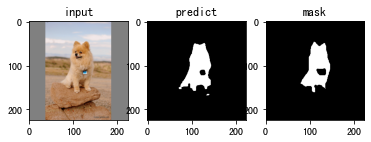

Epoch 1/1:  67%|██████▋   | 983/1470 [33:58<15:57,  1.97s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pomeranian_99.png'] : tensor(0.9240)
/openbayes/input/input3/test_image/pomeranian_99.png
hd: 18.439088914585774
jc: 0.8586863804378732
sc: 0.9293737498076627
sp: 0.9877509902236875


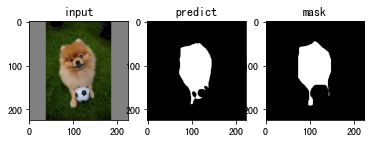

Epoch 1/1:  67%|██████▋   | 984/1470 [34:00<16:11,  2.00s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pug_104.png'] : tensor(0.8790)
/openbayes/input/input3/test_image/pug_104.png
hd: 41.19465984809196
jc: 0.7841756081579163
sc: 0.9385354377021861
sp: 0.9497686053783615


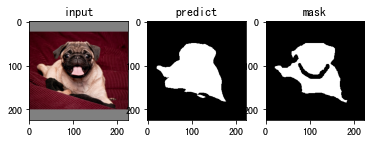

Epoch 1/1:  67%|██████▋   | 985/1470 [34:02<16:33,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pug_120.png'] : tensor(0.8353)
/openbayes/input/input3/test_image/pug_120.png
hd: 60.40695324215582
jc: 0.7171366035792456
sc: 0.9600137883488452
sp: 0.8981126205537696


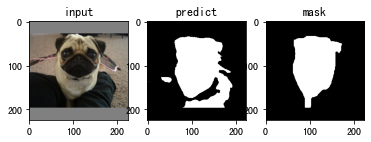

Epoch 1/1:  67%|██████▋   | 986/1470 [34:04<16:16,  2.02s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pug_124.png'] : tensor(0.9355)
/openbayes/input/input3/test_image/pug_124.png
hd: 16.15549442140351
jc: 0.8788643533123028
sc: 0.9271655415042312
sp: 0.9854257545576036


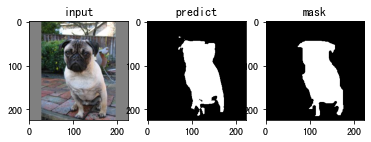

Epoch 1/1:  67%|██████▋   | 987/1470 [34:06<16:13,  2.01s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pug_125.png'] : tensor(0.9267)
/openbayes/input/input3/test_image/pug_125.png
hd: 17.69180601295413
jc: 0.8633379565418401
sc: 0.9307216905901117
sp: 0.9804952172180151


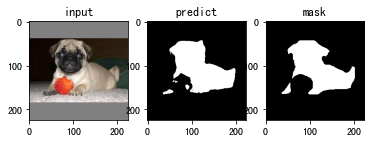

Epoch 1/1:  67%|██████▋   | 988/1470 [34:08<16:27,  2.05s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pug_136.png'] : tensor(0.9259)
/openbayes/input/input3/test_image/pug_136.png
hd: 45.39823785126467
jc: 0.8620689655172413
sc: 0.9113832853025937
sp: 0.9781243112188671


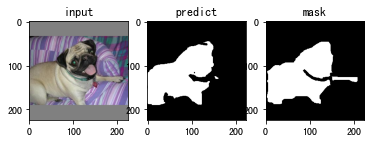

Epoch 1/1:  67%|██████▋   | 989/1470 [34:10<16:23,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pug_146.png'] : tensor(0.9212)
/openbayes/input/input3/test_image/pug_146.png
hd: 33.24154027718932
jc: 0.8539484436520318
sc: 0.9095584744421585
sp: 0.9780755501092226


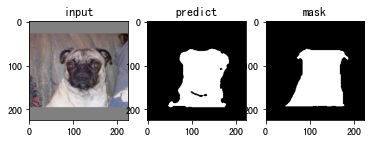

Epoch 1/1:  67%|██████▋   | 990/1470 [34:12<16:17,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pug_147.png'] : tensor(0.9185)
/openbayes/input/input3/test_image/pug_147.png
hd: 29.154759474226502
jc: 0.8492744276039987
sc: 0.9355595026642984
sp: 0.9603889088944905


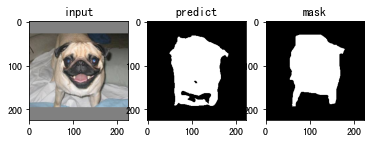

Epoch 1/1:  67%|██████▋   | 991/1470 [34:14<16:28,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pug_149.png'] : tensor(0.9358)
/openbayes/input/input3/test_image/pug_149.png
hd: 49.0
jc: 0.8792977732907061
sc: 0.9677757886289277
sp: 0.9520263707802337


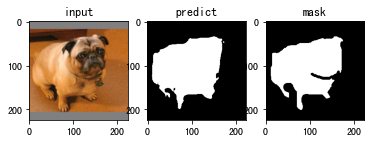

Epoch 1/1:  67%|██████▋   | 992/1470 [34:16<16:15,  2.04s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pug_154.png'] : tensor(0.8841)
/openbayes/input/input3/test_image/pug_154.png
hd: 27.85677655436824
jc: 0.7923374340949033
sc: 0.9132231404958677
sp: 0.9502299518951208


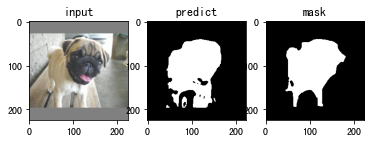

Epoch 1/1:  68%|██████▊   | 993/1470 [34:18<16:20,  2.06s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pug_156.png'] : tensor(0.9620)
/openbayes/input/input3/test_image/pug_156.png
hd: 15.231546211727817
jc: 0.9267485474737074
sc: 0.9559972687959942
sp: 0.9887552371942154


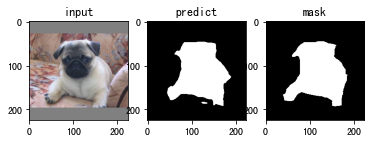

Epoch 1/1:  68%|██████▊   | 994/1470 [34:20<16:34,  2.09s/it, f_score=0.937]

['/openbayes/input/input3/test_image/pug_157.png'] : tensor(0.9452)
/openbayes/input/input3/test_image/pug_157.png
hd: 40.0
jc: 0.8961473309299396
sc: 0.9047138785354089
sp: 0.9920353658982134


In [ ]:
import numpy as np
import torch
import torch.backends.cudnn as cudnn
from PIL import Image
from torch import nn
import torch.nn.functional as F
from torch.autograd import Variable
from torch.utils.data import DataLoader
from tqdm import tqdm
import os
import cv2
from medpy import metric
# from nets.unet import Unet
import matplotlib.pyplot as plt
# from Attention_Unet_from_UnetZoo import AttU_Net
from logger import get_logger

def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']


def fit_one_epoch(net, genval, cuda,filesname):

    val_total_f_score = 0
    val_total_sensitivity = 0
    val_total_precision = 0
    val_total_hd = 0
    val_total_sc = 0
    val_total_sp = 0
    val_total_jc = 0
    val_total_background = 0
    val_total_pet = 0
    val_total_nonclass = 0

    i = 0
    net.eval()
    print('Start Validation')
    with tqdm(total=1470, desc=f'Epoch {0 + 1}/{1}', postfix=dict, mininterval=0.3) as pbar:
        for iteration, batch in enumerate(genval):
            if iteration >= epoch_size_val:
                break
            imgs, pngs, labels,imgs_path,label_path = batch
            image = np.squeeze(imgs, 0)
            image = image.transpose(1, 2, 0)
            image = Image.fromarray(np.uint8(image))

            with torch.no_grad():
                imgs = Variable(torch.from_numpy(imgs).type(torch.FloatTensor))
                pngs = Variable(torch.from_numpy(pngs).type(torch.FloatTensor)).long()
                labels = Variable(torch.from_numpy(labels).type(torch.FloatTensor))
                if cuda:
                    imgs = imgs.cuda()
                    pngs = pngs.cuda()
                    labels = labels.cuda()

                # outputs = net(imgs).cuda()
                outputs = net(imgs)
                # -------------------------------#
                #   Compute Dice, Sensitivity, Precision, Jaccard and HD
                # -------------------------------#
                _f_score, background_score, pet,tp,fp,fn = f_score(outputs, labels)
                sensitivity = Sensitivity(outputs,labels)
                precision = Precision(outputs,labels)
                i +=1
                print(str(imgs_path),':',pet)

                val_total_f_score += _f_score.item() if (_f_score != 0) else None
                val_total_sensitivity += sensitivity.item() if (sensitivity != 0) else None
                val_total_precision += precision.item() if (precision != 0) else None
                predict = torch.squeeze(outputs,0).cpu().numpy()
                predict = predict.transpose(1, 2, 0)
                predict = Image.fromarray(np.uint8(predict))
                pr = torch.squeeze(outputs,0)
                pr = F.softmax(pr.permute(1, 2, 0), dim=-1).cpu().numpy().argmax(axis=-1)

                val_total_background += background_score.item()
                val_total_pet += pet.item()
                background_dice_list.append(background_score)
                pet_dice_list.append(pet)


            seg_img = np.zeros((np.shape(pr)[0], np.shape(pr)[1], 3))

            for c in range(num_classes):
                seg_img[:, :, 0] += ((pr[:, :] == c) * (colors[c][0])).astype('uint8')
                seg_img[:, :, 1] += ((pr[:, :] == c) * (colors[c][1])).astype('uint8')
                seg_img[:, :, 2] += ((pr[:, :] == c) * (colors[c][2])).astype('uint8')
            
            r_image = Image.fromarray(np.uint8(seg_img))
            r_image = r_image.convert('L')
            r_image = np.array(r_image)
            r_image[r_image == 0] = 1
            r_image[r_image == 255] = 0

            label = cv2.imread(label_path[0])

            fig = plt.figure()
            ax1 = fig.add_subplot(1, 3, 1)
            ax1.set_title('input')
            plt.imshow(Image.open(imgs_path[0]))
            ax2 = fig.add_subplot(1, 3, 2)
            ax2.set_title('predict')
            print(imgs_path[0])
            cv2.imwrite('result/plot/tempout1/' + imgs_path[0].split('/')[-1], r_image)
            plt.imshow(r_image, cmap='Greys_r')
            ax3 = fig.add_subplot(1, 3, 3)
            ax3.set_title('mask')
            plt.imshow(Image.open(label_path[0]), cmap='Greys_r')
            mm = Image.open(label_path[0])
            mm = np.array(mm)
            if cv2.countNonZero(r_image) != 0:
                hd = metric.hd(r_image,mm)
                jc = metric.jc(r_image,mm)
                sc = metric.sensitivity(r_image,mm)
                sp = metric.specificity(r_image,mm)

            print('hd:',hd)
            val_total_hd += hd
            val_total_sc += sc
            val_total_sp += sp
            val_total_jc += jc
            print('jc:', jc)
            print('sc:', sc)
            print('sp:', sp)
            plt.savefig('result/plot/tempout1/savefig_' + imgs_path[0].split('/')[-1], bbox_inches='tight', pad_inches=0.1, dpi=300)
            plt.show()
            average_dice_score = val_total_f_score / (iteration+1)
            average_sensitivity = val_total_sensitivity / (iteration+1)
            average_precision = val_total_precision / (iteration+1)
            average_background_dice = val_total_background / (iteration+1)
            average_backgroun = val_total_pet / (iteration + 1)
            average_hd = val_total_hd / (iteration+1)
            average_sc = val_total_sc / (iteration+1)
            average_sp = val_total_sp / (iteration + 1)
            average_jc = val_total_jc / (iteration + 1)
            pbar.set_postfix(**{'f_score': val_total_f_score / (iteration + 1)})
            pbar.update(1)

    dice_list.append(average_dice_score)
    sensitivity_list.append(average_sensitivity)
    precision_list.append(average_precision)
    logger.info('filesname={}\t average_dice={:.16f}\t average_sensitivity={:.16f}\t average_precision={:.16f}'.format(filesname, average_dice_score, average_sensitivity, average_precision ))
    print(filesname,' average_dice:',average_dice_score)
    print(filesname,' average_sensitivity:',average_sensitivity)
    print(filesname,' average_precision:',average_precision)
    print(filesname,' average_background_dice:',average_background_dice)
    print(filesname,' average_backgroun:',average_backgroun)
    print(filesname, ' average_hd:', average_hd)
    print(filesname, ' average_sc:', average_sc)
    print(filesname, ' average_sp:', average_sp)
    print(filesname, ' average_jc:', average_jc)


if __name__ == "__main__":
    log_dir = "logs/"
    # ------------------------------#
    #   The size of the input image
    # ------------------------------#
    inputs_size = [224, 224, 3]
    # ---------------------#
    #   The number of segmentation classes
    # ---------------------#
    NUM_CLASSES = 2
    # --------------------------------------------------------------------#
    #   Enable the dice loss
    # ---------------------------------------------------------------------#
    dice_loss = True
    # -------------------------------#
    #   Enable Cuda
    # -------------------------------#
    Cuda = False

    # -------------------------------#
    #   Set batch size. 
    #   And here the variable of dataset and model just is for the name of loss figure
    # -------------------------------#
    BATCH_SIZE = 1
    dataset = 'oxford-iiit-pet'
    Model = 'SwinCAR'


    if Cuda:
#         net = torch.nn.DataParallel(model)
        cudnn.benchmark = True
#         net = net.cuda()

    # txt file of the test set. This file records names of each image in the test set
    with open("Medical_Datasets/ImageSets/cv_project/test.txt", "r") as f:
        val_lines = f.readlines()

    background_dice_list = []
    pet_dice_list = []
    nonclass_dice_list = []
    loss_list = []
    dice_list = []
    sensitivity_list = []
    precision_list = []
    hd_list = []
    logger = get_logger('save_log/test_log.log')
    logger.info('start testing!')
    for root, dirs,files in os.walk('logs'):
        for filesname in sorted(files):
            model_path = 'logs/'+filesname
            model_image_size= [224, 224, 3]
            num_classes = 2
            cuda = False
            blend= False


            # ---------------------------------------------------#
            #   Obtain the model
            #   Replace the comment with whichever model you want
            # ---------------------------------------------------#
            os.environ["CUDA_VISIBLE_DEVICES"] = '0'
#             net = Unet(num_classes=num_classes, in_channels=model_image_size[-1]).eval()
#             net = TransUnet(in_channels=3, img_dim=224, vit_blocks=12, vit_heads=12 ,vit_dim_linear_mhsa_block=3072, classes=2).eval()
#             net = SUnet(hidden_dim=128, layers=(2, 2, 18, 2), heads=(4, 8, 16, 32),num_classes=2).eval()
            net = SwinCAR(img_size=224, num_classes=NUM_CLASSES).eval()
#             net = Unet_from_UnetZoo(3,NUM_CLASSES).eval()
#             net = AttU_Net(3,NUM_CLASSES).eval()


            state_dict = torch.load(model_path, map_location='cpu')
            net.load_state_dict(state_dict)

            if cuda:
                net = nn.DataParallel(net)
                net = net.cuda()

            print('{} model loaded.'.format(model_path))

            if num_classes == 2:
                colors = [(255, 255, 255), (0, 0, 0)]
            elif num_classes == 3:
                colors = [(255,255,255), (0, 0, 0), (128, 128, 128)]
            elif num_classes <= 21:
                colors = [(0, 0, 0), (128, 0, 0), (0, 128, 0), (128, 128, 0), (0, 0, 128), (128, 0, 128),
                                (0, 128, 128),
                                (128, 128, 128), (64, 0, 0), (192, 0, 0), (64, 128, 0), (192, 128, 0), (64, 0, 128),
                                (192, 0, 128),
                                (64, 128, 128), (192, 128, 128), (0, 64, 0), (128, 64, 0), (0, 192, 0), (128, 192, 0),
                                (0, 64, 128), (128, 64, 12)]


            def letterbox_image(image, size):
                image = image.convert("RGB")
                iw, ih = image.size
                w, h = size
                scale = min(w / iw, h / ih)
                nw = int(iw * scale)
                nh = int(ih * scale)

                image = image.resize((nw, nh), Image.BICUBIC)
                new_image = Image.new('RGB', size, (128, 128, 128))
                new_image.paste(image, ((w - nw) // 2, (h - nh) // 2))
                return new_image, nw, nh
            

            val_dataset = Test_DeeplabDataset(val_lines, inputs_size, NUM_CLASSES, False, dataset_path = '/openbayes/input/input3')
            gen_val = DataLoader(val_dataset, batch_size=1, collate_fn=Test_deeplab_dataset_collate)
            epoch_size_val = max(1, len(val_lines) // 1)

            fit_one_epoch(net , gen_val, Cuda,filesname)

    logger.info('finish testing!')
    print(np.mean(background_dice_list))
    print(np.mean(pet_dice_list))
    print(np.mean(dice_list))
    print(np.mean(sensitivity_list))
    print(np.mean(precision_list))
    print(np.mean(hd_list))